In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

C:\Users\User\AppData\Local\Temp\ipykernel_9940\3241162335.py:383: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.42725031 0.69695044 0.32924264 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.51683609 0.42215989 ... 0.66276202 0.49013564 0.22934649]
 [0.43218249 0.62674714 0.3411641  ... 0.37854501 0.40197287 0.23181258]
 ...
 [0.47102343 0.46473952 0.46949509 ... 0.43218249 0.47163995 0.33908755]
 [0.43464858 0.51620076 0.3997195  ... 0.51911221 0.46300863 0.21454994]
 [0.44389642 0.52414231 0.42356241 ... 0.50184957 0.52034525 0.30641184]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.43464858 0.62313675 0.34639831 ... 0.38902589 0.41122072 0.1701603 ]
 [0.42725031 0.71548931 0.32450565 ... 0.43033292 0.29839704 0.24722565]
 [0.45745993 0.53175632 0.4180791  ... 0.66276202 0.49013564 0.22934649]
 ...
 [0.47102343 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Specific Humidity\tPredicted Specific Humidity\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 03:54:13,314] A new study created in memory with name: no-name-06303678-408a-420f-abde-49d03a414e24
[I 2025-05-18 03:59:34,043] Trial 0 finished with value: 0.07784437835216522 and parameters: {'lr': 0.0013197784222945725, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.48106986738919566}. Best is trial 0 with value: 0.07784437835216522.


Cross Validation Accuracies:
[0.08029408007860184, 0.07010482251644135, 0.07837433367967606, 0.0813361257314682, 0.07911252975463867]
Mean Cross Validation Accuracy:
0.07784437835216522
Standard Deviation of Cross Validation Accuracy:
0.003999578064556704


[I 2025-05-18 04:08:37,477] Trial 1 finished with value: 0.06460798531770706 and parameters: {'lr': 0.058958768385291904, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.22167311991535193}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.05755041912198067, 0.059417691081762314, 0.07337550818920135, 0.07394852489233017, 0.0587477833032608]
Mean Cross Validation Accuracy:
0.06460798531770706
Standard Deviation of Cross Validation Accuracy:
0.0074189689224330516


[I 2025-05-18 04:19:35,987] Trial 2 finished with value: 0.06527678444981574 and parameters: {'lr': 0.007271802208740952, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.45371681909468864}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.05886516720056534, 0.05990738049149513, 0.07236415147781372, 0.0733221247792244, 0.061925098299980164]
Mean Cross Validation Accuracy:
0.06527678444981574
Standard Deviation of Cross Validation Accuracy:
0.006263088807786079


[I 2025-05-18 04:28:12,197] Trial 3 finished with value: 0.06479183211922646 and parameters: {'lr': 0.2935513881910098, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1447135957826371}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.06109558045864105, 0.05936826765537262, 0.073397696018219, 0.07100208103656769, 0.059095535427331924]
Mean Cross Validation Accuracy:
0.06479183211922646
Standard Deviation of Cross Validation Accuracy:
0.0061343819394845


[I 2025-05-18 04:39:06,920] Trial 4 finished with value: 0.07128336429595947 and parameters: {'lr': 0.4181577311433612, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.26859067997731656}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.06846294552087784, 0.06250344961881638, 0.07876186817884445, 0.07901997864246368, 0.06766857951879501]
Mean Cross Validation Accuracy:
0.07128336429595947
Standard Deviation of Cross Validation Accuracy:
0.006540513048115204


[I 2025-05-18 04:49:53,442] Trial 5 finished with value: 0.07438723891973495 and parameters: {'lr': 0.00557362467417767, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.49926263981312846}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.07412117719650269, 0.06270919740200043, 0.07772824168205261, 0.08352211117744446, 0.07385546714067459]
Mean Cross Validation Accuracy:
0.07438723891973495
Standard Deviation of Cross Validation Accuracy:
0.006802035200996694


[I 2025-05-18 04:57:32,190] Trial 6 finished with value: 0.06555022075772285 and parameters: {'lr': 0.001022710769096746, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.1603676270370248}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.060884419828653336, 0.06210320070385933, 0.07384689897298813, 0.07319457828998566, 0.05772200599312782]
Mean Cross Validation Accuracy:
0.06555022075772285
Standard Deviation of Cross Validation Accuracy:
0.006666388279282678


[I 2025-05-18 05:07:14,248] Trial 7 finished with value: 0.2923864245414734 and parameters: {'lr': 0.046204687038494056, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.10932422457743499}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.27455827593803406, 0.35890331864356995, 0.21305832266807556, 0.27960535883903503, 0.33580684661865234]
Mean Cross Validation Accuracy:
0.2923864245414734
Standard Deviation of Cross Validation Accuracy:
0.05115462153960763


[I 2025-05-18 05:15:08,205] Trial 8 finished with value: 0.06474327594041825 and parameters: {'lr': 0.05059605529576215, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4184224901442746}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.05894498899579048, 0.06124701350927353, 0.07221844792366028, 0.07301142066717148, 0.05829450860619545]
Mean Cross Validation Accuracy:
0.06474327594041825
Standard Deviation of Cross Validation Accuracy:
0.006506473638034625


[I 2025-05-18 05:26:02,399] Trial 9 finished with value: 0.49514915347099303 and parameters: {'lr': 0.0011345275200304655, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10875206806466814}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.4795726537704468, 0.5073745846748352, 0.44920679926872253, 0.523655354976654, 0.5159363746643066]
Mean Cross Validation Accuracy:
0.49514915347099303
Standard Deviation of Cross Validation Accuracy:
0.027376999506552847


[I 2025-05-18 05:36:46,379] Trial 10 finished with value: 0.06703223213553429 and parameters: {'lr': 0.08248197063388647, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2545019181635106}. Best is trial 1 with value: 0.06460798531770706.


Cross Validation Accuracies:
[0.0634487196803093, 0.05970633402466774, 0.07414398342370987, 0.07659613341093063, 0.061265990138053894]
Mean Cross Validation Accuracy:
0.06703223213553429
Standard Deviation of Cross Validation Accuracy:
0.00695420887537112


[I 2025-05-18 05:45:27,741] Trial 11 finished with value: 0.06423325464129448 and parameters: {'lr': 0.11525617088476073, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.37194153581544304}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.058087315410375595, 0.0606171153485775, 0.07122082263231277, 0.07207781076431274, 0.059163209050893784]
Mean Cross Validation Accuracy:
0.06423325464129448
Standard Deviation of Cross Validation Accuracy:
0.006114205784883394


[I 2025-05-18 05:53:55,485] Trial 12 finished with value: 0.06438308507204056 and parameters: {'lr': 0.14858022434993898, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.36333877223805766}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.057733092457056046, 0.06129218265414238, 0.07226324081420898, 0.07235546410083771, 0.05827144533395767]
Mean Cross Validation Accuracy:
0.06438308507204056
Standard Deviation of Cross Validation Accuracy:
0.0065845865735680905


[I 2025-05-18 06:02:03,610] Trial 13 finished with value: 0.06436784490942955 and parameters: {'lr': 0.21430257644213485, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.36425075357407927}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.058720674365758896, 0.06131650507450104, 0.0717059001326561, 0.07147662341594696, 0.05861952155828476]
Mean Cross Validation Accuracy:
0.06436784490942955
Standard Deviation of Cross Validation Accuracy:
0.005977059772173704


[I 2025-05-18 06:11:18,554] Trial 14 finished with value: 0.07095685452222825 and parameters: {'lr': 0.8594288829217333, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3460525378492231}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[0.07379243522882462, 0.06399494409561157, 0.07476149499416351, 0.07787785679101944, 0.06435754150152206]
Mean Cross Validation Accuracy:
0.07095685452222825
Standard Deviation of Cross Validation Accuracy:
0.005699740495889586


[I 2025-05-18 06:19:28,182] Trial 15 finished with value: 1.106748676300049 and parameters: {'lr': 0.016415488807548406, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.35280839167219014}. Best is trial 11 with value: 0.06423325464129448.


Cross Validation Accuracies:
[1.133113980293274, 1.120008111000061, 1.008823037147522, 1.084642767906189, 1.1871554851531982]
Mean Cross Validation Accuracy:
1.106748676300049
Standard Deviation of Cross Validation Accuracy:
0.059015758509934596


[I 2025-05-18 06:27:10,147] Trial 16 finished with value: 0.06410901397466659 and parameters: {'lr': 0.17015670309979433, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.40661387747763333}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.056791022419929504, 0.06039023771882057, 0.07249874621629715, 0.07149843126535416, 0.059366632252931595]
Mean Cross Validation Accuracy:
0.06410901397466659
Standard Deviation of Cross Validation Accuracy:
0.0065553577570268634


[I 2025-05-18 06:36:01,032] Trial 17 finished with value: 0.0652165874838829 and parameters: {'lr': 0.020922789046975216, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4175645409352316}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.059624362736940384, 0.06122759357094765, 0.07247070223093033, 0.0737541988492012, 0.05900608003139496]
Mean Cross Validation Accuracy:
0.0652165874838829
Standard Deviation of Cross Validation Accuracy:
0.006500283708634605


[I 2025-05-18 06:45:40,559] Trial 18 finished with value: 95.74351501464844 and parameters: {'lr': 0.983407451112131, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4043339625030579}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[94.77328491210938, 95.38273620605469, 87.09952545166016, 111.8488540649414, 89.61317443847656]
Mean Cross Validation Accuracy:
95.74351501464844
Standard Deviation of Cross Validation Accuracy:
8.634269915521573


[I 2025-05-18 06:56:49,405] Trial 19 finished with value: 0.7015661835670471 and parameters: {'lr': 0.12072483868050118, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3148702705646451}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.6960002779960632, 0.7720329165458679, 0.6094390153884888, 0.7743446230888367, 0.656014084815979]
Mean Cross Validation Accuracy:
0.7015661835670471
Standard Deviation of Cross Validation Accuracy:
0.06458428576362482


[I 2025-05-18 07:04:59,032] Trial 20 finished with value: 0.06545836254954338 and parameters: {'lr': 0.45521095715930615, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2961700399138572}. Best is trial 16 with value: 0.06410901397466659.


Cross Validation Accuracies:
[0.05982573330402374, 0.0629095584154129, 0.07324734330177307, 0.07210218161344528, 0.059206996113061905]
Mean Cross Validation Accuracy:
0.06545836254954338
Standard Deviation of Cross Validation Accuracy:
0.006035081606196916


[I 2025-05-18 07:15:13,354] Trial 21 finished with value: 0.0628392018377781 and parameters: {'lr': 0.23021815873483067, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3858669644780187}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05898185074329376, 0.057932328432798386, 0.07006047666072845, 0.0698264092206955, 0.05739494413137436]
Mean Cross Validation Accuracy:
0.0628392018377781
Standard Deviation of Cross Validation Accuracy:
0.005823476335194045


[I 2025-05-18 07:24:56,008] Trial 22 finished with value: 0.06381694748997688 and parameters: {'lr': 0.11770215544973567, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3988365609789725}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0577128566801548, 0.060955557972192764, 0.0711589977145195, 0.0713285580277443, 0.057928767055273056]
Mean Cross Validation Accuracy:
0.06381694748997688
Standard Deviation of Cross Validation Accuracy:
0.006171679476276662


[I 2025-05-18 07:32:54,123] Trial 23 finished with value: 0.06420428529381753 and parameters: {'lr': 0.22141968893158773, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.43403397360180385}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05946928635239601, 0.05998685210943222, 0.07169701904058456, 0.07164140045642853, 0.05822686851024628]
Mean Cross Validation Accuracy:
0.06420428529381753
Standard Deviation of Cross Validation Accuracy:
0.006121898561498983


[I 2025-05-18 07:41:25,228] Trial 24 finished with value: 0.06428044065833091 and parameters: {'lr': 0.4420744280606429, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.38572527252023486}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05723416805267334, 0.06110701337456703, 0.0714920163154602, 0.07304861396551132, 0.05852039158344269]
Mean Cross Validation Accuracy:
0.06428044065833091
Standard Deviation of Cross Validation Accuracy:
0.006660126880277115


[I 2025-05-18 07:50:48,133] Trial 25 finished with value: 0.06503920704126358 and parameters: {'lr': 0.025135845277390437, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.45155586420730326}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0582757368683815, 0.06120837852358818, 0.07263220101594925, 0.07393106073141098, 0.05914865806698799]
Mean Cross Validation Accuracy:
0.06503920704126358
Standard Deviation of Cross Validation Accuracy:
0.006809360655395492


[I 2025-05-18 07:58:17,958] Trial 26 finished with value: 0.06483182981610298 and parameters: {'lr': 0.07971654284165146, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4643565535826863}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05857907608151436, 0.061258260160684586, 0.07236187905073166, 0.07324479520320892, 0.05871513858437538]
Mean Cross Validation Accuracy:
0.06483182981610298
Standard Deviation of Cross Validation Accuracy:
0.006584236767498674


[I 2025-05-18 08:05:58,056] Trial 27 finished with value: 0.06392991319298744 and parameters: {'lr': 0.17910751657580606, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3252085686184309}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.057322267442941666, 0.05958830937743187, 0.07132713496685028, 0.0717122033238411, 0.0596996508538723]
Mean Cross Validation Accuracy:
0.06392991319298744
Standard Deviation of Cross Validation Accuracy:
0.006256013989107973


[I 2025-05-18 08:14:54,073] Trial 28 finished with value: 0.07791552990674973 and parameters: {'lr': 0.6240346200108283, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.31149681812567775}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.07077860087156296, 0.07507677376270294, 0.07811065018177032, 0.0919988825917244, 0.073612742125988]
Mean Cross Validation Accuracy:
0.07791552990674973
Standard Deviation of Cross Validation Accuracy:
0.007428151451822115


[I 2025-05-18 08:27:40,060] Trial 29 finished with value: 0.1581731379032135 and parameters: {'lr': 0.002247026906382356, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3294474486634909}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.1463892161846161, 0.15966440737247467, 0.15819647908210754, 0.17995624244213104, 0.14665934443473816]
Mean Cross Validation Accuracy:
0.1581731379032135
Standard Deviation of Cross Validation Accuracy:
0.012232385898905657


[I 2025-05-18 08:37:13,206] Trial 30 finished with value: 26.62952575683594 and parameters: {'lr': 0.31542330942816554, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.277827534608391}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[24.663349151611328, 24.34929656982422, 25.672992706298828, 29.102861404418945, 29.359128952026367]
Mean Cross Validation Accuracy:
26.62952575683594
Standard Deviation of Cross Validation Accuracy:
2.170178513109057


[I 2025-05-18 08:46:12,358] Trial 31 finished with value: 0.06412241533398629 and parameters: {'lr': 0.12633167471066026, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.38926655342738764}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05863729491829872, 0.061003878712654114, 0.07172585278749466, 0.0711197480559349, 0.05812530219554901]
Mean Cross Validation Accuracy:
0.06412241533398629
Standard Deviation of Cross Validation Accuracy:
0.006042385438872071


[I 2025-05-18 08:56:00,081] Trial 32 finished with value: 0.06376163437962531 and parameters: {'lr': 0.21037802043454765, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.33562813214300147}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.057632628828287125, 0.05952669680118561, 0.07170038670301437, 0.07110373675823212, 0.05884472280740738]
Mean Cross Validation Accuracy:
0.06376163437962531
Standard Deviation of Cross Validation Accuracy:
0.006270656752536925


[I 2025-05-18 09:03:53,507] Trial 33 finished with value: 0.0644682377576828 and parameters: {'lr': 0.07367304856719924, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.23652263591913567}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0582120381295681, 0.06096288189291954, 0.07203321158885956, 0.07246991246938705, 0.05866314470767975]
Mean Cross Validation Accuracy:
0.0644682377576828
Standard Deviation of Cross Validation Accuracy:
0.006424675651003137


[I 2025-05-18 09:13:57,250] Trial 34 finished with value: 0.06354896128177642 and parameters: {'lr': 0.24282296164791647, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3380342223548718}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05476247891783714, 0.0628320649266243, 0.07152944058179855, 0.07065135985612869, 0.057969462126493454]
Mean Cross Validation Accuracy:
0.06354896128177642
Standard Deviation of Cross Validation Accuracy:
0.006678010765290703


[I 2025-05-18 09:22:36,532] Trial 35 finished with value: 0.06468607038259507 and parameters: {'lr': 0.32146435745189145, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2008724942351457}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05791151151061058, 0.06142691522836685, 0.07174164056777954, 0.07343577593564987, 0.058914508670568466]
Mean Cross Validation Accuracy:
0.06468607038259507
Standard Deviation of Cross Validation Accuracy:
0.006575197072761692


[I 2025-05-18 09:30:36,704] Trial 36 finished with value: 0.06526279598474502 and parameters: {'lr': 0.6481135604813055, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2888043744874844}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05702957138419151, 0.060179587453603745, 0.07460583746433258, 0.06996345520019531, 0.06453552842140198]
Mean Cross Validation Accuracy:
0.06526279598474502
Standard Deviation of Cross Validation Accuracy:
0.006380321865737015


[I 2025-05-18 09:40:33,766] Trial 37 finished with value: 0.0648327000439167 and parameters: {'lr': 0.04169467718025299, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.38712474757444404}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05879003182053566, 0.061179328709840775, 0.07231418788433075, 0.07303678244352341, 0.05884316936135292]
Mean Cross Validation Accuracy:
0.0648327000439167
Standard Deviation of Cross Validation Accuracy:
0.0064655249977968446


[I 2025-05-18 09:50:50,256] Trial 38 finished with value: 0.06576853543519974 and parameters: {'lr': 0.010639526005210927, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.33715280558749644}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.061217740178108215, 0.062243055552244186, 0.07265191525220871, 0.07280279695987701, 0.05992716923356056]
Mean Cross Validation Accuracy:
0.06576853543519974
Standard Deviation of Cross Validation Accuracy:
0.005729259251971498


[I 2025-05-18 10:01:19,141] Trial 39 finished with value: 0.07291574031114578 and parameters: {'lr': 0.27610460400788384, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4358849452541754}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.07011369615793228, 0.0669059082865715, 0.08757597208023071, 0.07689116150140762, 0.06309196352958679]
Mean Cross Validation Accuracy:
0.07291574031114578
Standard Deviation of Cross Validation Accuracy:
0.008616292611295463


[I 2025-05-18 10:09:58,372] Trial 40 finished with value: 0.06453122422099114 and parameters: {'lr': 0.09429525962140387, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4774459237516745}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0584685243666172, 0.06034037098288536, 0.07213150709867477, 0.07297984510660172, 0.05873587355017662]
Mean Cross Validation Accuracy:
0.06453122422099114
Standard Deviation of Cross Validation Accuracy:
0.006588613882674625


[I 2025-05-18 10:17:56,776] Trial 41 finished with value: 0.06388458833098412 and parameters: {'lr': 0.2079409820480775, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3233267567767691}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05489050969481468, 0.061420489102602005, 0.0715380385518074, 0.07207490503787994, 0.059498999267816544]
Mean Cross Validation Accuracy:
0.06388458833098412
Standard Deviation of Cross Validation Accuracy:
0.006809628697568829


[I 2025-05-18 10:29:06,242] Trial 42 finished with value: 0.06345765292644501 and parameters: {'lr': 0.23499757557961495, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.34542060468805275}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05553359165787697, 0.059953723102808, 0.07136218994855881, 0.07169846445322037, 0.058740295469760895]
Mean Cross Validation Accuracy:
0.06345765292644501
Standard Deviation of Cross Validation Accuracy:
0.006748546698733403


[I 2025-05-18 10:37:14,508] Trial 43 finished with value: 0.06575431972742081 and parameters: {'lr': 0.395059167026919, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.34884830071048883}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05867219343781471, 0.06950635462999344, 0.07201667875051498, 0.07171306759119034, 0.05686330422759056]
Mean Cross Validation Accuracy:
0.06575431972742081
Standard Deviation of Cross Validation Accuracy:
0.006603154578659834


[I 2025-05-18 10:45:25,694] Trial 44 finished with value: 0.0701934851706028 and parameters: {'lr': 0.6085488025492151, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3765944990826155}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06873741745948792, 0.06428058445453644, 0.07821112126111984, 0.07820538431406021, 0.061532918363809586]
Mean Cross Validation Accuracy:
0.0701934851706028
Standard Deviation of Cross Validation Accuracy:
0.006936295291252137


[I 2025-05-18 10:53:11,192] Trial 45 finished with value: 1.288779616355896 and parameters: {'lr': 0.26210997743813086, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.25439187404863717}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[1.2638896703720093, 1.1138999462127686, 1.018150806427002, 1.097292423248291, 1.9506652355194092]
Mean Cross Validation Accuracy:
1.288779616355896
Standard Deviation of Cross Validation Accuracy:
0.34035342783162204


[I 2025-05-18 11:01:18,103] Trial 46 finished with value: 0.06538607627153396 and parameters: {'lr': 0.06823517058898952, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3990533395270719}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06230980530381203, 0.062012020498514175, 0.07291445881128311, 0.07157197594642639, 0.058122120797634125]
Mean Cross Validation Accuracy:
0.06538607627153396
Standard Deviation of Cross Validation Accuracy:
0.005806111314911737


[I 2025-05-18 11:09:54,296] Trial 47 finished with value: 0.06478168591856956 and parameters: {'lr': 0.035831534434680984, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.36104616500696385}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05913514271378517, 0.06073354557156563, 0.07237962633371353, 0.07282036542892456, 0.05883974954485893]
Mean Cross Validation Accuracy:
0.06478168591856956
Standard Deviation of Cross Validation Accuracy:
0.006417578439318723


[I 2025-05-18 11:18:58,875] Trial 48 finished with value: 13.322366905212402 and parameters: {'lr': 0.14869125801785263, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.30124803642120285}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[11.387924194335938, 14.188070297241211, 13.146066665649414, 14.527342796325684, 13.362430572509766]
Mean Cross Validation Accuracy:
13.322366905212402
Standard Deviation of Cross Validation Accuracy:
1.0932670977126129


[I 2025-05-18 11:29:18,077] Trial 49 finished with value: 0.06481892839074135 and parameters: {'lr': 0.0553529635267747, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4314640225168792}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05861504003405571, 0.0611671544611454, 0.07210059463977814, 0.07311631739139557, 0.059095535427331924]
Mean Cross Validation Accuracy:
0.06481892839074135
Standard Deviation of Cross Validation Accuracy:
0.006425733237214877


[I 2025-05-18 11:36:53,162] Trial 50 finished with value: 0.0648176722228527 and parameters: {'lr': 0.10606077067058581, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.49949921307766176}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.058571506291627884, 0.060986701399087906, 0.07244372367858887, 0.07330915331840515, 0.058777276426553726]
Mean Cross Validation Accuracy:
0.0648176722228527
Standard Deviation of Cross Validation Accuracy:
0.0066398677648058235


[I 2025-05-18 11:44:12,333] Trial 51 finished with value: 0.06477410271763802 and parameters: {'lr': 0.2021124678480269, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3338868499220764}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05958179011940956, 0.06135423108935356, 0.07176682353019714, 0.07236503809690475, 0.05880263075232506]
Mean Cross Validation Accuracy:
0.06477410271763802
Standard Deviation of Cross Validation Accuracy:
0.006013893145023223


[I 2025-05-18 11:51:55,645] Trial 52 finished with value: 0.0647452525794506 and parameters: {'lr': 0.35750235578547124, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.31484986927510306}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.056892573833465576, 0.0595981627702713, 0.07422014325857162, 0.07372572273015976, 0.059289660304784775]
Mean Cross Validation Accuracy:
0.0647452525794506
Standard Deviation of Cross Validation Accuracy:
0.007593984218680842


[I 2025-05-18 12:00:28,560] Trial 53 finished with value: 0.06477917954325677 and parameters: {'lr': 0.25553667562267424, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3663980815991931}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05896842107176781, 0.061693962663412094, 0.07181407511234283, 0.07167179137468338, 0.05974764749407768]
Mean Cross Validation Accuracy:
0.06477917954325677
Standard Deviation of Cross Validation Accuracy:
0.005754956915533676


[I 2025-05-18 12:08:25,620] Trial 54 finished with value: 0.06409931629896164 and parameters: {'lr': 0.14577288776283975, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3468268499610242}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05677703768014908, 0.06101463735103607, 0.07166207581758499, 0.07266855984926224, 0.05837427079677582]
Mean Cross Validation Accuracy:
0.06409931629896164
Standard Deviation of Cross Validation Accuracy:
0.0067310388640430445


[I 2025-05-18 12:18:03,757] Trial 55 finished with value: 0.06842844933271408 and parameters: {'lr': 0.500287021881228, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.273835698452748}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06260456889867783, 0.06541196256875992, 0.07291430979967117, 0.07338535040616989, 0.0678260549902916]
Mean Cross Validation Accuracy:
0.06842844933271408
Standard Deviation of Cross Validation Accuracy:
0.004196986228995264


[I 2025-05-18 12:26:51,602] Trial 56 finished with value: 0.06414845287799835 and parameters: {'lr': 0.20316897074366916, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3735254572950246}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0565454363822937, 0.06159417703747749, 0.0702805146574974, 0.07428144663572311, 0.058040689677000046]
Mean Cross Validation Accuracy:
0.06414845287799835
Standard Deviation of Cross Validation Accuracy:
0.0069557846485436385


[I 2025-05-18 12:35:23,066] Trial 57 finished with value: 1.3798048734664916 and parameters: {'lr': 0.7939374832964244, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.32189267011543665}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.9077789783477783, 1.6028587818145752, 1.528397798538208, 1.4141004085540771, 1.4458884000778198]
Mean Cross Validation Accuracy:
1.3798048734664916
Standard Deviation of Cross Validation Accuracy:
0.2450243111569464


[I 2025-05-18 12:46:05,523] Trial 58 finished with value: 0.06419243067502975 and parameters: {'lr': 0.16490634582291439, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.41511676351247934}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05776198208332062, 0.06027548015117645, 0.07097826898097992, 0.07214566320180893, 0.059800758957862854]
Mean Cross Validation Accuracy:
0.06419243067502975
Standard Deviation of Cross Validation Accuracy:
0.006087387947351659


[I 2025-05-18 12:55:32,971] Trial 59 finished with value: 21.955012130737305 and parameters: {'lr': 0.2340150638804976, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2990478580354365}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[16.879777908325195, 22.867612838745117, 23.821596145629883, 23.894664764404297, 22.31140899658203]
Mean Cross Validation Accuracy:
21.955012130737305
Standard Deviation of Cross Validation Accuracy:
2.6063096291318555


[I 2025-05-18 13:04:27,006] Trial 60 finished with value: 0.06404236108064651 and parameters: {'lr': 0.10838091053227733, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3569822147200325}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.056920941919088364, 0.06056493893265724, 0.07149271667003632, 0.07219256460666656, 0.05904064327478409]
Mean Cross Validation Accuracy:
0.06404236108064651
Standard Deviation of Cross Validation Accuracy:
0.0064770035140227725


[I 2025-05-18 13:14:07,957] Trial 61 finished with value: 0.06348407119512559 and parameters: {'lr': 0.17318191065078625, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32147233199488945}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.056841302663087845, 0.059319768100976944, 0.07155462354421616, 0.07069870829582214, 0.05900595337152481]
Mean Cross Validation Accuracy:
0.06348407119512559
Standard Deviation of Cross Validation Accuracy:
0.0063040643554198635


[I 2025-05-18 13:23:58,782] Trial 62 finished with value: 0.06557167470455169 and parameters: {'lr': 0.3309809099496977, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.34433183663958244}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06338751316070557, 0.057717517018318176, 0.07005202770233154, 0.07263292372226715, 0.06406839191913605]
Mean Cross Validation Accuracy:
0.06557167470455169
Standard Deviation of Cross Validation Accuracy:
0.005265985461766235


[I 2025-05-18 13:31:20,748] Trial 63 finished with value: 0.06458542346954346 and parameters: {'lr': 0.1381792379575414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.33508882466003687}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05777491256594658, 0.06242775544524193, 0.07223040610551834, 0.07129556685686111, 0.05919847637414932]
Mean Cross Validation Accuracy:
0.06458542346954346
Standard Deviation of Cross Validation Accuracy:
0.006058540630587549


[I 2025-05-18 13:39:59,658] Trial 64 finished with value: 0.06433596163988113 and parameters: {'lr': 0.19568954358390078, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.37925695186832936}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05937306582927704, 0.0603591687977314, 0.07214467227458954, 0.0710349828004837, 0.05876791849732399]
Mean Cross Validation Accuracy:
0.06433596163988113
Standard Deviation of Cross Validation Accuracy:
0.005954849567545293


[I 2025-05-18 13:47:47,027] Trial 65 finished with value: 0.06502592265605926 and parameters: {'lr': 0.47858712481193744, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.30844023198234133}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0565231554210186, 0.06797073781490326, 0.07023042440414429, 0.07140606641769409, 0.05899922922253609]
Mean Cross Validation Accuracy:
0.06502592265605926
Standard Deviation of Cross Validation Accuracy:
0.006084128426975514


[I 2025-05-18 13:57:07,308] Trial 66 finished with value: 0.06442619785666466 and parameters: {'lr': 0.09103966620856067, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.39626498744567235}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.058396413922309875, 0.06087590754032135, 0.07172287255525589, 0.07247601449489594, 0.05865978077054024]
Mean Cross Validation Accuracy:
0.06442619785666466
Standard Deviation of Cross Validation Accuracy:
0.006328592753569758


[I 2025-05-18 14:06:10,760] Trial 67 finished with value: 0.06371110677719116 and parameters: {'lr': 0.2773089427526788, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.28790059475630203}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05405270680785179, 0.0602736622095108, 0.07155737280845642, 0.07270272821187973, 0.059969063848257065]
Mean Cross Validation Accuracy:
0.06371110677719116
Standard Deviation of Cross Validation Accuracy:
0.0072321054619485965


[I 2025-05-18 14:14:52,158] Trial 68 finished with value: 0.5028600215911865 and parameters: {'lr': 0.0023487547608426434, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.28915581933027307}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.5004683136940002, 0.5034651160240173, 0.5032813549041748, 0.5010058879852295, 0.5060794353485107]
Mean Cross Validation Accuracy:
0.5028600215911865
Standard Deviation of Cross Validation Accuracy:
0.0020033154553553167


[I 2025-05-18 14:24:27,253] Trial 69 finished with value: 28.140058517456055 and parameters: {'lr': 0.2842786186031264, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2581211035352951}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[27.823863983154297, 29.305583953857422, 23.932207107543945, 29.80352210998535, 29.835115432739258]
Mean Cross Validation Accuracy:
28.140058517456055
Standard Deviation of Cross Validation Accuracy:
2.2273199628270794


[I 2025-05-18 14:32:41,126] Trial 70 finished with value: 0.06503506004810333 and parameters: {'lr': 0.16781891367576757, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.22764896054833406}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.058976829051971436, 0.06090594828128815, 0.07226357609033585, 0.072562076151371, 0.06046687066555023]
Mean Cross Validation Accuracy:
0.06503506004810333
Standard Deviation of Cross Validation Accuracy:
0.006058506360678008


[I 2025-05-18 14:41:46,031] Trial 71 finished with value: 0.06710368394851685 and parameters: {'lr': 0.3807058482169716, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3233276245417093}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06569956243038177, 0.062319181859493256, 0.0739125981926918, 0.07108207792043686, 0.06250499933958054]
Mean Cross Validation Accuracy:
0.06710368394851685
Standard Deviation of Cross Validation Accuracy:
0.004651878102237135


[I 2025-05-18 14:49:30,454] Trial 72 finished with value: 0.06425426453351975 and parameters: {'lr': 0.2383437543108874, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.28526406213727357}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.06129663810133934, 0.06062927469611168, 0.07087147980928421, 0.07124132663011551, 0.057232603430747986]
Mean Cross Validation Accuracy:
0.06425426453351975
Standard Deviation of Cross Validation Accuracy:
0.005723607338441687


[I 2025-05-18 14:55:49,109] Trial 73 finished with value: 0.06428765058517456 and parameters: {'lr': 0.1325602372432564, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3077244262333079}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.0582025907933712, 0.06033999100327492, 0.07189685851335526, 0.0726427435874939, 0.05835606902837753]
Mean Cross Validation Accuracy:
0.06428765058517456
Standard Deviation of Cross Validation Accuracy:
0.006565108574593632


[I 2025-05-18 14:59:39,155] Trial 74 finished with value: 0.06722923293709755 and parameters: {'lr': 0.5544428303912455, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.35313553177532647}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05978698655962944, 0.06600549072027206, 0.07556302845478058, 0.07464883476495743, 0.060141824185848236]
Mean Cross Validation Accuracy:
0.06722923293709755
Standard Deviation of Cross Validation Accuracy:
0.006806152774923567


[I 2025-05-18 15:03:48,827] Trial 75 finished with value: 2.272799181938171 and parameters: {'lr': 0.4117878103360705, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.20170060200823794}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[1.920106053352356, 2.2309365272521973, 2.543194055557251, 2.532660961151123, 2.1370983123779297]
Mean Cross Validation Accuracy:
2.272799181938171
Standard Deviation of Cross Validation Accuracy:
0.23883097905573816


[I 2025-05-18 15:09:09,406] Trial 76 finished with value: 0.06509936302900314 and parameters: {'lr': 0.06571169011832322, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3403467581242913}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05941154062747955, 0.06303152441978455, 0.07254370301961899, 0.07242792099714279, 0.05808212608098984]
Mean Cross Validation Accuracy:
0.06509936302900314
Standard Deviation of Cross Validation Accuracy:
0.006244915601637499


[I 2025-05-18 15:12:33,504] Trial 77 finished with value: 0.06345234513282776 and parameters: {'lr': 0.3034235904425825, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.3190165878000308}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.059938494116067886, 0.05994395166635513, 0.07260692119598389, 0.06811560690402985, 0.05665675178170204]
Mean Cross Validation Accuracy:
0.06345234513282776
Standard Deviation of Cross Validation Accuracy:
0.005939500583724228


[I 2025-05-18 15:16:50,711] Trial 78 finished with value: 0.07148783877491952 and parameters: {'lr': 0.7281092653907179, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.3660728428446799}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.07143016904592514, 0.07237857580184937, 0.07620665431022644, 0.07944760471582413, 0.057976190000772476]
Mean Cross Validation Accuracy:
0.07148783877491952
Standard Deviation of Cross Validation Accuracy:
0.007334664065039848


[I 2025-05-18 15:22:48,231] Trial 79 finished with value: 0.06284877881407738 and parameters: {'lr': 0.2752447185594069, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2631822717876755}. Best is trial 21 with value: 0.0628392018377781.


Cross Validation Accuracies:
[0.05390658229589462, 0.05986445024609566, 0.06977704912424088, 0.07211938500404358, 0.05857642740011215]
Mean Cross Validation Accuracy:
0.06284877881407738
Standard Deviation of Cross Validation Accuracy:
0.006943589141013672


[I 2025-05-18 15:26:55,802] Trial 80 finished with value: 0.062436234951019284 and parameters: {'lr': 0.28287453942324176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28163213752842214}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05669056996703148, 0.05820545181632042, 0.07106347382068634, 0.06844878941774368, 0.057772889733314514]
Mean Cross Validation Accuracy:
0.062436234951019284
Standard Deviation of Cross Validation Accuracy:
0.00605374334424887


[I 2025-05-18 15:31:30,545] Trial 81 finished with value: 0.064047721773386 and parameters: {'lr': 0.3248929304340051, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24827181893744546}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.06278488785028458, 0.059125397354364395, 0.07359069585800171, 0.06778326630592346, 0.056954361498355865]
Mean Cross Validation Accuracy:
0.064047721773386
Standard Deviation of Cross Validation Accuracy:
0.006019342730382201


[I 2025-05-18 15:35:25,363] Trial 82 finished with value: 0.0625278264284134 and parameters: {'lr': 0.290911955671951, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.27538278963186236}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.051412105560302734, 0.06267143040895462, 0.07196971774101257, 0.07166861742734909, 0.05491726100444794]
Mean Cross Validation Accuracy:
0.0625278264284134
Standard Deviation of Cross Validation Accuracy:
0.008416697098489363


[I 2025-05-18 15:39:15,892] Trial 83 finished with value: 0.06347632110118866 and parameters: {'lr': 0.2863746966724722, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2650415877910215}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.060344889760017395, 0.0585482157766819, 0.07037853449583054, 0.07165727019309998, 0.05645269528031349]
Mean Cross Validation Accuracy:
0.06347632110118866
Standard Deviation of Cross Validation Accuracy:
0.006292724080955468


[I 2025-05-18 15:43:53,865] Trial 84 finished with value: 0.07452401071786881 and parameters: {'lr': 0.5164701611547681, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26214926653404863}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.0803820788860321, 0.07674950361251831, 0.08274266123771667, 0.07230224460363388, 0.060443565249443054]
Mean Cross Validation Accuracy:
0.07452401071786881
Standard Deviation of Cross Validation Accuracy:
0.007874149946629834


[I 2025-05-18 15:49:04,876] Trial 85 finished with value: 0.06451362818479538 and parameters: {'lr': 0.4177388013149951, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24653982166125166}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.06842181086540222, 0.06040482595562935, 0.07144610583782196, 0.06827214360237122, 0.05402325466275215]
Mean Cross Validation Accuracy:
0.06451362818479538
Standard Deviation of Cross Validation Accuracy:
0.006393586924555712


[I 2025-05-18 15:53:44,334] Trial 86 finished with value: 0.06722549125552177 and parameters: {'lr': 0.9504034069419167, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26855282824739646}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.06942500174045563, 0.060887668281793594, 0.07197748869657516, 0.0730510950088501, 0.06078620254993439]
Mean Cross Validation Accuracy:
0.06722549125552177
Standard Deviation of Cross Validation Accuracy:
0.005347699023395519


[I 2025-05-18 15:57:55,291] Trial 87 finished with value: 0.06324333027005195 and parameters: {'lr': 0.17602666488761548, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2164714103438038}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.057120535522699356, 0.060757532715797424, 0.0711941197514534, 0.07008590549230576, 0.057058557868003845]
Mean Cross Validation Accuracy:
0.06324333027005195
Standard Deviation of Cross Validation Accuracy:
0.006196048800870565


[I 2025-05-18 16:02:32,358] Trial 88 finished with value: 0.06369989439845085 and parameters: {'lr': 0.17295203511158533, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.20033463761049214}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05725071579217911, 0.06028454378247261, 0.07127989083528519, 0.07096800953149796, 0.0587163120508194]
Mean Cross Validation Accuracy:
0.06369989439845085
Standard Deviation of Cross Validation Accuracy:
0.006137987636203408


[I 2025-05-18 16:07:41,653] Trial 89 finished with value: 26.979812240600587 and parameters: {'lr': 0.30234491777121525, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.17681528154301762}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[22.336286544799805, 30.910926818847656, 31.283628463745117, 18.35606575012207, 32.01215362548828]
Mean Cross Validation Accuracy:
26.979812240600587
Standard Deviation of Cross Validation Accuracy:
5.571934855031325


[I 2025-05-18 16:12:27,721] Trial 90 finished with value: 1.081936776638031 and parameters: {'lr': 0.23221689292413403, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21195921766981518}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[1.228471040725708, 0.8440266251564026, 1.0346951484680176, 1.121347188949585, 1.181143879890442]
Mean Cross Validation Accuracy:
1.081936776638031
Standard Deviation of Cross Validation Accuracy:
0.13542564904491575


[I 2025-05-18 16:17:11,637] Trial 91 finished with value: 0.06573701798915862 and parameters: {'lr': 0.3577563168720314, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.27700480965228236}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.0600116103887558, 0.06454697996377945, 0.07106193155050278, 0.07031669467687607, 0.06274787336587906]
Mean Cross Validation Accuracy:
0.06573701798915862
Standard Deviation of Cross Validation Accuracy:
0.004300223512127932


[I 2025-05-18 16:22:33,430] Trial 92 finished with value: 0.0637002281844616 and parameters: {'lr': 0.2512227376053042, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.23095410218438048}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.057034075260162354, 0.0615139864385128, 0.07005783915519714, 0.0730876475572586, 0.05680759251117706]
Mean Cross Validation Accuracy:
0.0637002281844616
Standard Deviation of Cross Validation Accuracy:
0.006712205807966391


[I 2025-05-18 16:27:57,406] Trial 93 finished with value: 0.06348584741353988 and parameters: {'lr': 0.18308058024807705, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.16069852059227638}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05883367359638214, 0.05979945883154869, 0.07197415083646774, 0.06950606405735016, 0.0573158897459507]
Mean Cross Validation Accuracy:
0.06348584741353988
Standard Deviation of Cross Validation Accuracy:
0.006026522431061295


[I 2025-05-18 16:33:58,902] Trial 94 finished with value: 0.06333225145936013 and parameters: {'lr': 0.1782348758831793, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.10937016394782317}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05586140230298042, 0.0600094199180603, 0.0717058852314949, 0.07084602862596512, 0.058238521218299866]
Mean Cross Validation Accuracy:
0.06333225145936013
Standard Deviation of Cross Validation Accuracy:
0.006623827808709383


[I 2025-05-18 16:40:00,117] Trial 95 finished with value: 0.07071797475218773 and parameters: {'lr': 0.29045100655587186, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.13722224117736823}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.0561024434864521, 0.06601975113153458, 0.07648994028568268, 0.08334551006555557, 0.07163222879171371]
Mean Cross Validation Accuracy:
0.07071797475218773
Standard Deviation of Cross Validation Accuracy:
0.00926599324442182


[I 2025-05-18 16:47:39,909] Trial 96 finished with value: 0.06442339643836022 and parameters: {'lr': 0.16676094478910852, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.138701953432463}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05789737403392792, 0.06299533694982529, 0.07083390653133392, 0.07152356207370758, 0.05886680260300636]
Mean Cross Validation Accuracy:
0.06442339643836022
Standard Deviation of Cross Validation Accuracy:
0.005779464492122515


[I 2025-05-18 16:55:28,861] Trial 97 finished with value: 0.0639867827296257 and parameters: {'lr': 0.09751459988456321, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1019316197471576}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.056509602814912796, 0.06085768714547157, 0.07171282172203064, 0.07247311621904373, 0.05838068574666977]
Mean Cross Validation Accuracy:
0.0639867827296257
Standard Deviation of Cross Validation Accuracy:
0.0067651654324169495


[I 2025-05-18 17:03:03,116] Trial 98 finished with value: 0.06343708857893944 and parameters: {'lr': 0.12208932023991663, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26822766698634354}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05841049179434776, 0.059115830808877945, 0.07151050120592117, 0.07105058431625366, 0.057098034769296646]
Mean Cross Validation Accuracy:
0.06343708857893944
Standard Deviation of Cross Validation Accuracy:
0.006438460311896641


[I 2025-05-18 17:09:33,707] Trial 99 finished with value: 0.06404675543308258 and parameters: {'lr': 0.12080523290916517, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24167509867175616}. Best is trial 80 with value: 0.062436234951019284.


Cross Validation Accuracies:
[0.05904606357216835, 0.06095302477478981, 0.07153014838695526, 0.07122612744569778, 0.0574784129858017]
Mean Cross Validation Accuracy:
0.06404675543308258
Standard Deviation of Cross Validation Accuracy:
0.006087130088575732
Number of finished trials: 100
Best trial: {'lr': 0.28287453942324176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28163213752842214}
Best hyperparameters:  {'lr': 0.28287453942324176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28163213752842214}
Fold 1:
Epoch 1/100
84/84 [==============================] - 30s 199ms/step - loss: 0.1275 - val_loss: 0.0761
Epoch 2/100
84/84 [==============================] - 9s 105ms/step - loss: 0.0742 - val_loss: 0.0694
Epoch 3/100
84/84 [==============================] - 10s 115ms/step - loss: 0.0714 - val_loss: 0.0610
Epoch 4/100
84/84 [==============================] - 14s 165m

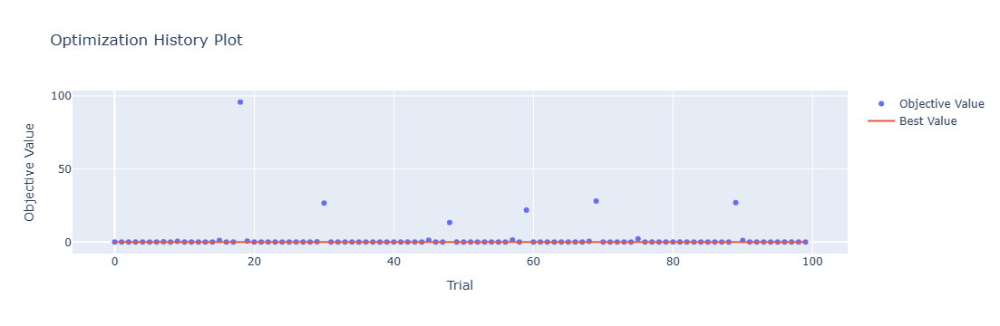

In [4]:
optuna.visualization.plot_optimization_history(study)

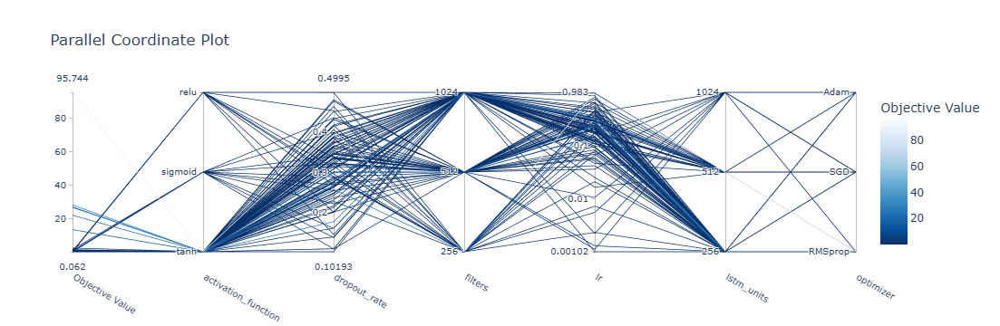

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

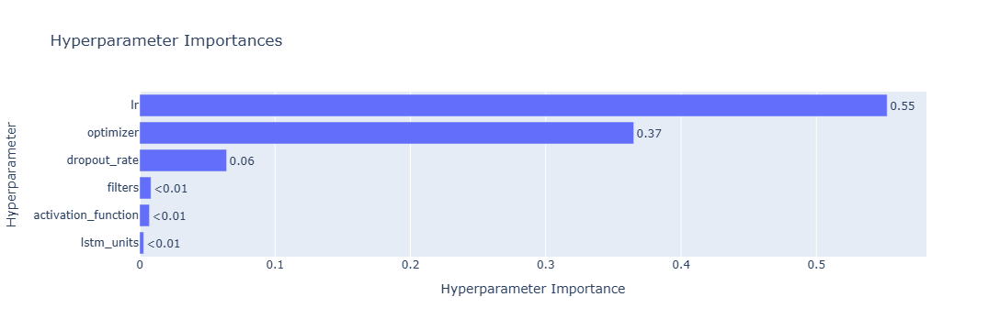

In [6]:
optuna.visualization.plot_param_importances(study)

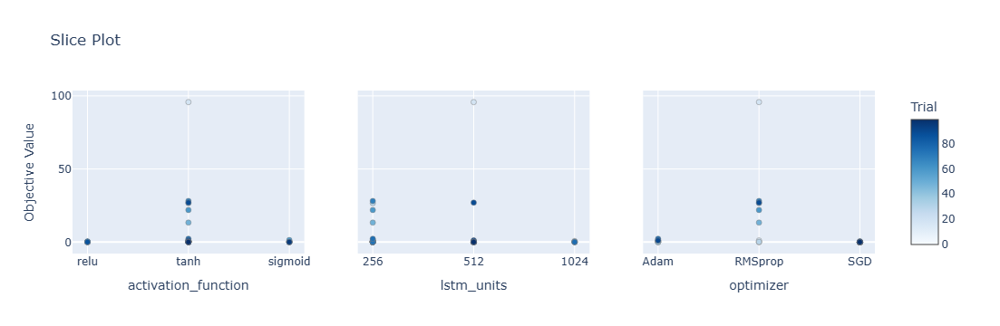

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

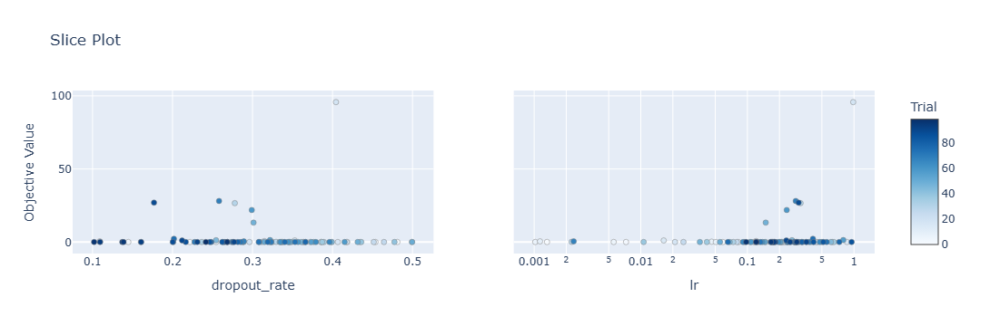

In [9]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 34s 180ms/step - loss: 0.1307 - accuracy: 0.1667 - mae: 0.1116 - rmse: 0.1307 - mape: 23.4334 - pearson: 0.5910 - val_loss: 0.0792 - val_accuracy: 0.7000 - val_mae: 0.0637 - val_rmse: 0.0792 - val_mape: 14.1269 - val_pearson: 0.6835
Epoch 2/100
84/84 [==============================] - 8s 96ms/step - loss: 0.0744 - accuracy: 0.3571 - mae: 0.0590 - rmse: 0.0744 - mape: 13.1751 - pearson: 0.7345 - val_loss: 0.0651 - val_accuracy: 0.7000 - val_mae: 0.0500 - val_rmse: 0.0651 - val_mape: 10.7158 - val_pearson: 0.7719
Epoch 3/100
84/84 [==============================] - 8s 91ms/step - loss: 0.0706 - accuracy: 0.4167 - mae: 0.0556 - rmse: 0.0706 - mape: 12.5135 - pearson: 0.7581 - v

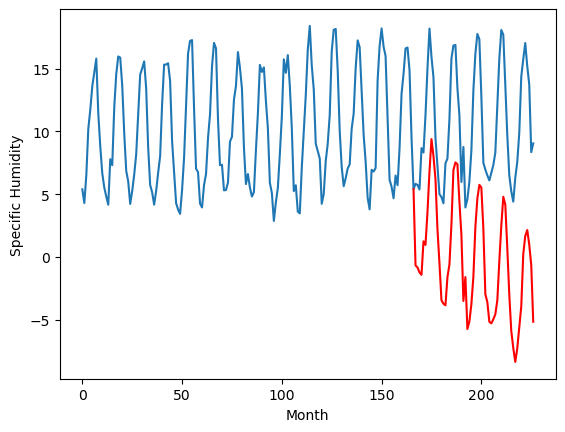

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		-0.63		0.23
-0.53		-0.34		0.19
-0.97		-1.02		-0.05
-0.24		-0.88		-0.64
3.64		1.42		-2.22
1.85		1.16		-0.69
4.17		3.18		-0.99
7.85		6.47		-1.38
9.51		8.60		-0.91
9.45		8.56		-0.89
7.35		6.99		-0.36
4.79		4.04		-0.75
1.46		0.27		-1.19
-2.06		-3.33		-1.27
-1.71		-3.60		-1.89
-1.00		-2.99		-1.99
1.21		-1.52		-2.73
1.43		-0.65		-2.08
3.92		1.85		-2.07
8.67		6.42		-2.25
9.47		7.05		-2.42
9.63		7.22		-2.41
7.47		4.93		-2.54
4.39		2.36		-2.03
-1.27		-3.42		-2.15
2.37		-0.85		-3.22
-2.39		-5.30		-2.91
-1.17		-4.35		-3.18
0.74		-3.16		-3.90
2.04		-1.44		-3.48
6.28		2.19		-4.09
8.89		4.22		-4.67
9.79		5.79		-4.00
9.22		5.39		-3.83
6.16		2.60		-3.56
1.02		-2.66		-3.68
0.82		-2.99		-3.81
-0.38		-4.94		-4.56
-0.29		-5.02		-4.73
1.40		-4.37		-5.77
1.78		-4.47		-6.25
2.57		-2.99		-5.56
4.76		-1.27		-6.03
8.09		1.61		-6.48
9.76		4.62		-5.14
10.54		4.00		-6.54
6.52		0.69		-5.83
1.82		-3.03		-4.85
-0.36	

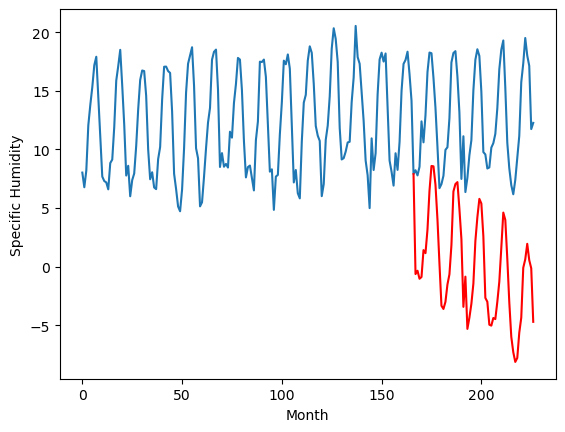

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		2.34		0.11
2.48		2.58		0.10
2.31		1.94		-0.37
2.86		1.99		-0.87
5.46		4.01		-1.45
4.21		3.82		-0.39
7.07		6.09		-0.98
10.98		9.53		-1.45
13.38		11.94		-1.44
13.47		11.64		-1.83
10.38		9.67		-0.71
7.63		6.58		-1.05
4.30		3.12		-1.18
1.14		-0.02		-1.16
1.52		-0.41		-1.93
1.67		-0.09		-1.76
3.52		1.40		-2.12
3.76		2.45		-1.31
6.52		4.75		-1.77
11.14		9.54		-1.60
13.05		10.27		-2.78
13.25		10.56		-2.69
10.25		7.95		-2.30
7.53		5.58		-1.95
1.66		-0.29		-1.95
4.06		1.76		-2.30
0.65		-2.13		-2.78
1.86		-1.29		-3.15
2.57		-0.10		-2.67
4.02		1.39		-2.63
8.16		5.11		-3.05
10.94		7.13		-3.81
13.14		8.99		-4.15
12.44		8.63		-3.81
8.71		5.73		-2.98
3.71		0.53		-3.18
3.39		0.01		-3.38
2.06		-1.89		-3.95
2.43		-1.79		-4.22
3.54		-1.49		-5.03
2.90		-1.63		-4.53
4.34		-0.01		-4.35
7.12		1.52		-5.60
9.70		4.46		-5.24
12.56		7.90		-4.66
12.65		7.17		-5.48
9.07		3.94		-5.13
5.16		0.27		-4.89
2.63		-2.88		-

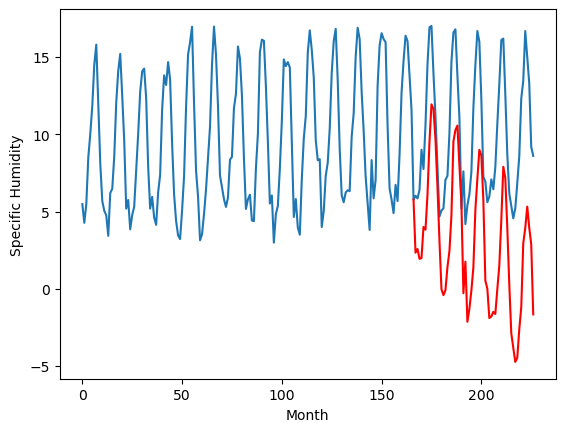

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		-0.06		0.42
0.06		-0.10		-0.16
0.30		-0.60		-0.90
0.44		-0.61		-1.05
4.75		2.27		-2.48
3.60		1.86		-1.74
5.75		4.17		-1.58
8.24		7.33		-0.91
10.99		9.63		-1.36
9.74		8.77		-0.97
8.39		7.32		-1.07
4.58		3.64		-0.94
1.53		0.36		-1.17
-1.54		-3.20		-1.66
-1.47		-3.41		-1.94
-1.56		-3.09		-1.53
1.89		-1.00		-2.89
2.46		-0.17		-2.63
5.97		3.06		-2.91
9.87		7.35		-2.52
10.71		7.86		-2.85
10.33		7.72		-2.61
8.02		5.12		-2.90
5.59		2.30		-3.29
-0.62		-3.19		-2.57
2.43		-0.54		-2.97
-2.69		-5.37		-2.68
-1.48		-4.54		-3.06
-0.39		-3.22		-2.83
2.53		-0.90		-3.43
6.77		2.99		-3.78
8.78		5.21		-3.57
9.99		6.15		-3.84
9.27		5.86		-3.41
5.89		2.71		-3.18
0.79		-2.66		-3.45
0.27		-2.98		-3.25
-0.23		-4.72		-4.49
-0.04		-5.00		-4.96
0.63		-4.24		-4.87
1.71		-3.95		-5.66
2.11		-2.84		-4.95
4.96		0.13		-4.83
9.11		2.99		-6.12
10.14		5.13		-5.01
9.89		4.50		-5.39
7.71		0.99		-6.72
3.14		-2.83		-5.97
0.15	

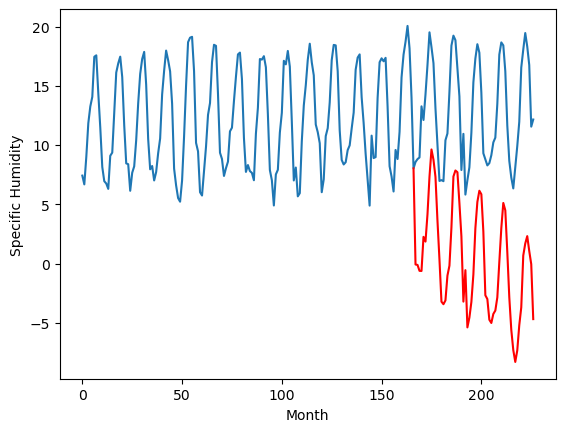

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		3.26		-1.03
3.04		2.80		-0.24
3.83		2.59		-1.24
3.22		2.25		-0.97
7.67		5.42		-2.25
7.39		5.03		-2.36
9.97		7.78		-2.19
12.33		10.71		-1.62
15.19		13.29		-1.90
12.92		11.32		-1.60
11.61		9.73		-1.88
7.33		5.20		-2.13
5.48		2.95		-2.53
2.70		0.06		-2.64
2.63		-0.10		-2.73
2.23		-0.46		-2.69
5.07		2.24		-2.83
6.47		3.15		-3.32
10.48		6.98		-3.50
14.17		10.85		-3.32
14.88		11.34		-3.54
14.80		10.85		-3.95
10.57		7.74		-2.83
8.48		4.83		-3.65
4.26		0.14		-4.12
7.02		2.03		-4.99
1.52		-2.33		-3.85
1.78		-1.90		-3.68
3.33		-0.41		-3.74
7.25		2.27		-4.98
10.95		6.28		-4.67
11.92		8.72		-3.20
11.68		9.13		-2.55
12.77		9.06		-3.71
9.94		5.58		-4.36
5.14		0.48		-4.66
5.13		-0.21		-5.34
4.05		-1.51		-5.56
3.29		-1.86		-5.15
3.63		-1.44		-5.07
5.82		-0.66		-6.48
6.58		0.04		-6.54
10.52		4.29		-6.23
14.64		6.97		-7.67
13.22		8.28		-4.94
11.40		7.74		-3.66
11.36		4.15		-7.21
7.61		0.46		-7.15
4.81		-

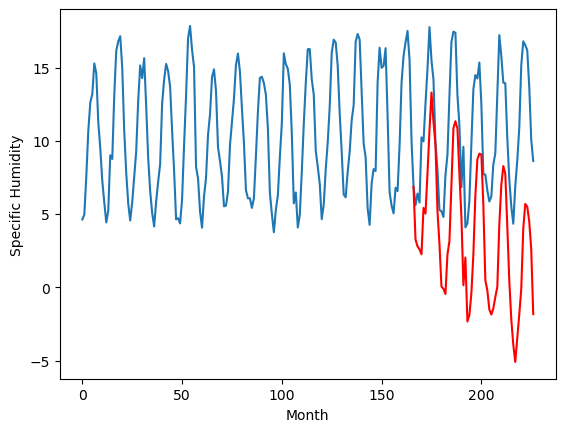

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		-0.97		-0.16
-0.85		-0.65		0.20
-1.33		-1.32		0.01
-1.44		-1.27		0.17
0.32		0.39		0.07
0.66		0.31		-0.35
3.79		2.52		-1.27
7.52		6.00		-1.52
11.00		8.44		-2.56
11.03		8.37		-2.66
8.13		6.24		-1.89
4.43		3.37		-1.06
1.48		-0.11		-1.59
-2.28		-3.03		-0.75
-2.89		-3.47		-0.58
-2.30		-3.17		-0.87
-0.73		-1.94		-1.21
0.28		-0.81		-1.09
2.78		1.12		-1.66
8.04		6.00		-2.04
9.16		6.84		-2.32
10.32		7.27		-3.05
6.23		4.69		-1.54
3.91		2.48		-1.43
-1.35		-3.38		-2.03
0.07		-1.65		-1.72
-3.04		-5.10		-2.06
-1.66		-4.28		-2.62
-0.33		-3.14		-2.81
0.80		-1.99		-2.79
5.58		1.60		-3.98
6.67		3.53		-3.14
11.00		5.71		-5.29
9.21		5.37		-3.84
6.51		2.61		-3.90
1.87		-2.40		-4.27
1.21		-3.04		-4.25
-2.14		-4.95		-2.81
-1.39		-4.70		-3.31
-0.46		-4.63		-4.17
-0.68		-4.89		-4.21
2.00		-3.11		-5.11
2.76		-2.13		-4.89
6.66		0.79		-5.87
11.01		4.66		-6.35
10.12		3.90		-6.22
7.00		0.82		-6.18
2.60		-2.74		-5.3

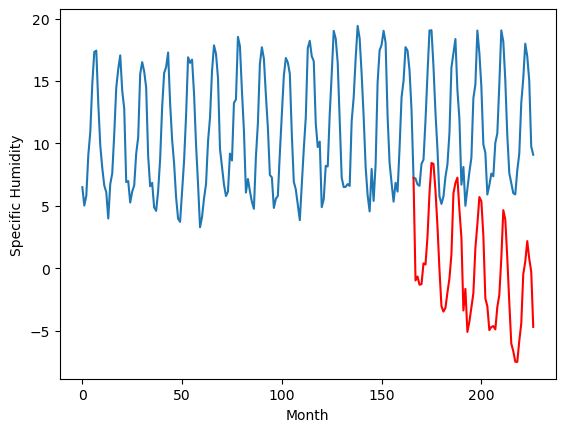

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		0.93		-0.45
1.50		1.21		-0.29
1.42		0.57		-0.85
1.78		0.60		-1.18
3.41		2.33		-1.08
3.19		2.23		-0.96
6.29		4.52		-1.77
10.01		8.02		-1.99
12.80		10.52		-2.28
12.74		10.29		-2.45
9.21		8.13		-1.08
6.49		5.14		-1.35
3.64		1.75		-1.89
0.77		-1.15		-1.92
0.62		-1.60		-2.22
0.67		-1.37		-2.04
2.26		-0.03		-2.29
2.86		1.10		-1.76
5.86		3.13		-2.73
10.24		8.02		-2.22
11.68		8.85		-2.83
12.21		9.25		-2.96
8.89		6.58		-2.31
6.78		4.36		-2.42
1.03		-1.52		-2.55
2.87		0.21		-2.66
0.09		-3.28		-3.37
1.37		-2.48		-3.85
2.38		-1.33		-3.71
3.38		-0.10		-3.48
7.74		3.56		-4.18
9.62		5.52		-4.10
13.24		7.65		-5.59
11.89		7.32		-4.57
8.45		4.48		-3.97
3.89		-0.59		-4.48
3.29		-1.24		-4.53
1.11		-3.13		-4.24
1.97		-2.89		-4.86
2.65		-2.82		-5.47
2.24		-3.04		-5.28
4.45		-1.29		-5.74
6.04		-0.15		-6.19
8.77		2.79		-5.98
12.51		6.61		-5.90
12.14		5.83		-6.31
9.20		2.71		-6.49
4.94		-0.87		-5.81
1.61		-4.16

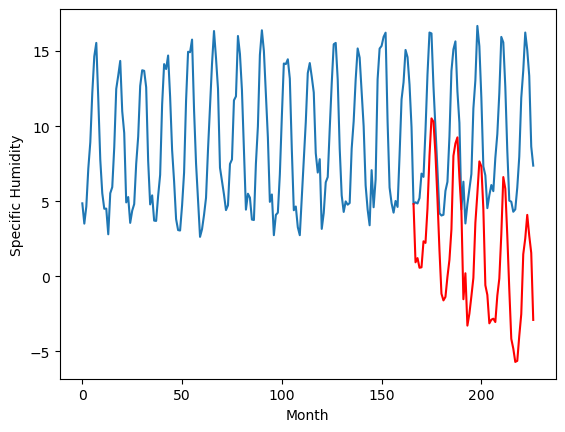

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		-0.57		-0.52
0.20		-0.31		-0.51
0.23		-0.93		-1.16
0.45		-0.94		-1.39
1.75		0.70		-1.05
1.69		0.63		-1.06
3.68		2.97		-0.71
8.35		6.49		-1.86
11.16		9.07		-2.09
11.40		8.78		-2.62
7.50		6.52		-0.98
4.79		3.49		-1.30
2.25		0.19		-2.06
-0.62		-2.56		-1.94
-0.93		-3.03		-2.10
-0.90		-2.89		-1.99
0.72		-1.56		-2.28
1.42		-0.38		-1.80
4.44		1.58		-2.86
8.71		6.51		-2.20
10.21		7.37		-2.84
10.49		7.81		-2.68
7.00		5.06		-1.94
5.12		2.90		-2.22
-0.67		-2.96		-2.29
1.10		-1.41		-2.51
-1.41		-4.71		-3.30
-0.18		-3.96		-3.78
0.81		-2.79		-3.60
1.71		-1.64		-3.35
6.00		2.02		-3.98
7.45		3.97		-3.48
10.82		6.18		-4.64
9.75		5.88		-3.87
6.96		3.03		-3.93
2.54		-1.99		-4.53
1.84		-2.70		-4.54
-0.50		-4.56		-4.06
0.43		-4.26		-4.69
0.79		-4.32		-5.11
0.71		-4.54		-5.25
2.99		-2.75		-5.74
4.31		-1.68		-5.99
6.93		1.25		-5.68
11.28		5.19		-6.09
10.22		4.38		-5.84
7.42		1.29		-6.13
3.67		-2.25		-5.92
0.

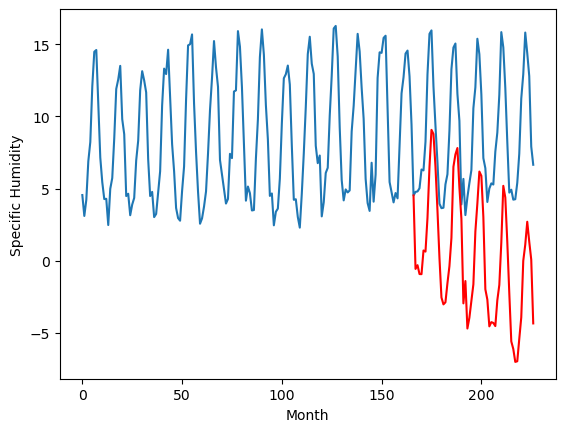

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		0.26		-1.01
1.36		0.07		-1.29
0.96		-0.29		-1.25
0.95		-0.60		-1.55
3.21		1.66		-1.55
3.45		1.52		-1.93
6.67		4.38		-2.29
10.32		7.69		-2.63
13.41		10.51		-2.90
11.38		8.95		-2.43
8.66		6.71		-1.95
4.21		2.67		-1.54
2.45		0.36		-2.09
0.54		-2.04		-2.58
0.31		-2.43		-2.74
-0.37		-2.86		-2.49
2.69		-0.69		-3.38
3.42		0.51		-2.91
6.33		3.39		-2.94
11.31		7.88		-3.43
12.81		8.62		-4.19
13.00		8.61		-4.39
9.19		5.36		-3.83
6.77		2.96		-3.81
1.48		-2.22		-3.70
3.07		-1.03		-4.10
-0.21		-4.39		-4.18
0.38		-3.96		-4.34
2.06		-2.58		-4.64
3.64		-0.73		-4.37
7.83		3.21		-4.62
10.01		5.48		-4.53
13.67		6.93		-6.74
12.70		6.75		-5.95
8.25		3.45		-4.80
3.02		-1.61		-4.63
2.02		-2.53		-4.55
1.09		-4.00		-5.09
1.69		-3.92		-5.61
1.76		-4.03		-5.79
2.20		-3.69		-5.89
3.42		-2.43		-5.85
6.91		0.36		-6.55
9.19		3.21		-5.98
12.74		6.00		-6.74
12.74		5.35		-7.39
8.67		1.99		-6.68
4.61		-1.57		-6.18
1.95		-

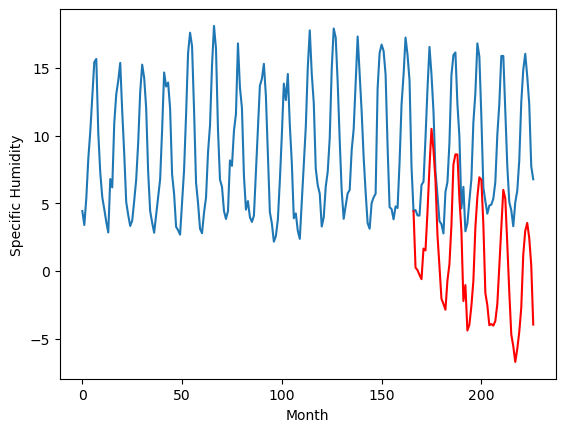

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		-0.17		-0.95
1.19		-0.13		-1.32
0.69		-0.58		-1.27
0.37		-0.82		-1.19
2.33		0.84		-1.49
2.39		0.83		-1.56
5.53		3.53		-2.00
8.22		7.02		-1.20
11.36		9.88		-1.48
10.14		8.91		-1.23
7.35		6.37		-0.98
4.01		2.84		-1.17
1.96		0.22		-1.74
0.30		-1.99		-2.29
-0.03		-2.50		-2.47
-0.48		-2.82		-2.34
1.32		-1.17		-2.49
2.64		0.16		-2.48
4.73		2.31		-2.42
9.50		7.14		-2.36
10.43		8.04		-2.39
10.85		8.39		-2.46
7.68		5.23		-2.45
6.37		3.15		-3.22
0.85		-2.37		-3.22
1.69		-1.45		-3.14
-0.60		-4.26		-3.66
0.14		-3.77		-3.91
1.42		-2.50		-3.92
3.04		-1.26		-4.30
7.65		2.51		-5.14
9.33		4.57		-4.76
12.91		6.69		-6.22
11.37		6.50		-4.87
8.31		3.44		-4.87
2.52		-1.47		-3.99
1.80		-2.46		-4.26
0.87		-4.07		-4.94
1.48		-3.72		-5.20
1.25		-4.11		-5.36
1.35		-4.10		-5.45
3.08		-2.45		-5.53
5.52		-0.86		-6.38
8.14		2.03		-6.11
11.96		5.81		-6.15
10.66		5.01		-5.65
7.94		1.89		-6.05
4.70		-1.55		-6.25
1.35		

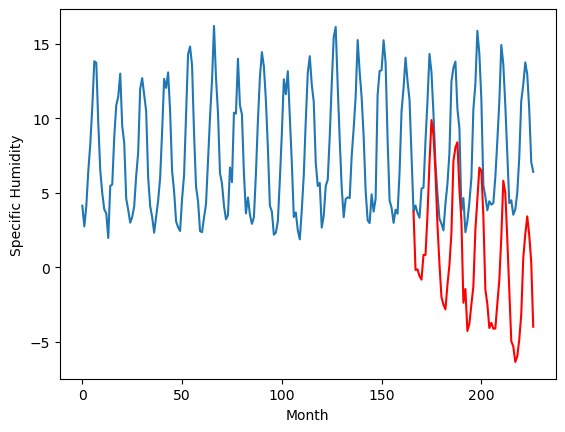

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		0.01		-0.48
0.61		-0.01		-0.62
0.23		-0.40		-0.63
-0.28		-0.75		-0.47
1.32		0.67		-0.65
1.68		0.76		-0.92
4.58		3.60		-0.98
7.68		7.12		-0.56
10.73		10.16		-0.57
9.16		8.96		-0.20
6.50		6.16		-0.34
3.05		2.53		-0.52
1.64		0.26		-1.38
0.11		-1.51		-1.62
-0.27		-2.10		-1.83
-1.01		-2.67		-1.66
0.61		-1.04		-1.65
2.21		0.42		-1.79
3.73		2.41		-1.32
8.86		7.26		-1.60
9.93		8.25		-1.68
10.42		8.68		-1.74
6.80		5.32		-1.48
5.81		3.40		-2.41
0.96		-1.96		-2.92
0.96		-1.58		-2.54
-1.11		-3.82		-2.71
-0.51		-3.48		-2.97
0.74		-2.20		-2.94
1.68		-1.16		-2.84
5.40		2.58		-2.82
6.67		4.62		-2.05
9.16		6.92		-2.24
10.15		6.82		-3.33
7.55		3.73		-3.82
2.53		-0.99		-3.52
1.39		-2.21		-3.60
0.22		-3.68		-3.90
0.62		-3.19		-3.81
0.06		-3.93		-3.99
0.52		-3.89		-4.41
2.16		-2.17		-4.33
3.37		-0.70		-4.07
6.38		2.15		-4.23
10.21		6.17		-4.04
9.46		5.33		-4.13
8.15		2.33		-5.82
4.39		-0.99		-5.38
0.98		-4

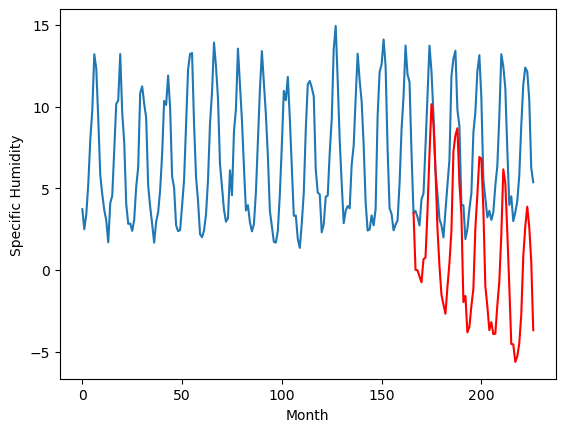

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03  -0.654833
1                 1   -0.86  -0.626546
2                 2    2.23   2.338681
3                 3   -0.48  -0.064182
4                 4    4.29   3.262881
5                 5   -0.81  -0.973987
6                 6    1.38   0.934634
7                 7   -0.05  -0.574013
8                 8    1.27   0.255132
9                 9    0.78  -0.170776
10               10    0.49   0.014685


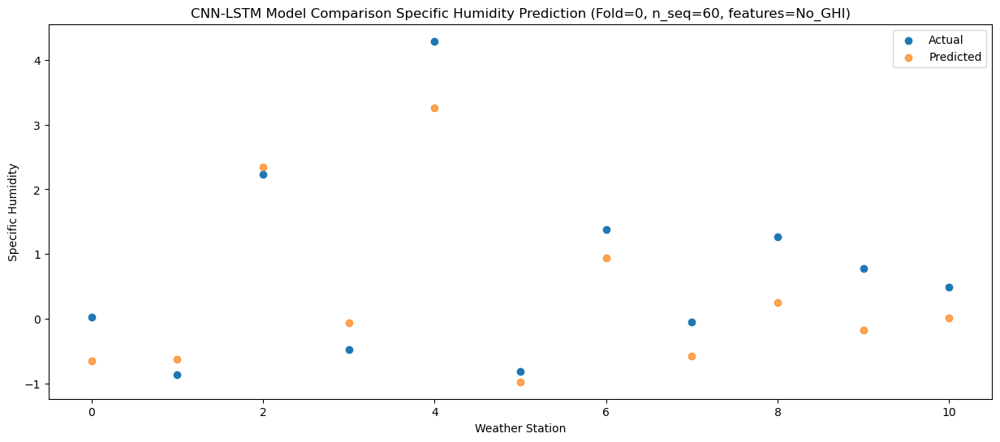

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46  -0.824979
1                 1   -0.53  -0.341304
2                 2    2.48   2.578624
3                 3    0.06  -0.100731
4                 4    3.04   2.803150
5                 5   -0.85  -0.652057
6                 6    1.50   1.214343
7                 7    0.20  -0.314577
8                 8    1.36   0.071471
9                 9    1.19  -0.129308
10               10    0.61  -0.011957


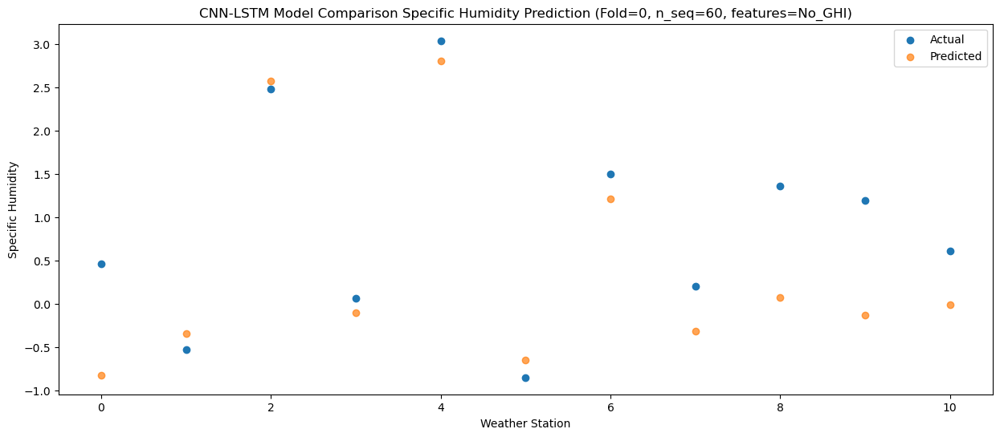

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37  -1.213582
1                 1   -0.97  -1.023637
2                 2    2.31   1.938033
3                 3    0.30  -0.599631
4                 4    3.83   2.594129
5                 5   -1.33  -1.316954
6                 6    1.42   0.572061
7                 7    0.23  -0.929844
8                 8    0.96  -0.286003
9                 9    0.69  -0.582605
10               10    0.23  -0.395378


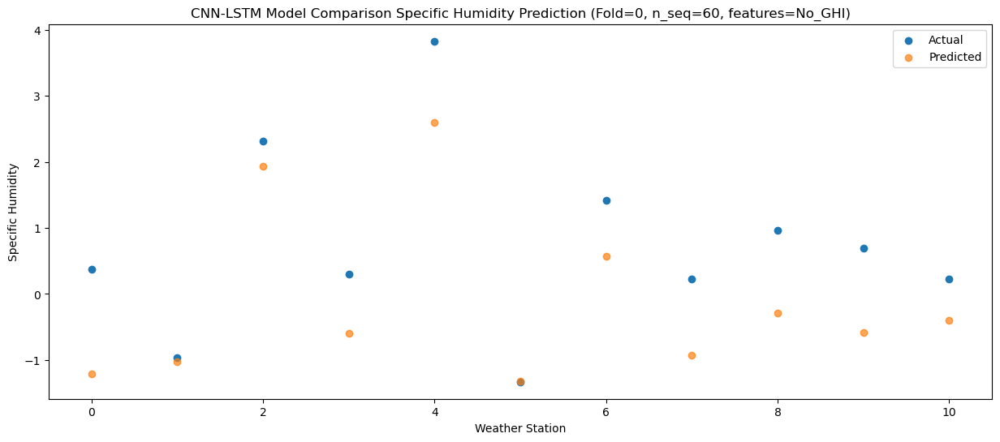

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01  -1.407528
1                 1   -0.24  -0.876400
2                 2    2.86   1.993492
3                 3    0.44  -0.611343
4                 4    3.22   2.250926
5                 5   -1.44  -1.265949
6                 6    1.78   0.602174
7                 7    0.45  -0.937547
8                 8    0.95  -0.598958
9                 9    0.37  -0.817557
10               10   -0.28  -0.747299


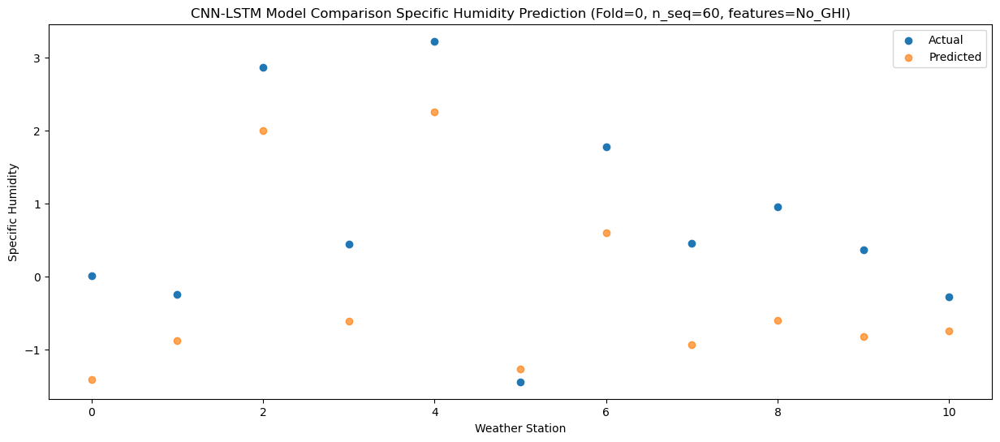

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   1.257491
1                 1    3.64   1.417383
2                 2    5.46   4.006792
3                 3    4.75   2.268101
4                 4    7.67   5.420947
5                 5    0.32   0.394293
6                 6    3.41   2.333687
7                 7    1.75   0.703760
8                 8    3.21   1.661276
9                 9    2.33   0.835989
10               10    1.32   0.666285


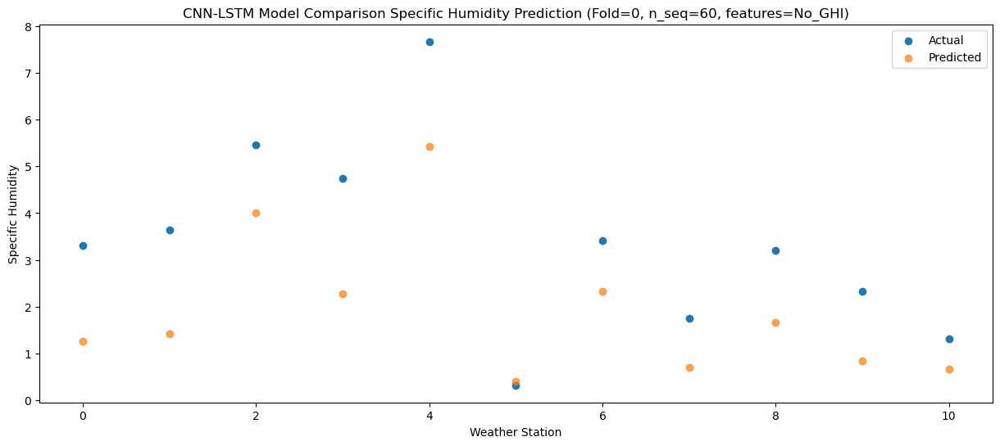

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   0.967262
1                 1    1.85   1.158294
2                 2    4.21   3.822770
3                 3    3.60   1.864854
4                 4    7.39   5.032368
5                 5    0.66   0.307571
6                 6    3.19   2.227078
7                 7    1.69   0.627968
8                 8    3.45   1.524591
9                 9    2.39   0.829335
10               10    1.68   0.761353


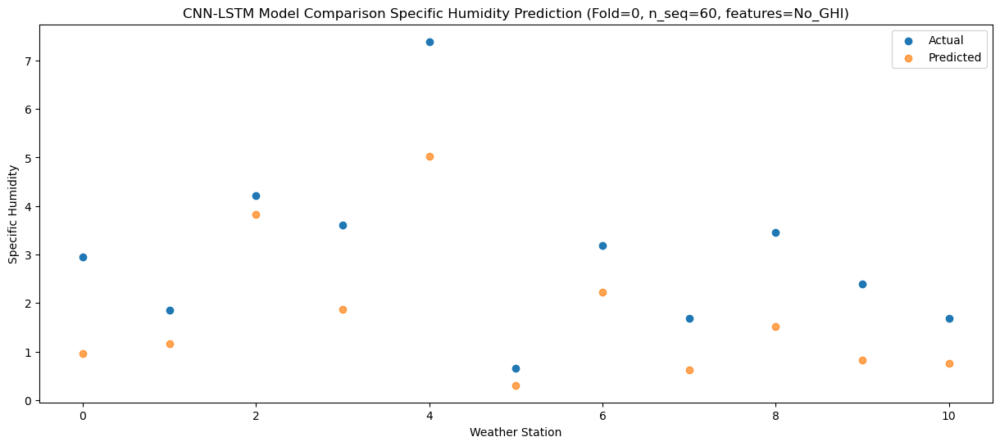

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   3.596299
1                 1    4.17   3.178750
2                 2    7.07   6.090432
3                 3    5.75   4.173090
4                 4    9.97   7.784612
5                 5    3.79   2.524854
6                 6    6.29   4.519742
7                 7    3.68   2.974206
8                 8    6.67   4.375552
9                 9    5.53   3.525770
10               10    4.58   3.596597


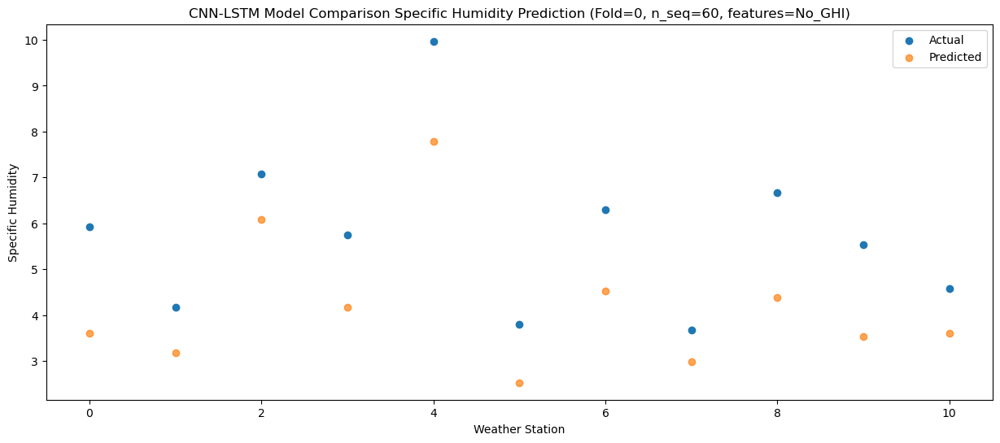

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68   6.798917
1                 1    7.85   6.470296
2                 2   10.98   9.526313
3                 3    8.24   7.331479
4                 4   12.33  10.713799
5                 5    7.52   6.004159
6                 6   10.01   8.015643
7                 7    8.35   6.491196
8                 8   10.32   7.694594
9                 9    8.22   7.018174
10               10    7.68   7.115219


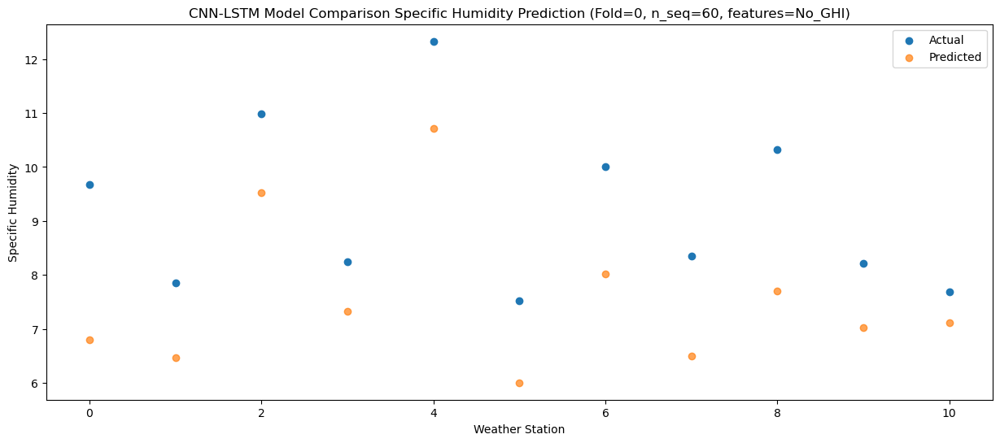

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81   9.385263
1                 1    9.51   8.596005
2                 2   13.38  11.938397
3                 3   10.99   9.633829
4                 4   15.19  13.291010
5                 5   11.00   8.440688
6                 6   12.80  10.516163
7                 7   11.16   9.071375
8                 8   13.41  10.507752
9                 9   11.36   9.883018
10               10   10.73  10.158460


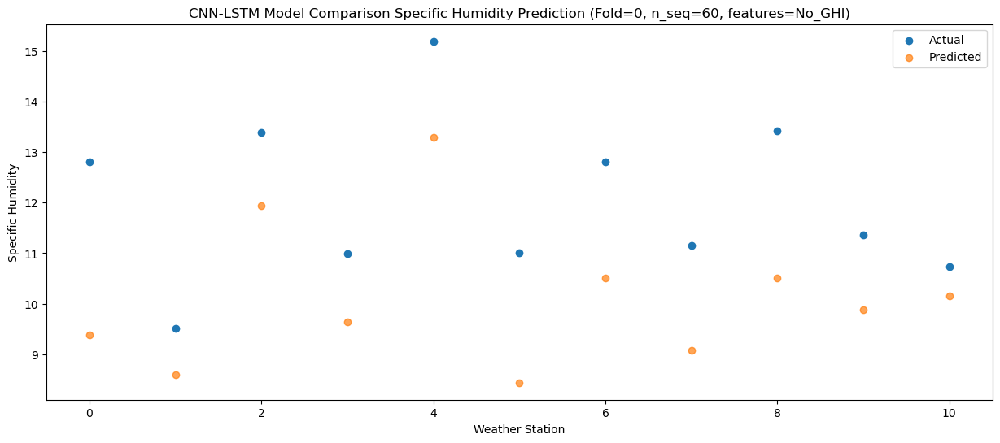

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   8.027311
1                 1    9.45   8.563303
2                 2   13.47  11.637246
3                 3    9.74   8.768161
4                 4   12.92  11.315508
5                 5   11.03   8.367125
6                 6   12.74  10.292707
7                 7   11.40   8.782306
8                 8   11.38   8.952609
9                 9   10.14   8.905048
10               10    9.16   8.964448


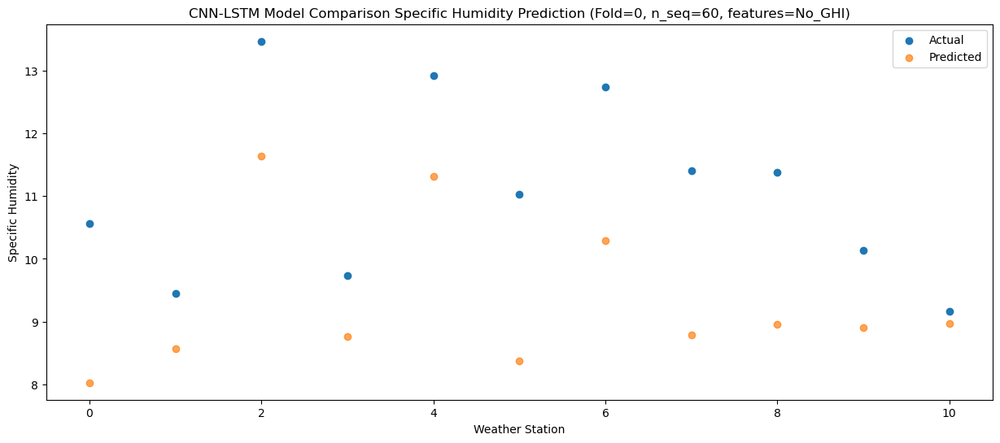

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92   6.202073
1                 1    7.35   6.994138
2                 2   10.38   9.673815
3                 3    8.39   7.320577
4                 4   11.61   9.732373
5                 5    8.13   6.235874
6                 6    9.21   8.130930
7                 7    7.50   6.515925
8                 8    8.66   6.705440
9                 9    7.35   6.369023
10               10    6.50   6.157566


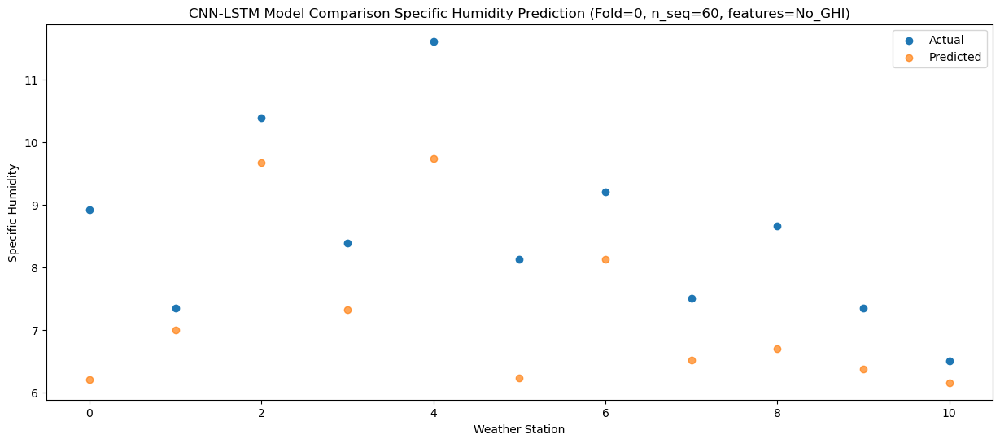

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   2.212831
1                 1    4.79   4.036552
2                 2    7.63   6.575965
3                 3    4.58   3.636990
4                 4    7.33   5.204854
5                 5    4.43   3.372866
6                 6    6.49   5.142551
7                 7    4.79   3.489779
8                 8    4.21   2.666414
9                 9    4.01   2.841009
10               10    3.05   2.530564


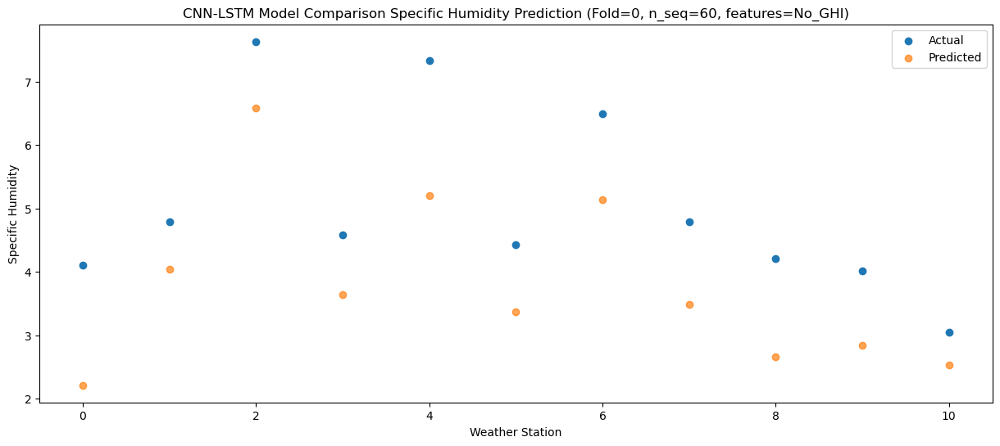

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87  -0.476693
1                 1    1.46   0.265113
2                 2    4.30   3.122660
3                 3    1.53   0.357418
4                 4    5.48   2.952570
5                 5    1.48  -0.106232
6                 6    3.64   1.745086
7                 7    2.25   0.192143
8                 8    2.45   0.358786
9                 9    1.96   0.223761
10               10    1.64   0.260217


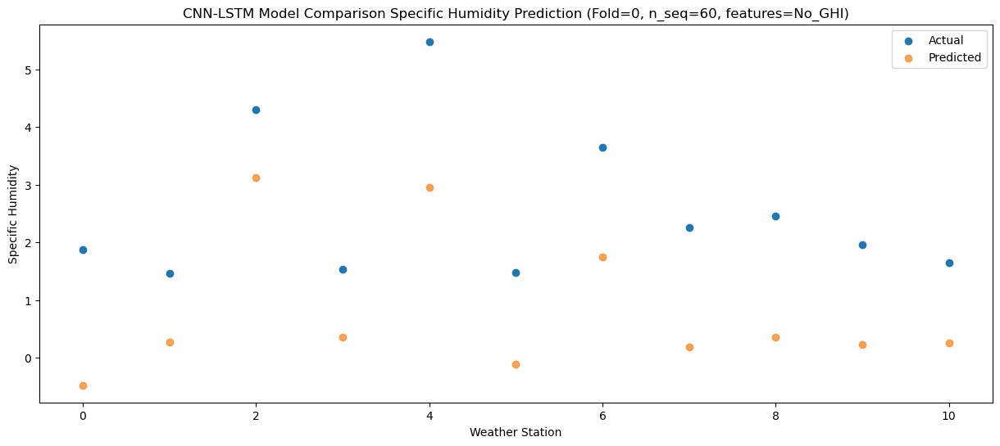

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36  -3.428653
1                 1   -2.06  -3.325955
2                 2    1.14  -0.022304
3                 3   -1.54  -3.197705
4                 4    2.70   0.061039
5                 5   -2.28  -3.031228
6                 6    0.77  -1.154735
7                 7   -0.62  -2.555975
8                 8    0.54  -2.044947
9                 9    0.30  -1.986230
10               10    0.11  -1.512260


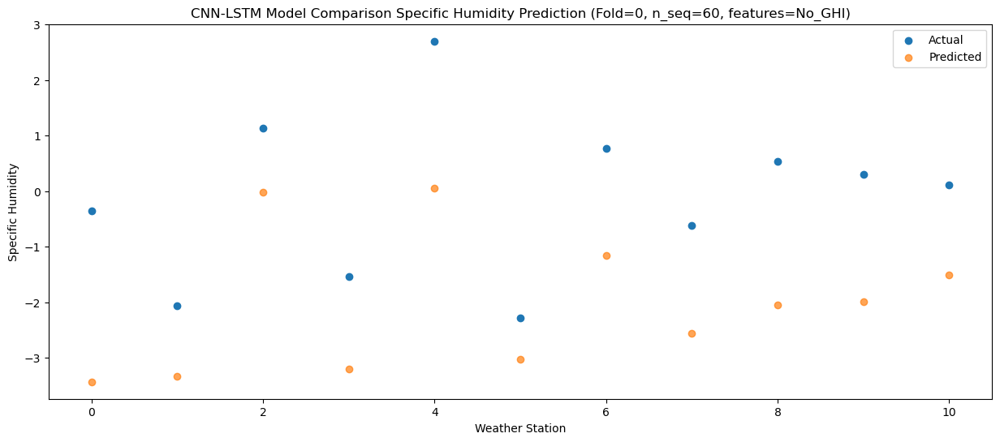

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60  -3.711769
1                 1   -1.71  -3.601141
2                 2    1.52  -0.406972
3                 3   -1.47  -3.413048
4                 4    2.63  -0.103011
5                 5   -2.89  -3.468167
6                 6    0.62  -1.601005
7                 7   -0.93  -3.033010
8                 8    0.31  -2.425198
9                 9   -0.03  -2.501600
10               10   -0.27  -2.101852


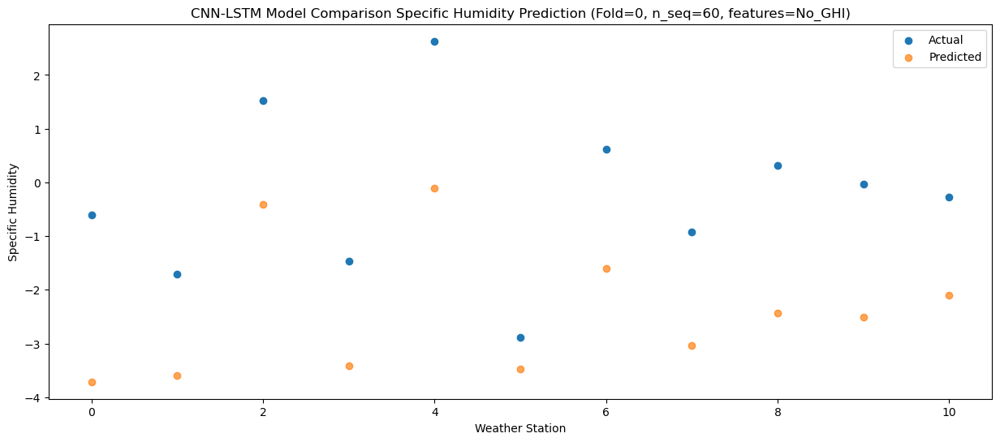

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -3.831312
1                 1   -1.00  -2.994219
2                 2    1.67  -0.090810
3                 3   -1.56  -3.093900
4                 4    2.23  -0.458863
5                 5   -2.30  -3.172563
6                 6    0.67  -1.368609
7                 7   -0.90  -2.888759
8                 8   -0.37  -2.857903
9                 9   -0.48  -2.819045
10               10   -1.01  -2.672624


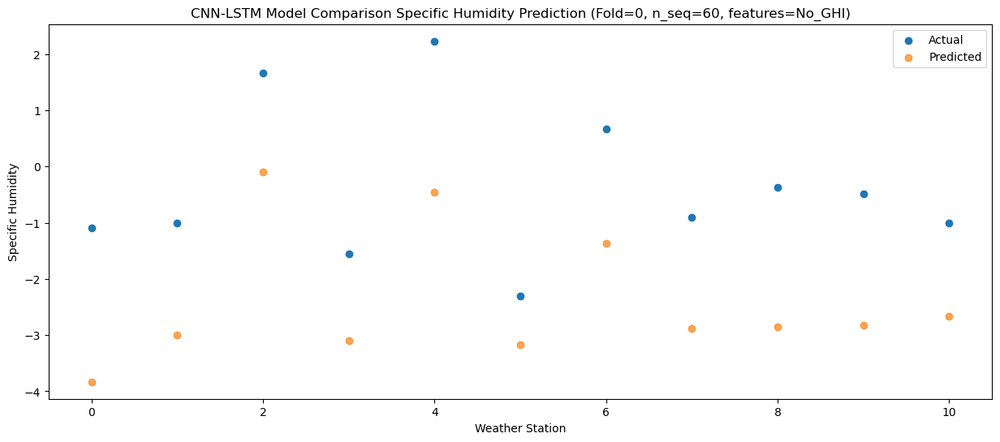

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08  -1.595423
1                 1    1.21  -1.516037
2                 2    3.52   1.402673
3                 3    1.89  -1.000893
4                 4    5.07   2.235849
5                 5   -0.73  -1.936321
6                 6    2.26  -0.033729
7                 7    0.72  -1.564990
8                 8    2.69  -0.685492
9                 9    1.32  -1.173233
10               10    0.61  -1.038184


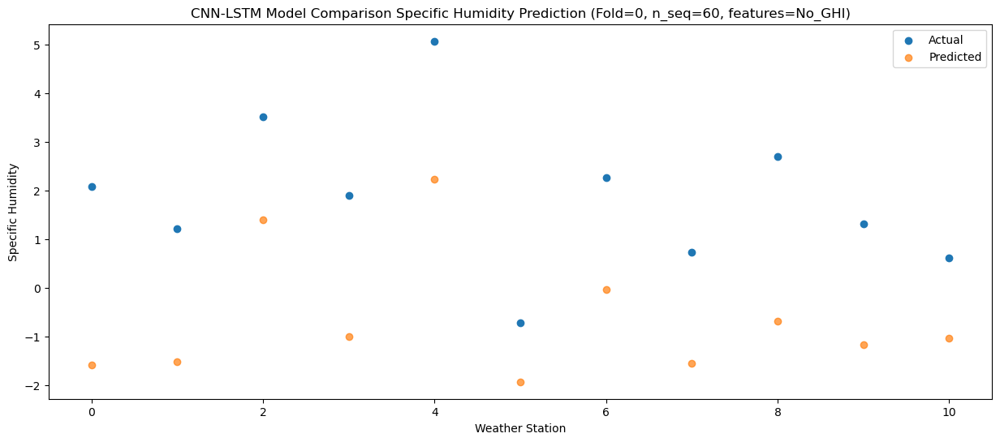

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47  -0.585181
1                 1    1.43  -0.647836
2                 2    3.76   2.446396
3                 3    2.46  -0.166566
4                 4    6.47   3.152609
5                 5    0.28  -0.814143
6                 6    2.86   1.097707
7                 7    1.42  -0.377079
8                 8    3.42   0.509302
9                 9    2.64   0.157443
10               10    2.21   0.420483


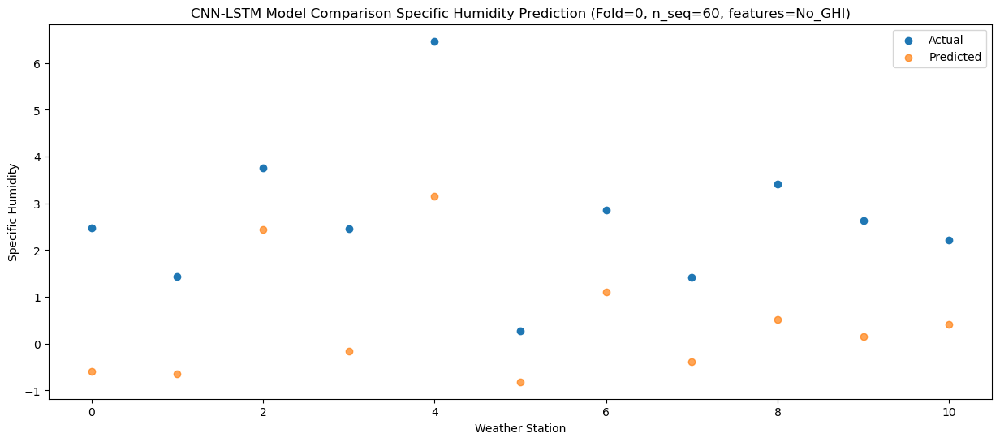

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   2.601654
1                 1    3.92   1.845461
2                 2    6.52   4.753995
3                 3    5.97   3.060786
4                 4   10.48   6.981103
5                 5    2.78   1.116919
6                 6    5.86   3.127033
7                 7    4.44   1.580351
8                 8    6.33   3.394587
9                 9    4.73   2.310774
10               10    3.73   2.410688


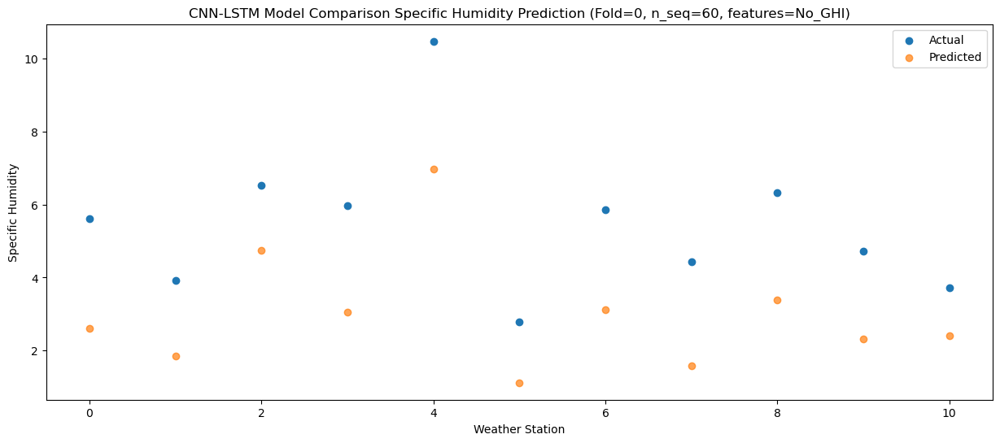

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43   6.925358
1                 1    8.67   6.419925
2                 2   11.14   9.536813
3                 3    9.87   7.352448
4                 4   14.17  10.854386
5                 5    8.04   6.003754
6                 6   10.24   8.023446
7                 7    8.71   6.511260
8                 8   11.31   7.876066
9                 9    9.50   7.141105
10               10    8.86   7.263665


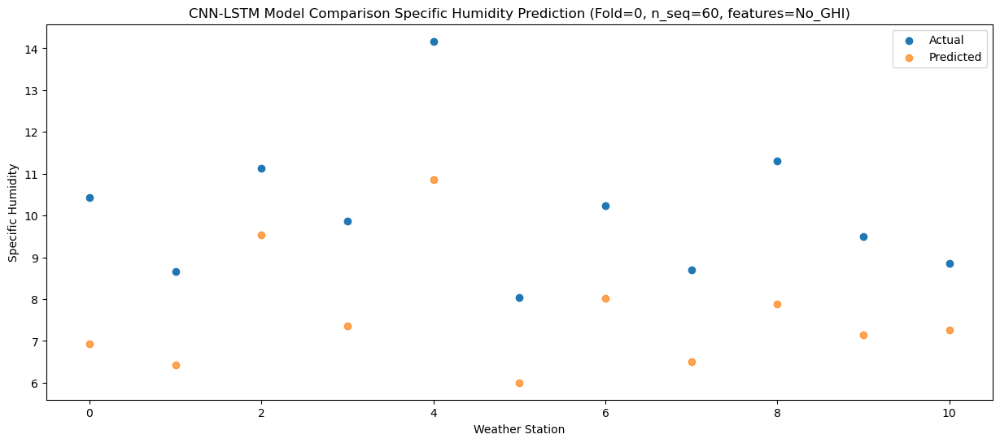

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46   7.532310
1                 1    9.47   7.052282
2                 2   13.05  10.274329
3                 3   10.71   7.860846
4                 4   14.88  11.338035
5                 5    9.16   6.840118
6                 6   11.68   8.847074
7                 7   10.21   7.368506
8                 8   12.81   8.620727
9                 9   10.43   8.040969
10               10    9.93   8.254882


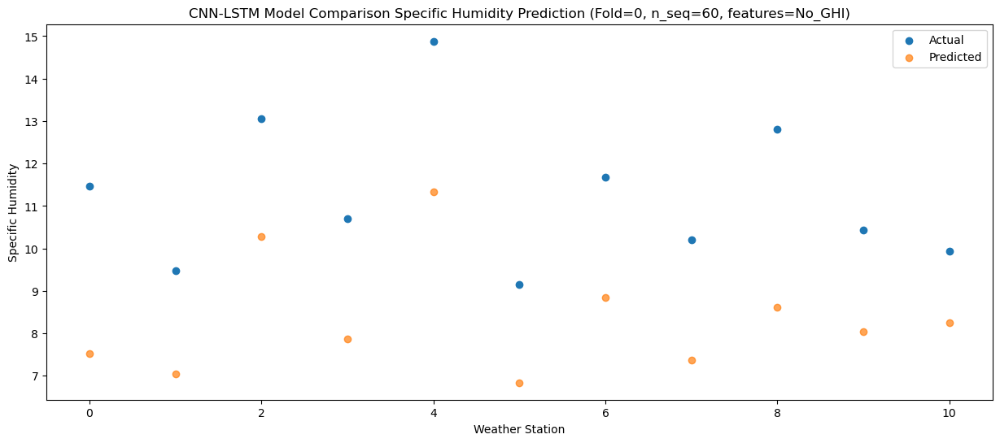

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51   7.397405
1                 1    9.63   7.218734
2                 2   13.25  10.561620
3                 3   10.33   7.718130
4                 4   14.80  10.845182
5                 5   10.32   7.266690
6                 6   12.21   9.253313
7                 7   10.49   7.811738
8                 8   13.00   8.613464
9                 9   10.85   8.394210
10               10   10.42   8.683292


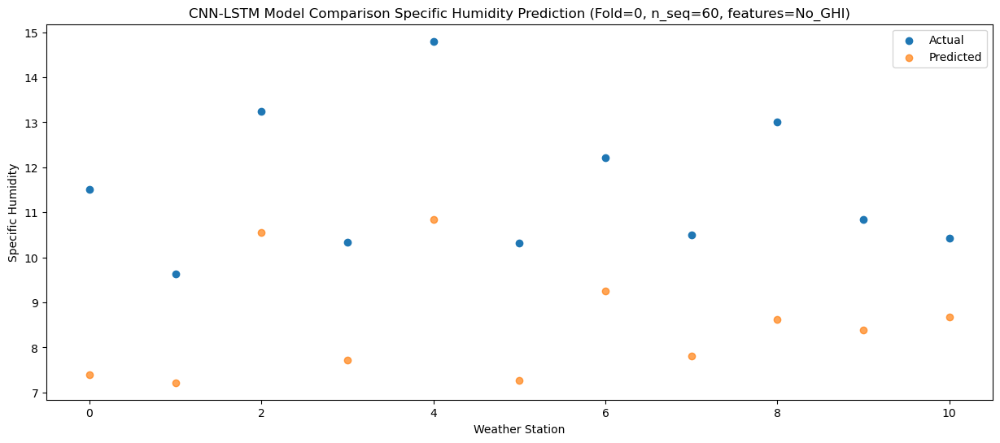

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   4.415740
1                 1    7.47   4.929250
2                 2   10.25   7.954169
3                 3    8.02   5.116247
4                 4   10.57   7.738736
5                 5    6.23   4.689541
6                 6    8.89   6.584316
7                 7    7.00   5.061312
8                 8    9.19   5.360842
9                 9    7.68   5.231185
10               10    6.80   5.322833


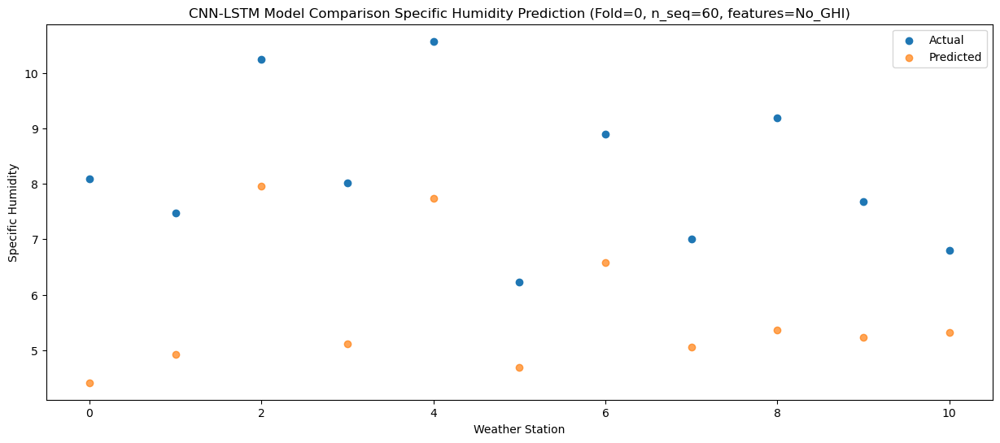

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   1.764265
1                 1    4.39   2.357474
2                 2    7.53   5.577598
3                 3    5.59   2.301014
4                 4    8.48   4.834008
5                 5    3.91   2.476906
6                 6    6.78   4.360602
7                 7    5.12   2.902327
8                 8    6.77   2.960562
9                 9    6.37   3.150494
10               10    5.81   3.404111


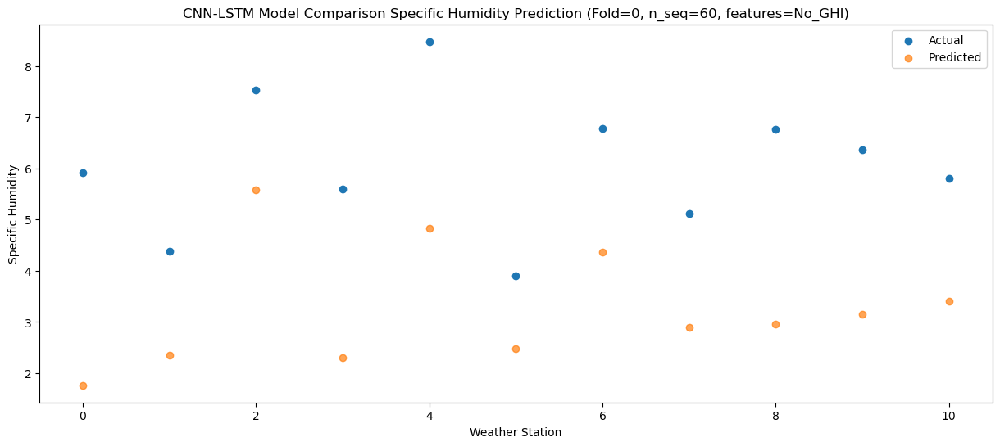

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61  -3.488349
1                 1   -1.27  -3.421368
2                 2    1.66  -0.285361
3                 3   -0.62  -3.194867
4                 4    4.26   0.139875
5                 5   -1.35  -3.378415
6                 6    1.03  -1.522856
7                 7   -0.67  -2.964050
8                 8    1.48  -2.216539
9                 9    0.85  -2.373965
10               10    0.96  -1.956011


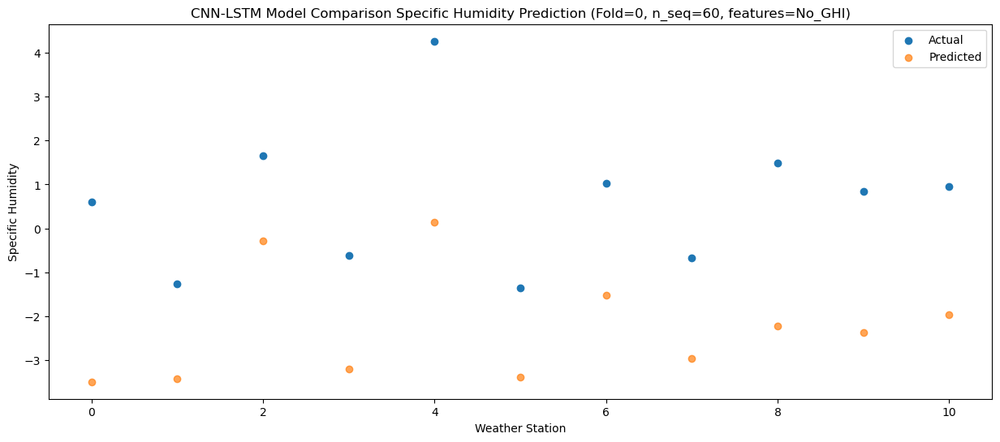

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39  -1.587085
1                 1    2.37  -0.845638
2                 2    4.06   1.760666
3                 3    2.43  -0.541835
4                 4    7.02   2.034406
5                 5    0.07  -1.645247
6                 6    2.87   0.205677
7                 7    1.10  -1.413637
8                 8    3.07  -1.034204
9                 9    1.69  -1.450793
10               10    0.96  -1.581782


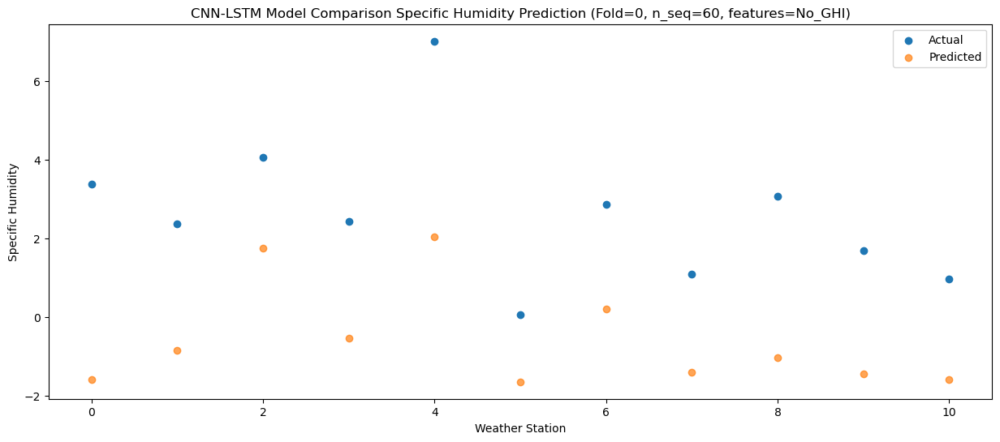

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -5.716092
1                 1   -2.39  -5.301732
2                 2    0.65  -2.132678
3                 3   -2.69  -5.368533
4                 4    1.52  -2.332050
5                 5   -3.04  -5.095537
6                 6    0.09  -3.278840
7                 7   -1.41  -4.706937
8                 8   -0.21  -4.390236
9                 9   -0.60  -4.263555
10               10   -1.11  -3.817467


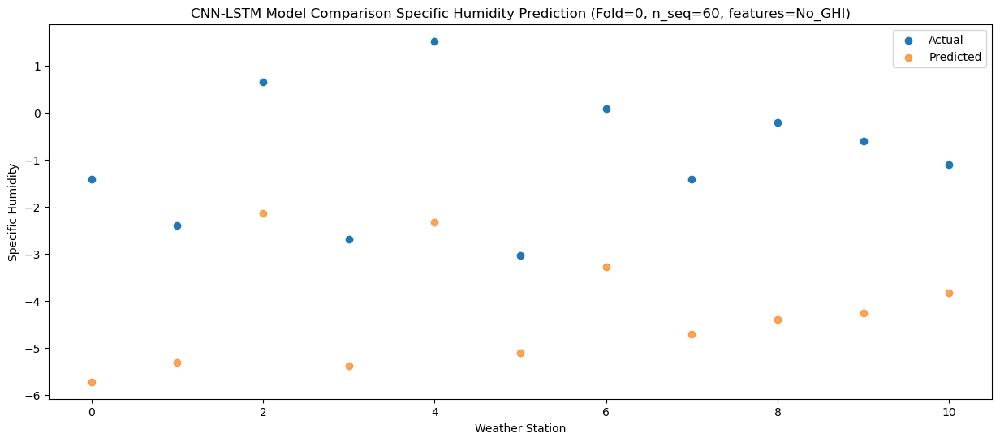

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76  -5.120212
1                 1   -1.17  -4.346248
2                 2    1.86  -1.292994
3                 3   -1.48  -4.543367
4                 4    1.78  -1.895373
5                 5   -1.66  -4.277881
6                 6    1.37  -2.484375
7                 7   -0.18  -3.955845
8                 8    0.38  -3.959142
9                 9    0.14  -3.771056
10               10   -0.51  -3.476741


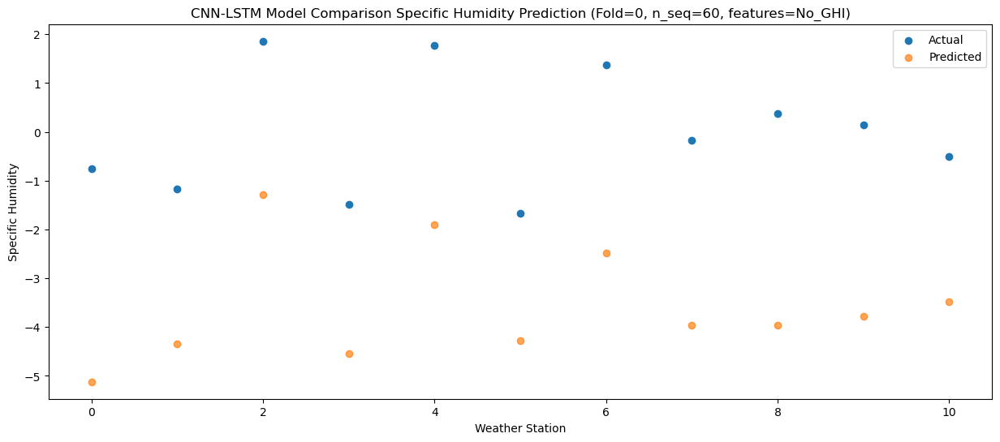

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64  -3.747927
1                 1    0.74  -3.157340
2                 2    2.57  -0.104038
3                 3   -0.39  -3.219796
4                 4    3.33  -0.411581
5                 5   -0.33  -3.138431
6                 6    2.38  -1.327188
7                 7    0.81  -2.793028
8                 8    2.06  -2.582466
9                 9    1.42  -2.502440
10               10    0.74  -2.197362


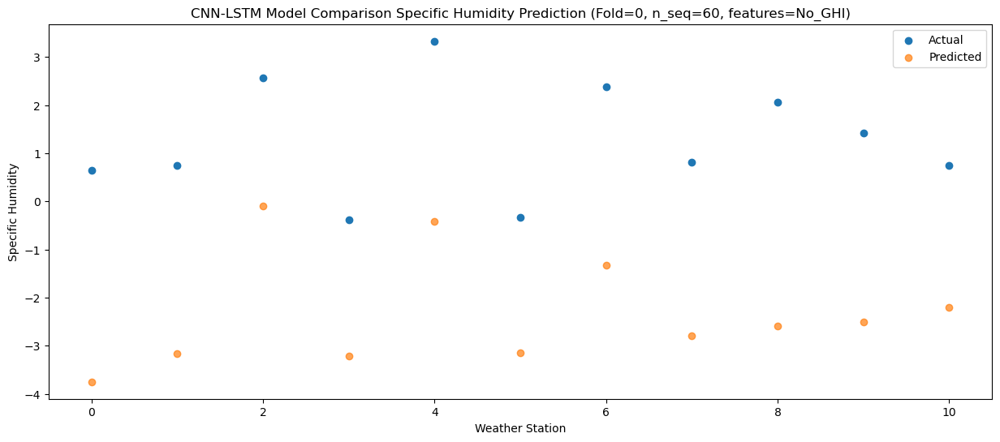

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11  -1.562342
1                 1    2.04  -1.443540
2                 2    4.02   1.387688
3                 3    2.53  -0.902182
4                 4    7.25   2.267422
5                 5    0.80  -1.991726
6                 6    3.38  -0.101685
7                 7    1.71  -1.643357
8                 8    3.64  -0.728674
9                 9    3.04  -1.264282
10               10    1.68  -1.157291


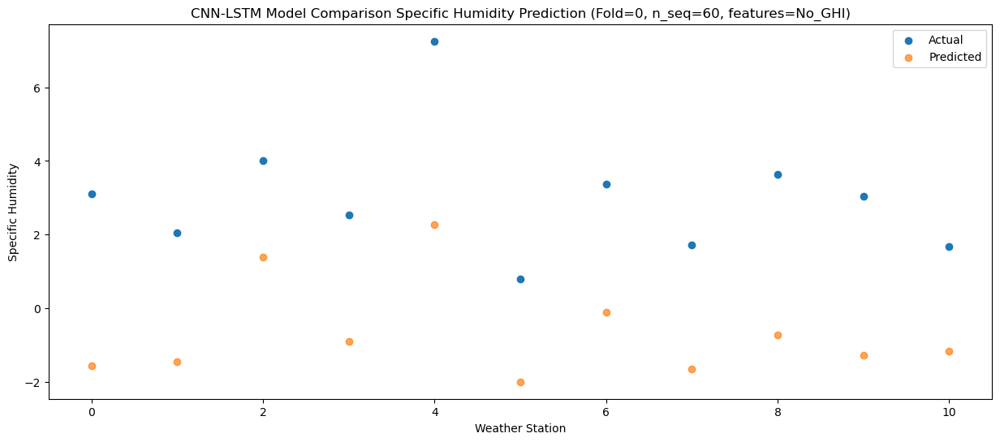

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88   2.391012
1                 1    6.28   2.189242
2                 2    8.16   5.110603
3                 3    6.77   2.991672
4                 4   10.95   6.276695
5                 5    5.58   1.600473
6                 6    7.74   3.562054
7                 7    6.00   2.024236
8                 8    7.83   3.210754
9                 9    7.65   2.514913
10               10    5.40   2.582512


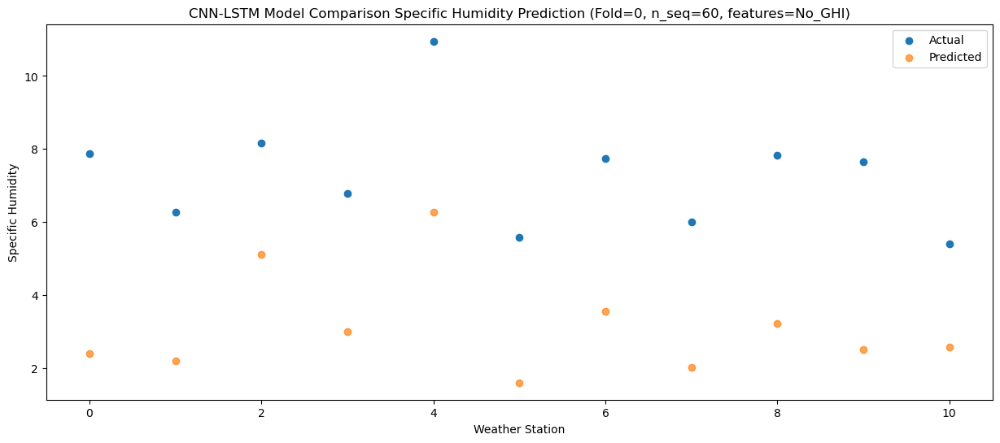

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80   4.668876
1                 1    8.89   4.220146
2                 2   10.94   7.125483
3                 3    8.78   5.209697
4                 4   11.92   8.718803
5                 5    6.67   3.526914
6                 6    9.62   5.518562
7                 7    7.45   3.966905
8                 8   10.01   5.476768
9                 9    9.33   4.570070
10               10    6.67   4.619699


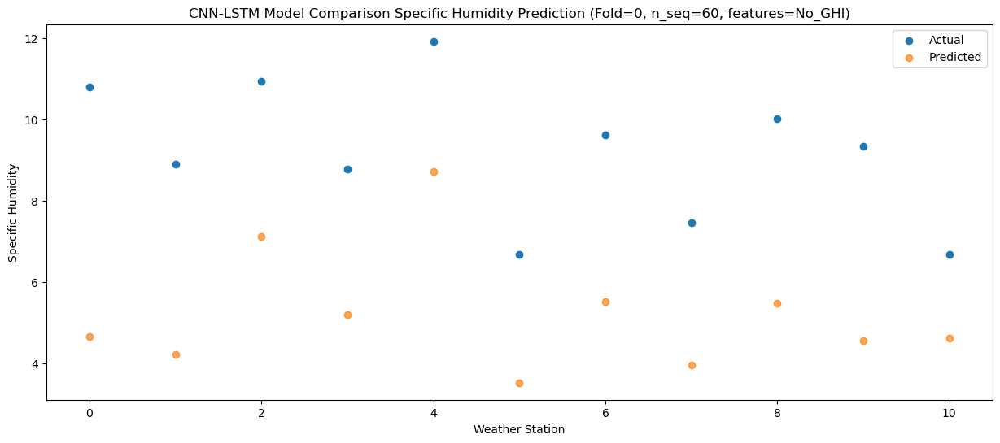

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38   5.747383
1                 1    9.79   5.789282
2                 2   13.14   8.994385
3                 3    9.99   6.154455
4                 4   11.68   9.125383
5                 5   11.00   5.708173
6                 6   13.24   7.652473
7                 7   10.82   6.180627
8                 8   13.67   6.925594
9                 9   12.91   6.688512
10               10    9.16   6.922591


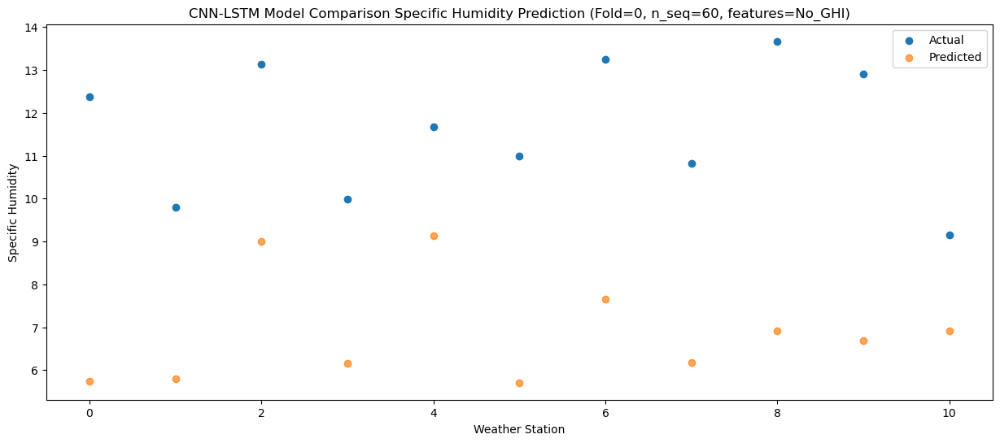

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96   5.537643
1                 1    9.22   5.392938
2                 2   12.44   8.631833
3                 3    9.27   5.856156
4                 4   12.77   9.056340
5                 5    9.21   5.373487
6                 6   11.89   7.318233
7                 7    9.75   5.880132
8                 8   12.70   6.751390
9                 9   11.37   6.504610
10               10   10.15   6.822612


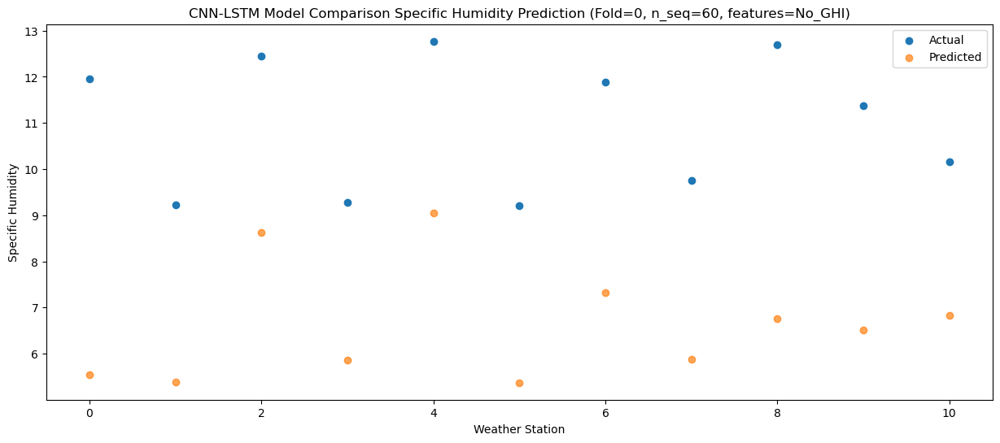

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   2.256834
1                 1    6.16   2.601050
2                 2    8.71   5.733932
3                 3    5.89   2.705170
4                 4    9.94   5.584167
5                 5    6.51   2.613516
6                 6    8.45   4.482517
7                 7    6.96   3.031830
8                 8    8.25   3.449582
9                 9    8.31   3.441631
10               10    7.55   3.733819


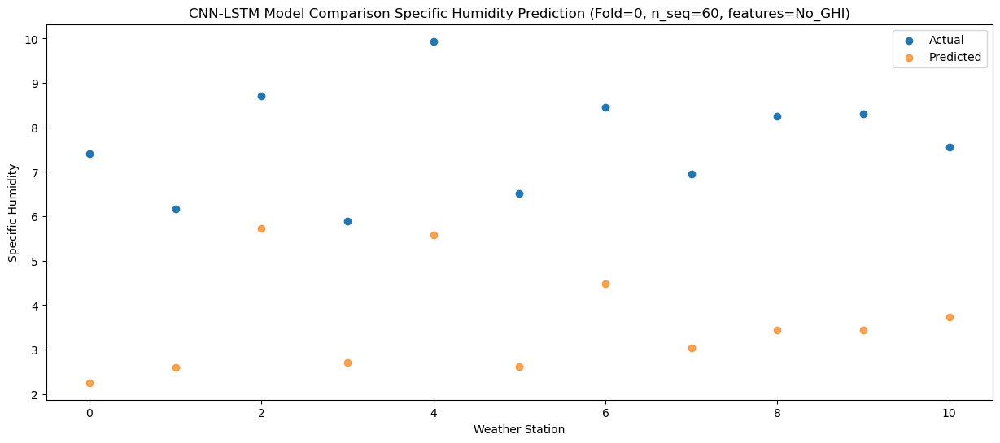

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13  -2.950739
1                 1    1.02  -2.657468
2                 2    3.71   0.531402
3                 3    0.79  -2.660374
4                 4    5.14   0.482495
5                 5    1.87  -2.400011
6                 6    3.89  -0.591371
7                 7    2.54  -1.985685
8                 8    3.02  -1.612506
9                 9    2.52  -1.471591
10               10    2.53  -0.992713


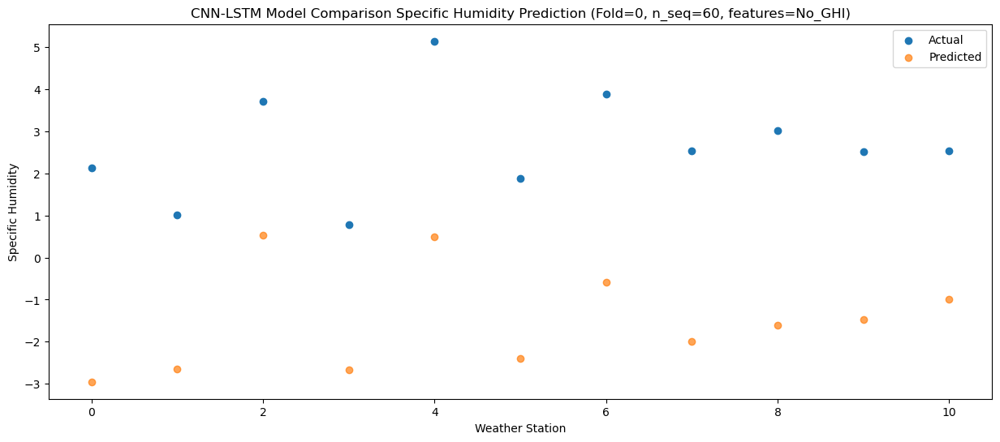

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59  -3.581755
1                 1    0.82  -2.987878
2                 2    3.39   0.010220
3                 3    0.27  -2.977417
4                 4    5.13  -0.210925
5                 5    1.21  -3.043773
6                 6    3.29  -1.235008
7                 7    1.84  -2.700300
8                 8    2.02  -2.529311
9                 9    1.80  -2.463707
10               10    1.39  -2.205714


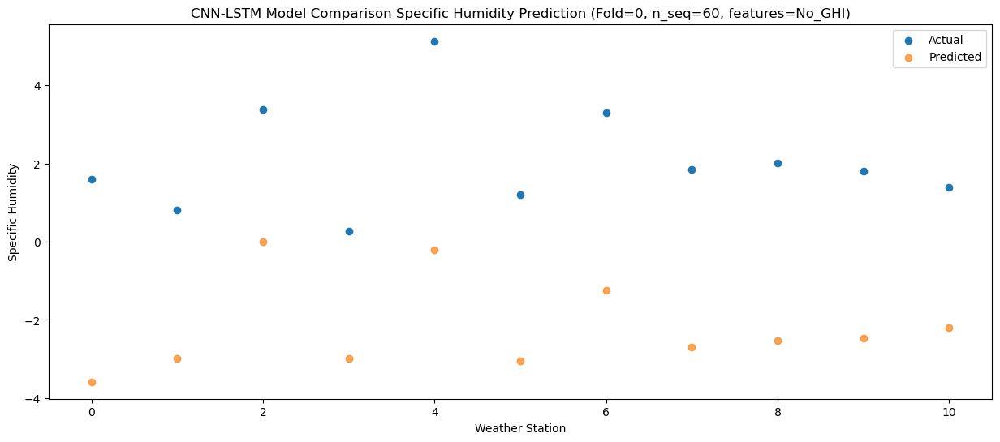

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13  -5.141323
1                 1   -0.38  -4.943815
2                 2    2.06  -1.893025
3                 3   -0.23  -4.722218
4                 4    4.05  -1.513091
5                 5   -2.14  -4.952345
6                 6    1.11  -3.127358
7                 7   -0.50  -4.558568
8                 8    1.09  -3.999085
9                 9    0.87  -4.071818
10               10    0.22  -3.679010


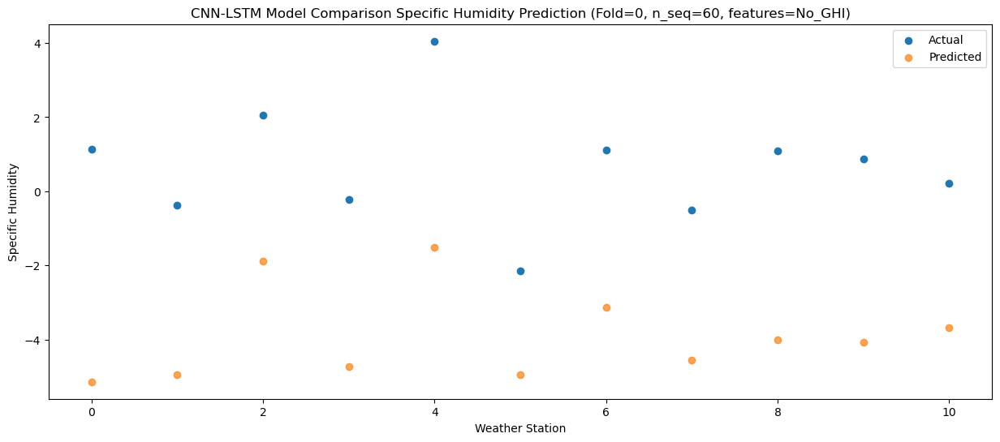

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73  -5.268989
1                 1   -0.29  -5.022049
2                 2    2.43  -1.785067
3                 3   -0.04  -4.995229
4                 4    3.29  -1.856926
5                 5   -1.39  -4.703776
6                 6    1.97  -2.886295
7                 7    0.43  -4.264423
8                 8    1.69  -3.915641
9                 9    1.48  -3.718251
10               10    0.62  -3.186836


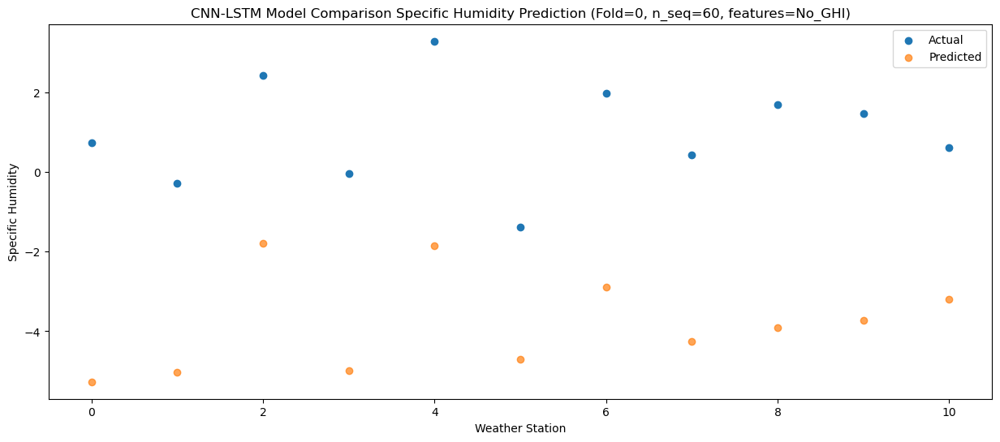

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35  -4.942304
1                 1    1.40  -4.369137
2                 2    3.54  -1.490574
3                 3    0.63  -4.235516
4                 4    3.63  -1.441425
5                 5   -0.46  -4.629453
6                 6    2.65  -2.817728
7                 7    0.79  -4.318793
8                 8    1.76  -4.028959
9                 9    1.25  -4.112974
10               10    0.06  -3.925338


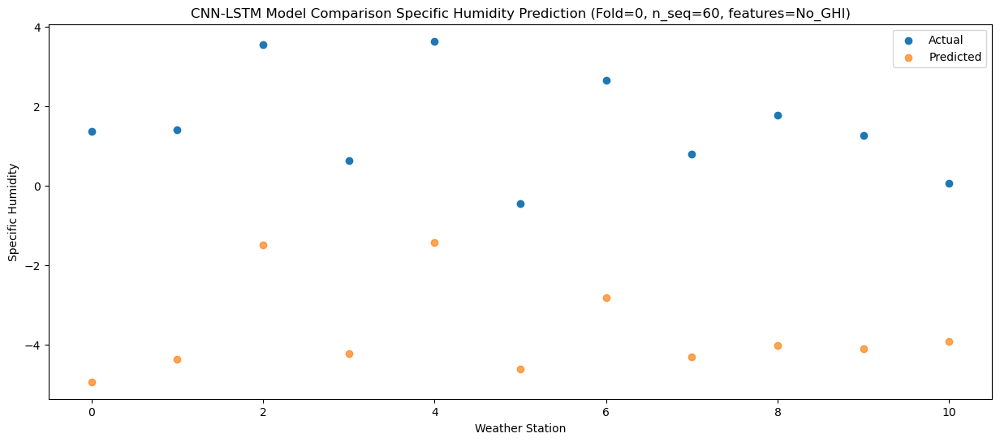

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95  -4.552420
1                 1    1.78  -4.465265
2                 2    2.90  -1.627470
3                 3    1.71  -3.948918
4                 4    5.82  -0.663284
5                 5   -0.68  -4.894335
6                 6    2.24  -3.040227
7                 7    0.71  -4.539249
8                 8    2.20  -3.689435
9                 9    1.35  -4.103054
10               10    0.52  -3.891329


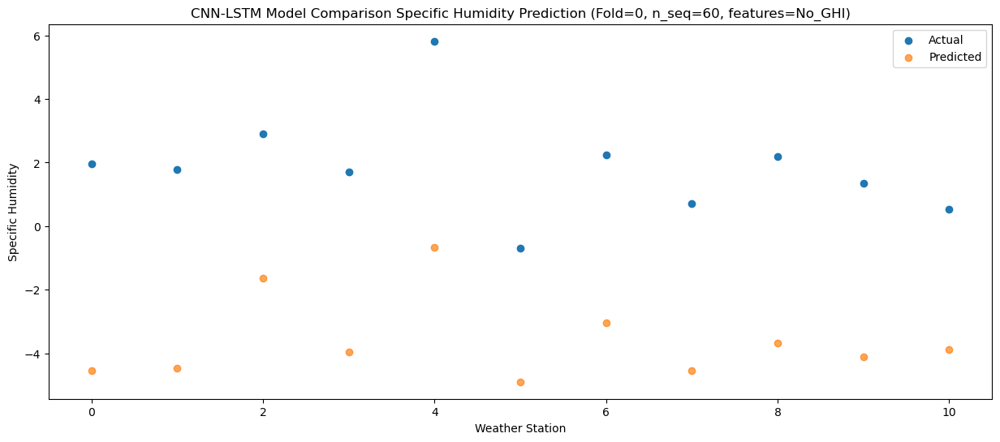

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94  -3.443072
1                 1    2.57  -2.992774
2                 2    4.34  -0.014831
3                 3    2.11  -2.840207
4                 4    6.58   0.038128
5                 5    2.00  -3.106401
6                 6    4.45  -1.285242
7                 7    2.99  -2.749506
8                 8    3.42  -2.434436
9                 9    3.08  -2.450103
10               10    2.16  -2.165193


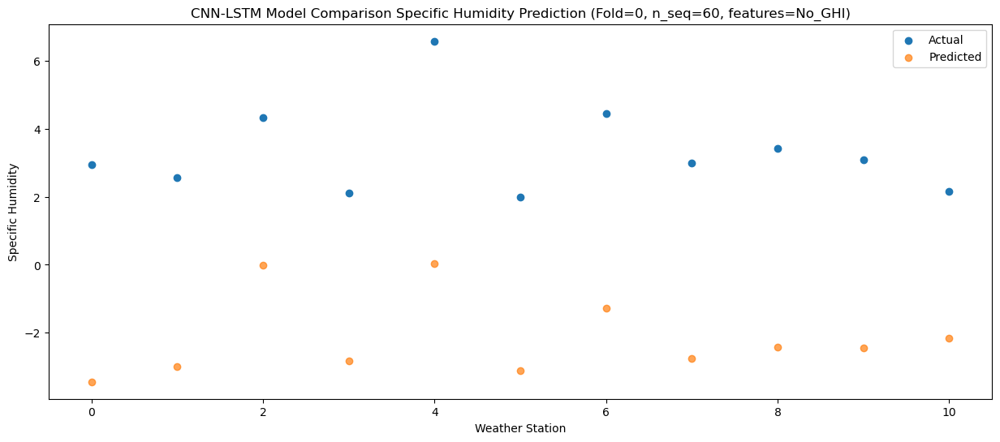

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62  -0.332721
1                 1    4.76  -1.267708
2                 2    7.12   1.515347
3                 3    4.96   0.132963
4                 4   10.52   4.294167
5                 5    2.76  -2.127957
6                 6    6.04  -0.146689
7                 7    4.31  -1.683895
8                 8    6.91   0.362193
9                 9    5.52  -0.856500
10               10    3.37  -0.701772


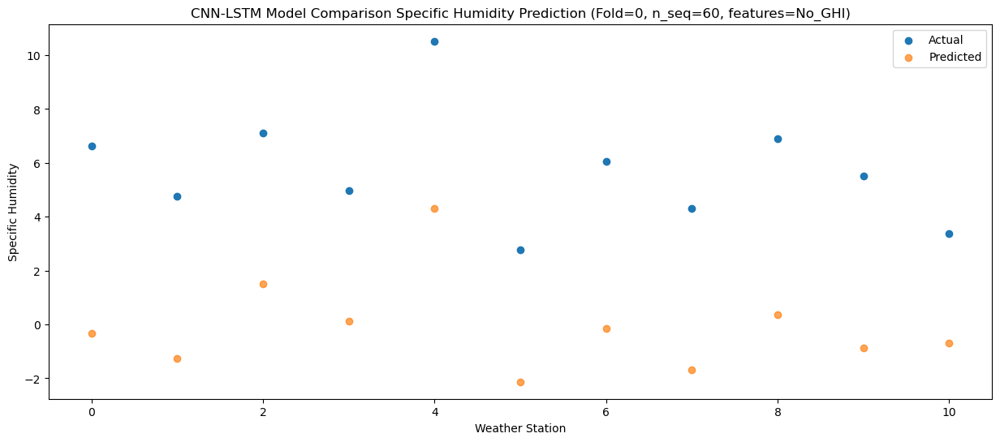

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41   2.501817
1                 1    8.09   1.614988
2                 2    9.70   4.463309
3                 3    9.11   2.993337
4                 4   14.64   6.967828
5                 5    6.66   0.785555
6                 6    8.77   2.793798
7                 7    6.93   1.250189
8                 8    9.19   3.206017
9                 9    8.14   2.025464
10               10    6.38   2.150724


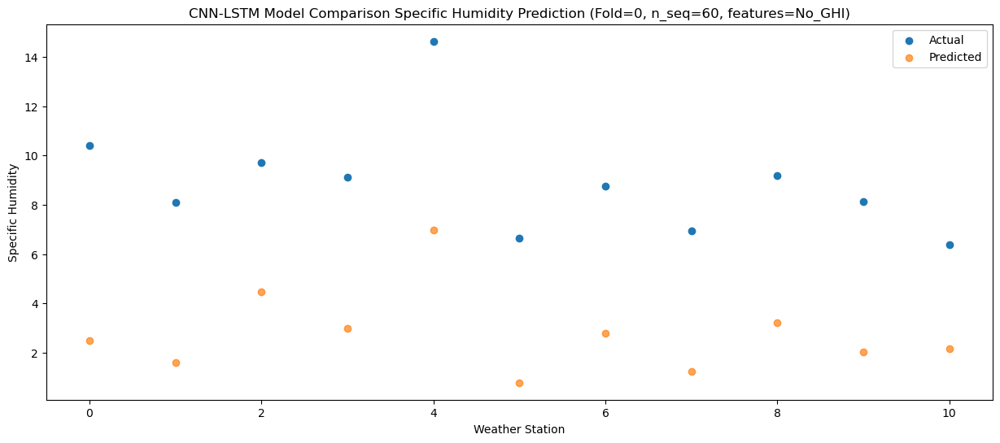

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70   4.797752
1                 1    9.76   4.618244
2                 2   12.56   7.897372
3                 3   10.14   5.125268
4                 4   13.22   8.277585
5                 5   11.01   4.660597
6                 6   12.51   6.608746
7                 7   11.28   5.188575
8                 8   12.74   5.997495
9                 9   11.96   5.810813
10               10   10.21   6.169862


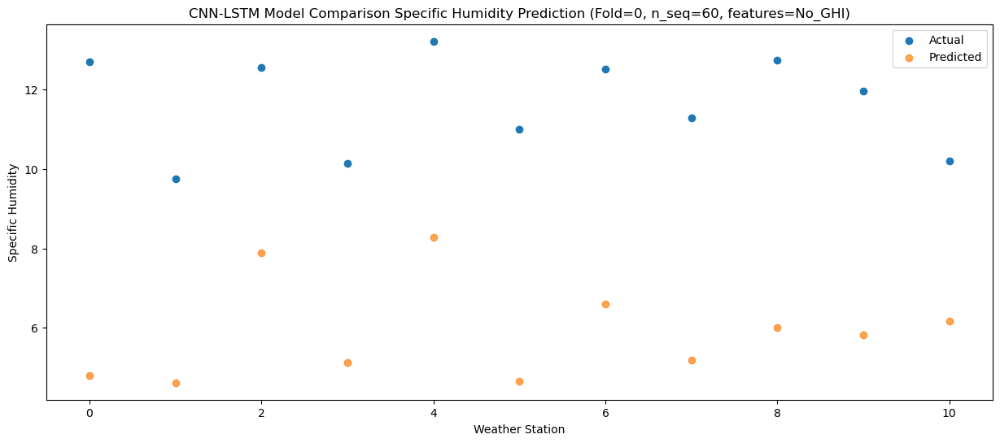

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32   4.168979
1                 1   10.54   3.996330
2                 2   12.65   7.171575
3                 3    9.89   4.503458
4                 4   11.40   7.739814
5                 5   10.12   3.902292
6                 6   12.14   5.833405
7                 7   10.22   4.376531
8                 8   12.74   5.350562
9                 9   10.66   5.006279
10               10    9.46   5.329495


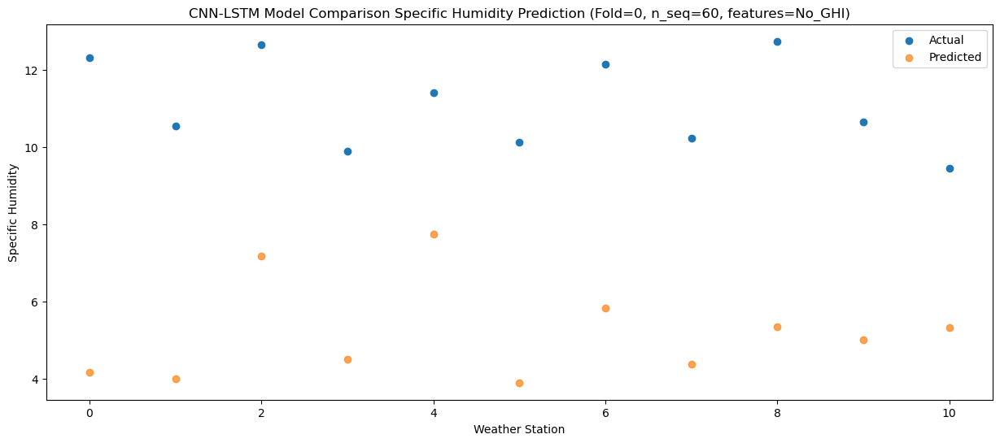

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35   0.701291
1                 1    6.52   0.694295
2                 2    9.07   3.935599
3                 3    7.71   0.991619
4                 4   11.36   4.151214
5                 5    7.00   0.821878
6                 6    9.20   2.710433
7                 7    7.42   1.293491
8                 8    8.67   1.987094
9                 9    7.94   1.890580
10               10    8.15   2.326492


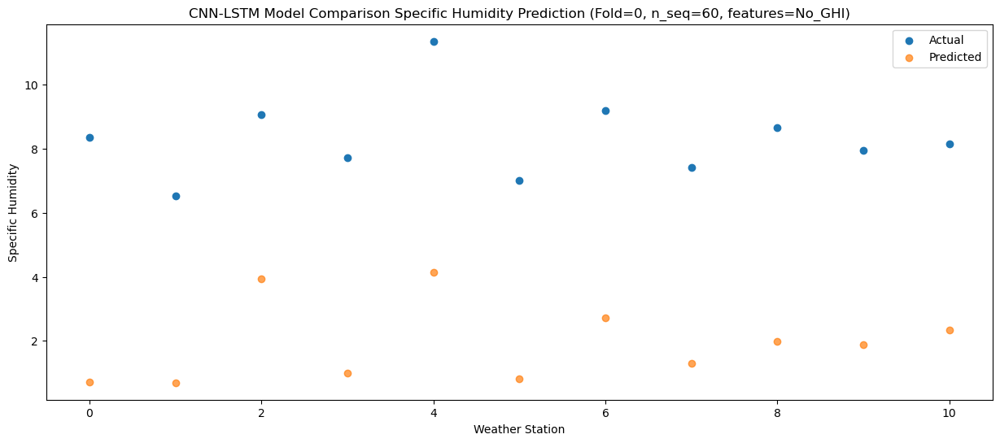

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32  -2.995022
1                 1    1.82  -3.033110
2                 2    5.16   0.266556
3                 3    3.14  -2.828700
4                 4    7.61   0.456676
5                 5    2.60  -2.739182
6                 6    4.94  -0.874734
7                 7    3.67  -2.253394
8                 8    4.61  -1.569373
9                 9    4.70  -1.549169
10               10    4.39  -0.993303


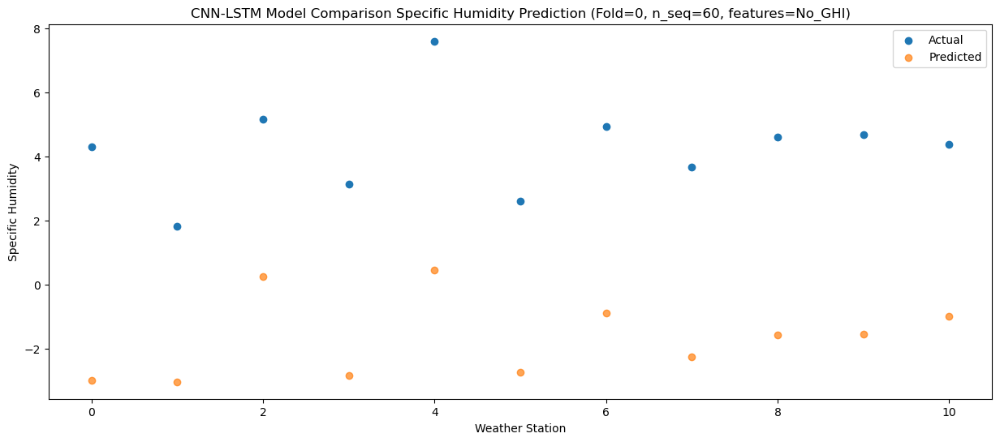

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14  -5.884303
1                 1   -0.36  -5.979359
2                 2    2.63  -2.883245
3                 3    0.15  -5.570170
4                 4    4.81  -2.173939
5                 5   -0.42  -6.025917
6                 6    1.61  -4.161080
7                 7    0.15  -5.600802
8                 8    1.95  -4.683896
9                 9    1.35  -4.954304
10               10    0.98  -4.524903


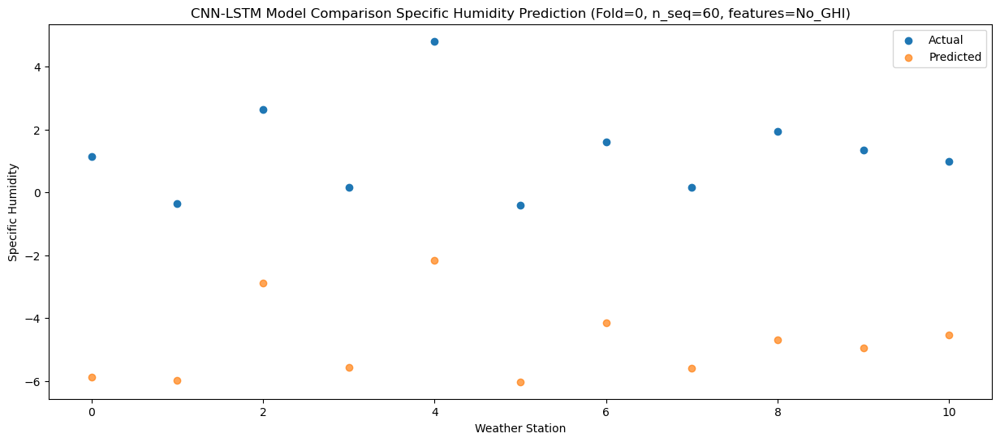

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -7.232613
1                 1   -1.80  -7.291680
2                 2    1.82  -3.812837
3                 3   -1.25  -7.276975
4                 4    2.95  -3.918317
5                 5   -1.24  -6.642566
6                 6    1.54  -4.804465
7                 7    0.35  -6.123540
8                 8    1.34  -5.551725
9                 9    1.54  -5.299293
10               10    1.51  -4.551316


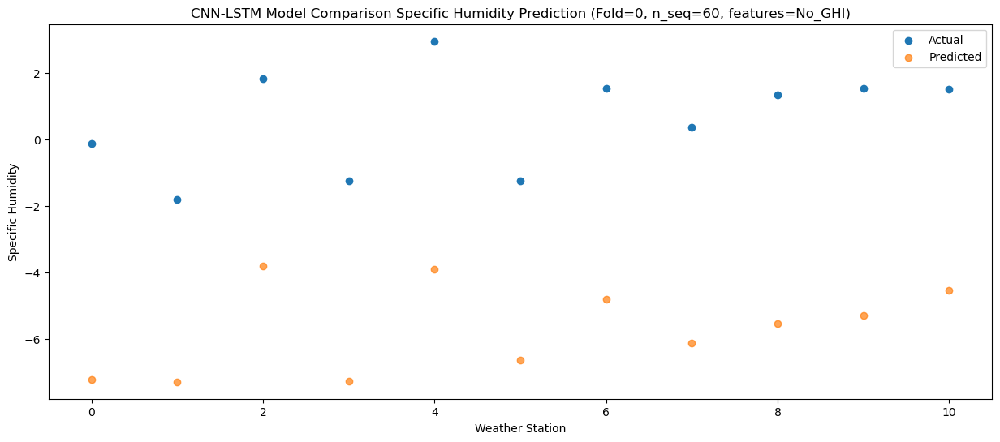

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -8.337335
1                 1   -2.58  -8.118462
2                 2    1.02  -4.728820
3                 3   -2.17  -8.279095
4                 4    1.77  -5.091178
5                 5   -2.03  -7.484560
6                 6    0.87  -5.695920
7                 7   -0.34  -7.024309
8                 8    0.16  -6.711915
9                 9    0.57  -6.343700
10               10   -0.01  -5.624022


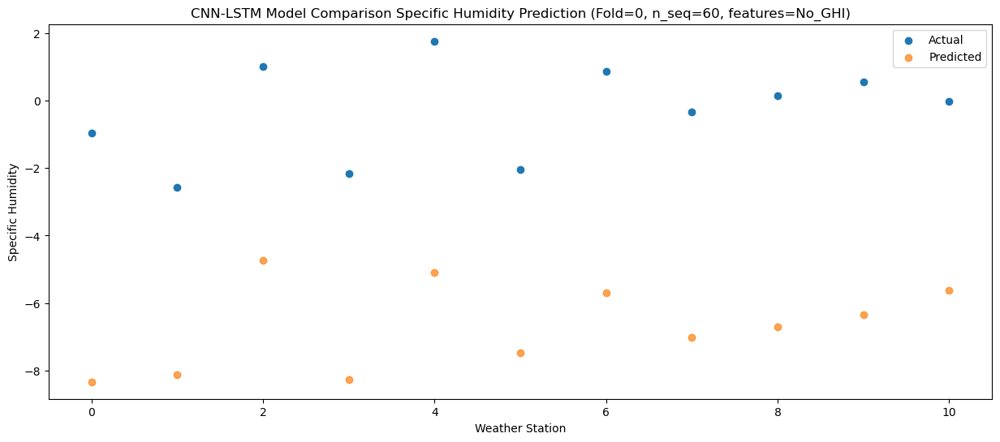

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94  -7.256843
1                 1   -1.36  -7.779977
2                 2    1.66  -4.464593
3                 3   -0.39  -7.305275
4                 4    4.34  -3.462051
5                 5   -2.13  -7.499513
6                 6    1.03  -5.624731
7                 7   -0.31  -6.978819
8                 8    1.92  -5.748027
9                 9    0.92  -5.979342
10               10    0.52  -5.292138


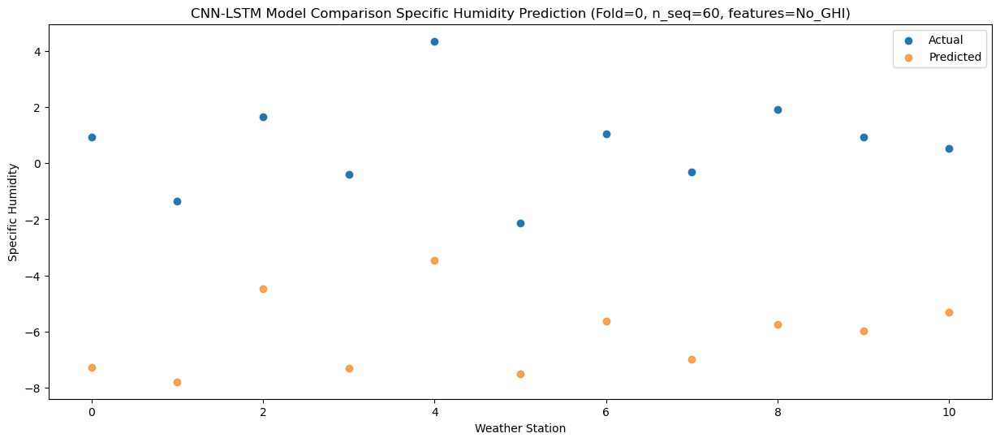

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20  -5.594451
1                 1    0.49  -5.631905
2                 2    3.29  -2.632518
3                 3    1.40  -5.188086
4                 4    6.08  -1.862450
5                 5   -0.21  -5.826360
6                 6    2.48  -3.971988
7                 7    0.83  -5.433574
8                 8    2.79  -4.496144
9                 9    2.05  -4.848730
10               10    1.21  -4.492900


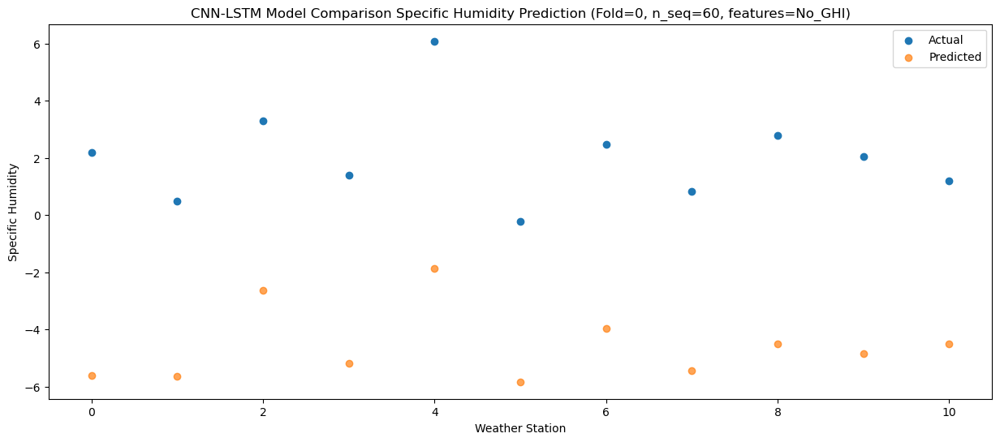

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51  -3.915668
1                 1    2.40  -4.341554
2                 2    5.03  -1.180715
3                 3    3.45  -3.678727
4                 4    8.32  -0.101524
5                 5    1.13  -4.422445
6                 6    4.54  -2.511370
7                 7    2.85  -3.935144
8                 8    5.02  -2.710598
9                 9    4.42  -3.146168
10               10    2.77  -2.732659


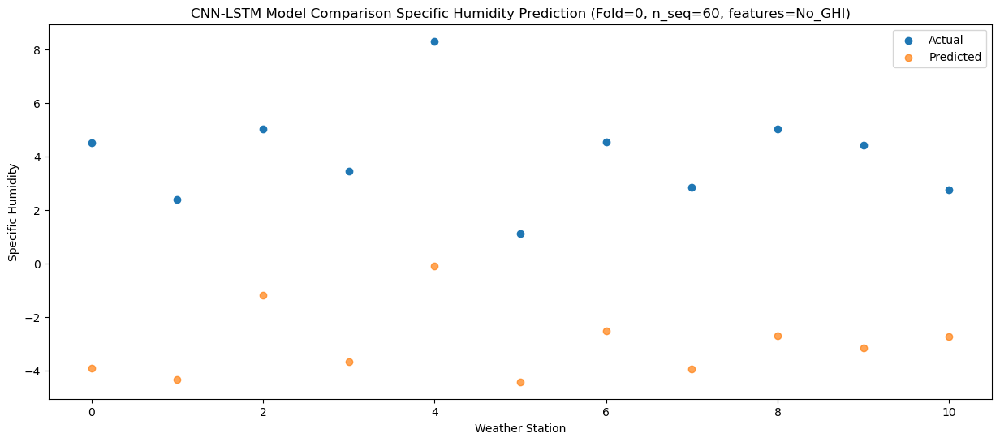

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   0.231026
1                 1    6.98  -0.086958
2                 2    8.78   2.948416
3                 3    8.02   0.690357
4                 4   12.57   4.001815
5                 5    5.19  -0.469184
6                 6    8.45   1.475881
7                 7    6.67  -0.011537
8                 8    9.30   1.210294
9                 9    8.22   0.613289
10               10    5.82   0.816877


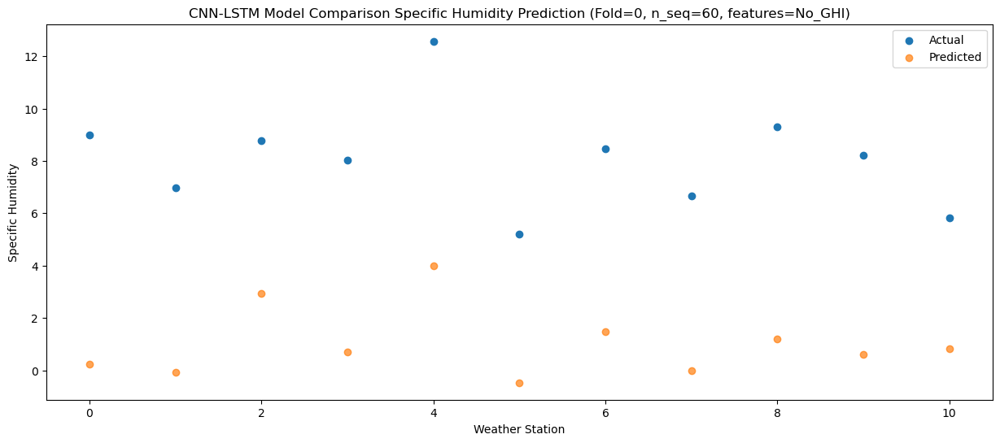

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37   1.678716
1                 1    8.58   0.635723
2                 2    9.91   3.932459
3                 3    9.53   1.702317
4                 4   14.22   5.692855
5                 5    7.16   0.525193
6                 6   10.27   2.522167
7                 7    8.36   1.106039
8                 8   11.72   2.971952
9                 9    9.29   2.190221
10               10    8.32   2.647056


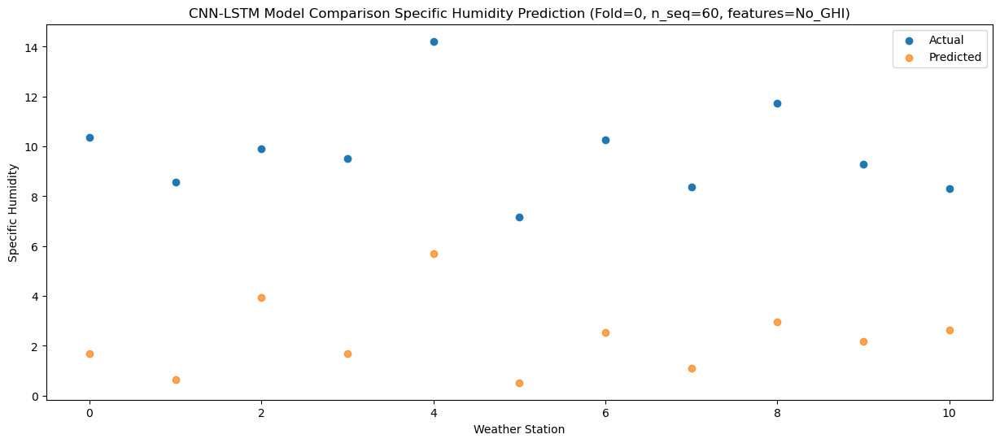

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66   2.156109
1                 1   10.75   1.955412
2                 2   13.14   5.319103
3                 3   10.93   2.328613
4                 4   13.96   5.508893
5                 5    9.95   2.178707
6                 6   12.80   4.091966
7                 7   11.25   2.697974
8                 8   12.90   3.557074
9                 9   10.79   3.421880
10               10    9.39   3.879783


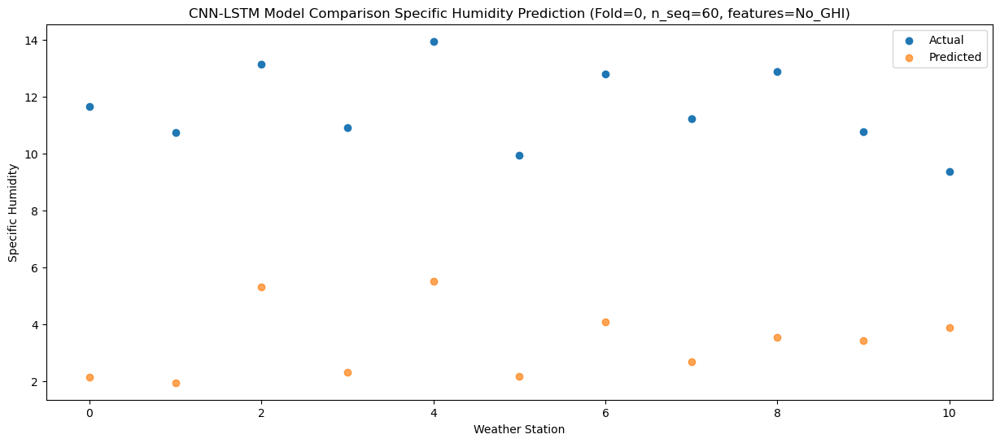

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83   0.995273
1                 1    9.25   0.562376
2                 2   11.45   3.953907
3                 3    9.79   1.069578
4                 4   13.61   4.484148
5                 5    8.94   0.777291
6                 6   11.64   2.707680
7                 7    9.82   1.317364
8                 8   11.23   2.435362
9                 9    9.99   2.161220
10               10    9.15   2.649191


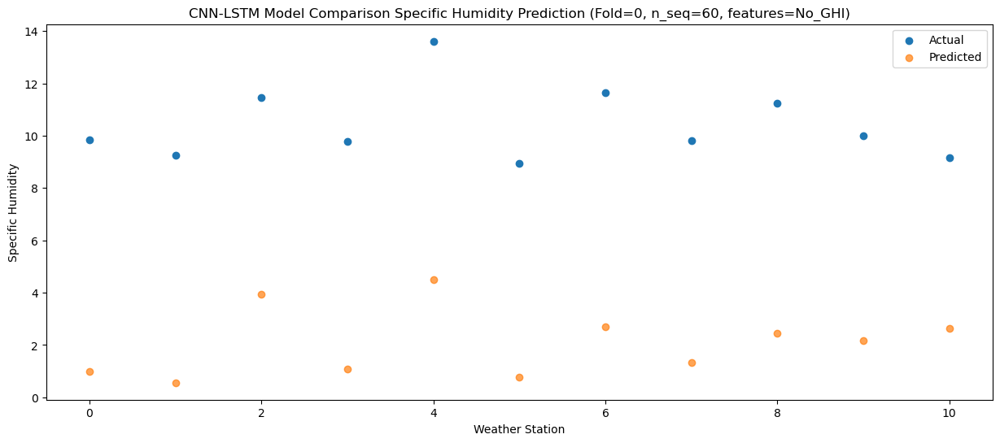

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36  -0.638232
1                 1    8.38  -0.128626
2                 2    9.76   2.883003
3                 3    8.23  -0.035165
4                 4   11.12   2.588917
5                 5    6.99  -0.273044
6                 6    9.91   1.560573
7                 7    8.23   0.072311
8                 8    9.19   0.428798
9                 9    7.64   0.341553
10               10    7.44   0.527778


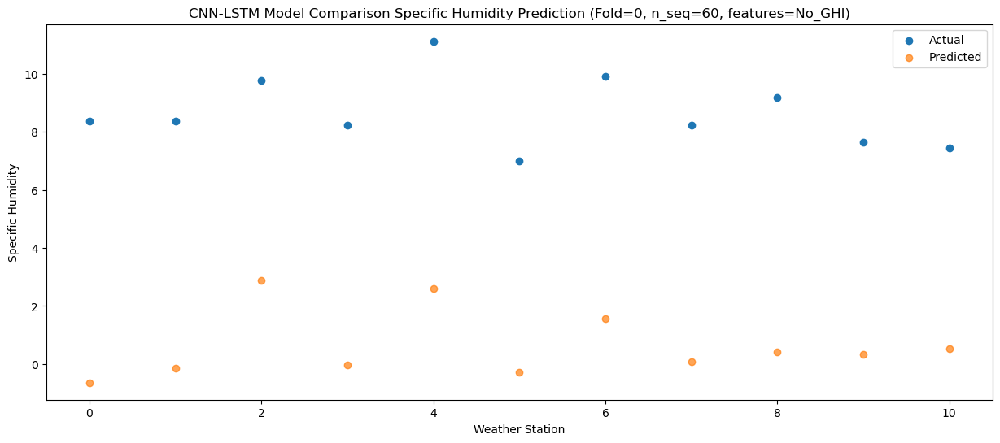

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98  -5.142105
1                 1    2.98  -4.698986
2                 2    5.63  -1.654576
3                 3    3.04  -4.669967
4                 4    7.51  -1.829281
5                 5    1.70  -4.693331
6                 6    5.21  -2.899561
7                 7    3.34  -4.354055
8                 8    4.59  -3.951470
9                 9    4.11  -3.984220
10               10    3.24  -3.680573


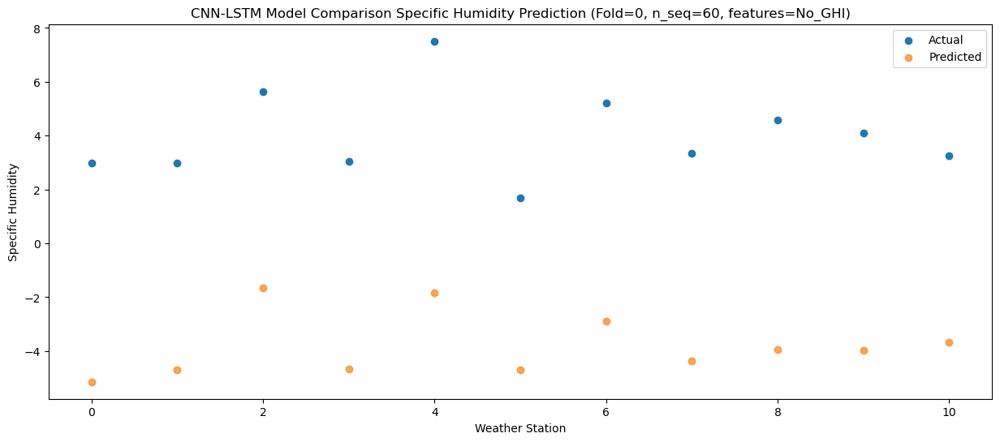

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

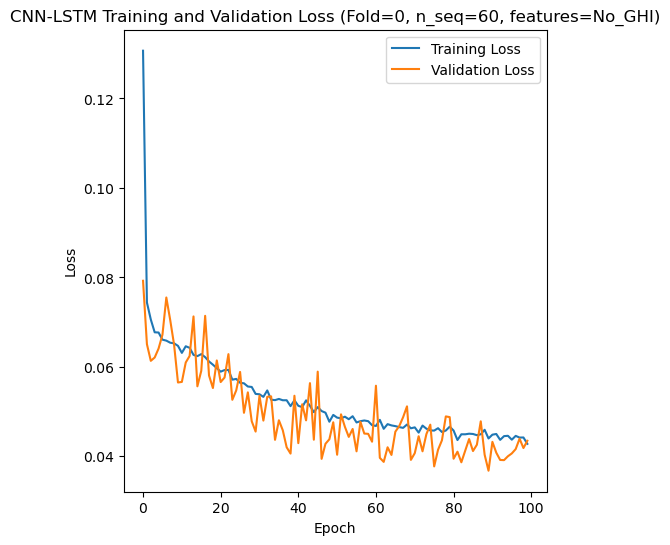

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 25s 111ms/step - loss: 0.1224 - accuracy: 0.2381 - mae: 0.1038 - rmse: 0.1224 - mape: 22.0413 - pearson: 0.5980 - val_loss: 0.0772 - val_accuracy: 0.5000 - val_mae: 0.0605 - val_rmse: 0.0772 - val_mape: 13.2849 - val_pearson: 0.7532
Epoch 2/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0748 - accuracy: 0.4048 - mae: 0.0595 - rmse: 0.0748 - mape: 13.2988 - pearson: 0.7418 - val_loss: 0.0649 - val_accuracy: 0.5000 - val_mae: 0.0500 - val_rmse: 0.0649 - val_mape: 11.0554 - val_pearson: 0.7634
Epoch 3/100
84/84 [==============================] - 4s 50ms/step - loss: 0.0704 - accuracy: 0.4405 - mae: 0.0553 - rmse: 0.0704 - mape: 12.6535 - pearson: 0.7564 - v

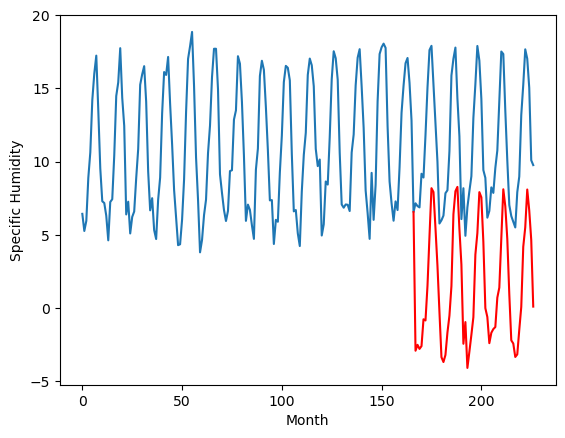

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		1.54		0.43
1.16		1.82		0.66
0.91		1.59		0.68
1.43		1.68		0.25
3.66		3.55		-0.11
2.07		3.50		1.43
5.08		6.06		0.98
8.88		9.41		0.53
10.92		12.80		1.88
10.97		12.21		1.24
8.07		9.61		1.54
5.40		6.78		1.38
2.34		3.92		1.58
-0.25		1.08		1.33
-0.23		0.74		0.97
-0.04		0.99		1.03
1.49		2.67		1.18
1.85		3.86		2.01
4.77		6.04		1.27
8.75		10.91		2.16
10.62		12.48		1.86
10.83		12.68		1.85
7.88		9.62		1.74
5.84		7.25		1.41
0.25		1.94		1.69
2.42		3.18		0.76
-0.58		0.23		0.81
0.37		1.20		0.83
1.05		2.38		1.33
2.11		3.67		1.56
6.28		8.01		1.73
8.68		9.56		0.88
11.35		12.28		0.93
10.94		11.92		0.98
7.58		8.73		1.15
2.69		4.17		1.48
2.21		3.47		1.26
0.62		1.81		1.19
1.03		2.50		1.47
2.15		2.63		0.48
1.28		2.85		1.57
2.88		4.77		1.89
5.62		5.85		0.23
7.97		9.12		1.15
10.93		12.33		1.40
11.06		11.24		0.18
7.95		8.90		0.95
4.10		5.15		1.05
1.09		2.02		0.93
0.51		1.81		1.30
-0.26		0.82		1.08
0.08		1.14		1.0

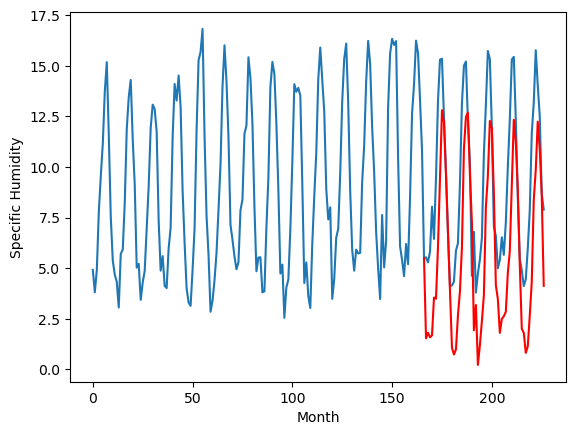

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		0.08		0.13
0.86		0.33		-0.53
0.35		0.12		-0.23
0.74		0.23		-0.51
3.90		2.43		-1.47
2.28		2.27		-0.01
5.05		4.83		-0.22
8.90		8.09		-0.81
11.45		11.41		-0.04
10.97		10.70		-0.27
8.02		8.28		0.26
5.26		5.28		0.02
2.08		2.42		0.34
-0.69		-0.55		0.14
-0.54		-0.79		-0.25
-0.54		-0.54		-0.00
2.08		1.34		-0.74
1.79		2.41		0.62
4.63		4.85		0.22
9.15		9.58		0.43
10.74		11.10		0.36
10.96		11.10		0.14
8.20		8.09		-0.11
5.45		5.57		0.12
-0.05		0.38		0.43
2.59		1.88		-0.71
-1.29		-1.39		-0.10
-0.26		-0.43		-0.17
0.53		0.81		0.28
2.29		2.33		0.04
6.65		6.67		0.02
9.74		8.35		-1.39
11.37		10.80		-0.57
10.50		10.43		-0.07
6.99		7.14		0.15
1.88		2.52		0.64
1.51		1.88		0.37
0.82		0.33		-0.49
0.79		0.89		0.10
1.84		1.24		-0.60
1.37		1.57		0.20
2.73		3.29		0.56
6.03		4.86		-1.17
8.68		8.06		-0.62
11.82		10.83		-0.99
11.75		9.93		-1.82
7.94		7.43		-0.51
3.43		3.58		0.15
0.88		0.62		-0.26
-0.14		0.15		0.29


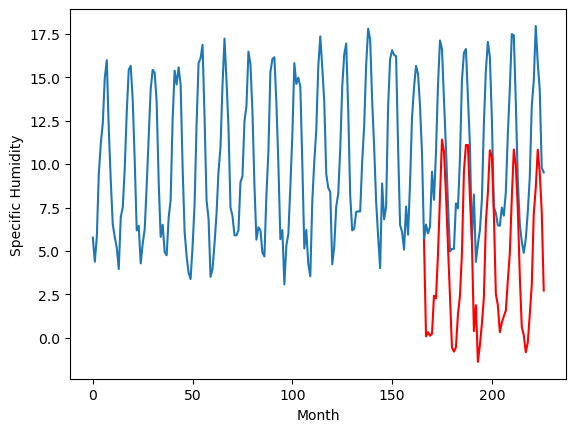

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		1.98		0.09
0.69		2.01		1.32
1.59		1.90		0.31
0.89		1.92		1.03
5.25		4.50		-0.75
4.91		4.33		-0.58
6.89		6.92		0.03
9.01		9.83		0.82
11.52		12.92		1.40
10.41		11.70		1.29
8.83		9.52		0.69
5.43		6.15		0.72
3.33		3.86		0.53
0.78		1.19		0.41
0.44		1.14		0.70
0.51		1.12		0.61
3.15		3.31		0.16
4.49		4.17		-0.32
8.38		7.12		-1.26
11.57		11.29		-0.28
12.05		12.72		0.67
12.39		12.18		-0.21
9.30		9.23		-0.07
7.05		6.61		-0.44
2.60		2.28		-0.32
5.52		3.54		-1.98
-0.13		0.33		0.46
0.04		0.94		0.90
1.72		2.29		0.57
5.88		4.14		-1.74
9.69		8.28		-1.41
10.74		10.27		-0.47
11.66		12.08		0.42
11.91		11.80		-0.11
8.62		8.36		-0.26
3.66		4.01		0.35
3.16		3.16		0.00
2.35		2.05		-0.30
1.93		2.39		0.46
2.71		2.82		0.11
4.26		3.48		-0.78
4.63		4.72		0.09
8.41		7.54		-0.87
11.81		10.40		-1.41
12.37		12.00		-0.37
10.70		11.56		0.86
9.50		8.95		-0.55
6.08		5.22		-0.86
2.75		2.65		-0.10
1.11		1.86		0.75
0.01		0.8

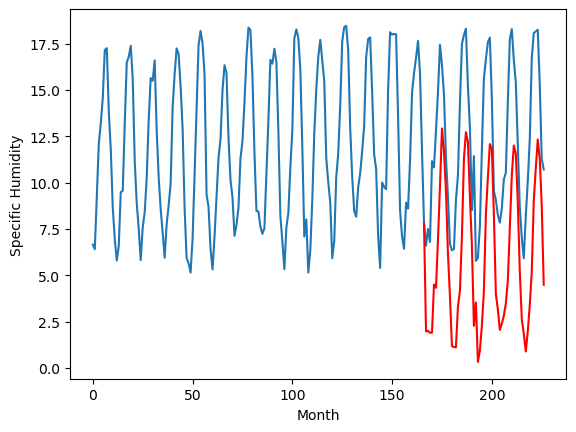

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		2.92		0.48
1.20		2.92		1.72
2.11		2.82		0.71
1.43		2.83		1.40
6.16		5.44		-0.72
5.85		5.26		-0.59
7.97		7.90		-0.07
10.26		10.82		0.56
12.86		13.96		1.10
11.41		12.65		1.24
9.92		10.43		0.51
6.07		6.98		0.91
3.59		4.75		1.16
0.77		2.10		1.33
0.52		2.05		1.53
0.56		1.99		1.43
3.28		4.23		0.95
4.54		5.10		0.56
8.57		8.10		-0.47
11.98		12.28		0.30
12.16		13.71		1.55
12.20		13.14		0.94
9.10		10.13		1.03
7.15		7.51		0.36
2.56		3.17		0.61
5.49		4.40		-1.09
-0.05		1.20		1.25
0.15		1.79		1.64
1.85		3.15		1.30
5.95		5.03		-0.92
9.83		9.21		-0.62
10.95		11.22		0.27
11.70		13.01		1.31
12.08		12.73		0.65
8.73		9.24		0.51
3.83		4.85		1.02
3.45		4.01		0.56
2.63		2.91		0.28
2.15		3.24		1.09
2.75		3.65		0.90
4.45		4.33		-0.12
4.90		5.56		0.66
8.57		8.47		-0.10
11.83		11.34		-0.49
11.91		12.91		1.00
10.51		12.48		1.97
9.76		9.83		0.07
6.37		6.08		-0.29
3.03		3.51		0.48
1.31		2.70		1.39
0.14		1.72		1.58


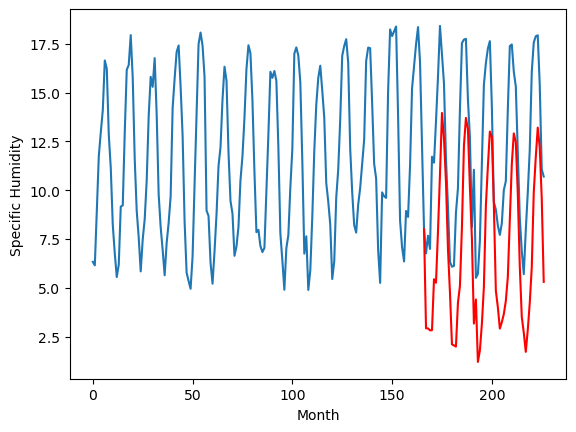

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		3.91		-0.85
3.28		3.86		0.58
3.00		3.85		0.85
3.18		3.69		0.51
5.85		5.78		-0.07
4.84		5.89		1.05
7.52		8.26		0.74
9.34		10.67		1.33
10.33		13.31		2.98
9.10		12.16		3.06
8.67		10.14		1.47
5.16		7.18		2.02
4.60		5.48		0.88
2.16		3.56		1.40
2.99		3.60		0.61
2.36		3.35		0.99
3.15		5.15		2.00
4.45		5.92		1.47
8.76		8.62		-0.14
10.93		12.13		1.20
12.26		13.57		1.31
12.48		12.90		0.42
8.94		10.27		1.33
5.83		7.98		2.15
3.99		4.84		0.85
2.94		5.12		2.18
1.67		2.93		1.26
1.55		3.14		1.59
2.10		4.45		2.35
4.37		5.87		1.50
6.14		9.40		3.26
8.74		11.42		2.68
9.69		13.05		3.36
11.80		12.97		1.17
10.53		9.87		-0.66
7.34		6.45		-0.89
4.47		5.03		0.56
3.80		4.37		0.57
2.25		4.76		2.51
2.28		4.70		2.42
3.33		5.48		2.15
3.59		6.62		3.03
7.96		9.52		1.56
7.91		11.77		3.86
10.08		12.86		2.78
10.23		12.72		2.49
9.87		10.58		0.71
7.89		7.50		-0.39
5.26		5.15		-0.11
3.39		4.62		1.23
2.24		3.80		1.56
2.65		4.

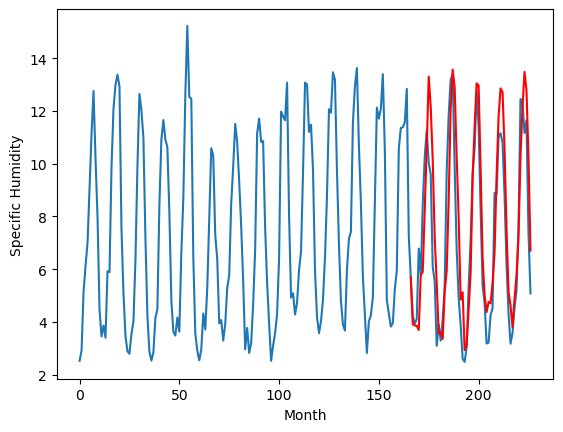

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		-2.39		0.16
-2.52		-2.10		0.42
-2.94		-2.33		0.61
-2.46		-2.24		0.22
-0.49		-0.50		-0.01
-1.14		-0.52		0.62
2.06		2.05		-0.01
5.70		5.43		-0.27
8.14		8.85		0.71
8.16		8.29		0.13
4.85		5.63		0.78
2.36		2.87		0.51
-0.75		0.01		0.76
-3.47		-2.78		0.69
-3.58		-3.16		0.42
-3.46		-2.91		0.55
-1.90		-1.30		0.60
-1.28		-0.07		1.21
1.65		2.00		0.35
6.00		6.92		0.92
8.50		8.50		0.00
8.79		8.79		-0.00
5.44		5.71		0.27
3.31		3.40		0.09
-2.62		-1.95		0.67
-0.75		-0.81		-0.06
-3.75		-3.64		0.11
-2.62		-2.66		-0.04
-1.87		-1.50		0.37
-0.68		-0.31		0.37
3.58		4.02		0.44
6.30		5.54		-0.76
9.29		8.35		-0.94
8.20		8.00		-0.20
4.72		4.85		0.13
-0.34		0.33		0.67
-0.83		-0.40		0.43
-2.73		-2.10		0.63
-2.37		-1.37		1.00
-1.17		-1.32		-0.15
-1.93		-1.14		0.79
-0.12		0.86		0.98
2.44		1.75		-0.69
5.02		5.05		0.03
8.64		8.41		-0.23
8.53		7.25		-1.28
5.56		4.98		-0.58
1.31		1.27		-0.04
-2.04		-1.93		0.11
-2.54		-

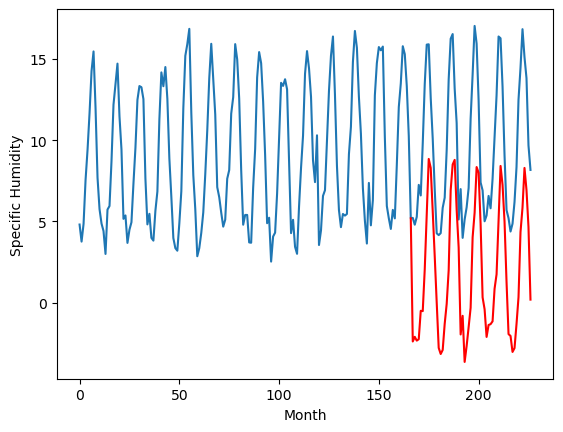

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		1.29		0.03
0.93		1.17		0.24
0.85		1.09		0.24
0.73		0.97		0.24
3.39		3.31		-0.08
3.65		3.23		-0.42
6.55		6.27		-0.28
10.38		9.39		-0.99
13.46		12.89		-0.57
11.29		11.23		-0.06
9.49		8.54		-0.95
4.67		4.86		0.19
2.65		2.93		0.28
0.33		0.63		0.30
0.20		0.41		0.21
-0.32		0.05		0.37
2.41		2.33		-0.08
3.64		3.43		-0.21
6.85		6.35		-0.50
11.61		10.82		-0.79
12.24		12.32		0.08
12.09		11.95		-0.14
8.84		8.53		-0.31
6.11		6.13		0.02
1.55		1.48		-0.07
3.19		2.23		-0.96
-0.56		-0.51		0.05
0.12		0.02		-0.10
1.65		1.34		-0.31
3.84		3.10		-0.74
8.29		7.51		-0.78
11.05		9.48		-1.57
12.02		11.55		-0.47
11.93		11.23		-0.70
7.97		7.59		-0.38
3.43		3.02		-0.41
2.18		2.08		-0.10
1.27		0.90		-0.37
1.39		1.36		-0.03
1.49		1.43		-0.06
2.25		2.02		-0.23
3.45		3.44		-0.01
7.49		6.24		-1.25
10.41		9.18		-1.23
12.98		11.28		-1.70
12.56		10.63		-1.93
8.07		7.93		-0.14
4.82		4.20		-0.62
2.11		1.37		-0.74
0.72		0.87	

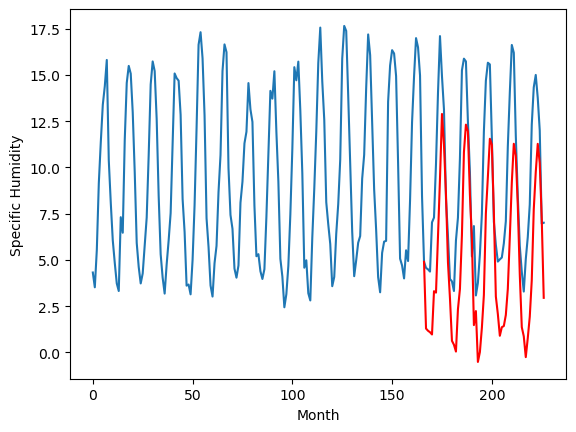

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		1.74		-0.28
1.18		1.44		0.26
1.63		1.43		-0.20
1.01		1.23		0.22
4.03		3.63		-0.40
4.22		3.61		-0.61
7.55		6.62		-0.93
9.69		9.44		-0.25
13.05		12.72		-0.33
10.15		10.78		0.63
8.67		8.22		-0.45
4.00		4.45		0.45
2.89		3.01		0.12
0.61		1.07		0.46
0.77		0.97		0.20
-0.04		0.41		0.45
2.57		2.73		0.16
3.73		3.70		-0.03
7.95		6.83		-1.12
11.09		10.79		-0.30
12.14		12.27		0.13
11.72		11.53		-0.19
8.15		8.24		0.09
5.71		5.86		0.15
2.18		2.01		-0.17
1.57		2.33		0.76
-0.41		-0.08		0.33
0.12		0.15		0.03
1.21		1.51		0.30
4.33		3.32		-1.01
8.57		7.45		-1.12
10.47		9.61		-0.86
9.83		11.27		1.44
10.57		11.07		0.50
7.83		7.45		-0.38
3.88		3.28		-0.60
2.90		2.07		-0.83
1.16		1.22		0.06
0.68		1.57		0.89
1.01		1.54		0.53
2.43		2.34		-0.09
3.65		3.48		-0.17
8.70		6.98		-1.72
11.28		9.66		-1.62
11.51		10.94		-0.57
9.68		10.57		0.89
8.73		7.99		-0.74
5.30		4.50		-0.80
2.63		1.90		-0.73
1.58		1.29		-0.29
0.27		

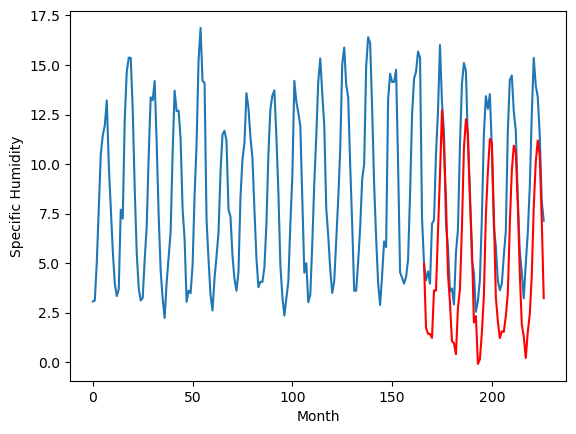

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.21		-0.14
0.70		0.94		0.24
0.55		0.97		0.42
0.56		0.68		0.12
2.45		2.68		0.23
2.61		2.85		0.24
5.43		5.58		0.15
7.14		8.07		0.93
10.03		10.95		0.92
8.71		9.27		0.56
5.92		6.90		0.98
2.40		3.58		1.18
2.08		2.36		0.28
0.22		0.84		0.62
0.41		0.80		0.39
-0.33		0.21		0.54
1.49		2.16		0.67
1.66		3.05		1.39
6.81		5.88		-0.93
9.80		9.41		-0.39
11.04		10.90		-0.14
10.01		10.14		0.13
7.05		7.18		0.13
3.61		5.02		1.41
1.25		1.94		0.69
0.27		1.72		1.45
-0.37		-0.07		0.30
-0.45		-0.05		0.40
0.51		1.27		0.76
1.48		2.70		1.22
4.04		6.35		2.31
8.22		8.48		0.26
8.87		10.09		1.22
9.28		10.01		0.73
7.28		6.72		-0.56
3.89		3.23		-0.66
1.91		1.65		-0.26
0.70		1.06		0.36
0.39		1.47		1.08
0.25		1.15		0.90
1.04		1.98		0.94
1.56		3.10		1.54
7.29		6.40		-0.89
8.90		8.68		-0.22
10.83		9.71		-1.12
8.92		9.53		0.61
7.27		7.33		0.06
4.16		4.29		0.13
1.84		1.83		-0.01
1.40		1.42		0.02
0.66		0.48		-0.18
1.33		1.68	

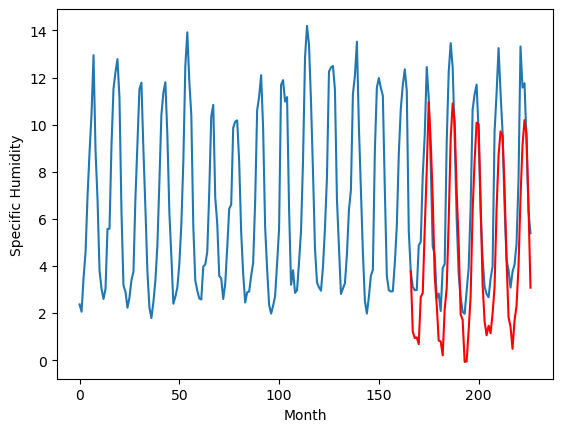

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-2.02		-0.20
-1.83		-1.85		-0.02
-1.98		-2.07		-0.09
-1.91		-2.11		-0.20
-0.96		-1.13		-0.17
-0.67		-0.87		-0.20
1.90		1.84		-0.06
5.54		5.34		-0.20
9.18		8.98		-0.20
9.09		8.30		-0.79
5.61		5.13		-0.48
2.69		2.59		-0.10
0.31		0.14		-0.17
-1.85		-2.00		-0.15
-2.58		-2.61		-0.03
-2.54		-2.60		-0.06
-1.30		-1.38		-0.08
0.07		0.14		0.07
1.60		1.75		0.15
6.92		6.80		-0.12
8.78		8.51		-0.27
9.12		9.10		-0.02
5.93		5.80		-0.13
4.07		3.91		-0.16
-1.12		-1.42		-0.30
-1.24		-1.26		-0.02
-2.85		-3.06		-0.21
-2.11		-2.25		-0.14
-1.09		-1.20		-0.11
-0.43		-0.50		-0.07
3.70		3.75		0.05
5.29		5.12		-0.17
8.92		8.36		-0.56
8.49		8.10		-0.39
5.24		5.09		-0.15
1.80		0.88		-0.92
0.30		-0.19		-0.49
-1.83		-2.00		-0.17
-0.97		-1.02		-0.05
-1.77		-1.62		0.15
-1.74		-1.62		0.12
0.87		0.76		-0.11
1.17		0.93		-0.24
4.46		4.32		-0.14
9.17		8.35		-0.82
6.88		6.82		-0.06
5.62		4.98		-0.64
2.57		1.60		-0.97
-1.0

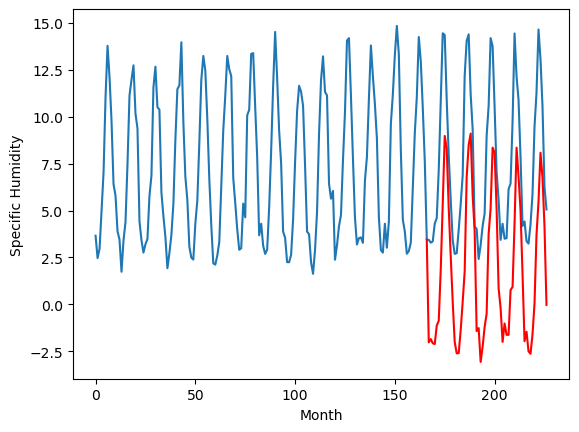

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88  -2.923606
1                 1    1.11   1.537667
2                 2   -0.05   0.079316
3                 3    1.89   1.980203
4                 4    2.44   2.924887
5                 5    4.76   3.913090
6                 6   -2.55  -2.385823
7                 7    1.26   1.290917
8                 8    2.02   1.738701
9                 9    1.35   1.209032
10               10   -1.82  -2.023918


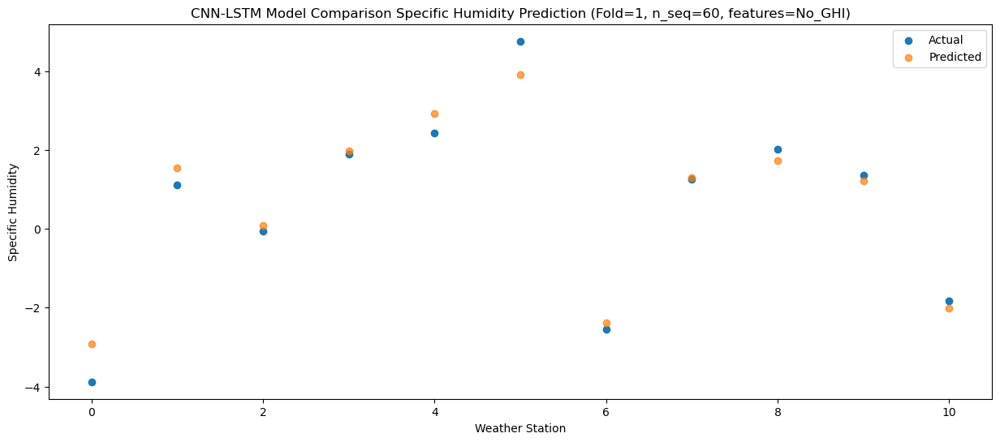

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28  -2.519871
1                 1    1.16   1.815618
2                 2    0.86   0.329042
3                 3    0.69   2.008584
4                 4    1.20   2.920531
5                 5    3.28   3.860522
6                 6   -2.52  -2.098495
7                 7    0.93   1.171291
8                 8    1.18   1.444011
9                 9    0.70   0.943181
10               10   -1.83  -1.848615


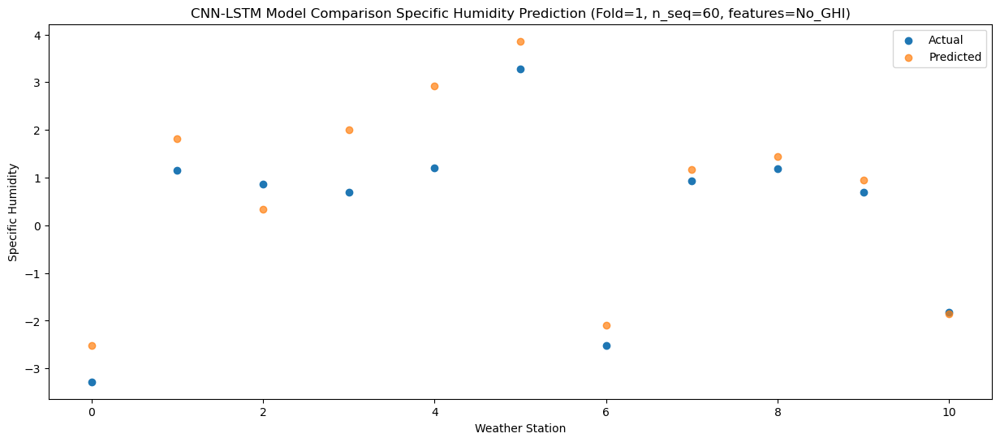

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -2.797547
1                 1    0.91   1.587247
2                 2    0.35   0.117584
3                 3    1.59   1.900262
4                 4    2.11   2.819348
5                 5    3.00   3.848392
6                 6   -2.94  -2.332501
7                 7    0.85   1.091405
8                 8    1.63   1.431333
9                 9    0.55   0.969331
10               10   -1.98  -2.069821


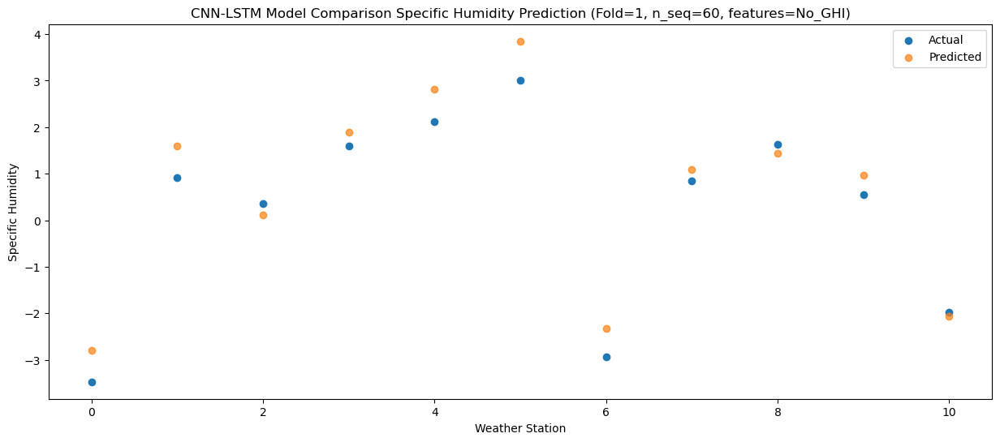

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -2.607741
1                 1    1.43   1.683032
2                 2    0.74   0.233362
3                 3    0.89   1.921774
4                 4    1.43   2.827714
5                 5    3.18   3.693379
6                 6   -2.46  -2.244466
7                 7    0.73   0.970193
8                 8    1.01   1.233564
9                 9    0.56   0.684218
10               10   -1.91  -2.112282


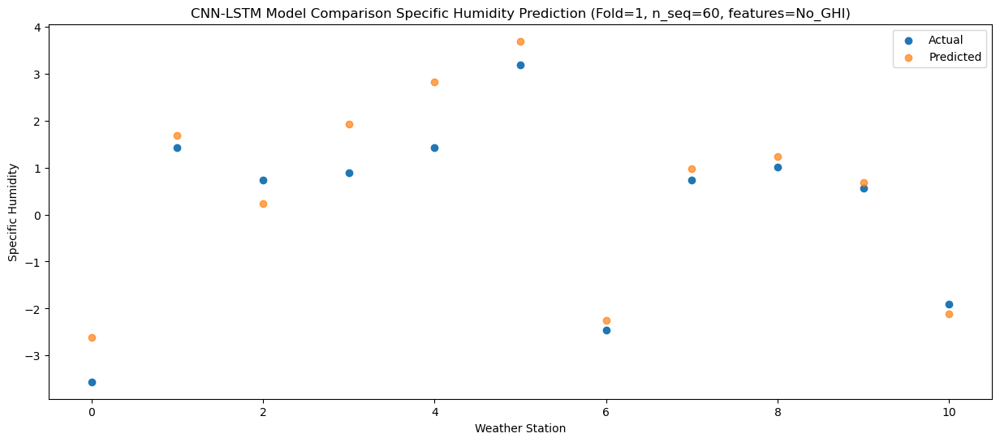

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26  -0.774817
1                 1    3.66   3.554371
2                 2    3.90   2.426885
3                 3    5.25   4.504491
4                 4    6.16   5.440873
5                 5    5.85   5.781494
6                 6   -0.49  -0.497175
7                 7    3.39   3.309176
8                 8    4.03   3.633798
9                 9    2.45   2.683354
10               10   -0.96  -1.129317


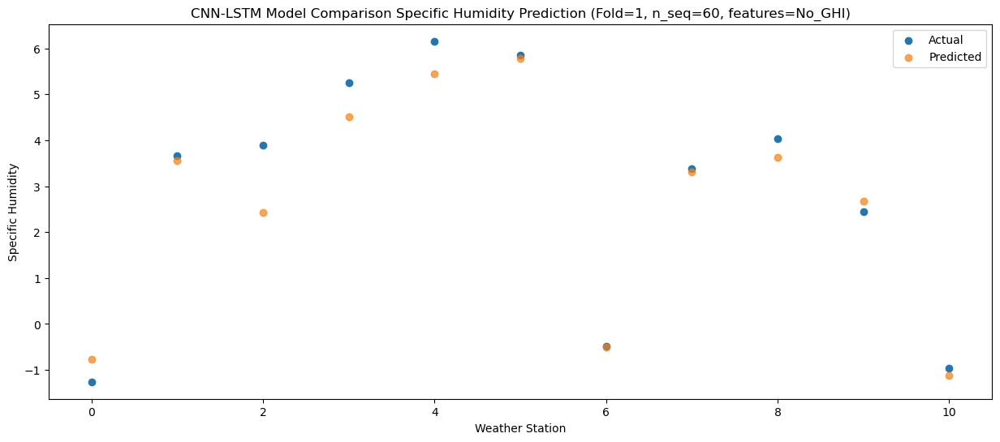

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52  -0.854281
1                 1    2.07   3.496606
2                 2    2.28   2.272730
3                 3    4.91   4.330049
4                 4    5.85   5.260899
5                 5    4.84   5.892528
6                 6   -1.14  -0.518142
7                 7    3.65   3.233315
8                 8    4.22   3.612907
9                 9    2.61   2.850234
10               10   -0.67  -0.869118


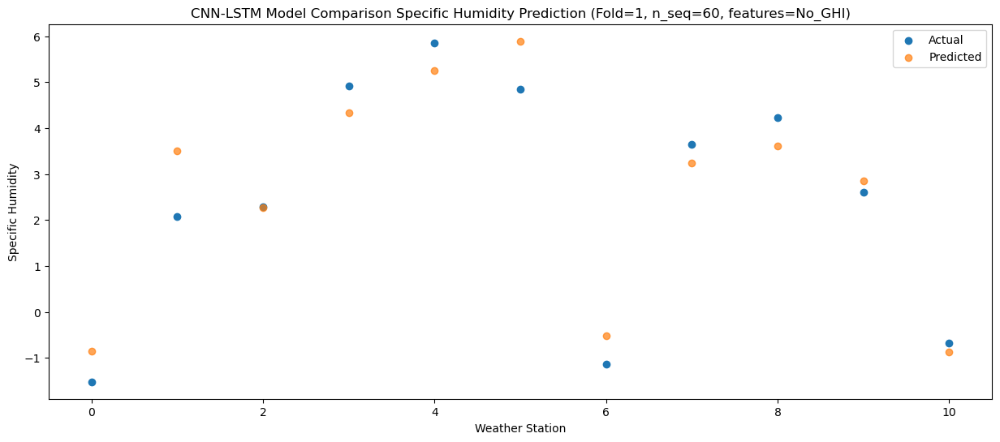

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38   1.511977
1                 1    5.08   6.060435
2                 2    5.05   4.829708
3                 3    6.89   6.917371
4                 4    7.97   7.902210
5                 5    7.52   8.256217
6                 6    2.06   2.046062
7                 7    6.55   6.267566
8                 8    7.55   6.615746
9                 9    5.43   5.578917
10               10    1.90   1.841424


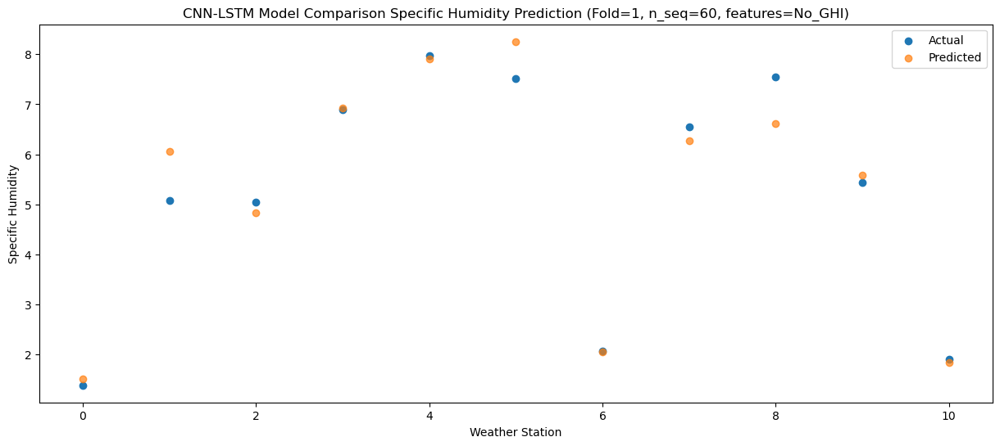

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   4.895435
1                 1    8.88   9.412009
2                 2    8.90   8.093158
3                 3    9.01   9.825461
4                 4   10.26  10.820105
5                 5    9.34  10.673679
6                 6    5.70   5.429550
7                 7   10.38   9.386536
8                 8    9.69   9.443295
9                 9    7.14   8.068812
10               10    5.54   5.340589


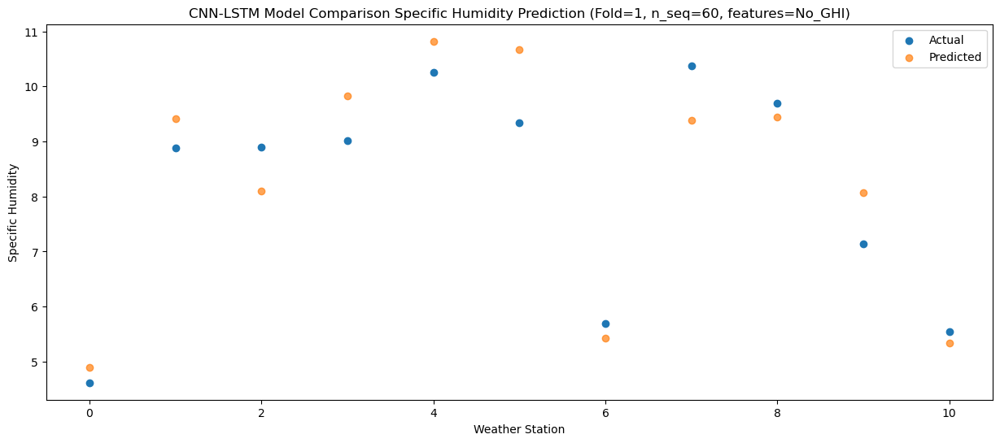

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19   8.183159
1                 1   10.92  12.804538
2                 2   11.45  11.409318
3                 3   11.52  12.923855
4                 4   12.86  13.959097
5                 5   10.33  13.309232
6                 6    8.14   8.845689
7                 7   13.46  12.890387
8                 8   13.05  12.721852
9                 9   10.03  10.952300
10               10    9.18   8.977510


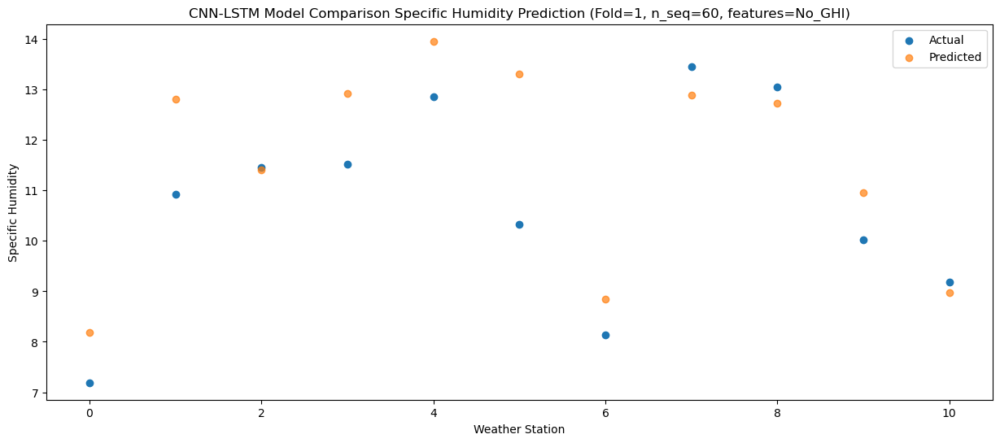

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   7.919909
1                 1   10.97  12.208060
2                 2   10.97  10.703611
3                 3   10.41  11.699764
4                 4   11.41  12.646109
5                 5    9.10  12.156893
6                 6    8.16   8.292958
7                 7   11.29  11.231832
8                 8   10.15  10.776117
9                 9    8.71   9.273841
10               10    9.09   8.302852


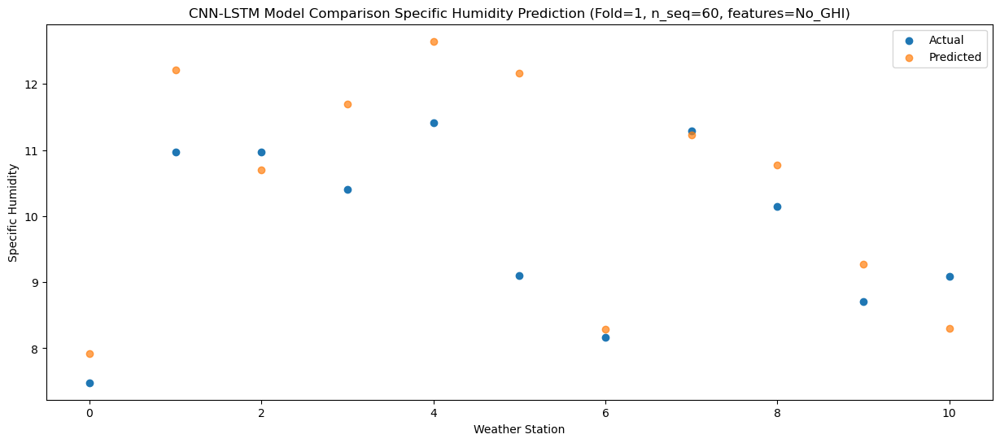

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   5.455052
1                 1    8.07   9.610365
2                 2    8.02   8.281114
3                 3    8.83   9.518587
4                 4    9.92  10.426065
5                 5    8.67  10.144766
6                 6    4.85   5.630126
7                 7    9.49   8.539551
8                 8    8.67   8.217140
9                 9    5.92   6.901872
10               10    5.61   5.134558


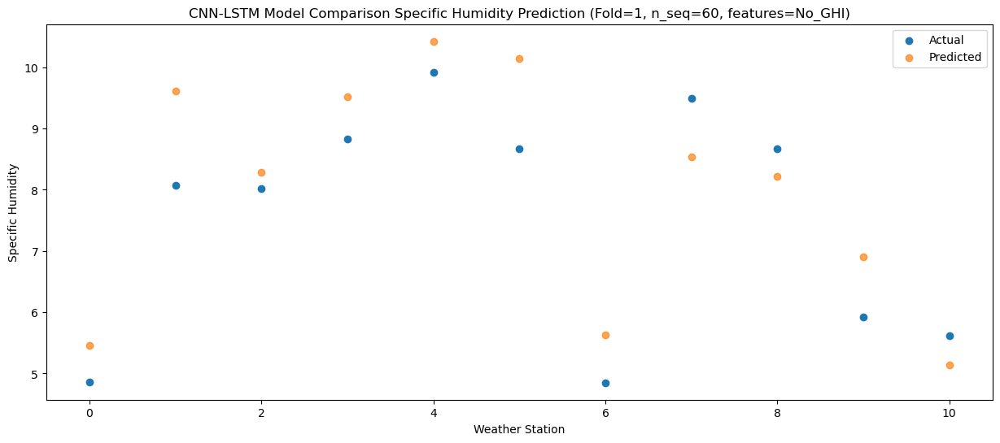

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   2.878957
1                 1    5.40   6.783230
2                 2    5.26   5.278332
3                 3    5.43   6.151420
4                 4    6.07   6.982292
5                 5    5.16   7.184504
6                 6    2.36   2.872365
7                 7    4.67   4.862818
8                 8    4.00   4.450108
9                 9    2.40   3.583460
10               10    2.69   2.594601


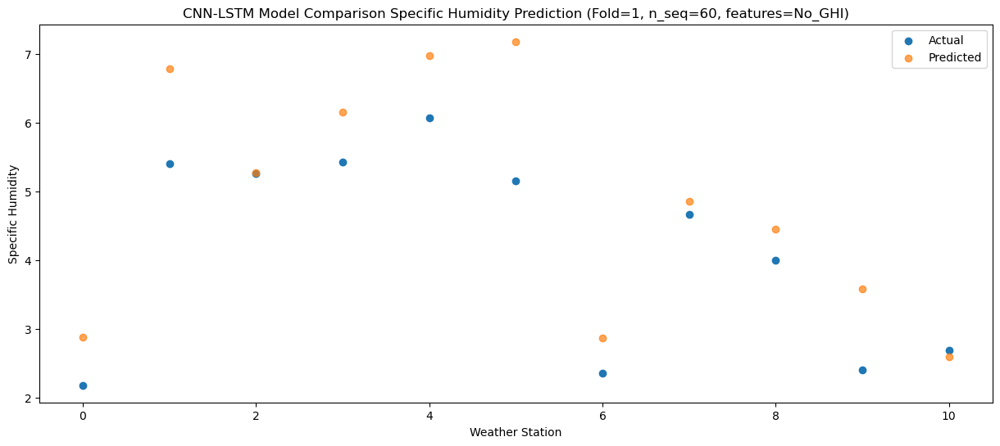

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -0.291688
1                 1    2.34   3.916963
2                 2    2.08   2.418225
3                 3    3.33   3.863369
4                 4    3.59   4.753970
5                 5    4.60   5.476143
6                 6   -0.75   0.005574
7                 7    2.65   2.926213
8                 8    2.89   3.007801
9                 9    2.08   2.360375
10               10    0.31   0.141197


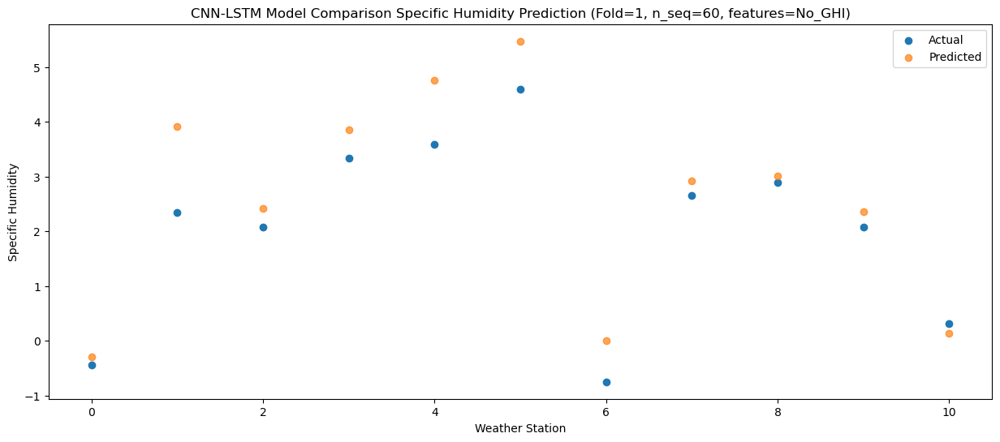

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -3.362826
1                 1   -0.25   1.078810
2                 2   -0.69  -0.551713
3                 3    0.78   1.185457
4                 4    0.77   2.103269
5                 5    2.16   3.557761
6                 6   -3.47  -2.780296
7                 7    0.33   0.626901
8                 8    0.61   1.069622
9                 9    0.22   0.837797
10               10   -1.85  -2.003769


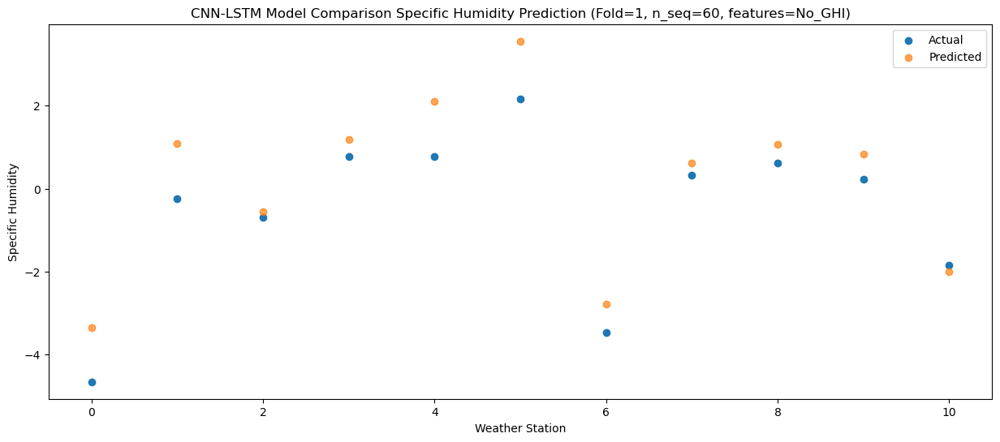

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -3.694919
1                 1   -0.23   0.739409
2                 2   -0.54  -0.794761
3                 3    0.44   1.135444
4                 4    0.52   2.048743
5                 5    2.99   3.600252
6                 6   -3.58  -3.155664
7                 7    0.20   0.413731
8                 8    0.77   0.969334
9                 9    0.41   0.798440
10               10   -2.58  -2.606253


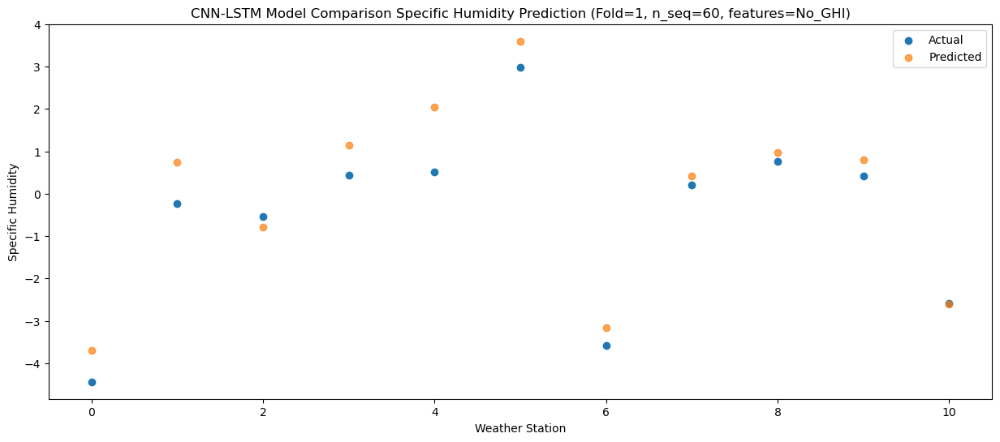

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -3.211262
1                 1   -0.04   0.989413
2                 2   -0.54  -0.541424
3                 3    0.51   1.118846
4                 4    0.56   1.988387
5                 5    2.36   3.351960
6                 6   -3.46  -2.906453
7                 7   -0.32   0.046866
8                 8   -0.04   0.406819
9                 9   -0.33   0.206397
10               10   -2.54  -2.596634


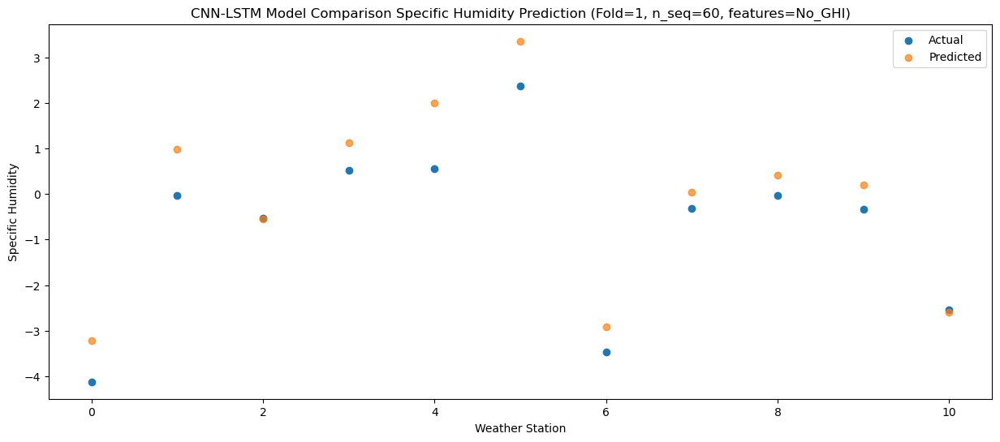

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59  -1.678905
1                 1    1.49   2.672218
2                 2    2.08   1.342434
3                 3    3.15   3.313117
4                 4    3.28   4.231208
5                 5    3.15   5.146503
6                 6   -1.90  -1.303887
7                 7    2.41   2.334606
8                 8    2.57   2.731946
9                 9    1.49   2.161388
10               10   -1.30  -1.376075


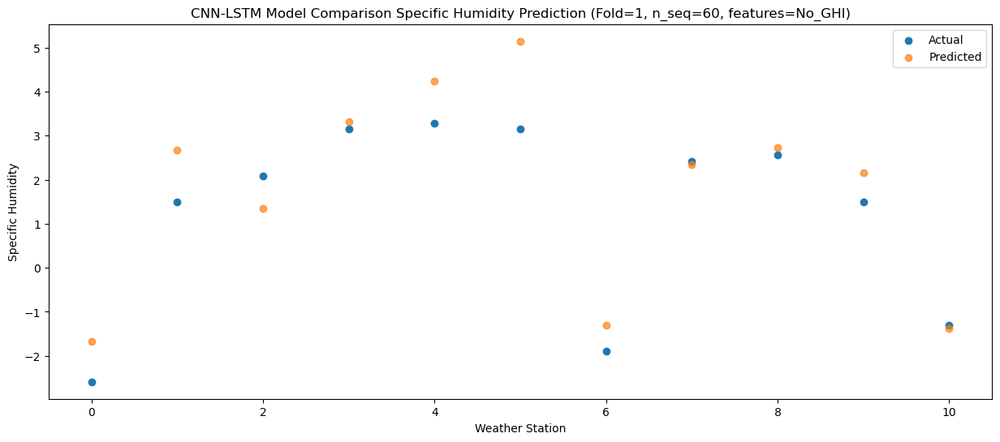

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39  -0.523754
1                 1    1.85   3.858478
2                 2    1.79   2.406217
3                 3    4.49   4.171828
4                 4    4.54   5.098431
5                 5    4.45   5.923387
6                 6   -1.28  -0.074345
7                 7    3.64   3.431156
8                 8    3.73   3.695007
9                 9    1.66   3.049613
10               10    0.07   0.143454


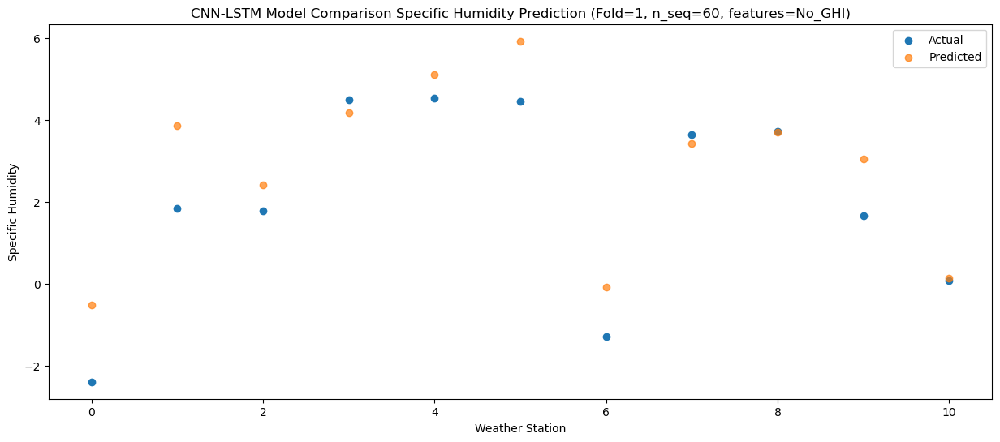

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29   1.496307
1                 1    4.77   6.040569
2                 2    4.63   4.849646
3                 3    8.38   7.118191
4                 4    8.57   8.095487
5                 5    8.76   8.615481
6                 6    1.65   2.003844
7                 7    6.85   6.347685
8                 8    7.95   6.825815
9                 9    6.81   5.880521
10               10    1.60   1.747493


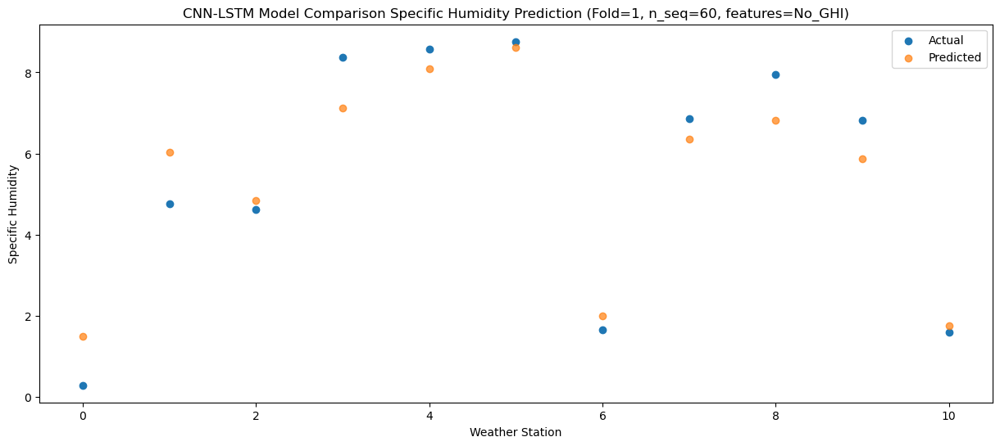

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45   6.401027
1                 1    8.75  10.910367
2                 2    9.15   9.584614
3                 3   11.57  11.290583
4                 4   11.98  12.275201
5                 5   10.93  12.128668
6                 6    6.00   6.919219
7                 7   11.61  10.824524
8                 8   11.09  10.788413
9                 9    9.80   9.414677
10               10    6.92   6.798856


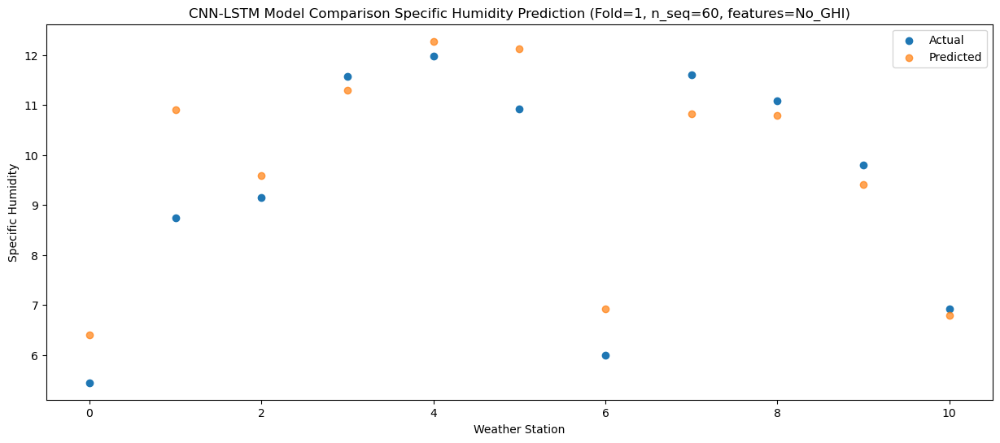

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   7.976866
1                 1   10.62  12.475106
2                 2   10.74  11.097006
3                 3   12.05  12.722970
4                 4   12.16  13.707352
5                 5   12.26  13.570403
6                 6    8.50   8.503752
7                 7   12.24  12.315031
8                 8   12.14  12.268544
9                 9   11.04  10.900765
10               10    8.78   8.505295


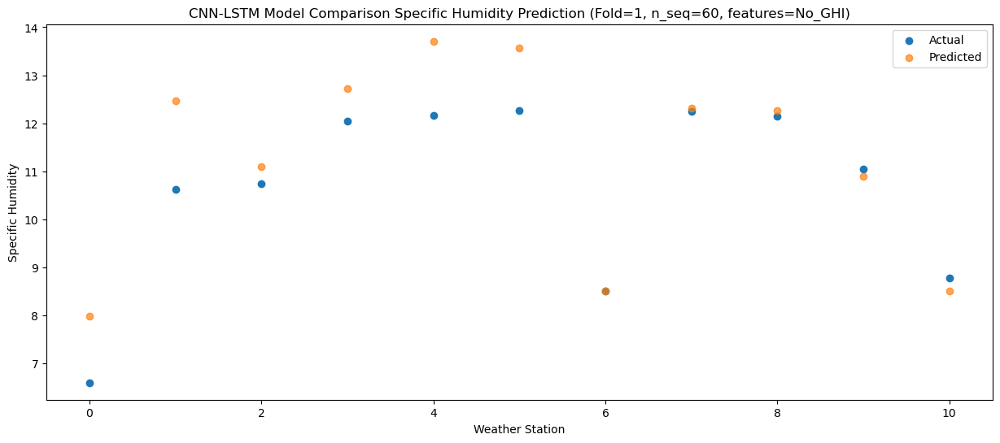

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   8.271142
1                 1   10.83  12.684886
2                 2   10.96  11.098906
3                 3   12.39  12.184845
4                 4   12.20  13.142128
5                 5   12.48  12.901441
6                 6    8.79   8.788113
7                 7   12.09  11.945473
8                 8   11.72  11.529748
9                 9   10.01  10.144607
10               10    9.12   9.101112


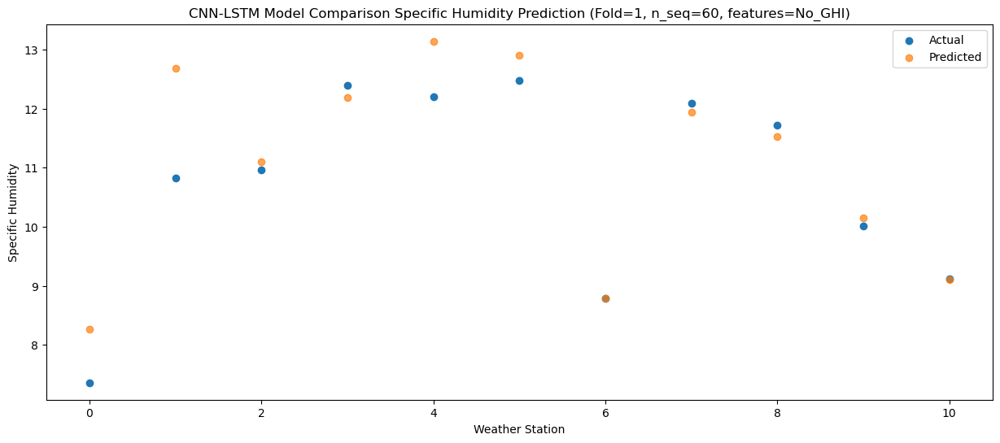

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   5.391253
1                 1    7.88   9.620680
2                 2    8.20   8.085583
3                 3    9.30   9.232243
4                 4    9.10  10.134890
5                 5    8.94  10.268798
6                 6    5.44   5.711152
7                 7    8.84   8.531015
8                 8    8.15   8.235452
9                 9    7.05   7.183911
10               10    5.93   5.801215


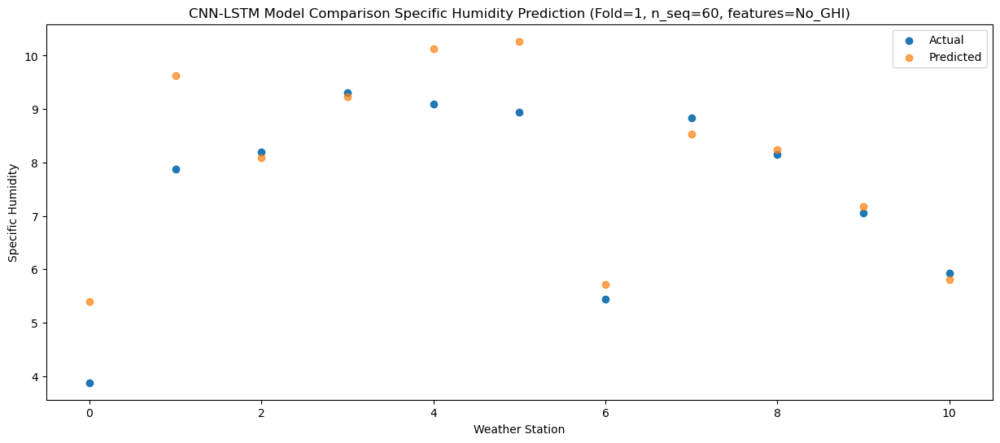

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   2.965723
1                 1    5.84   7.251833
2                 2    5.45   5.566201
3                 3    7.05   6.613006
4                 4    7.15   7.514532
5                 5    5.83   7.976198
6                 6    3.31   3.399956
7                 7    6.11   6.125455
8                 8    5.71   5.856394
9                 9    3.61   5.023769
10               10    4.07   3.906775


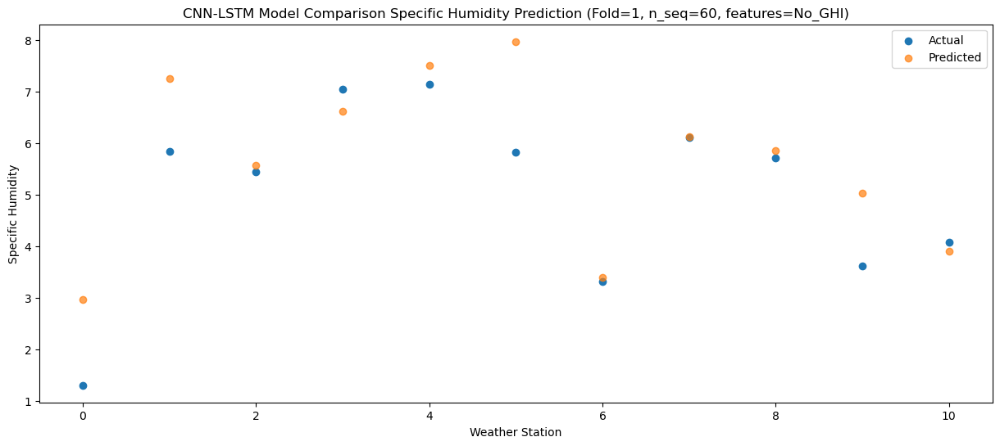

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36  -2.447346
1                 1    0.25   1.936205
2                 2   -0.05   0.384279
3                 3    2.60   2.275419
4                 4    2.56   3.165983
5                 5    3.99   4.843791
6                 6   -2.62  -1.954102
7                 7    1.55   1.476613
8                 8    2.18   2.007038
9                 9    1.25   1.943542
10               10   -1.12  -1.421533


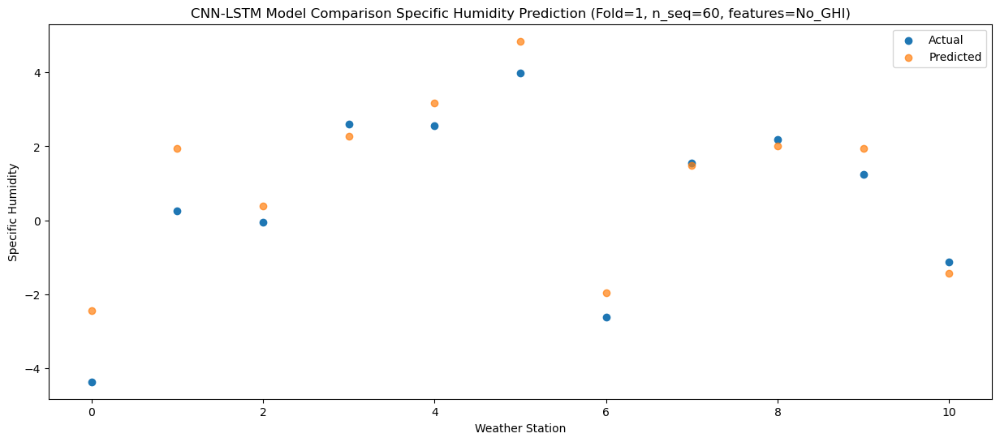

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25  -0.964880
1                 1    2.42   3.183465
2                 2    2.59   1.878736
3                 3    5.52   3.537315
4                 4    5.49   4.399796
5                 5    2.94   5.120512
6                 6   -0.75  -0.806440
7                 7    3.19   2.234876
8                 8    1.57   2.333570
9                 9    0.27   1.715988
10               10   -1.24  -1.262621


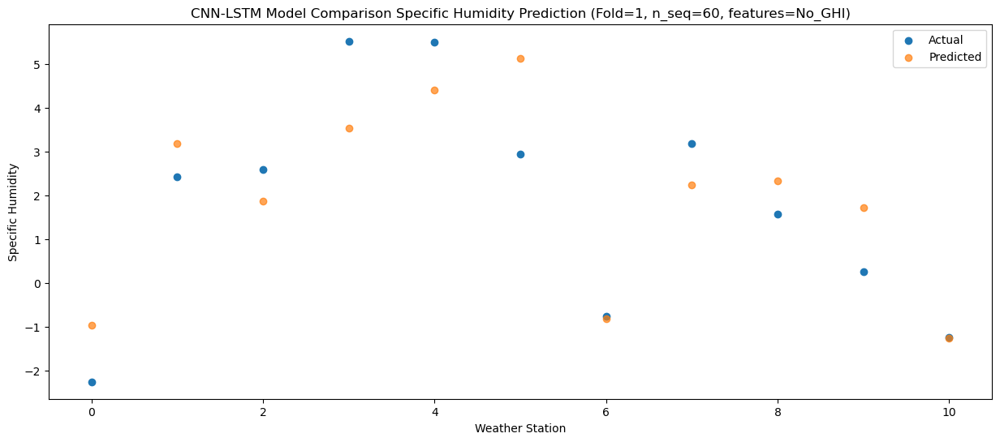

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50  -4.097740
1                 1   -0.58   0.225318
2                 2   -1.29  -1.386175
3                 3   -0.13   0.332074
4                 4   -0.05   1.201587
5                 5    1.67   2.927431
6                 6   -3.75  -3.643063
7                 7   -0.56  -0.513949
8                 8   -0.41  -0.081000
9                 9   -0.37  -0.071318
10               10   -2.85  -3.064772


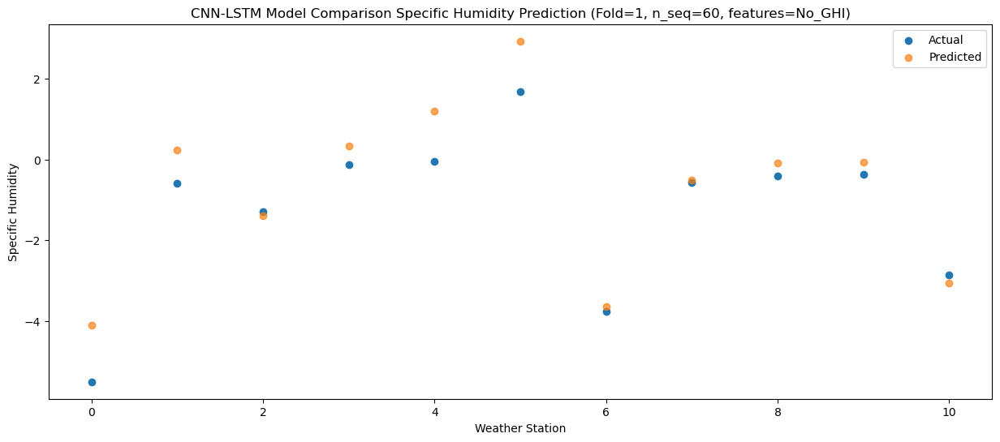

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -2.984077
1                 1    0.37   1.202544
2                 2   -0.26  -0.430245
3                 3    0.04   0.944503
4                 4    0.15   1.792670
5                 5    1.55   3.140589
6                 6   -2.62  -2.659245
7                 7    0.12   0.017958
8                 8    0.12   0.149683
9                 9   -0.45  -0.046389
10               10   -2.11  -2.249351


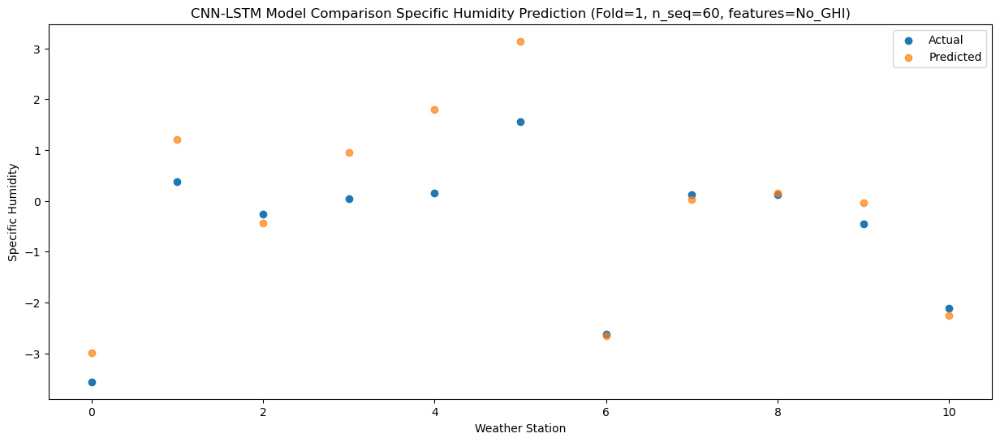

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45  -1.837181
1                 1    1.05   2.381542
2                 2    0.53   0.805929
3                 3    1.72   2.293291
4                 4    1.85   3.149329
5                 5    2.10   4.454799
6                 6   -1.87  -1.502950
7                 7    1.65   1.336098
8                 8    1.21   1.508175
9                 9    0.51   1.265770
10               10   -1.09  -1.202853


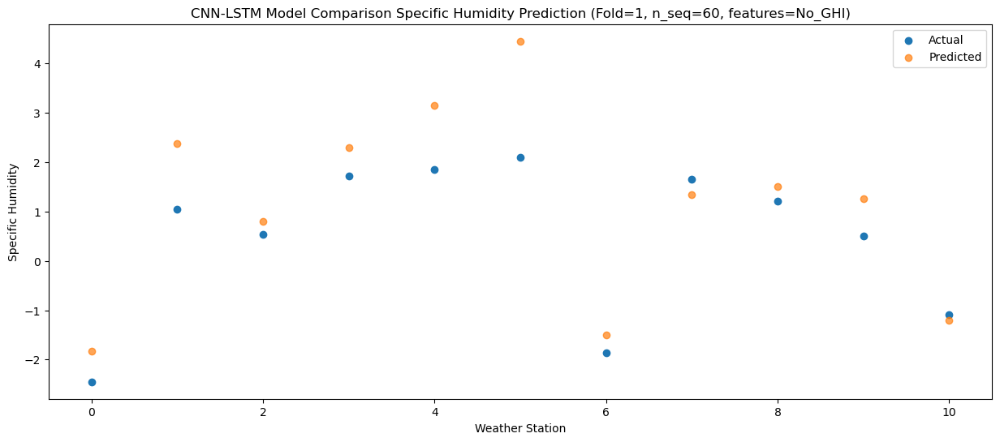

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -0.628278
1                 1    2.11   3.669184
2                 2    2.29   2.326925
3                 3    5.88   4.138681
4                 4    5.95   5.033167
5                 5    4.37   5.868069
6                 6   -0.68  -0.307408
7                 7    3.84   3.102637
8                 8    4.33   3.323810
9                 9    1.48   2.702391
10               10   -0.43  -0.503474


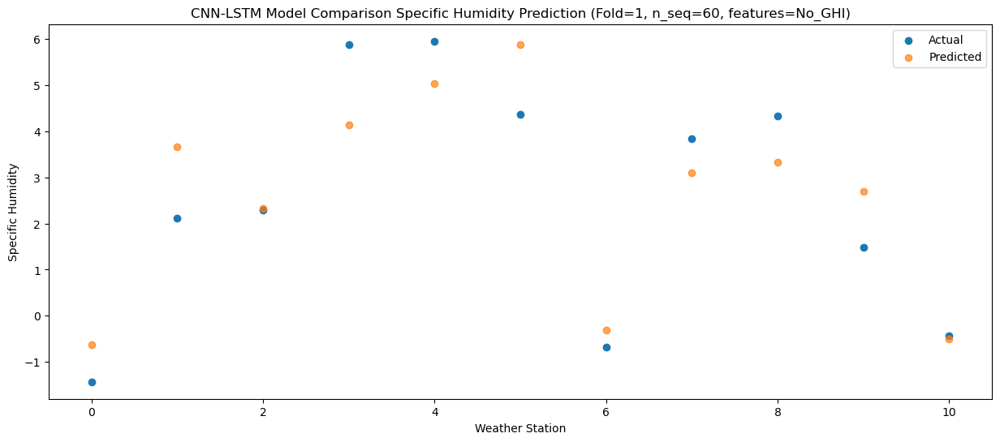

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   3.644488
1                 1    6.28   8.009280
2                 2    6.65   6.674747
3                 3    9.69   8.278065
4                 4    9.83   9.206760
5                 5    6.14   9.397341
6                 6    3.58   4.024561
7                 7    8.29   7.512223
8                 8    8.57   7.445275
9                 9    4.04   6.349366
10               10    3.70   3.747648


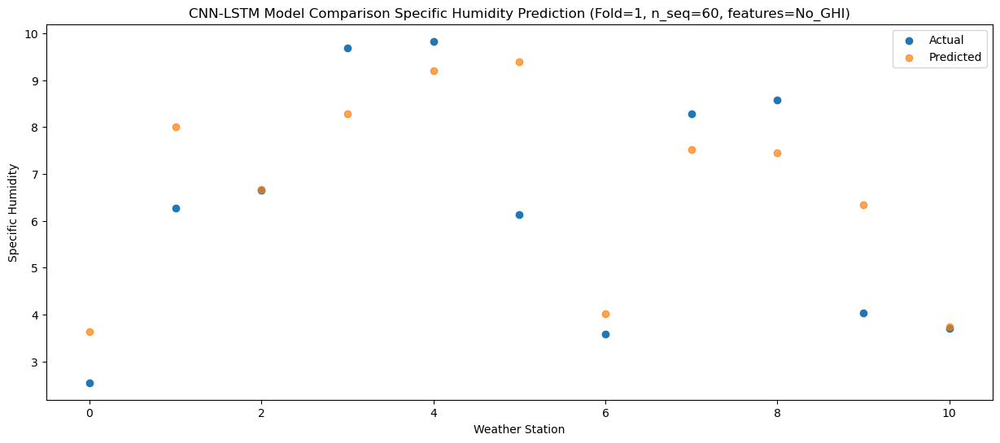

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85   5.113868
1                 1    8.68   9.564212
2                 2    9.74   8.346132
3                 3   10.74  10.265542
4                 4   10.95  11.217930
5                 5    8.74  11.421006
6                 6    6.30   5.538859
7                 7   11.05   9.482136
8                 8   10.47   9.612346
9                 9    8.22   8.479773
10               10    5.29   5.115715


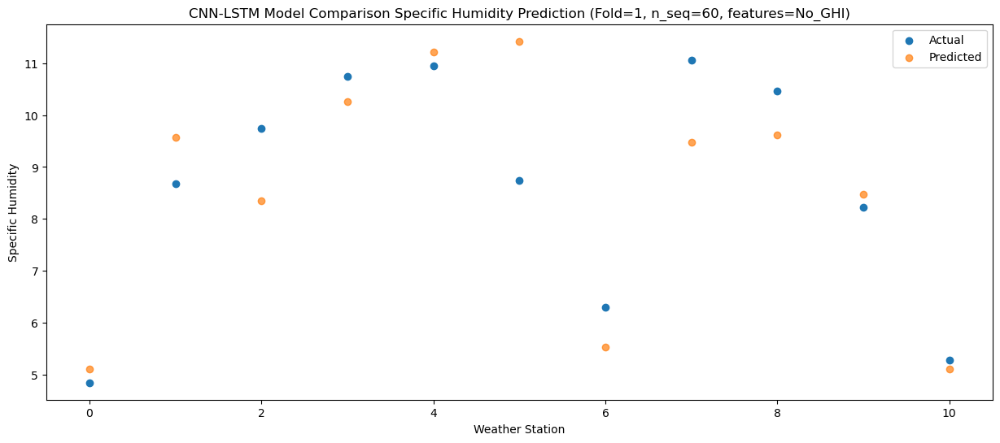

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47   7.914161
1                 1   11.35  12.276448
2                 2   11.37  10.797663
3                 3   11.66  12.076925
4                 4   11.70  13.007540
5                 5    9.69  13.050165
6                 6    9.29   8.347827
7                 7   12.02  11.550288
8                 8    9.83  11.273991
9                 9    8.87  10.086583
10               10    8.92   8.356550


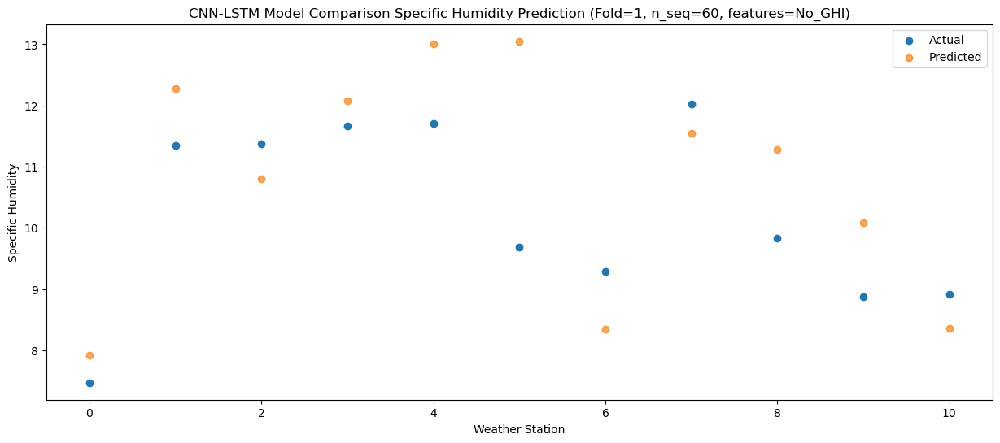

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47   7.558277
1                 1   10.94  11.918585
2                 2   10.50  10.428302
3                 3   11.91  11.802600
4                 4   12.08  12.731330
5                 5   11.80  12.971327
6                 6    8.20   7.997702
7                 7   11.93  11.230357
8                 8   10.57  11.071733
9                 9    9.28  10.013970
10               10    8.49   8.096299


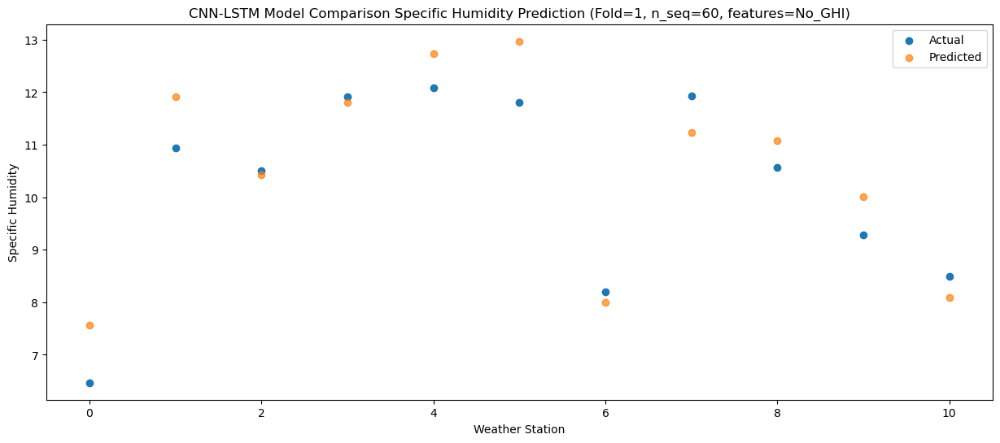

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   4.514609
1                 1    7.58   8.731469
2                 2    6.99   7.141853
3                 3    8.62   8.357944
4                 4    8.73   9.239037
5                 5   10.53   9.874957
6                 6    4.72   4.852790
7                 7    7.97   7.591151
8                 8    7.83   7.445295
9                 9    7.28   6.719886
10               10    5.24   5.091953


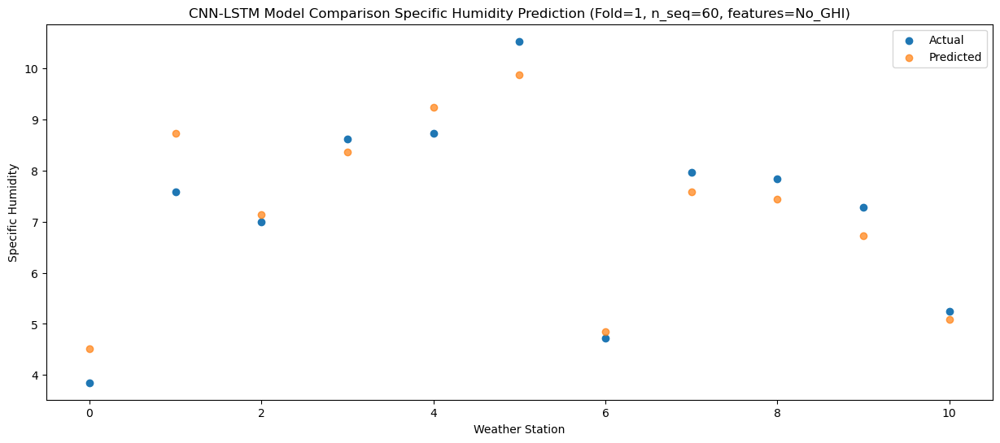

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01  -0.013488
1                 1    2.69   4.174268
2                 2    1.88   2.517739
3                 3    3.66   4.007075
4                 4    3.83   4.853497
5                 5    7.34   6.450451
6                 6   -0.34   0.329089
7                 7    3.43   3.023257
8                 8    3.88   3.284978
9                 9    3.89   3.227585
10               10    1.80   0.876757


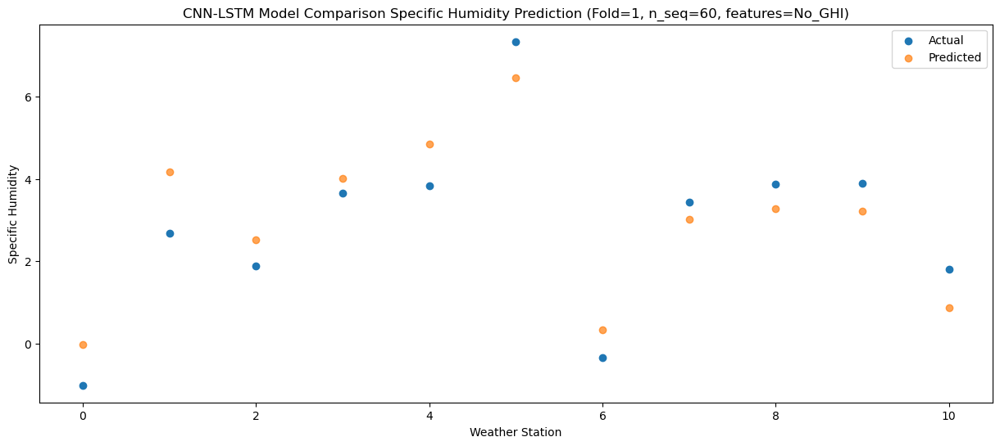

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54  -0.619678
1                 1    2.21   3.474434
2                 2    1.51   1.883945
3                 3    3.16   3.164240
4                 4    3.45   4.008352
5                 5    4.47   5.026249
6                 6   -0.83  -0.400928
7                 7    2.18   2.076133
8                 8    2.90   2.066378
9                 9    1.91   1.649071
10               10    0.30  -0.191906


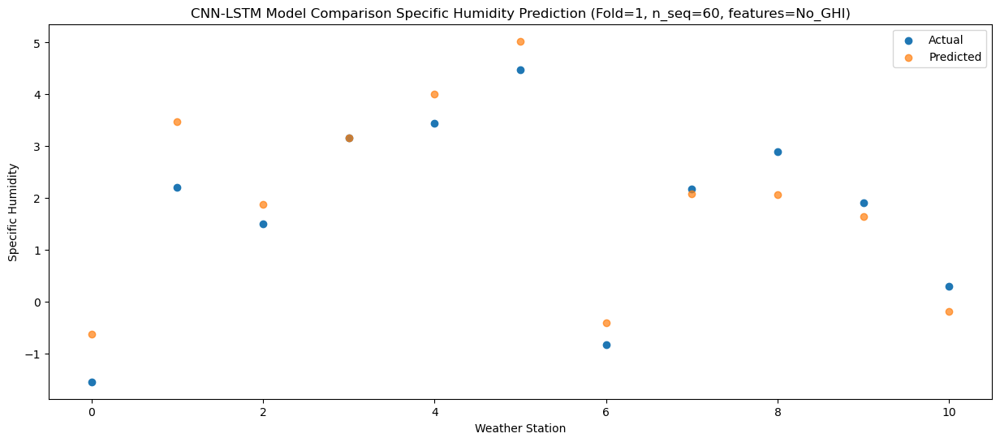

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26  -2.405446
1                 1    0.62   1.809901
2                 2    0.82   0.326288
3                 3    2.35   2.053946
4                 4    2.63   2.909632
5                 5    3.80   4.370658
6                 6   -2.73  -2.104468
7                 7    1.27   0.901078
8                 8    1.16   1.219663
9                 9    0.70   1.057673
10               10   -1.83  -1.997903


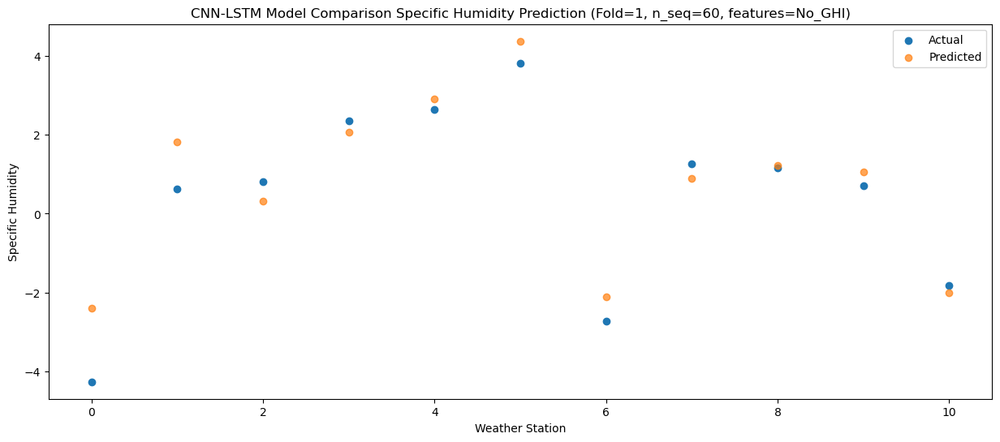

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80  -1.697312
1                 1    1.03   2.498362
2                 2    0.79   0.892233
3                 3    1.93   2.393888
4                 4    2.15   3.239635
5                 5    2.25   4.756922
6                 6   -2.37  -1.369797
7                 7    1.39   1.364242
8                 8    0.68   1.565250
9                 9    0.39   1.465623
10               10   -0.97  -1.017097


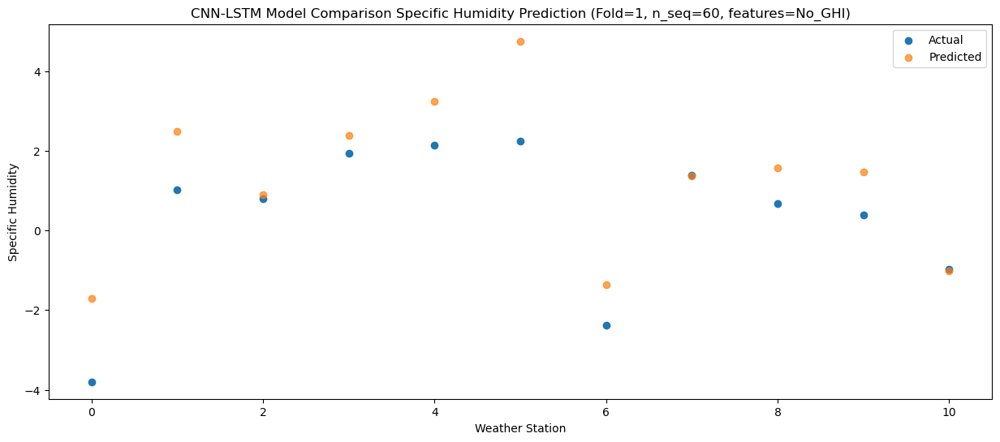

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19  -1.443888
1                 1    2.15   2.630628
2                 2    1.84   1.239176
3                 3    2.71   2.817723
4                 4    2.75   3.653755
5                 5    2.28   4.699865
6                 6   -1.17  -1.319587
7                 7    1.49   1.425391
8                 8    1.01   1.536058
9                 9    0.25   1.145930
10               10   -1.77  -1.623355


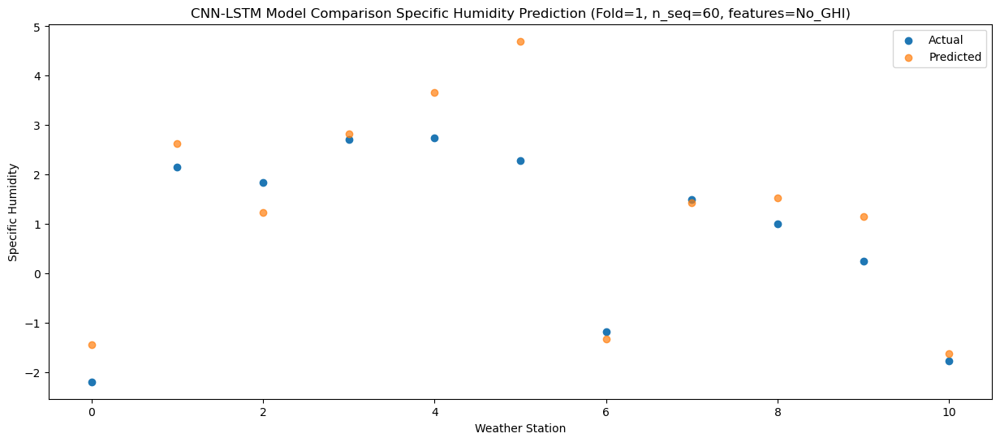

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57  -1.303187
1                 1    1.28   2.847477
2                 2    1.37   1.571707
3                 3    4.26   3.476001
4                 4    4.45   4.327780
5                 5    3.33   5.481438
6                 6   -1.93  -1.144398
7                 7    2.25   2.022287
8                 8    2.43   2.338153
9                 9    1.04   1.977587
10               10   -1.74  -1.619809


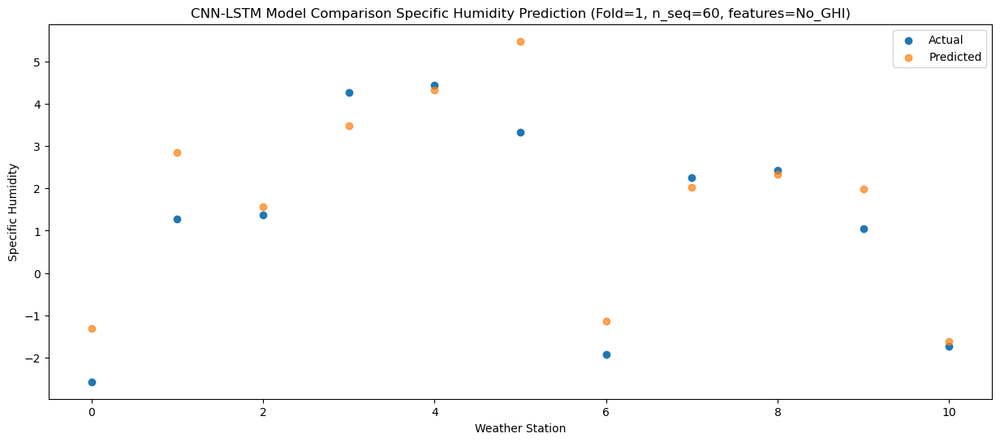

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87   0.704996
1                 1    2.88   4.773498
2                 2    2.73   3.287488
3                 3    4.63   4.722409
4                 4    4.90   5.556114
5                 5    3.59   6.615825
6                 6   -0.12   0.858152
7                 7    3.45   3.435491
8                 8    3.65   3.483223
9                 9    1.56   3.099315
10               10    0.87   0.764939


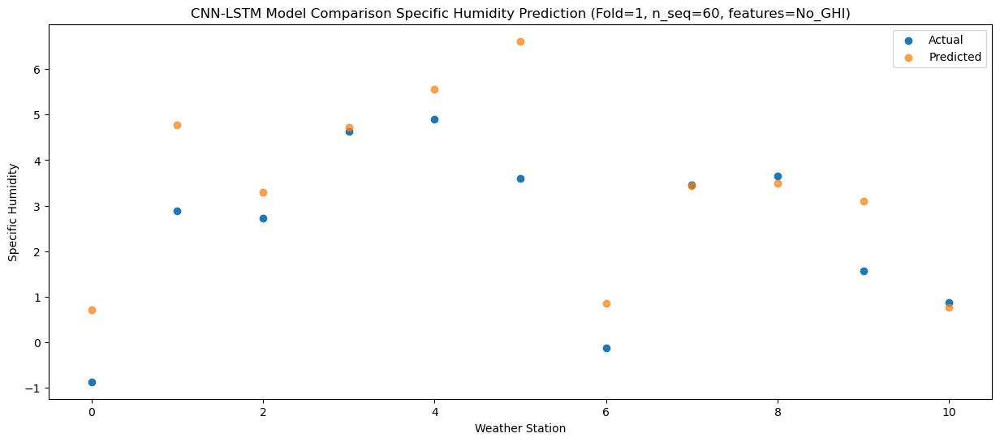

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33   1.389082
1                 1    5.62   5.848958
2                 2    6.03   4.856163
3                 3    8.41   7.539650
4                 4    8.57   8.472859
5                 5    7.96   9.517433
6                 6    2.44   1.747292
7                 7    7.49   6.236209
8                 8    8.70   6.984967
9                 9    7.29   6.401506
10               10    1.17   0.930644


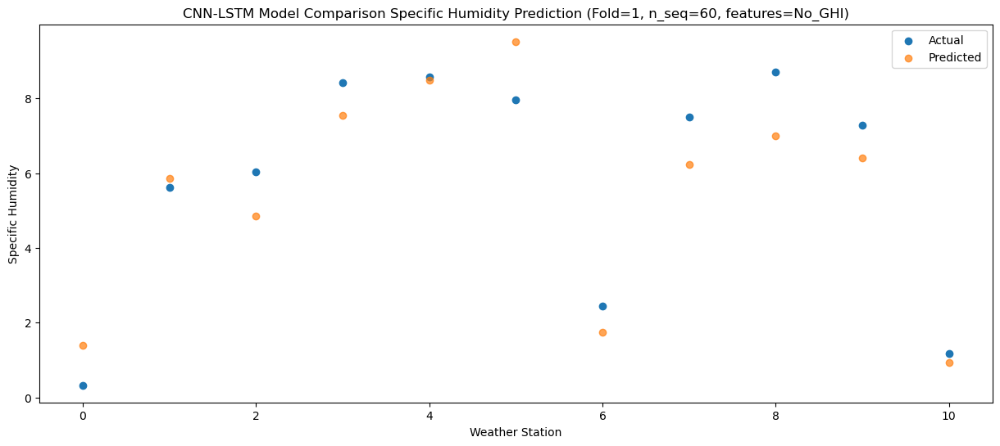

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68   4.752755
1                 1    7.97   9.122718
2                 2    8.68   8.058837
3                 3   11.81  10.397808
4                 4   11.83  11.339858
5                 5    7.91  11.769949
6                 6    5.02   5.045317
7                 7   10.41   9.183132
8                 8   11.28   9.662984
9                 9    8.90   8.680962
10               10    4.46   4.317451


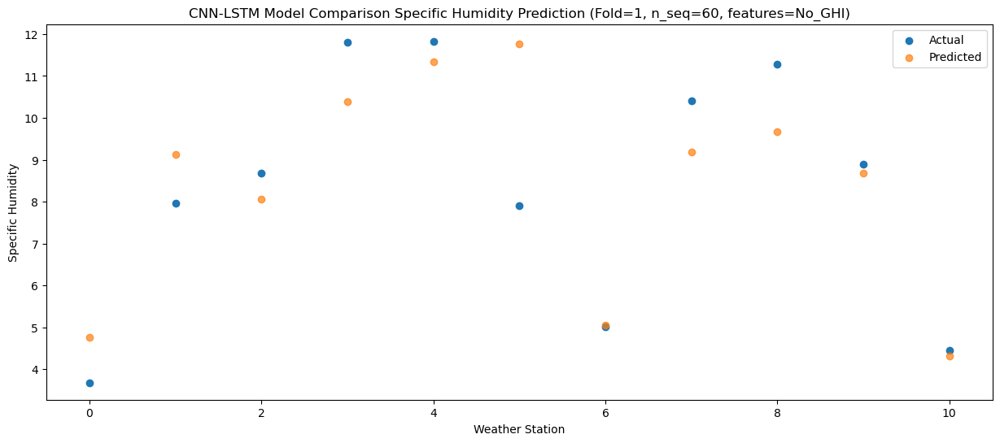

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09   8.108572
1                 1   10.93  12.334945
2                 2   11.82  10.834589
3                 3   12.37  11.999100
4                 4   11.91  12.912065
5                 5   10.08  12.858555
6                 6    8.64   8.414319
7                 7   12.98  11.279471
8                 8   11.51  10.936051
9                 9   10.83   9.714567
10               10    9.17   8.352475


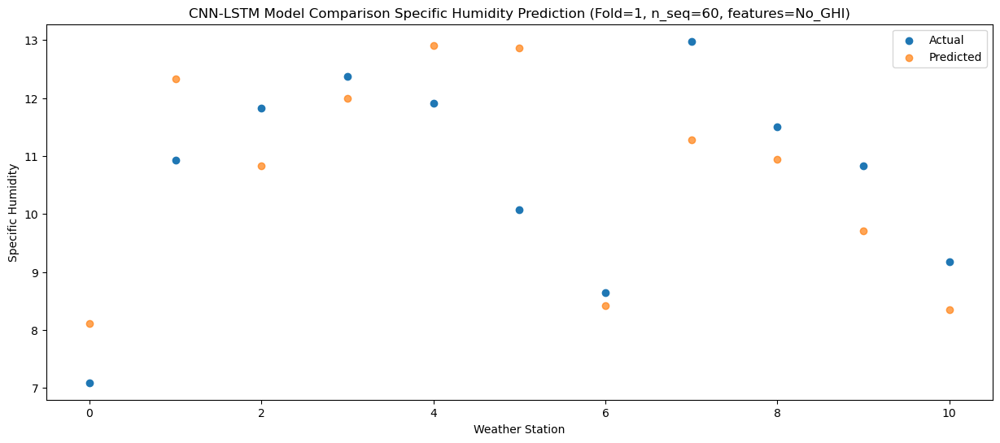

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   6.946794
1                 1   11.06  11.238739
2                 2   11.75   9.928697
3                 3   10.70  11.559956
4                 4   10.51  12.476096
5                 5   10.23  12.722969
6                 6    8.53   7.248822
7                 7   12.56  10.628824
8                 8    9.68  10.573909
9                 9    8.92   9.530974
10               10    6.88   6.823145


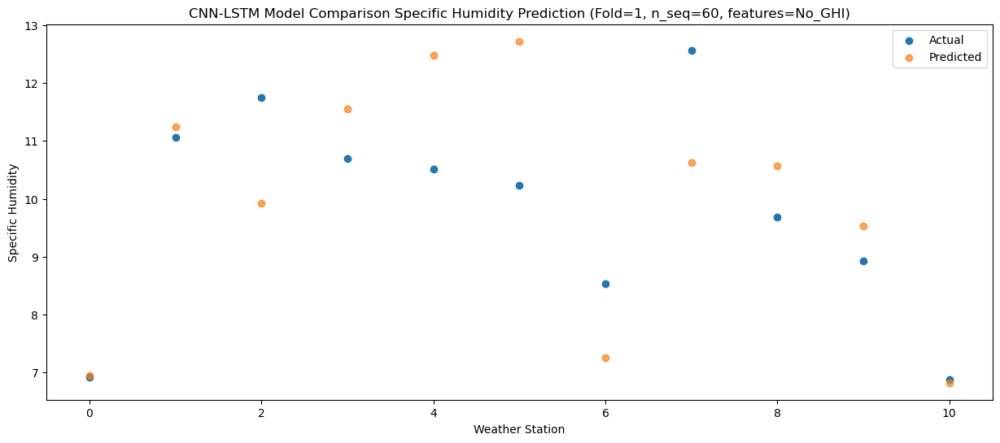

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06   4.712051
1                 1    7.95   8.902056
2                 2    7.94   7.426870
3                 3    9.50   8.948577
4                 4    9.76   9.829970
5                 5    9.87  10.579923
6                 6    5.56   4.979847
7                 7    8.07   7.933746
8                 8    8.73   7.993990
9                 9    7.27   7.330555
10               10    5.62   4.980168


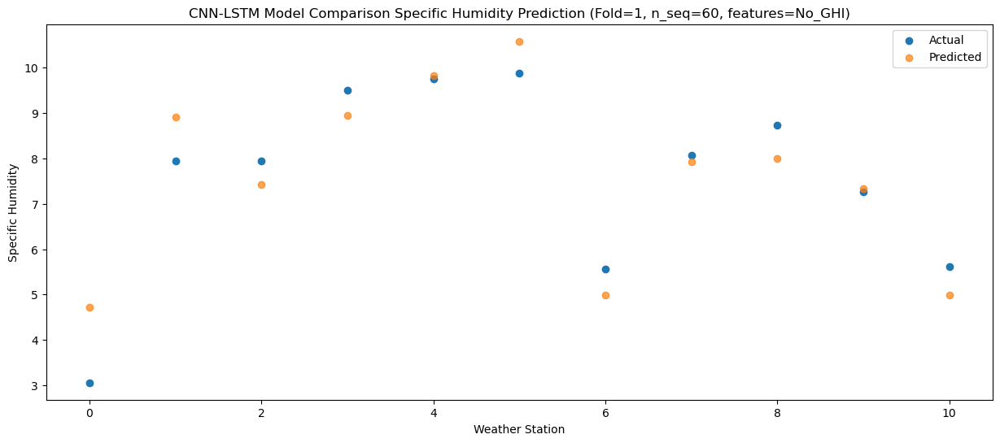

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34   0.942543
1                 1    4.10   5.149223
2                 2    3.43   3.578530
3                 3    6.08   5.221579
4                 4    6.37   6.082265
5                 5    7.89   7.502299
6                 6    1.31   1.267098
7                 7    4.82   4.200619
8                 8    5.30   4.497002
9                 9    4.16   4.288868
10               10    2.57   1.603305


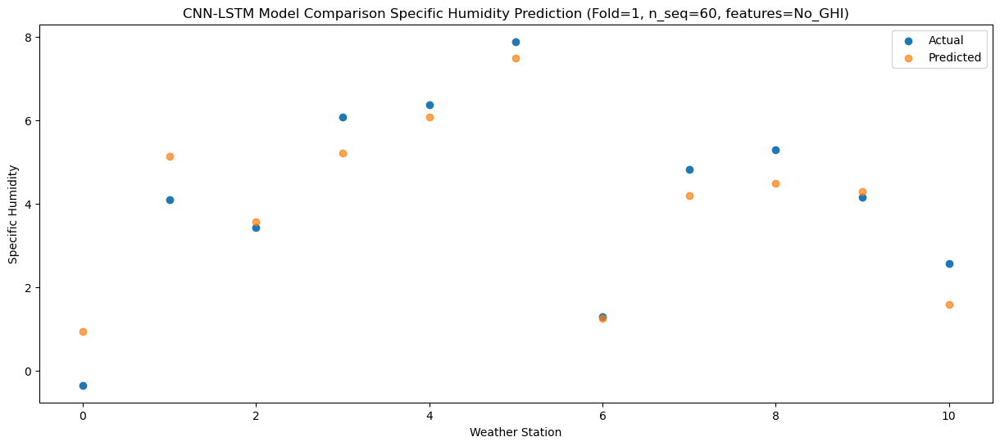

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40  -2.212631
1                 1    1.09   2.016234
2                 2    0.88   0.618355
3                 3    2.75   2.651928
4                 4    3.03   3.508001
5                 5    5.26   5.145867
6                 6   -2.04  -1.931350
7                 7    2.11   1.366044
8                 8    2.63   1.903056
9                 9    1.84   1.832107
10               10   -1.09  -1.959592


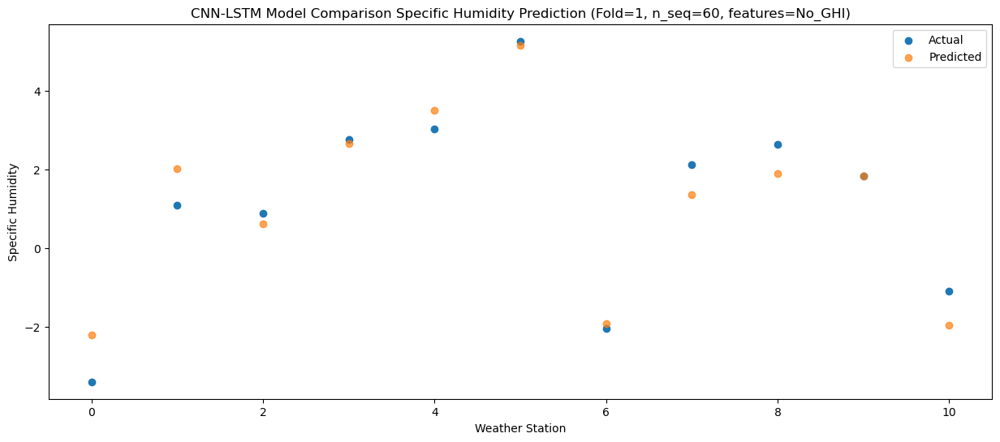

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15  -2.430959
1                 1    0.51   1.805904
2                 2   -0.14   0.151541
3                 3    1.11   1.856479
4                 4    1.31   2.699747
5                 5    3.39   4.617814
6                 6   -2.54  -2.044243
7                 7    0.72   0.870278
8                 8    1.58   1.292036
9                 9    1.40   1.419728
10               10   -0.85  -1.456818


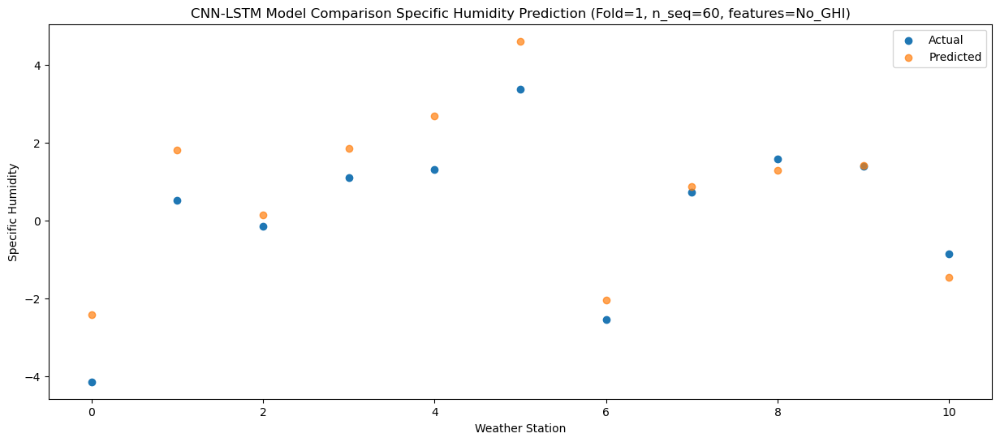

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54  -3.349366
1                 1   -0.26   0.820869
2                 2   -0.77  -0.828792
3                 3    0.01   0.894165
4                 4    0.14   1.717530
5                 5    2.24   3.796864
6                 6   -3.36  -3.028993
7                 7   -0.35  -0.255020
8                 8    0.27   0.219474
9                 9    0.66   0.483995
10               10   -1.90  -2.499719


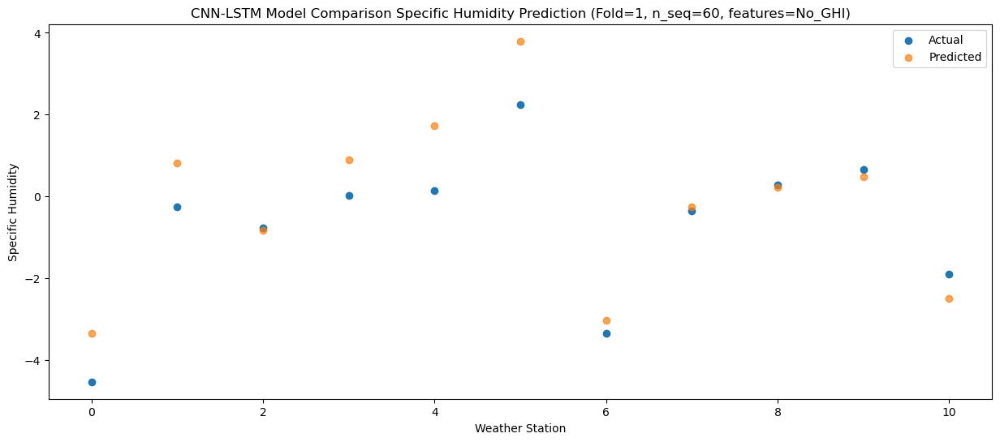

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93  -3.173328
1                 1    0.08   1.144077
2                 2    0.03  -0.276144
3                 3    2.26   1.978909
4                 4    2.39   2.838699
5                 5    2.65   4.874071
6                 6   -2.88  -2.792067
7                 7    1.40   0.777599
8                 8    2.02   1.525600
9                 9    1.33   1.683286
10               10   -2.03  -2.631084


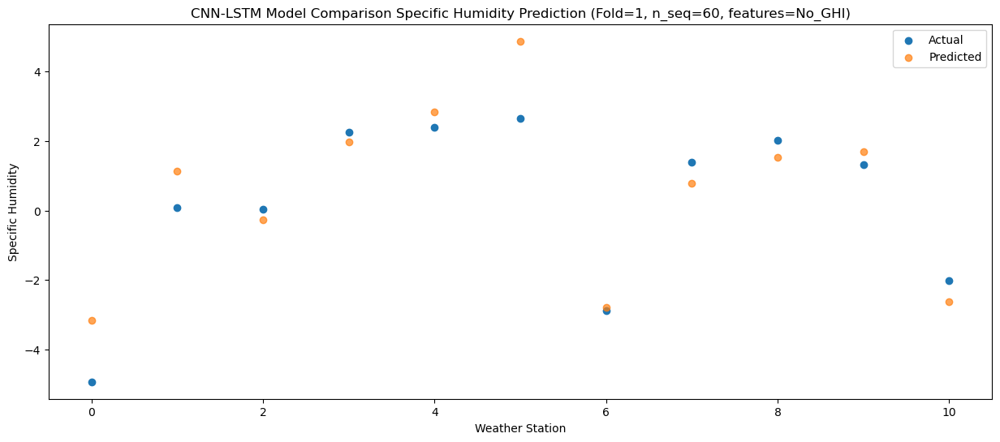

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52  -1.499784
1                 1    1.59   2.660920
2                 2    1.57   1.330873
3                 3    4.17   3.393927
4                 4    4.32   4.233790
5                 5    3.61   5.765822
6                 6   -1.54  -1.311434
7                 7    2.59   1.930696
8                 8    3.57   2.426152
9                 9    1.64   2.301235
10               10   -1.00  -1.594757


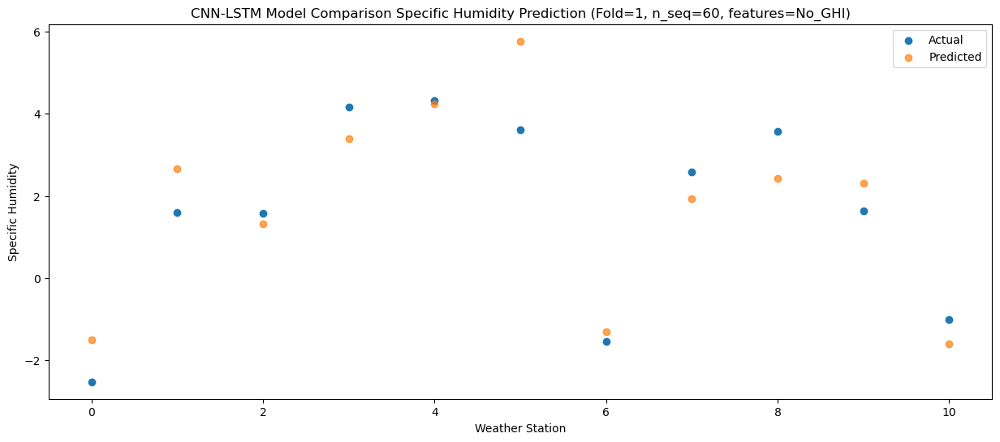

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45   0.069895
1                 1    3.48   4.328822
2                 2    3.56   3.041388
3                 3    6.42   5.175291
4                 4    6.52   6.051763
5                 5    4.25   7.254060
6                 6    0.61   0.339557
7                 7    4.36   3.900398
8                 8    5.89   4.376373
9                 9    2.50   3.972689
10               10    0.61   0.038439


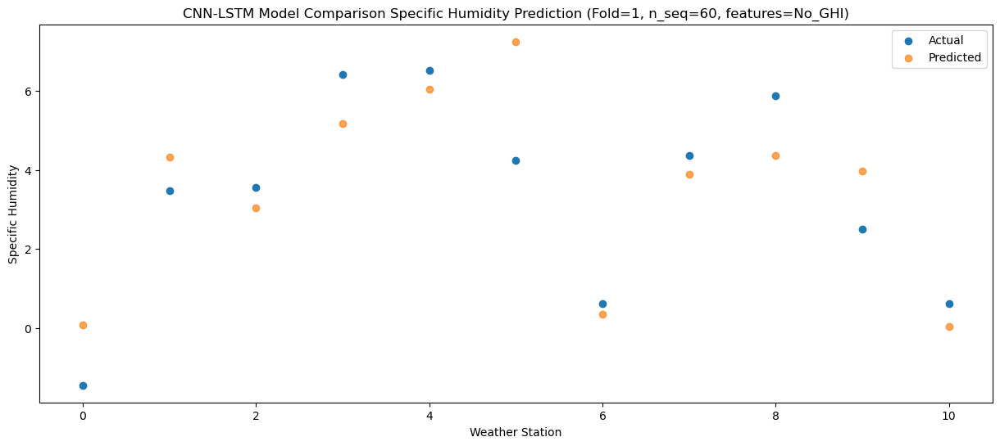

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75   4.180888
1                 1    7.28   8.367819
2                 2    7.69   7.144955
3                 3   10.77   9.004448
4                 4   10.50   9.892969
5                 5    6.68  10.270402
6                 6    4.75   4.348159
7                 7    8.67   7.728779
8                 8    9.49   7.846497
9                 9    5.23   6.904695
10               10    4.19   3.709405


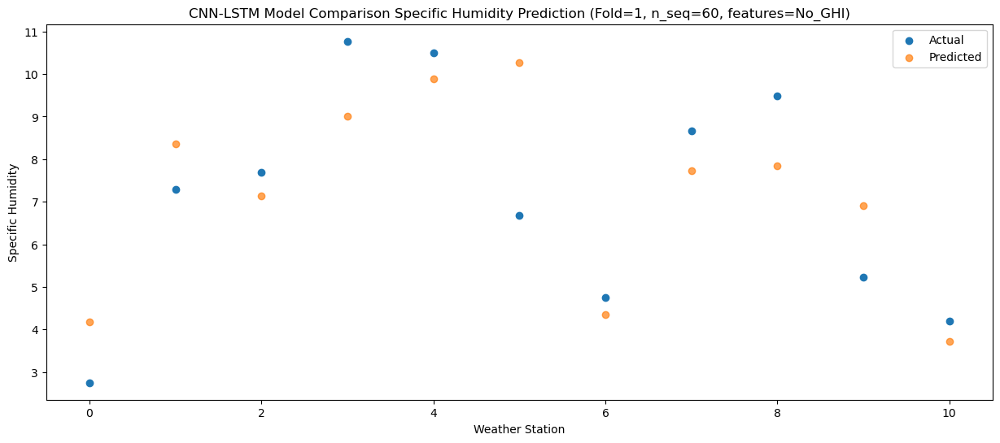

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   5.509707
1                 1    8.79   9.863307
2                 2    9.12   8.634834
3                 3   12.16  10.744999
4                 4   12.01  11.678312
5                 5   11.53  12.141796
6                 6    6.71   5.847793
7                 7   10.69   9.744013
8                 8   12.40  10.087041
9                 9   10.90   9.118450
10               10    6.01   5.470126


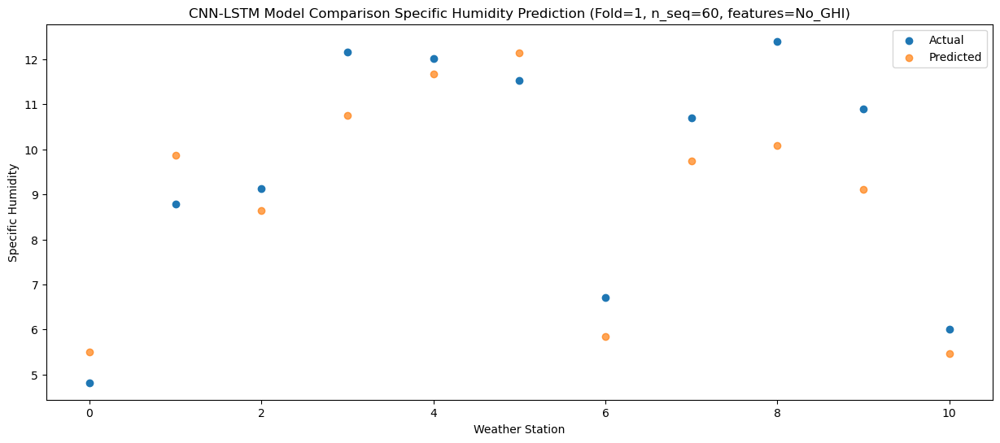

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24   8.092219
1                 1   11.39  12.242199
2                 2   12.29  10.827351
3                 3   12.24  12.324346
4                 4   12.33  13.209356
5                 5   11.38  13.485034
6                 6    9.09   8.292325
7                 7   11.36  11.275425
8                 8   11.01  11.191850
9                 9    9.15  10.192963
10               10    9.38   8.082280


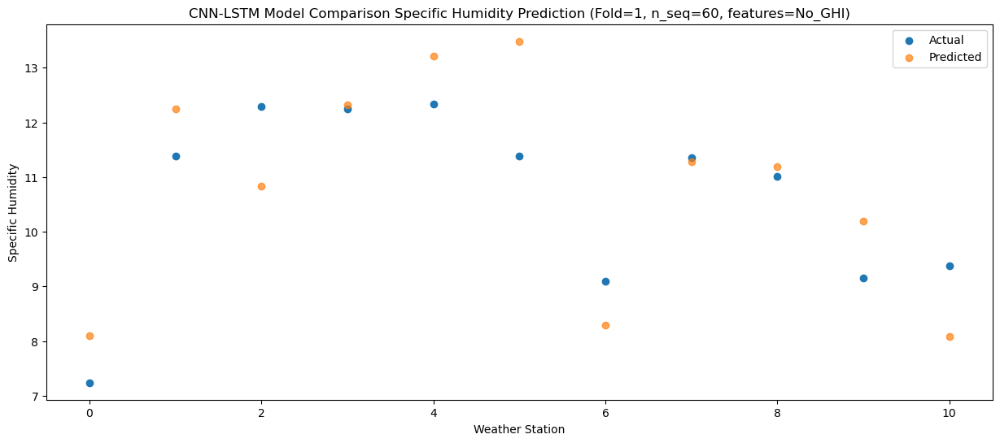

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60   6.662565
1                 1    9.66  10.892206
2                 2   10.17   9.517431
3                 3   12.33  11.293786
4                 4   12.38  12.187761
5                 5   10.24  12.784755
6                 6    7.37   6.930080
7                 7   10.12  10.239761
8                 8   10.42  10.412242
9                 9    9.34   9.601892
10               10    7.80   6.762337


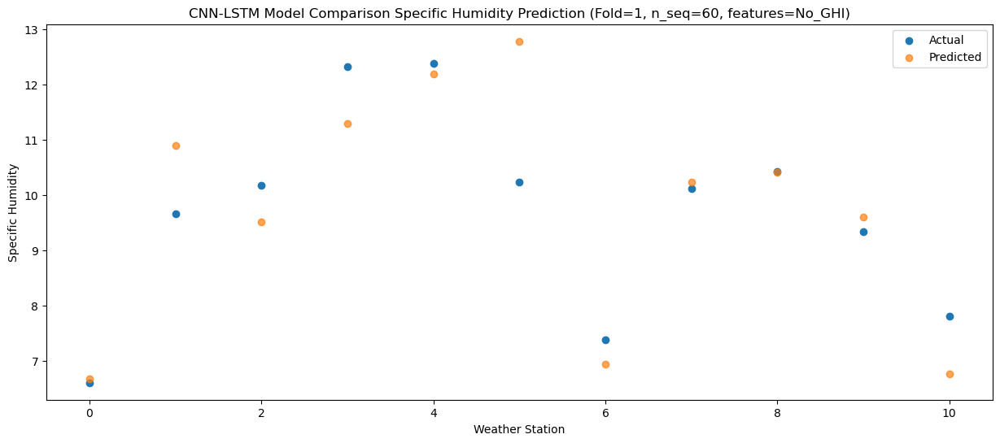

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61   4.648104
1                 1    8.14   8.620728
2                 2    8.62   7.252561
3                 3    9.41   8.769041
4                 4    9.84   9.590564
5                 5   10.72  10.280796
6                 6    6.08   4.656901
7                 7    8.36   7.229897
8                 8    8.51   7.207125
9                 9    6.90   6.587537
10               10    5.31   4.173570


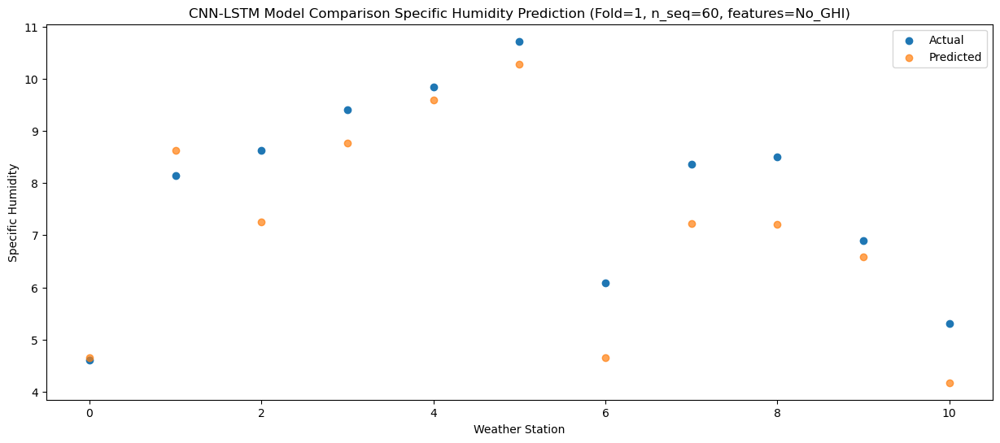

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34   0.092364
1                 1    4.31   4.132799
2                 2    4.12   2.719404
3                 3    5.36   4.490236
4                 4    5.51   5.303497
5                 5    6.45   6.701318
6                 6    1.94   0.190581
7                 7    3.32   2.950820
8                 8    5.15   3.237699
9                 9    3.91   3.078002
10               10    1.00  -0.028144


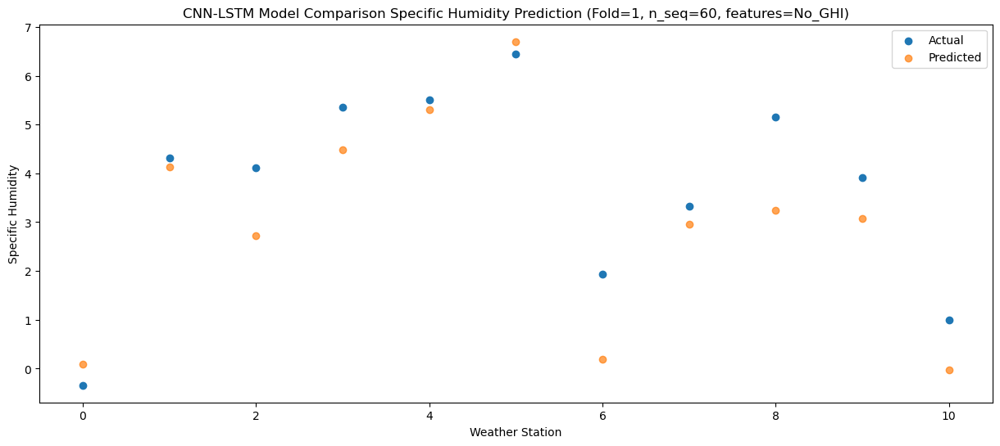

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

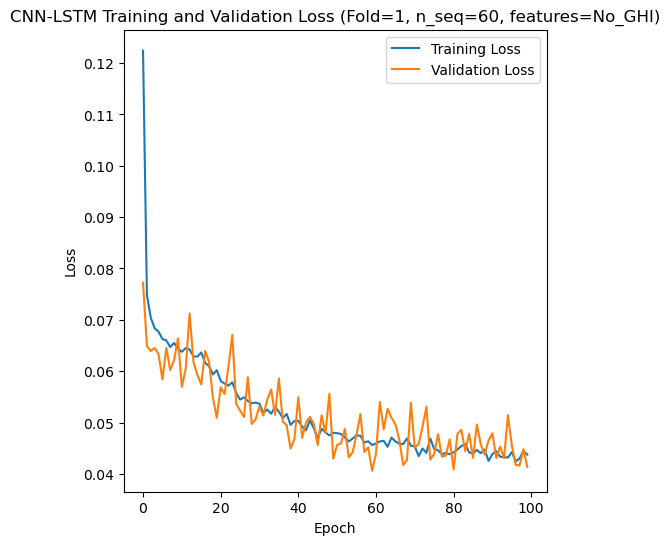

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 24s 107ms/step - loss: 0.1255 - accuracy: 0.2143 - mae: 0.1057 - rmse: 0.1255 - mape: 22.6417 - pearson: 0.6009 - val_loss: 0.0660 - val_accuracy: 0.1000 - val_mae: 0.0505 - val_rmse: 0.0660 - val_mape: 11.5311 - val_pearson: 0.7966
Epoch 2/100
84/84 [==============================] - 4s 49ms/step - loss: 0.0749 - accuracy: 0.3929 - mae: 0.0589 - rmse: 0.0749 - mape: 13.3573 - pearson: 0.7488 - val_loss: 0.0524 - val_accuracy: 0.1000 - val_mae: 0.0404 - val_rmse: 0.0524 - val_mape: 9.4295 - val_pearson: 0.8860
Epoch 3/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0710 - accuracy: 0.5000 - mae: 0.0559 - rmse: 0.0710 - mape: 12.6676 - pearson: 0.7595 - va

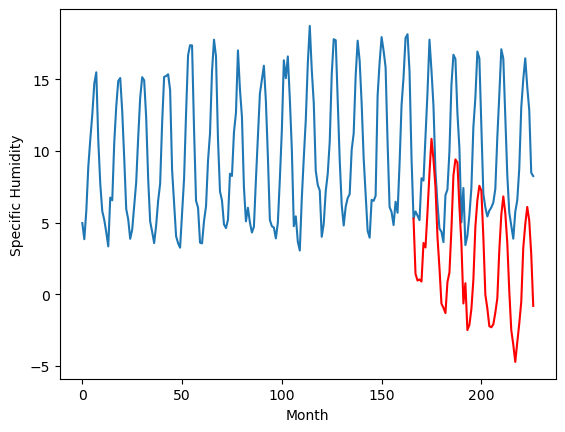

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		3.78		0.44
2.83		3.10		0.27
2.81		3.10		0.29
2.87		2.72		-0.15
4.66		4.56		-0.10
4.95		4.76		-0.19
7.85		6.93		-0.92
9.27		8.83		-0.44
14.08		10.49		-3.59
12.65		8.97		-3.68
8.59		7.37		-1.22
4.86		4.34		-0.52
4.64		3.14		-1.50
2.91		1.85		-1.06
2.86		1.69		-1.17
2.18		0.93		-1.25
4.03		2.51		-1.52
4.15		3.11		-1.04
9.27		5.71		-3.56
12.18		8.28		-3.90
13.79		9.30		-4.49
12.17		8.70		-3.47
9.35		6.14		-3.21
5.96		3.96		-2.00
3.53		1.84		-1.69
2.47		1.56		-0.91
2.14		0.01		-2.13
2.05		-0.25		-2.30
2.93		0.90		-2.03
4.08		2.08		-2.00
6.47		4.62		-1.85
10.83		6.57		-4.26
12.17		7.30		-4.87
11.67		7.33		-4.34
9.10		4.75		-4.35
5.42		2.07		-3.35
3.92		0.15		-3.77
2.73		-0.35		-3.08
2.72		-0.34		-3.06
2.64		-0.76		-3.40
3.33		0.30		-3.03
3.95		1.02		-2.93
9.73		4.66		-5.07
12.38		6.34		-6.04
14.44		6.71		-7.73
12.55		6.09		-6.46
9.96		4.52		-5.44
6.50		2.02		-4.48
3.94		-0.21		-4.15
3.55		-0.

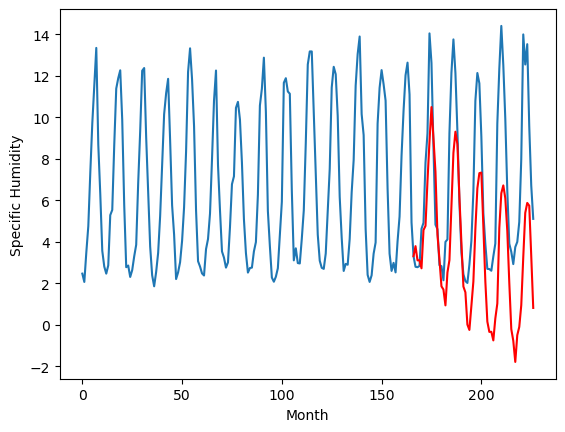

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-2.01		0.45
-2.15		-1.99		0.16
-3.71		-2.03		1.68
-2.83		-1.90		0.93
-1.66		0.43		2.09
-0.18		0.04		0.22
0.93		1.81		0.88
4.27		4.06		-0.21
5.29		5.71		0.42
5.99		5.88		-0.11
5.29		4.52		-0.77
2.70		2.42		-0.28
-0.25		-0.75		-0.50
-4.92		-3.67		1.25
-4.43		-3.76		0.67
-2.30		-3.42		-1.12
-2.08		-2.20		-0.12
-1.11		-1.83		-0.72
0.20		0.44		0.24
3.98		3.98		0.00
4.38		4.95		0.57
5.00		4.96		-0.04
3.72		2.90		-0.82
1.06		0.54		-0.52
-2.89		-3.47		-0.58
-1.49		-1.55		-0.06
-5.14		-4.82		0.32
-3.95		-4.09		-0.14
-2.14		-3.15		-1.01
-0.78		-1.86		-1.08
2.32		1.20		-1.12
4.25		2.75		-1.50
5.08		4.12		-0.96
4.97		3.57		-1.40
4.82		1.03		-3.79
0.43		-2.32		-2.75
0.32		-3.26		-3.58
-3.34		-4.49		-1.15
-3.72		-4.42		-0.70
-1.87		-3.93		-2.06
-1.48		-3.63		-2.15
0.03		-2.39		-2.42
0.84		-0.36		-1.20
4.00		1.74		-2.26
4.97		3.39		-1.58
5.69		2.35		-3.34
3.30		0.60		-2.70
0.38		-2.48		-2.86
-2.12		-

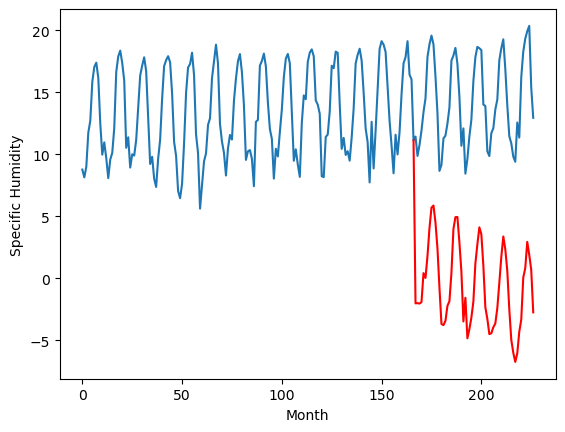

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		5.81		1.32
3.93		5.65		1.72
3.75		5.47		1.72
3.77		5.33		1.56
4.29		6.15		1.86
4.67		6.46		1.79
6.92		8.56		1.64
10.93		11.19		0.26
14.31		13.50		-0.81
13.48		12.94		-0.54
10.39		10.66		0.27
7.88		8.41		0.53
6.01		6.48		0.47
4.09		4.95		0.86
3.01		4.36		1.35
3.18		3.92		0.74
3.82		4.62		0.80
5.17		5.68		0.51
6.85		6.93		0.08
11.45		10.85		-0.60
14.05		12.02		-2.03
14.79		12.53		-2.26
12.13		9.88		-2.25
9.17		8.31		-0.86
4.72		4.54		-0.18
4.36		4.19		-0.17
3.03		3.00		-0.03
3.60		3.19		-0.41
4.36		4.09		-0.27
5.06		4.33		-0.73
8.36		7.16		-1.20
10.62		8.59		-2.03
13.98		10.70		-3.28
14.66		10.58		-4.08
10.86		8.33		-2.53
7.99		5.44		-2.55
6.17		3.73		-2.44
4.08		2.52		-1.56
4.59		3.03		-1.56
3.83		2.22		-1.61
4.08		2.49		-1.59
6.16		4.28		-1.88
6.97		5.16		-1.81
10.87		7.40		-3.47
15.13		10.28		-4.85
12.79		8.94		-3.85
11.78		8.06		-3.72
8.42		5.45		-2.97
4.59		2.32		-2.27
4.88		2.65		-2

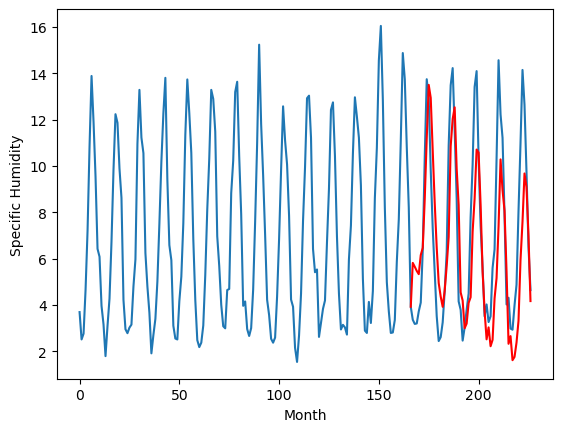

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		-0.88		1.19
-1.27		-1.10		0.17
-1.24		-1.01		0.23
-0.92		-0.97		-0.05
2.57		2.10		-0.47
1.61		1.49		-0.12
3.73		3.67		-0.06
7.07		6.23		-0.84
9.20		8.27		-0.93
8.47		7.57		-0.90
6.67		6.05		-0.62
3.46		3.04		-0.42
0.73		0.11		-0.62
-2.55		-3.02		-0.47
-2.42		-3.13		-0.71
-2.44		-3.03		-0.59
0.85		-0.99		-1.84
0.87		-0.60		-1.47
4.07		2.50		-1.57
7.96		6.19		-1.77
8.99		7.22		-1.77
8.59		6.98		-1.61
6.45		4.34		-2.11
3.92		1.59		-2.33
-1.74		-2.81		-1.07
1.54		-0.45		-1.99
-3.37		-4.47		-1.10
-1.91		-3.79		-1.88
-1.06		-2.74		-1.68
1.37		-0.58		-1.95
5.40		3.08		-2.32
7.70		4.85		-2.85
8.99		5.80		-3.19
9.39		5.24		-4.15
5.88		2.07		-3.81
0.70		-1.97		-2.67
0.26		-2.63		-2.89
-0.29		-3.94		-3.65
-0.38		-4.11		-3.73
0.92		-3.38		-4.30
1.80		-2.76		-4.56
2.35		-1.80		-4.15
5.41		1.40		-4.01
8.72		3.80		-4.92
10.06		4.94		-5.12
10.09		3.82		-6.27
7.74		1.57		-6.17
2.51		-1.93		-4.44
-0.01	

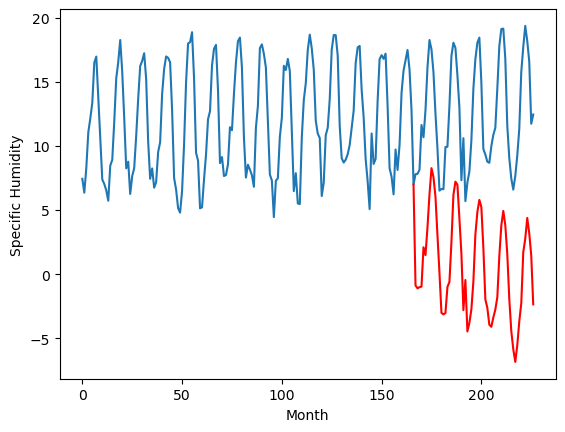

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		4.35		0.58
2.58		3.83		1.25
3.41		3.98		0.57
2.74		3.82		1.08
7.35		6.74		-0.61
6.83		6.38		-0.45
8.91		8.66		-0.25
11.03		10.94		-0.09
13.61		12.89		-0.72
12.17		11.54		-0.63
10.72		10.02		-0.70
6.85		6.67		-0.18
4.79		4.55		-0.24
2.47		2.09		-0.38
2.34		1.99		-0.35
2.29		1.66		-0.63
5.28		3.83		-1.45
6.85		4.26		-2.59
11.68		7.54		-4.14
14.32		10.69		-3.63
13.28		11.72		-1.56
13.41		11.16		-2.25
9.85		8.39		-1.46
8.26		5.69		-2.57
4.07		2.25		-1.82
6.94		3.72		-3.22
1.31		0.41		-0.90
1.53		0.65		-0.88
3.15		1.79		-1.36
7.11		3.93		-3.18
10.76		7.29		-3.47
11.79		9.23		-2.56
12.89		9.80		-3.09
13.35		9.50		-3.85
9.99		6.35		-3.64
5.17		2.69		-2.48
5.03		1.57		-3.46
4.12		0.62		-3.50
3.74		0.40		-3.34
4.19		0.79		-3.40
5.97		1.77		-4.20
6.52		2.45		-4.07
10.22		6.43		-3.79
13.68		8.56		-5.12
13.39		9.02		-4.37
11.96		8.14		-3.82
11.41		5.97		-5.44
7.88		2.79		-5.09
4.71		0.47		-4.24
2.7

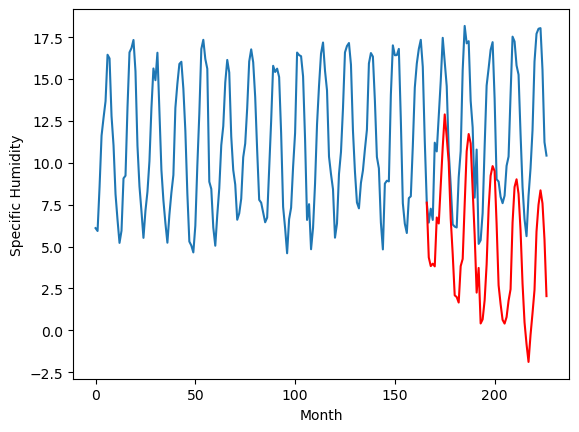

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		3.40		0.51
1.79		2.78		0.99
2.47		2.93		0.46
1.91		2.71		0.80
6.13		5.57		-0.56
5.71		5.29		-0.42
8.65		7.66		-0.99
10.93		9.94		-0.99
13.84		11.94		-1.90
11.14		10.34		-0.80
10.20		8.75		-1.45
5.71		5.23		-0.48
4.12		3.37		-0.75
1.41		1.11		-0.30
1.31		0.98		-0.33
0.98		0.49		-0.49
3.84		2.74		-1.10
5.16		3.23		-1.93
9.36		6.55		-2.81
13.11		9.63		-3.48
13.93		10.68		-3.25
14.31		10.07		-4.24
9.86		7.17		-2.69
7.25		4.49		-2.76
3.26		1.22		-2.04
5.76		2.40		-3.36
0.47		-0.70		-1.17
0.94		-0.59		-1.53
2.57		0.58		-1.99
6.47		2.72		-3.75
10.56		6.07		-4.49
11.36		8.06		-3.30
10.68		8.57		-2.11
11.74		8.35		-3.39
9.07		5.14		-3.93
4.29		1.53		-2.76
3.84		0.30		-3.54
2.67		-0.59		-3.26
1.89		-0.81		-2.70
2.29		-0.55		-2.84
4.20		0.53		-3.67
4.87		1.16		-3.71
8.76		5.34		-3.42
12.66		7.46		-5.20
11.95		7.81		-4.14
9.90		6.95		-2.95
9.27		4.81		-4.46
6.12		1.67		-4.45
3.50		-0.65		-4.15
1.68

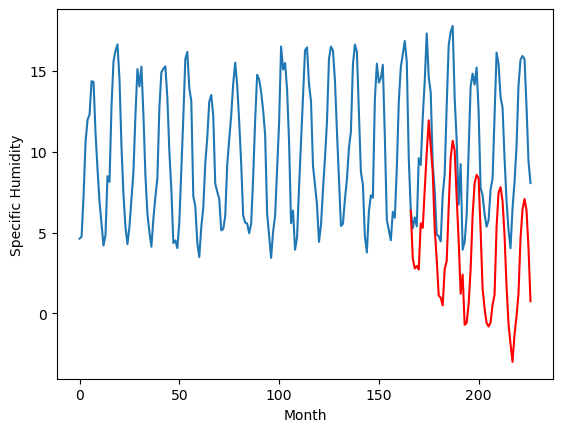

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		3.60		0.05
3.10		3.16		0.06
2.15		3.08		0.93
2.68		2.77		0.09
4.14		4.08		-0.06
2.74		4.38		1.64
2.98		6.02		3.04
4.66		7.38		2.72
8.10		8.42		0.32
6.37		7.87		1.50
5.72		6.68		0.96
2.65		4.63		1.98
2.70		3.10		0.40
1.44		1.95		0.51
1.72		1.90		0.18
1.59		1.46		-0.13
1.68		2.25		0.57
1.98		2.65		0.67
2.10		4.53		2.43
4.76		6.75		1.99
10.00		7.64		-2.36
10.29		7.14		-3.15
7.53		5.35		-2.18
3.82		3.50		-0.32
2.17		2.05		-0.12
2.30		1.56		-0.74
2.02		0.55		-1.47
1.03		0.35		-0.68
1.43		1.43		-0.00
1.44		1.84		0.40
1.37		3.62		2.25
6.87		5.37		-1.50
9.43		6.30		-3.13
11.40		6.32		-5.08
8.36		4.40		-3.96
6.28		2.53		-3.75
2.31		0.32		-1.99
3.13		0.04		-3.09
2.24		0.16		-2.08
2.12		-0.36		-2.48
2.46		0.46		-2.00
1.62		1.32		-0.30
3.62		4.04		0.42
3.42		5.18		1.76
6.77		5.69		-1.08
8.96		5.33		-3.63
7.15		4.14		-3.01
4.70		2.11		-2.59
3.78		0.11		-3.67
2.26		-0.24		-2.50
2.68		-0.92		-3.60
2.7

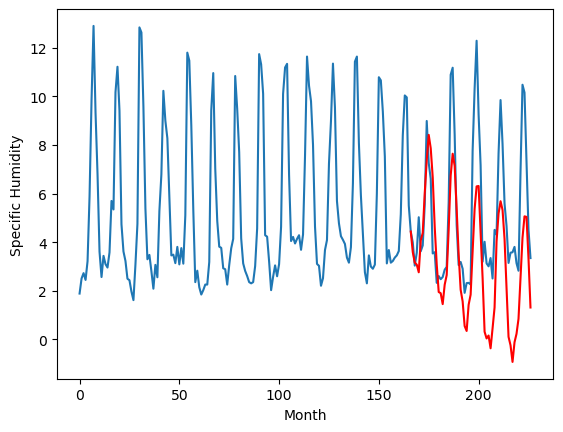

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		1.41		-0.82
2.05		1.13		-0.92
1.84		0.98		-0.86
1.12		0.66		-0.46
2.76		1.36		-1.40
4.17		1.87		-2.30
4.93		3.04		-1.89
4.91		3.87		-1.04
5.68		4.35		-1.33
6.76		4.47		-2.29
4.98		3.61		-1.37
3.85		2.35		-1.50
1.61		0.74		-0.87
0.04		-0.05		-0.09
0.89		-0.03		-0.92
1.42		-0.34		-1.76
1.53		-0.24		-1.77
2.85		-0.00		-2.85
4.33		1.22		-3.11
5.58		2.99		-2.59
6.73		3.78		-2.95
6.13		3.31		-2.82
5.67		2.14		-3.53
2.87		0.63		-2.24
2.33		-0.00		-2.33
2.15		-0.98		-3.13
0.79		-1.24		-2.03
0.05		-1.52		-1.57
1.79		-0.50		-2.29
2.63		-0.82		-3.45
3.89		0.19		-3.70
5.66		1.78		-3.88
6.55		2.81		-3.74
6.65		2.89		-3.76
7.50		1.61		-5.89
5.73		0.55		-5.18
1.09		-2.06		-3.15
1.94		-2.05		-3.99
2.03		-1.83		-3.86
0.62		-2.60		-3.22
2.54		-1.91		-4.45
3.24		-0.98		-4.22
4.64		1.05		-3.59
5.02		1.65		-3.37
6.36		2.16		-4.20
6.97		2.08		-4.89
6.72		1.27		-5.45
4.42		-0.24		-4.66
1.39		-2.03		-3.42
2.18

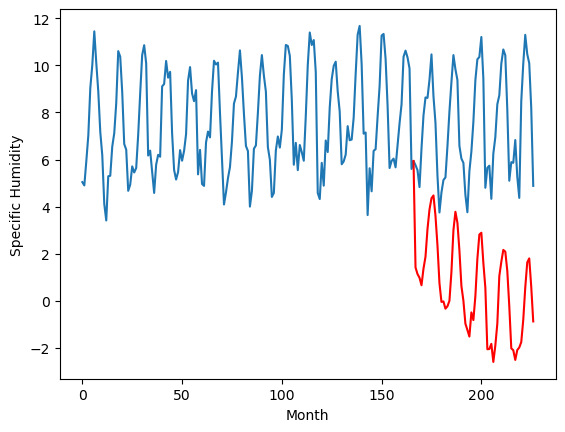

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		0.66		0.83
-0.06		0.54		0.60
-0.08		0.46		0.54
0.31		0.47		0.16
1.94		2.50		0.56
1.85		2.27		0.42
5.18		4.45		-0.73
8.69		7.24		-1.45
11.54		9.56		-1.98
11.53		9.06		-2.47
7.81		7.07		-0.74
5.19		4.43		-0.76
2.54		1.75		-0.79
-0.68		-0.84		-0.16
-0.80		-1.22		-0.42
-0.73		-1.27		-0.54
1.00		0.14		-0.86
1.53		0.90		-0.63
4.24		3.07		-1.17
8.74		7.18		-1.56
10.26		8.30		-1.96
10.84		8.56		-2.28
7.24		5.84		-1.40
5.08		3.66		-1.42
-0.48		-0.92		-0.44
1.37		0.42		-0.95
-1.41		-2.47		-1.06
-0.10		-1.86		-1.76
0.86		-0.91		-1.77
1.90		0.37		-1.53
6.22		3.84		-2.38
8.02		5.38		-2.64
11.60		7.09		-4.51
10.03		6.65		-3.38
6.60		3.85		-2.75
2.24		0.13		-2.11
1.77		-0.83		-2.60
-0.47		-2.28		-1.81
0.39		-2.06		-2.45
1.15		-2.00		-3.15
0.84		-1.69		-2.53
2.97		-0.17		-3.14
4.50		1.62		-2.88
7.36		4.10		-3.26
11.20		6.45		-4.75
10.71		5.07		-5.64
7.57		3.44		-4.13
3.38		0.20		-3.18
0.27		-2.75		-3

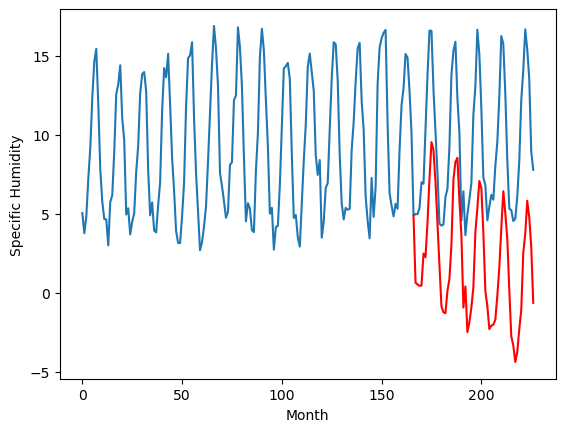

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		0.87		0.35
0.97		0.68		-0.29
0.77		0.61		-0.16
0.88		0.58		-0.30
2.73		2.62		-0.11
2.16		2.41		0.25
4.95		4.67		-0.28
8.39		7.49		-0.90
11.09		9.87		-1.22
10.85		9.18		-1.67
8.24		7.12		-1.12
5.05		4.34		-0.71
1.93		1.82		-0.11
0.14		-0.67		-0.81
0.15		-1.07		-1.22
0.39		-1.22		-1.61
1.42		0.27		-1.15
2.03		1.07		-0.96
4.70		3.30		-1.40
8.80		7.39		-1.41
10.21		8.54		-1.67
10.60		8.76		-1.84
7.39		5.94		-1.45
5.66		3.76		-1.90
0.30		-0.77		-1.07
1.86		0.44		-1.42
-0.56		-2.38		-1.82
0.34		-1.84		-2.18
0.96		-0.86		-1.82
2.23		0.46		-1.77
6.39		3.97		-2.42
8.35		5.55		-2.80
11.56		7.22		-4.34
10.57		6.82		-3.75
7.09		3.97		-3.12
2.43		0.21		-2.22
1.81		-0.79		-2.60
0.72		-2.21		-2.93
0.99		-2.00		-2.99
1.39		-2.01		-3.40
0.99		-1.63		-2.62
2.63		-0.15		-2.78
5.22		1.79		-3.43
7.06		4.29		-2.77
10.37		6.57		-3.80
10.48		5.21		-5.27
8.06		3.56		-4.50
3.95		0.33		-3.62
1.00		-2.64		-3.64
0

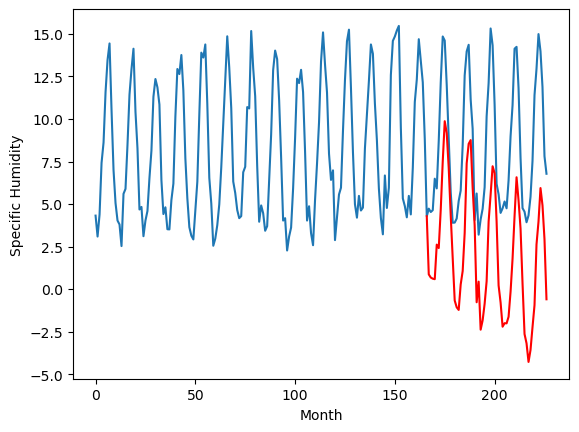

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.416733
1                 1    3.34   3.784471
2                 2   -2.46  -2.006027
3                 3    4.49   5.813767
4                 4   -2.07  -0.879353
5                 5    3.77   4.352033
6                 6    2.89   3.396776
7                 7    3.55   3.597253
8                 8    2.23   1.413115
9                 9   -0.17   0.660331
10               10    0.52   0.866300


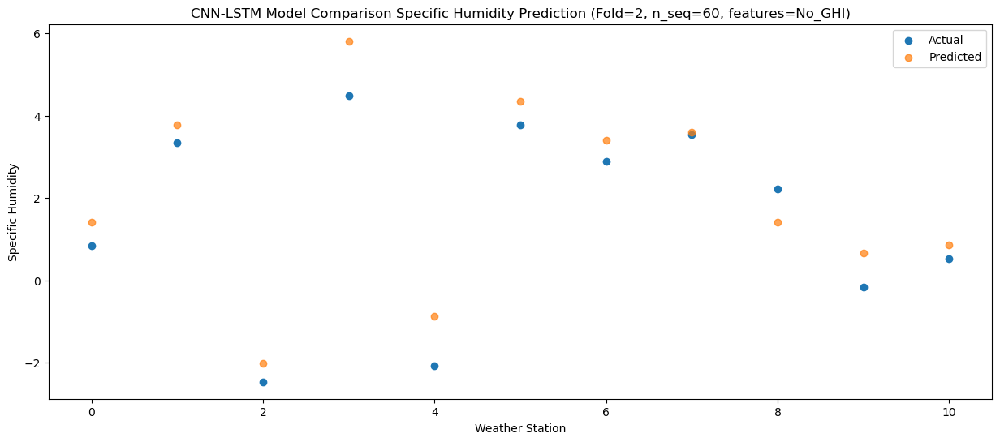

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   0.955009
1                 1    2.83   3.099958
2                 2   -2.15  -1.987995
3                 3    3.93   5.647048
4                 4   -1.27  -1.102898
5                 5    2.58   3.834962
6                 6    1.79   2.781737
7                 7    3.10   3.164110
8                 8    2.05   1.132371
9                 9   -0.06   0.538190
10               10    0.97   0.680291


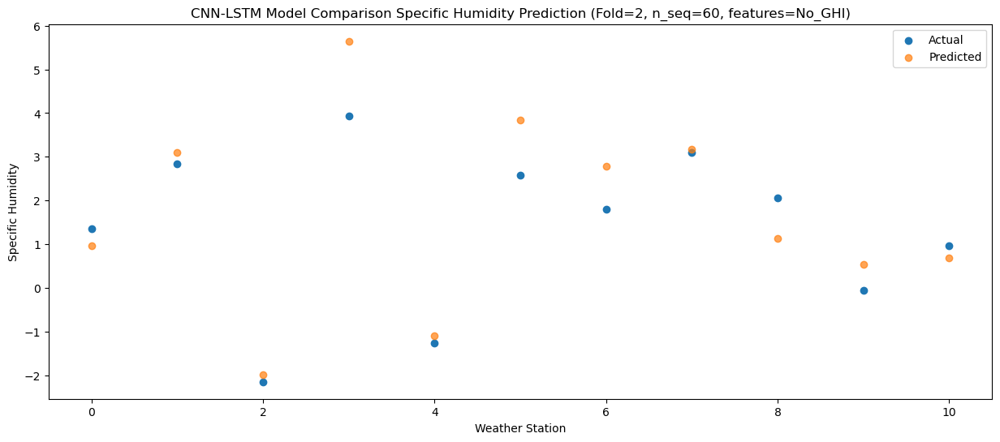

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   1.030195
1                 1    2.81   3.104090
2                 2   -3.71  -2.026112
3                 3    3.75   5.467732
4                 4   -1.24  -1.009823
5                 5    3.41   3.980642
6                 6    2.47   2.934149
7                 7    2.15   3.080556
8                 8    1.84   0.975430
9                 9   -0.08   0.459591
10               10    0.77   0.613593


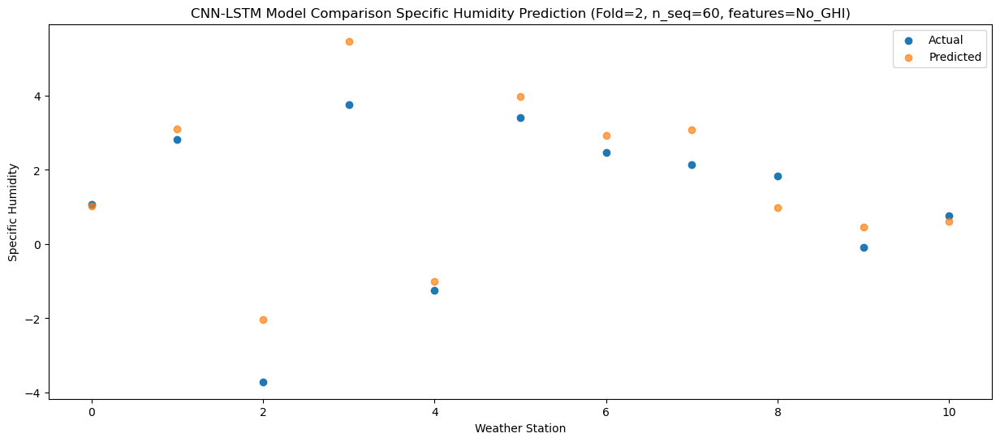

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   0.884597
1                 1    2.87   2.717499
2                 2   -2.83  -1.901878
3                 3    3.77   5.327235
4                 4   -0.92  -0.968440
5                 5    2.74   3.817766
6                 6    1.91   2.710615
7                 7    2.68   2.765650
8                 8    1.12   0.656210
9                 9    0.31   0.474604
10               10    0.88   0.583429


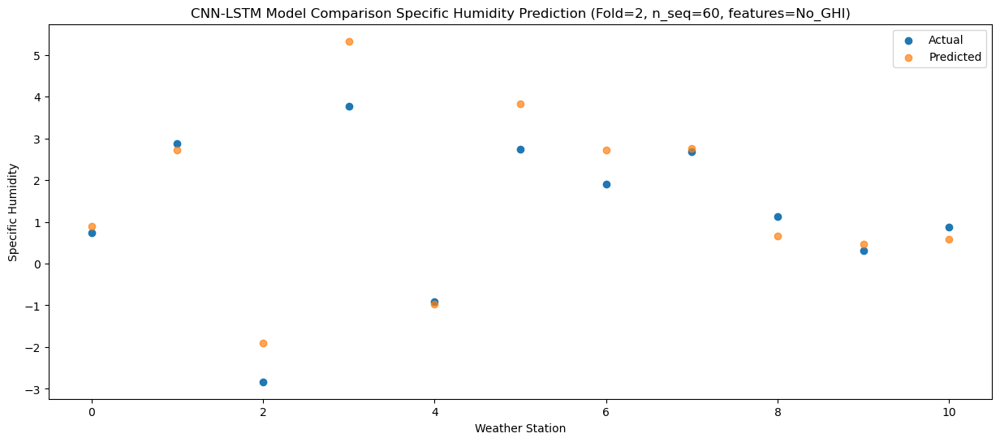

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.579809
1                 1    4.66   4.560203
2                 2   -1.66   0.432351
3                 3    4.29   6.148218
4                 4    2.57   2.101744
5                 5    7.35   6.737768
6                 6    6.13   5.571607
7                 7    4.14   4.075325
8                 8    2.76   1.364374
9                 9    1.94   2.501446
10               10    2.73   2.616111


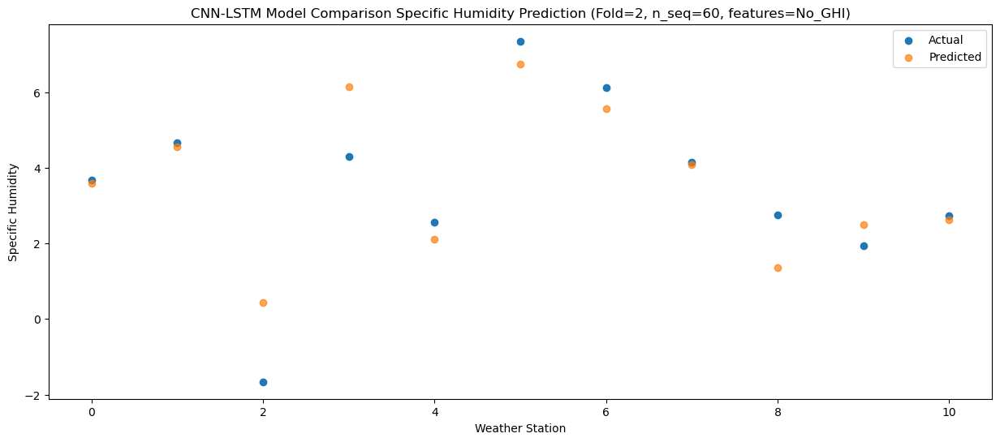

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   3.265933
1                 1    4.95   4.761092
2                 2   -0.18   0.043522
3                 3    4.67   6.462800
4                 4    1.61   1.491594
5                 5    6.83   6.376662
6                 6    5.71   5.289871
7                 7    2.74   4.384373
8                 8    4.17   1.866961
9                 9    1.85   2.269367
10               10    2.16   2.412791


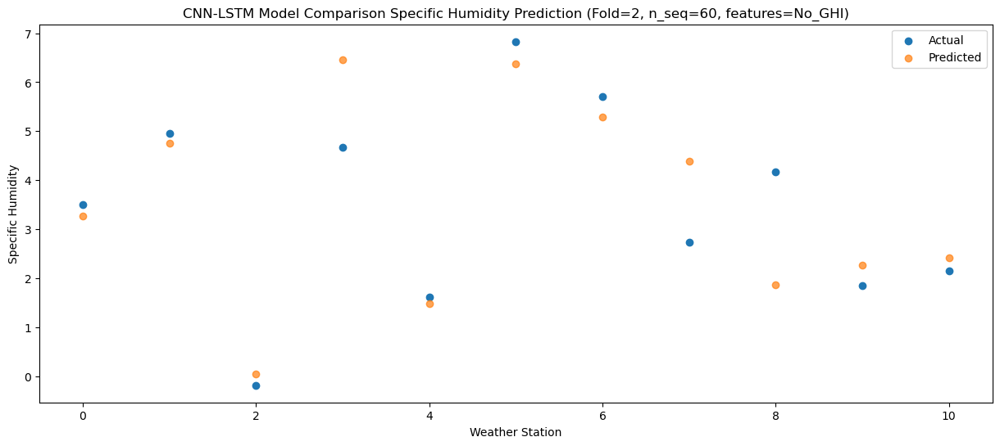

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   5.734817
1                 1    7.85   6.933315
2                 2    0.93   1.814181
3                 3    6.92   8.564673
4                 4    3.73   3.670000
5                 5    8.91   8.664599
6                 6    8.65   7.656131
7                 7    2.98   6.017985
8                 8    4.93   3.043160
9                 9    5.18   4.450044
10               10    4.95   4.669738


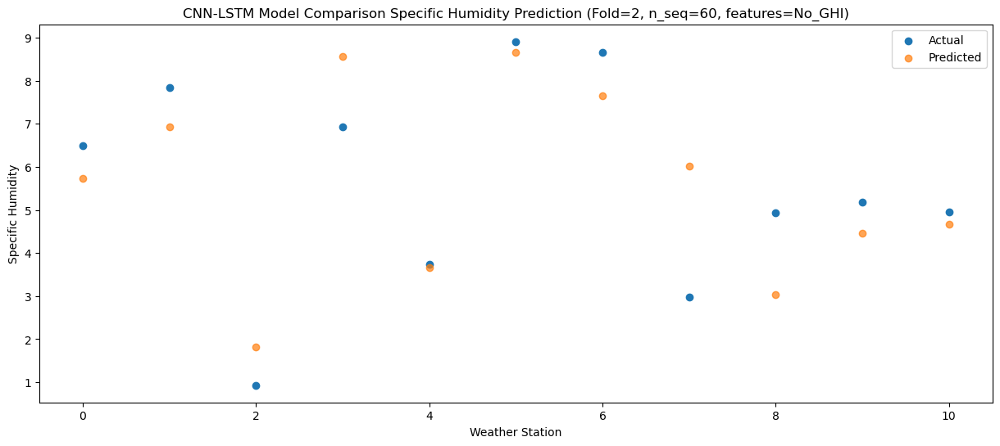

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65   8.471346
1                 1    9.27   8.827882
2                 2    4.27   4.063817
3                 3   10.93  11.193158
4                 4    7.07   6.226123
5                 5   11.03  10.944578
6                 6   10.93   9.940111
7                 7    4.66   7.375666
8                 8    4.91   3.873963
9                 9    8.69   7.242383
10               10    8.39   7.490666


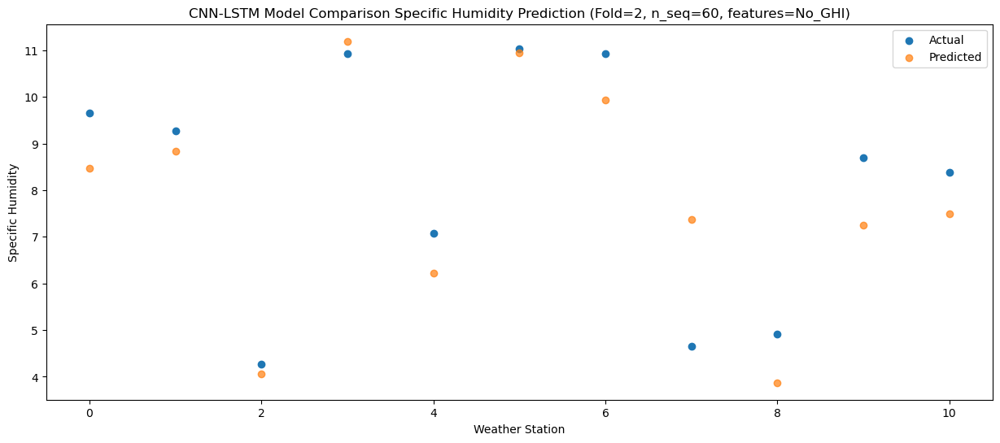

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35  10.854223
1                 1   14.08  10.488793
2                 2    5.29   5.712221
3                 3   14.31  13.495227
4                 4    9.20   8.272603
5                 5   13.61  12.887865
6                 6   13.84  11.941325
7                 7    8.10   8.416919
8                 8    5.68   4.353605
9                 9   11.54   9.556734
10               10   11.09   9.869535


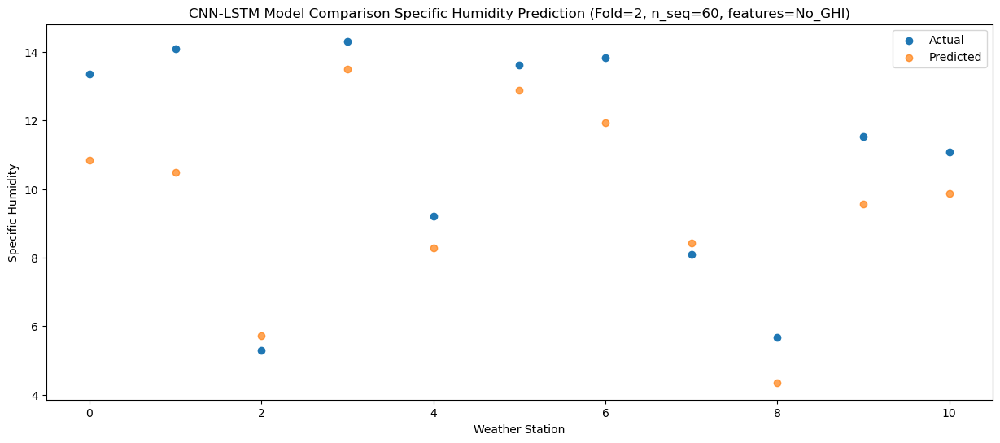

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19   9.412099
1                 1   12.65   8.974831
2                 2    5.99   5.882407
3                 3   13.48  12.937340
4                 4    8.47   7.574847
5                 5   12.17  11.538348
6                 6   11.14  10.337980
7                 7    6.37   7.867265
8                 8    6.76   4.473586
9                 9   11.53   9.060893
10               10   10.85   9.175303


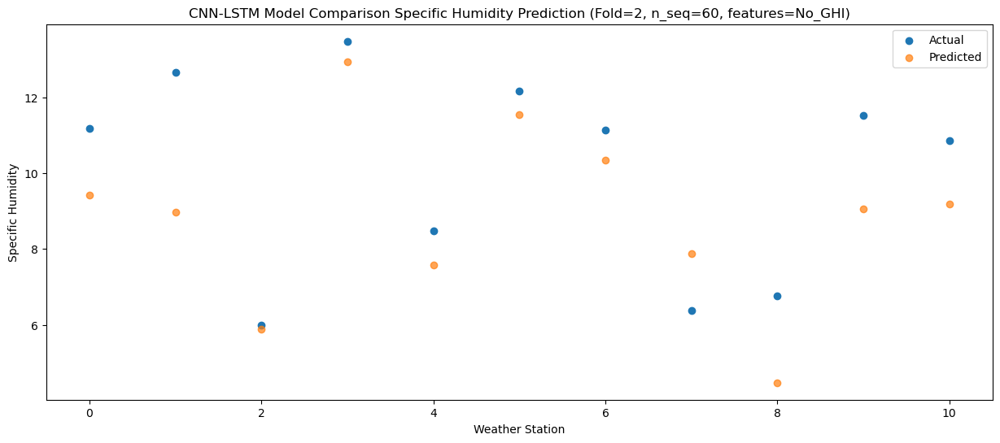

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73   7.480737
1                 1    8.59   7.368379
2                 2    5.29   4.516885
3                 3   10.39  10.658371
4                 4    6.67   6.047851
5                 5   10.72  10.022973
6                 6   10.20   8.748885
7                 7    5.72   6.676587
8                 8    4.98   3.611311
9                 9    7.81   7.065680
10               10    8.24   7.119812


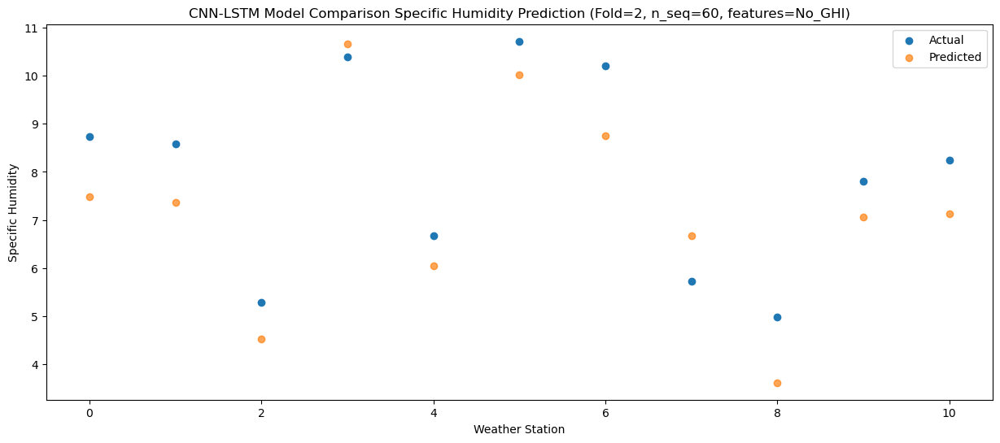

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   4.008949
1                 1    4.86   4.336931
2                 2    2.70   2.415560
3                 3    7.88   8.407691
4                 4    3.46   3.036743
5                 5    6.85   6.671597
6                 6    5.71   5.234399
7                 7    2.65   4.633129
8                 8    3.85   2.351505
9                 9    5.19   4.431318
10               10    5.05   4.342701


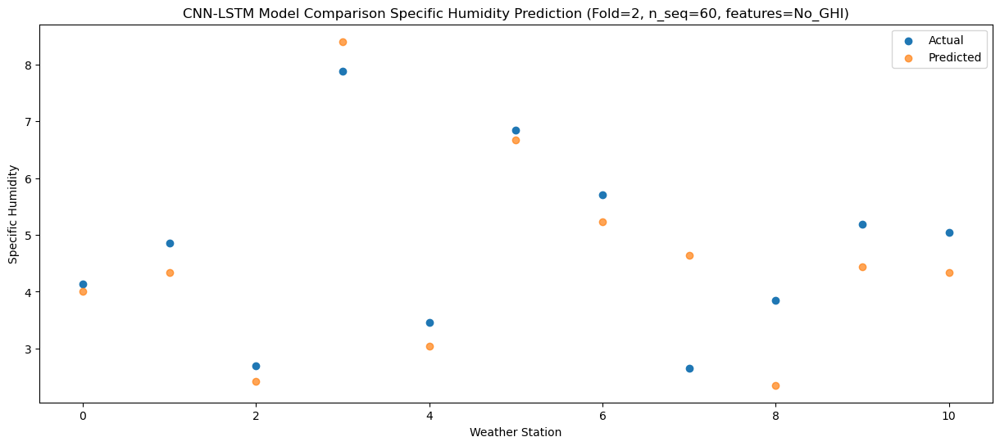

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   1.840599
1                 1    4.64   3.144793
2                 2   -0.25  -0.754906
3                 3    6.01   6.476041
4                 4    0.73   0.112319
5                 5    4.79   4.550583
6                 6    4.12   3.371791
7                 7    2.70   3.095714
8                 8    1.61   0.743953
9                 9    2.54   1.745172
10               10    1.93   1.815161


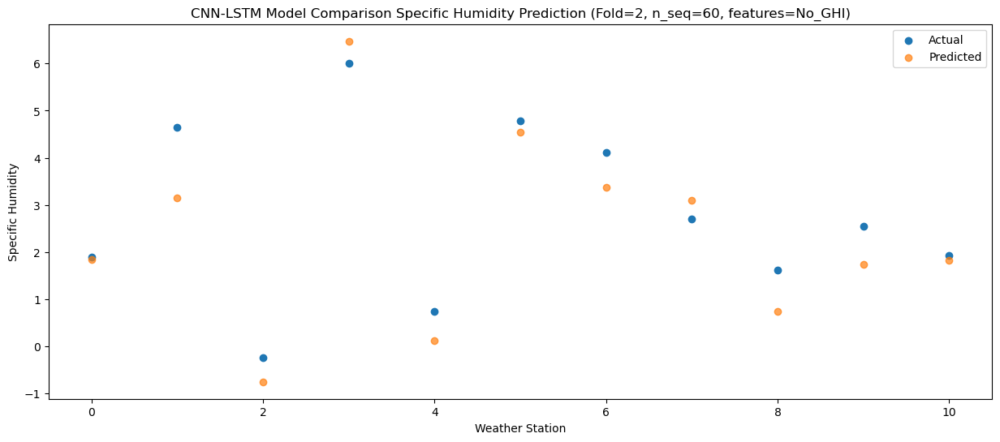

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16  -0.660500
1                 1    2.91   1.847978
2                 2   -4.92  -3.667226
3                 3    4.09   4.946721
4                 4   -2.55  -3.019933
5                 5    2.47   2.089710
6                 6    1.41   1.106509
7                 7    1.44   1.954049
8                 8    0.04  -0.052072
9                 9   -0.68  -0.839233
10               10    0.14  -0.671159


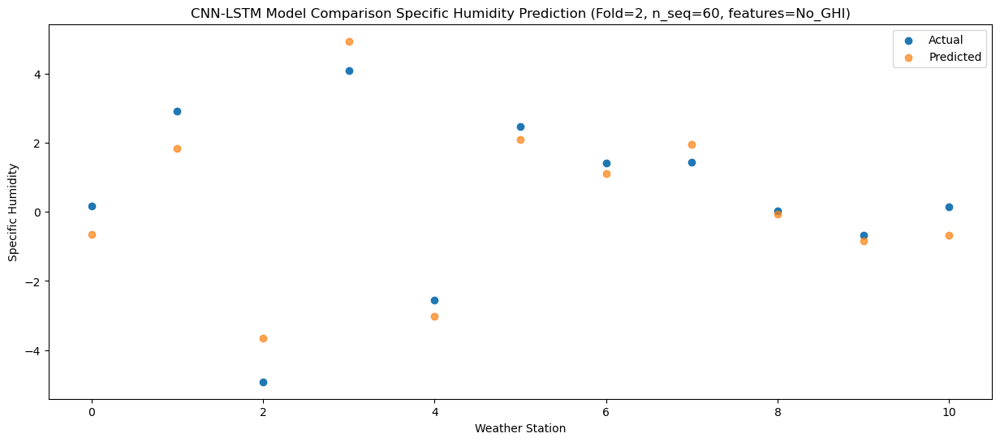

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07  -0.948829
1                 1    2.86   1.693795
2                 2   -4.43  -3.760565
3                 3    3.01   4.358967
4                 4   -2.42  -3.134737
5                 5    2.34   1.987842
6                 6    1.31   0.976639
7                 7    1.72   1.904666
8                 8    0.89  -0.031010
9                 9   -0.80  -1.217136
10               10    0.15  -1.069468


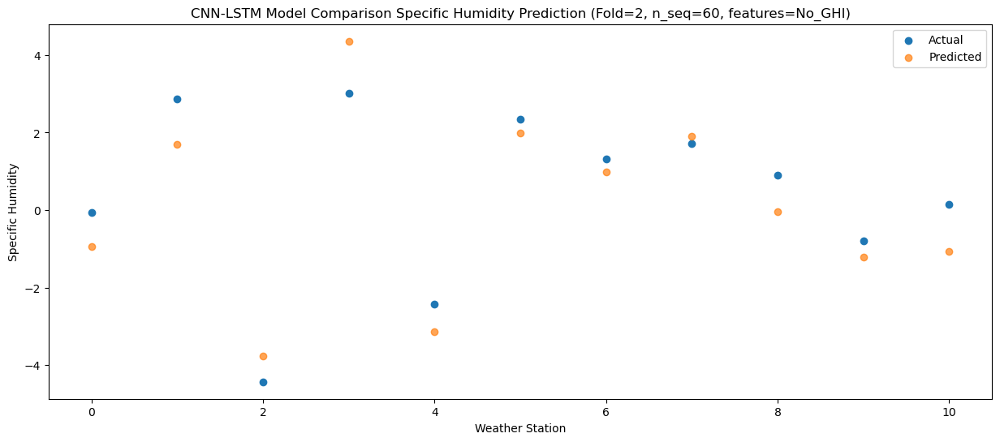

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79  -1.317924
1                 1    2.18   0.929815
2                 2   -2.30  -3.421232
3                 3    3.18   3.918303
4                 4   -2.44  -3.032723
5                 5    2.29   1.658183
6                 6    0.98   0.492256
7                 7    1.59   1.456309
8                 8    1.42  -0.338762
9                 9   -0.73  -1.274361
10               10    0.39  -1.223589


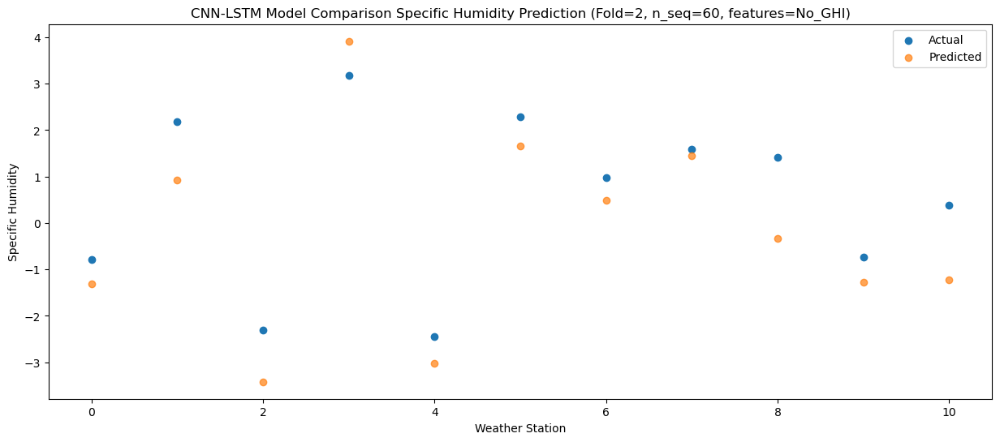

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49   0.843514
1                 1    4.03   2.513982
2                 2   -2.08  -2.201780
3                 3    3.82   4.617775
4                 4    0.85  -0.992205
5                 5    5.28   3.834841
6                 6    3.84   2.742391
7                 7    1.68   2.254646
8                 8    1.53  -0.237817
9                 9    1.00   0.136325
10               10    1.42   0.272547


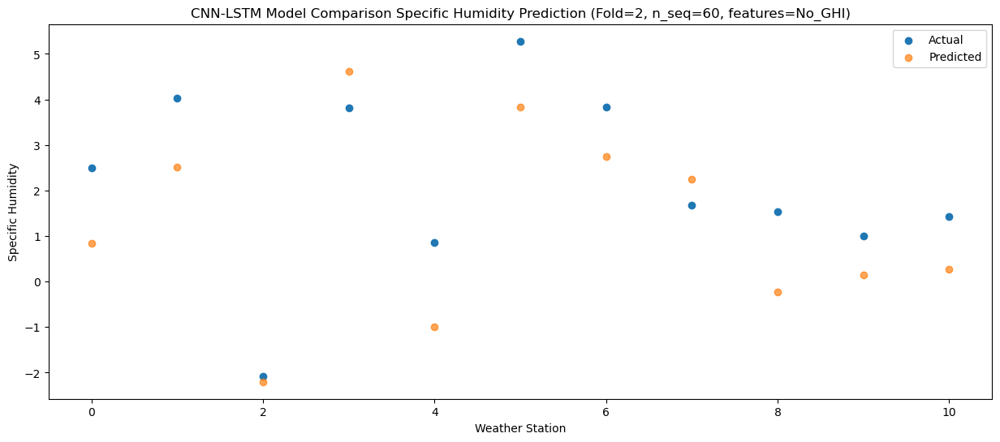

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   1.517005
1                 1    4.15   3.111270
2                 2   -1.11  -1.831379
3                 3    5.17   5.679407
4                 4    0.87  -0.603877
5                 5    6.85   4.264147
6                 6    5.16   3.230693
7                 7    1.98   2.648532
8                 8    2.85  -0.004120
9                 9    1.53   0.895879
10               10    2.03   1.065161


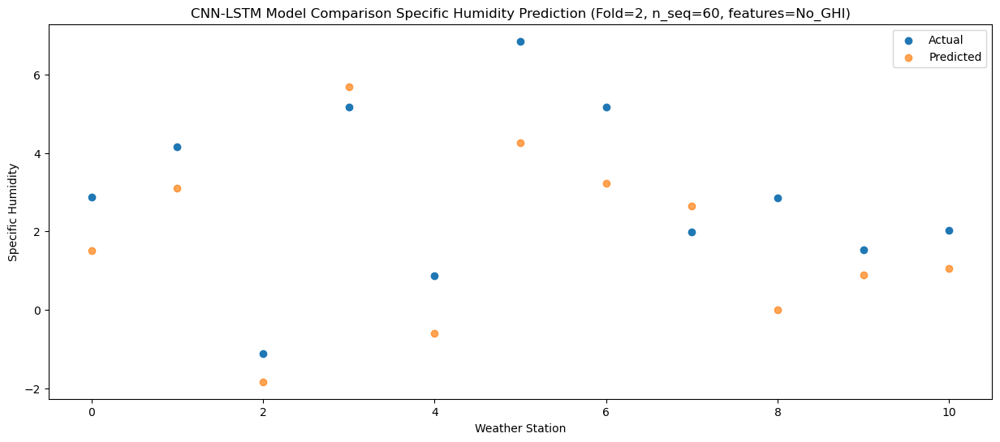

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   4.553202
1                 1    9.27   5.707224
2                 2    0.20   0.443122
3                 3    6.85   6.932060
4                 4    4.07   2.500786
5                 5   11.68   7.535669
6                 6    9.36   6.554841
7                 7    2.10   4.531167
8                 8    4.33   1.224587
9                 9    4.24   3.073043
10               10    4.70   3.300480


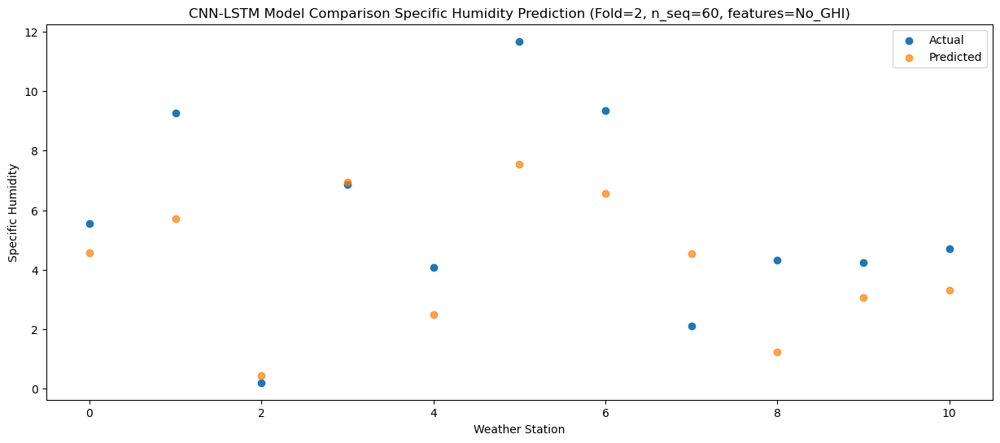

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20   8.290914
1                 1   12.18   8.282045
2                 2    3.98   3.981772
3                 3   11.45  10.847564
4                 4    7.96   6.193962
5                 5   14.32  10.688391
6                 6   13.11   9.631119
7                 7    4.76   6.745752
8                 8    5.58   2.992491
9                 9    8.74   7.175818
10               10    8.80   7.392816


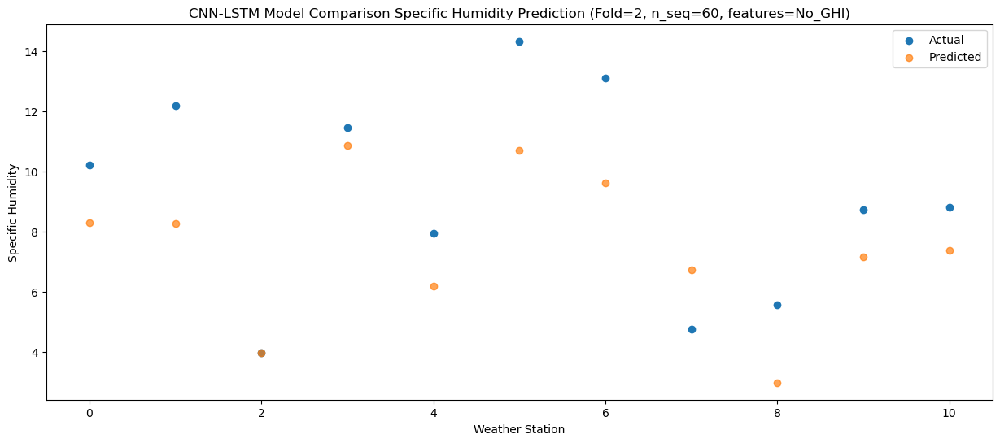

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30   9.415265
1                 1   13.79   9.301585
2                 2    4.38   4.945435
3                 3   14.05  12.024562
4                 4    8.99   7.217909
5                 5   13.28  11.716616
6                 6   13.93  10.676847
7                 7   10.00   7.642641
8                 8    6.73   3.779724
9                 9   10.26   8.303871
10               10   10.21   8.537891


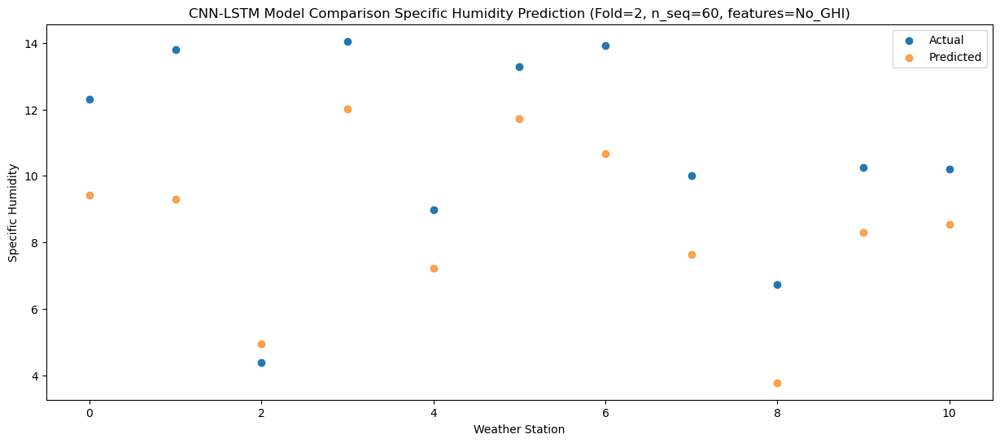

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00   9.192816
1                 1   12.17   8.698209
2                 2    5.00   4.955990
3                 3   14.79  12.528177
4                 4    8.59   6.982174
5                 5   13.41  11.162169
6                 6   14.31  10.066206
7                 7   10.29   7.144072
8                 8    6.13   3.313468
9                 9   10.84   8.559643
10               10   10.60   8.758594


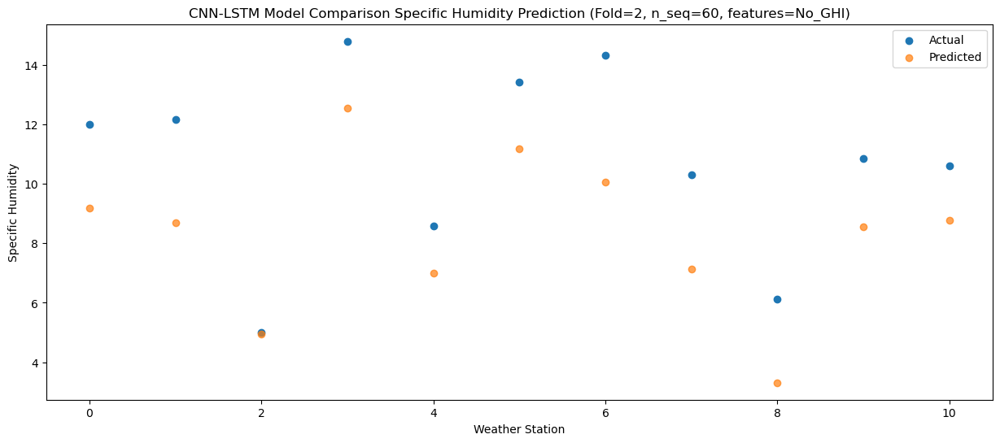

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   6.096705
1                 1    9.35   6.141586
2                 2    3.72   2.901263
3                 3   12.13   9.883848
4                 4    6.45   4.336578
5                 5    9.85   8.391746
6                 6    9.86   7.172747
7                 7    7.53   5.351996
8                 8    5.67   2.139347
9                 9    7.24   5.841707
10               10    7.39   5.938916


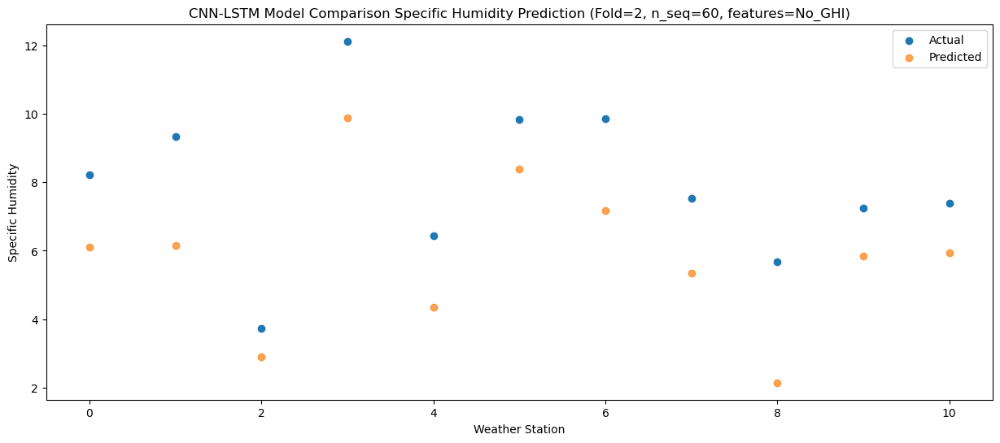

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78   3.550519
1                 1    5.96   3.959441
2                 2    1.06   0.536372
3                 3    9.17   8.310749
4                 4    3.92   1.593474
5                 5    8.26   5.693452
6                 6    7.25   4.492756
7                 7    3.82   3.499532
8                 8    2.87   0.626970
9                 9    5.08   3.656909
10               10    5.66   3.757288


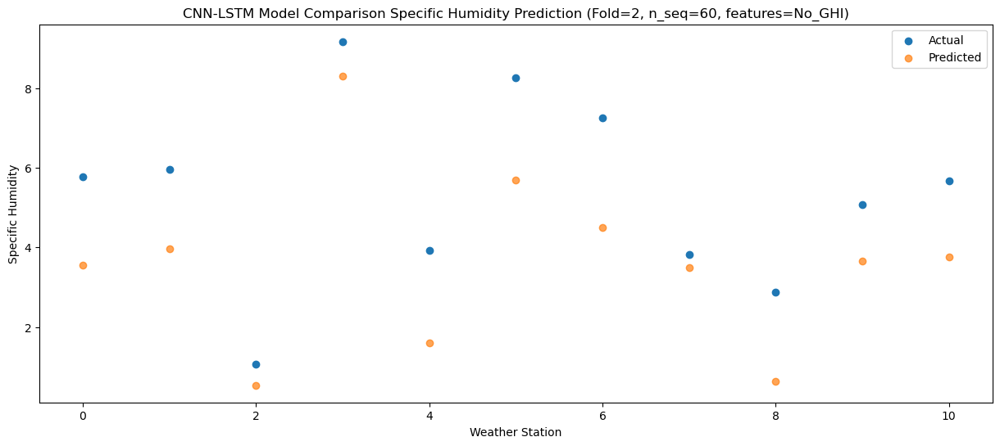

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59  -0.648272
1                 1    3.53   1.838141
2                 2   -2.89  -3.466826
3                 3    4.72   4.540837
4                 4   -1.74  -2.807868
5                 5    4.07   2.252039
6                 6    3.26   1.217310
7                 7    2.17   2.047123
8                 8    2.33  -0.000056
9                 9   -0.48  -0.918298
10               10    0.30  -0.773000


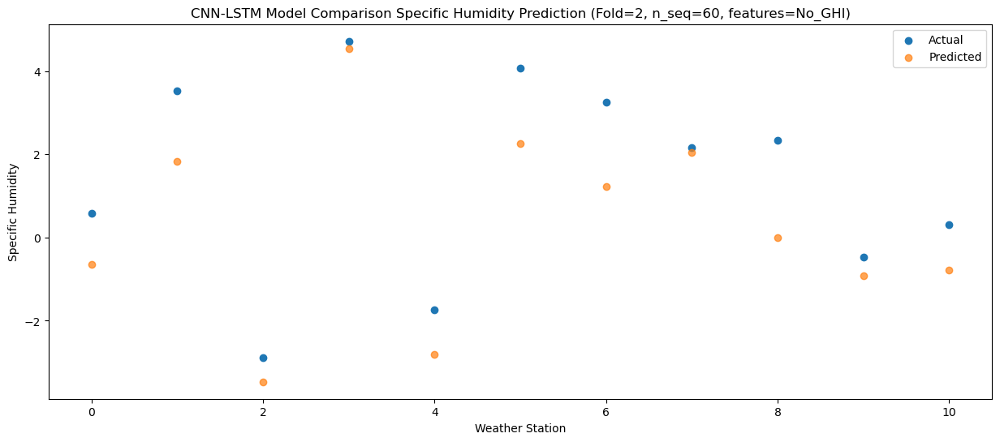

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99   0.767814
1                 1    2.47   1.559281
2                 2   -1.49  -1.554108
3                 3    4.36   4.189772
4                 4    1.54  -0.453321
5                 5    6.94   3.724125
6                 6    5.76   2.404091
7                 7    2.30   1.563983
8                 8    2.15  -0.976628
9                 9    1.37   0.418209
10               10    1.86   0.440230


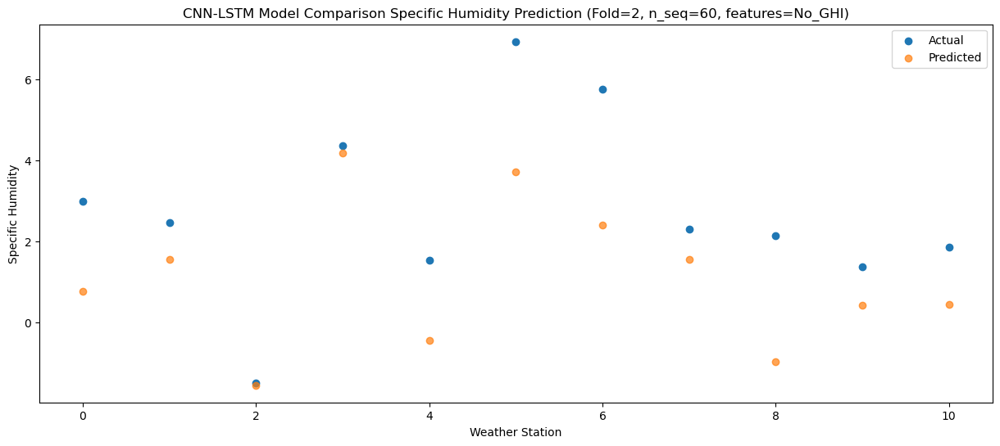

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -2.505812
1                 1    2.14   0.005086
2                 2   -5.14  -4.823706
3                 3    3.03   2.996057
4                 4   -3.37  -4.467783
5                 5    1.31   0.410190
6                 6    0.47  -0.704910
7                 7    2.02   0.554132
8                 8    0.79  -1.243664
9                 9   -1.41  -2.471147
10               10   -0.56  -2.384099


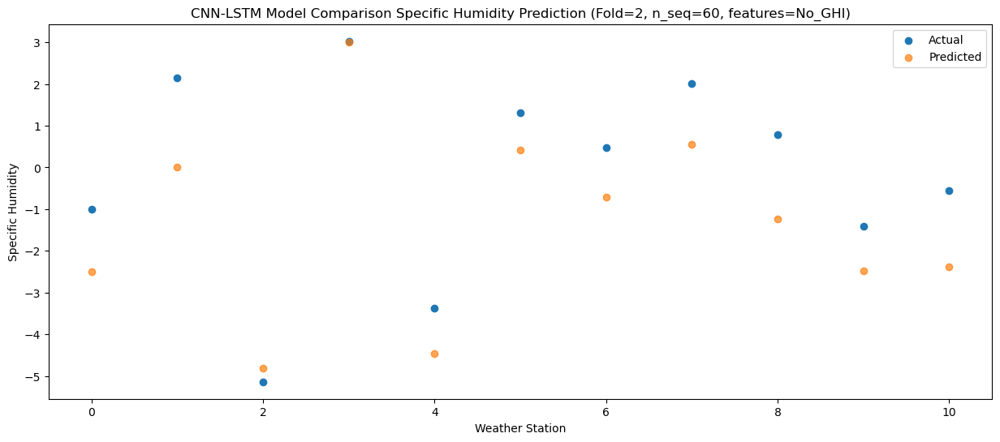

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34  -2.144257
1                 1    2.05  -0.253810
2                 2   -3.95  -4.094582
3                 3    3.60   3.194446
4                 4   -1.91  -3.789339
5                 5    1.53   0.652795
6                 6    0.94  -0.586809
7                 7    1.03   0.350621
8                 8    0.05  -1.524767
9                 9   -0.10  -1.860013
10               10    0.34  -1.835652


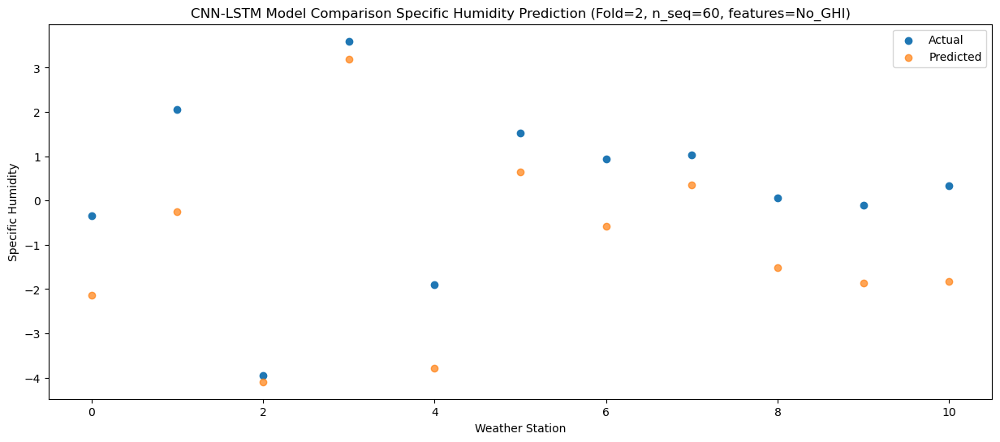

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09  -1.037765
1                 1    2.93   0.904317
2                 2   -2.14  -3.151791
3                 3    4.36   4.088816
4                 4   -1.06  -2.743800
5                 5    3.15   1.792014
6                 6    2.57   0.577887
7                 7    1.43   1.428182
8                 8    1.79  -0.497629
9                 9    0.86  -0.906954
10               10    0.96  -0.859768


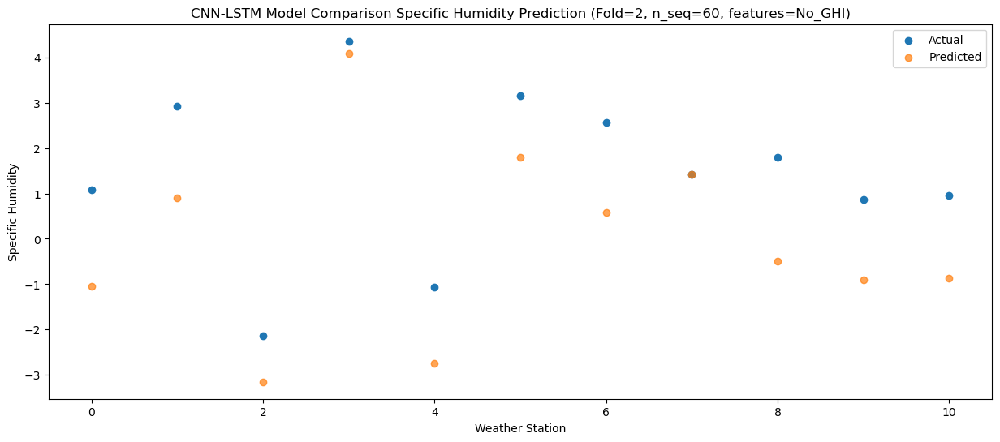

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   1.009852
1                 1    4.08   2.082304
2                 2   -0.78  -1.860641
3                 3    5.06   4.332544
4                 4    1.37  -0.577447
5                 5    7.11   3.929927
6                 6    6.47   2.722198
7                 7    1.44   1.843696
8                 8    2.63  -0.824166
9                 9    1.90   0.365468
10               10    2.23   0.464343


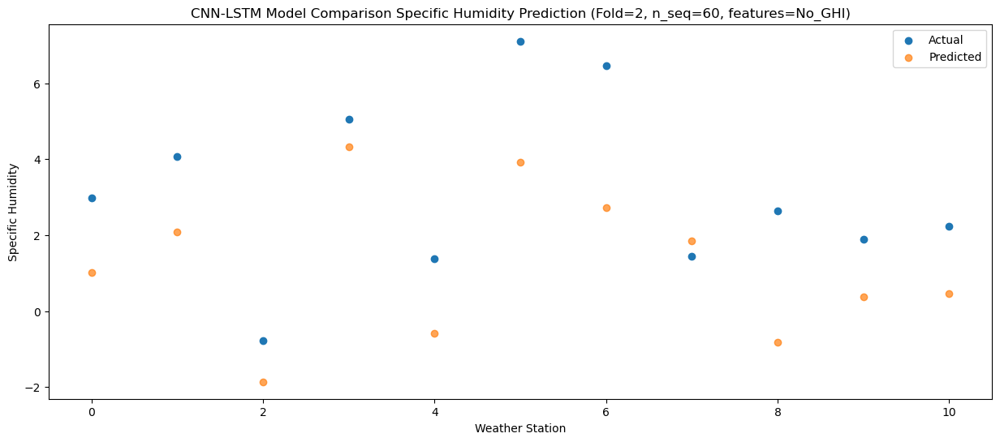

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   4.710593
1                 1    6.47   4.616829
2                 2    2.32   1.200836
3                 3    8.36   7.160558
4                 4    5.40   3.081902
5                 5   10.76   7.289403
6                 6   10.56   6.069402
7                 7    1.37   3.622330
8                 8    3.89   0.191131
9                 9    6.22   3.838199
10               10    6.39   3.969847


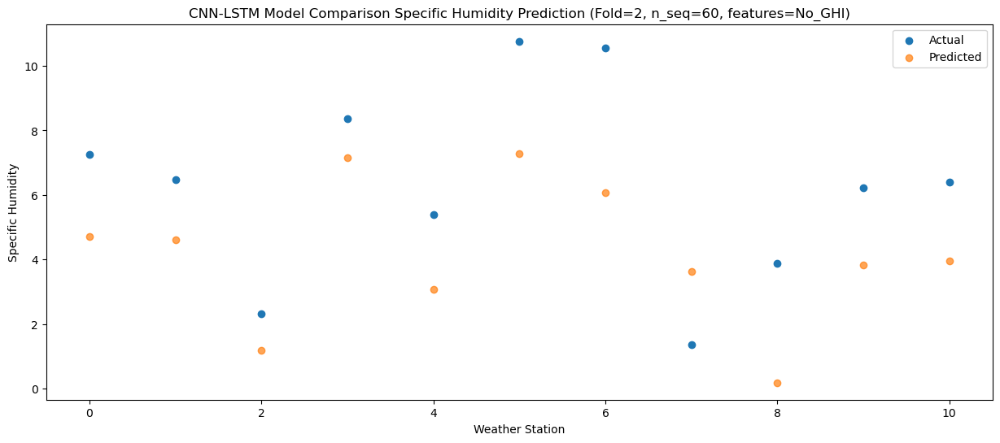

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30   6.556738
1                 1   10.83   6.573011
2                 2    4.25   2.747990
3                 3   10.62   8.585599
4                 4    7.70   4.850374
5                 5   11.79   9.230785
6                 6   11.36   8.063268
7                 7    6.87   5.372025
8                 8    5.66   1.776569
9                 9    8.02   5.382512
10               10    8.35   5.554231


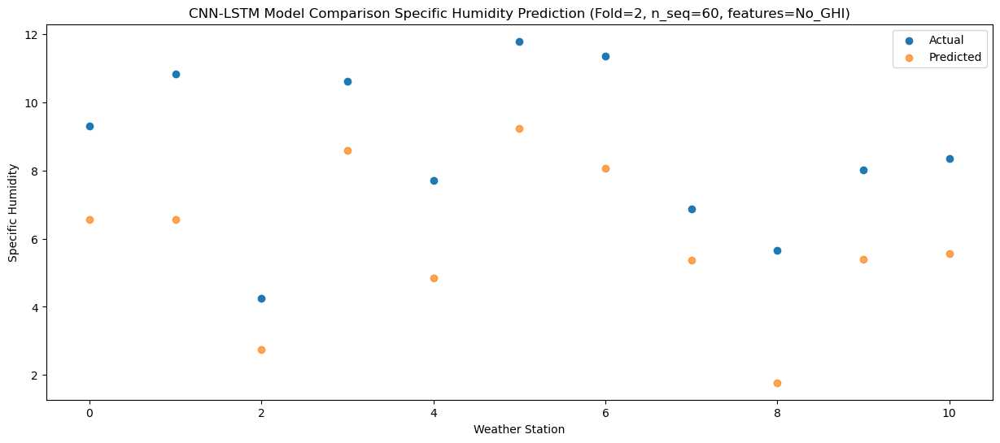

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52   7.575046
1                 1   12.17   7.303744
2                 2    5.08   4.123758
3                 3   13.98  10.704689
4                 4    8.99   5.797729
5                 5   12.89   9.802937
6                 6   10.68   8.571310
7                 7    9.43   6.298369
8                 8    6.55   2.812633
9                 9   11.60   7.093212
10               10   11.56   7.223238


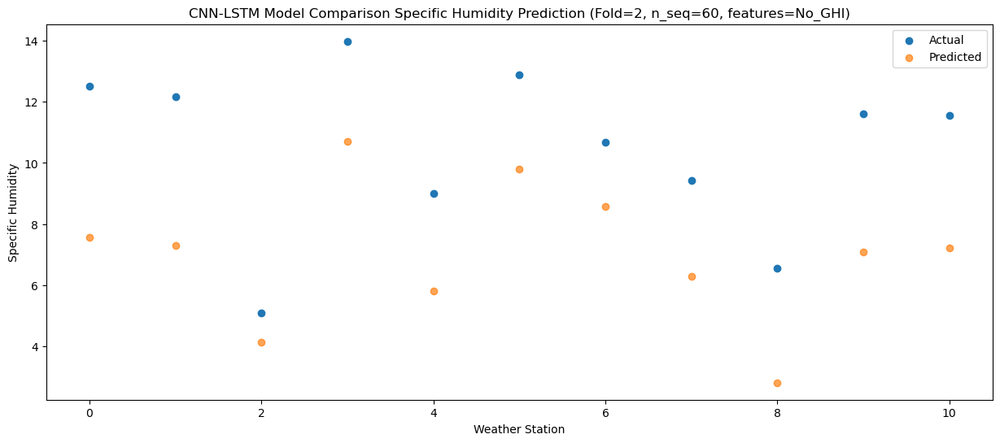

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04   7.232076
1                 1   11.67   7.331146
2                 2    4.97   3.569445
3                 3   14.66  10.576140
4                 4    9.39   5.238298
5                 5   13.35   9.504639
6                 6   11.74   8.347233
7                 7   11.40   6.315508
8                 8    6.65   2.888468
9                 9   10.03   6.646369
10               10   10.57   6.816838


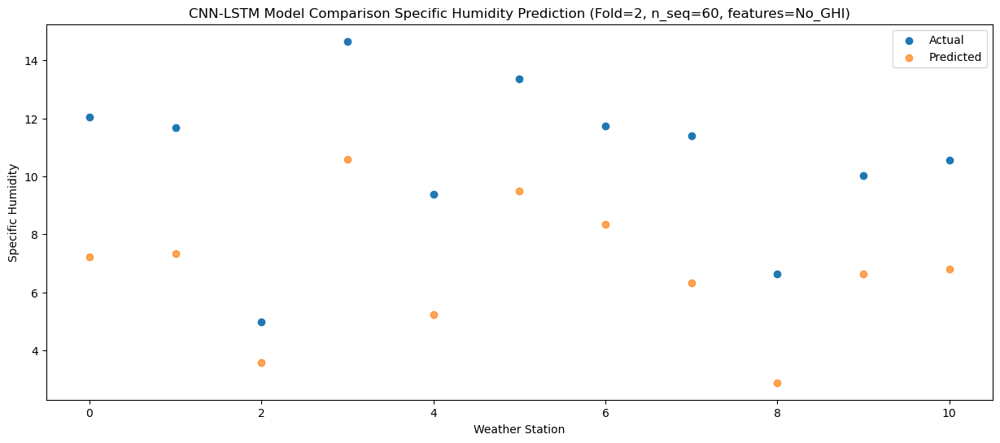

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29   3.982263
1                 1    9.10   4.746968
2                 2    4.82   1.026909
3                 3   10.86   8.331253
4                 4    5.88   2.067003
5                 5    9.99   6.347757
6                 6    9.07   5.144651
7                 7    8.36   4.404965
8                 8    7.50   1.607428
9                 9    6.60   3.849228
10               10    7.09   3.967904


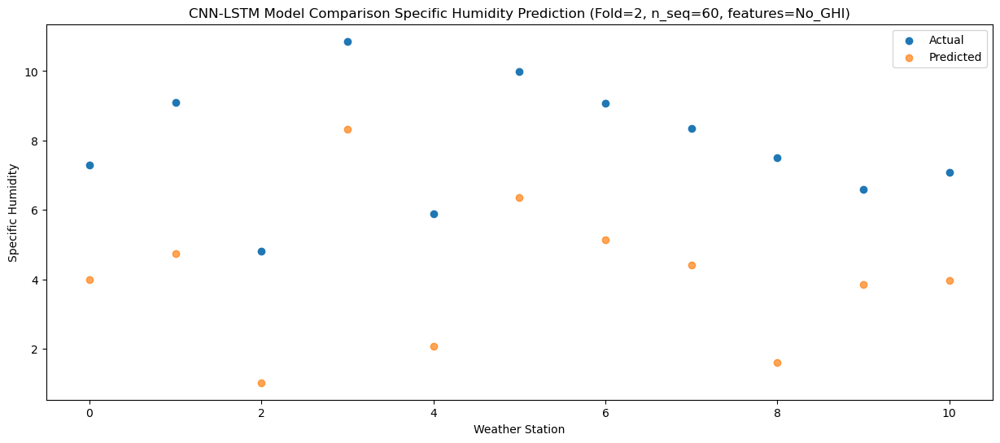

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57  -0.024697
1                 1    5.42   2.073557
2                 2    0.43  -2.316291
3                 3    7.99   5.440000
4                 4    0.70  -1.965647
5                 5    5.17   2.691446
6                 6    4.29   1.527756
7                 7    6.28   2.532819
8                 8    5.73   0.552333
9                 9    2.24   0.131204
10               10    2.43   0.214571


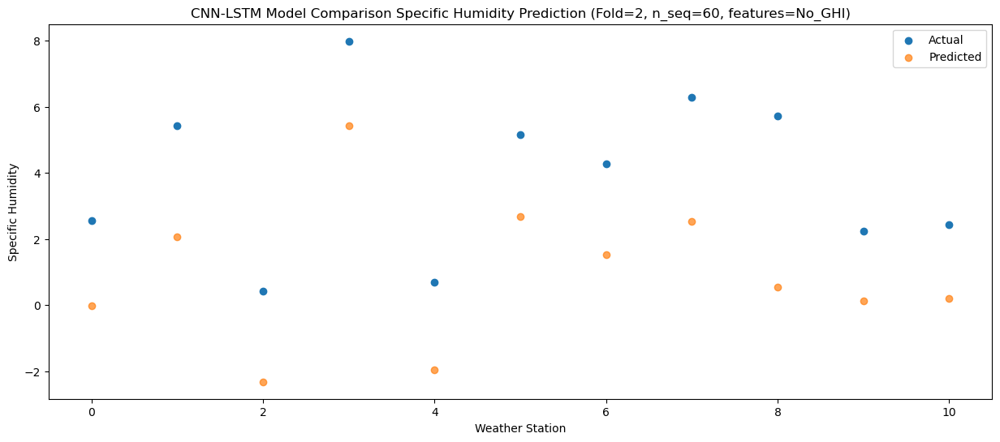

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63  -0.993703
1                 1    3.92   0.147663
2                 2    0.32  -3.255203
3                 3    6.17   3.731627
4                 4    0.26  -2.628525
5                 5    5.03   1.571578
6                 6    3.84   0.300931
7                 7    2.31   0.317847
8                 8    1.09  -2.063938
9                 9    1.77  -0.833308
10               10    1.81  -0.787897


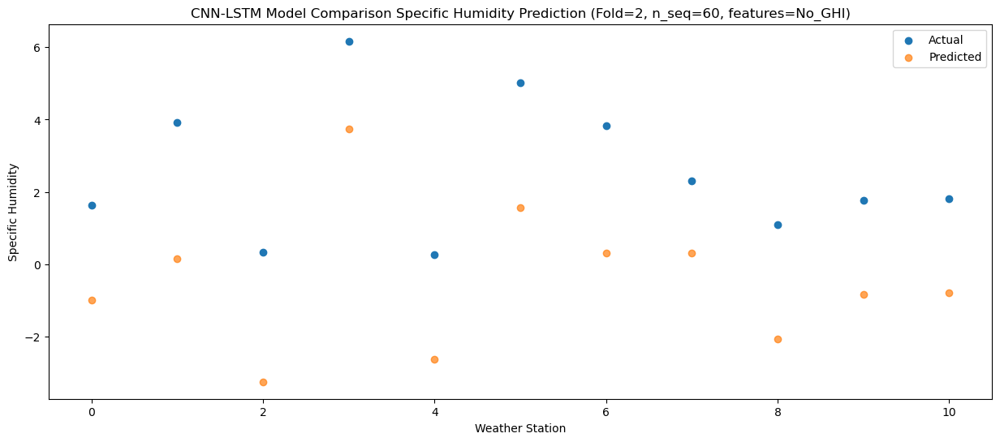

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00  -2.235009
1                 1    2.73  -0.348724
2                 2   -3.34  -4.487567
3                 3    4.08   2.515117
4                 4   -0.29  -3.943770
5                 5    4.12   0.624693
6                 6    2.67  -0.585258
7                 7    3.13   0.043566
8                 8    1.94  -2.052965
9                 9   -0.47  -2.281528
10               10    0.72  -2.209589


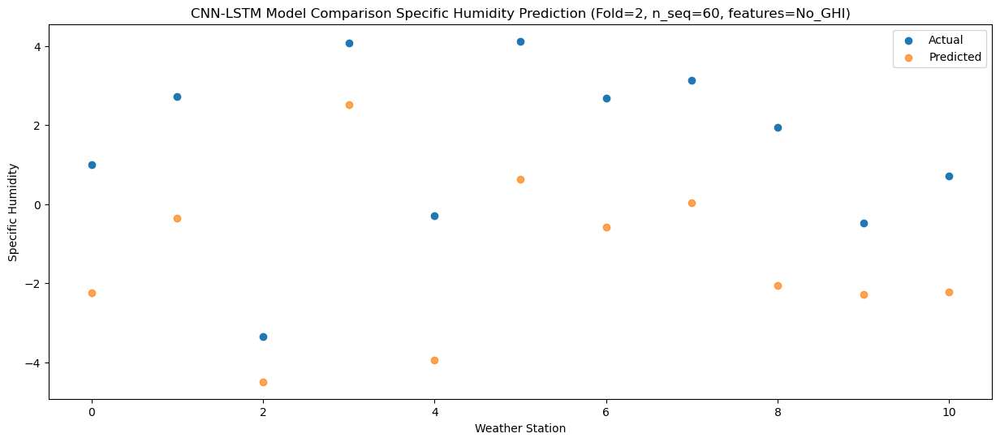

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41  -2.311696
1                 1    2.72  -0.343588
2                 2   -3.72  -4.419573
3                 3    4.59   3.030627
4                 4   -0.38  -4.105124
5                 5    3.74   0.403265
6                 6    1.89  -0.814118
7                 7    2.24   0.163498
8                 8    2.03  -1.833783
9                 9    0.39  -2.061580
10               10    0.99  -2.003926


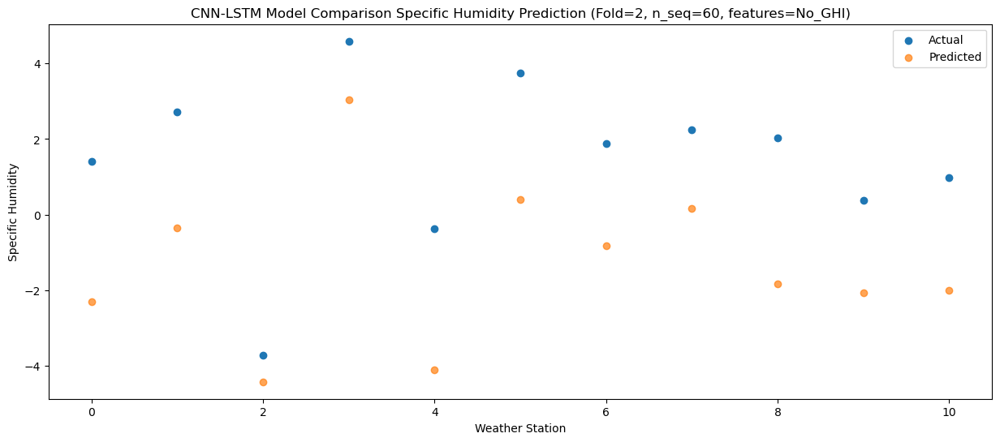

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63  -2.099888
1                 1    2.64  -0.757853
2                 2   -1.87  -3.929727
3                 3    3.83   2.217000
4                 4    0.92  -3.378107
5                 5    4.19   0.790673
6                 6    2.29  -0.553171
7                 7    2.12  -0.361559
8                 8    0.62  -2.602328
9                 9    1.15  -2.004224
10               10    1.39  -2.013106


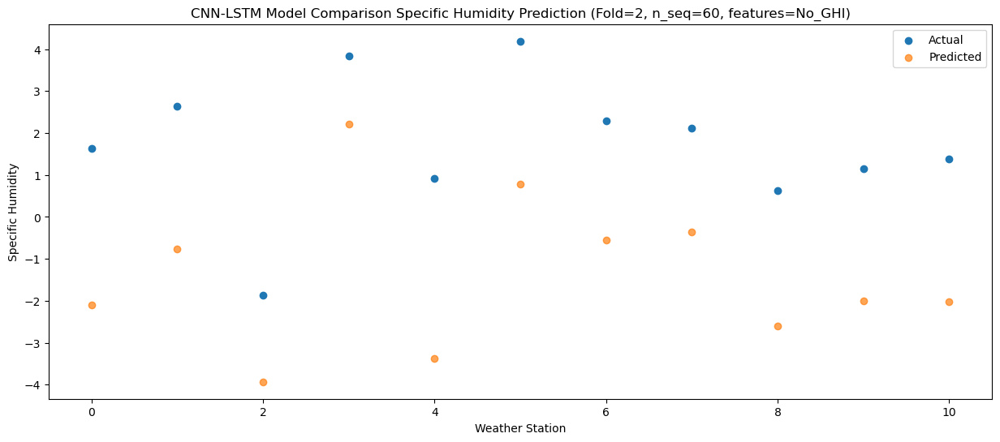

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98  -1.292020
1                 1    3.33   0.300028
2                 2   -1.48  -3.628053
3                 3    4.08   2.491252
4                 4    1.80  -2.762778
5                 5    5.97   1.773206
6                 6    4.20   0.530438
7                 7    2.46   0.460229
8                 8    2.54  -1.908321
9                 9    0.84  -1.686292
10               10    0.99  -1.627262


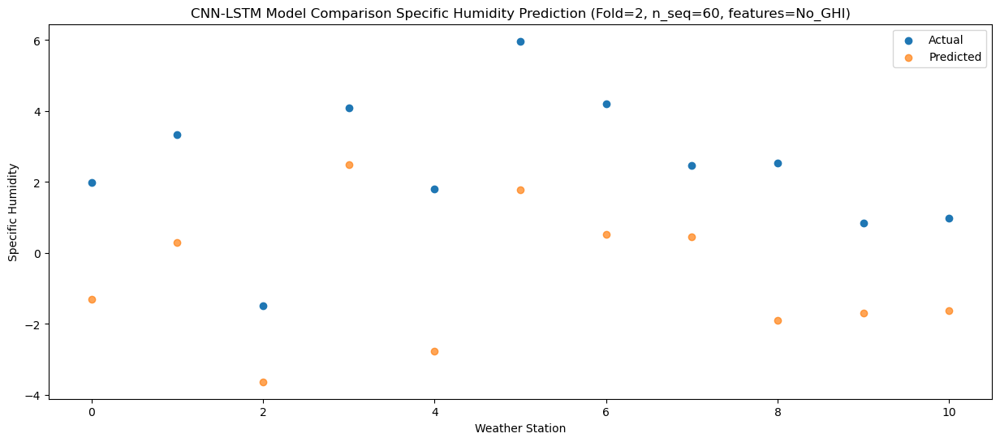

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92  -0.284461
1                 1    3.95   1.019840
2                 2    0.03  -2.387430
3                 3    6.16   4.283387
4                 4    2.35  -1.797246
5                 5    6.52   2.454517
6                 6    4.87   1.164469
7                 7    1.62   1.317524
8                 8    3.24  -0.975398
9                 9    2.97  -0.174045
10               10    2.63  -0.148443


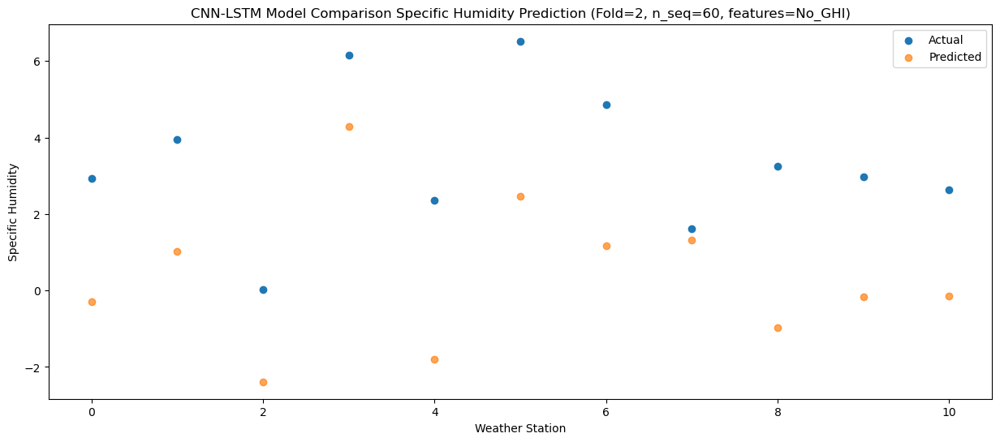

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   3.079524
1                 1    9.73   4.661601
2                 2    0.84  -0.355334
3                 3    6.97   5.159888
4                 4    5.41   1.403450
5                 5   10.22   6.433308
6                 6    8.76   5.343457
7                 7    3.62   4.038783
8                 8    4.64   1.049147
9                 9    4.50   1.616610
10               10    5.22   1.793773


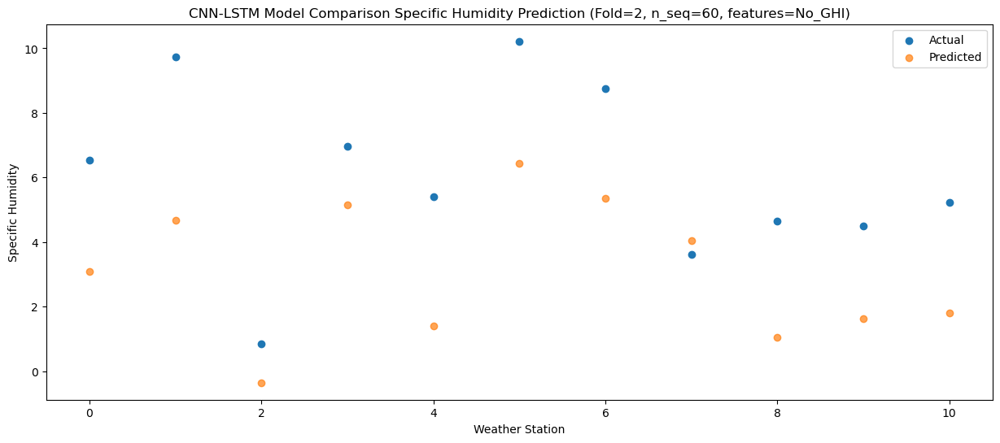

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50   5.547242
1                 1   12.38   6.336457
2                 2    4.00   1.743702
3                 3   10.87   7.398408
4                 4    8.72   3.796815
5                 5   13.68   8.555931
6                 6   12.66   7.455980
7                 7    3.42   5.183926
8                 8    5.02   1.650728
9                 9    7.36   4.104361
10               10    7.06   4.293350


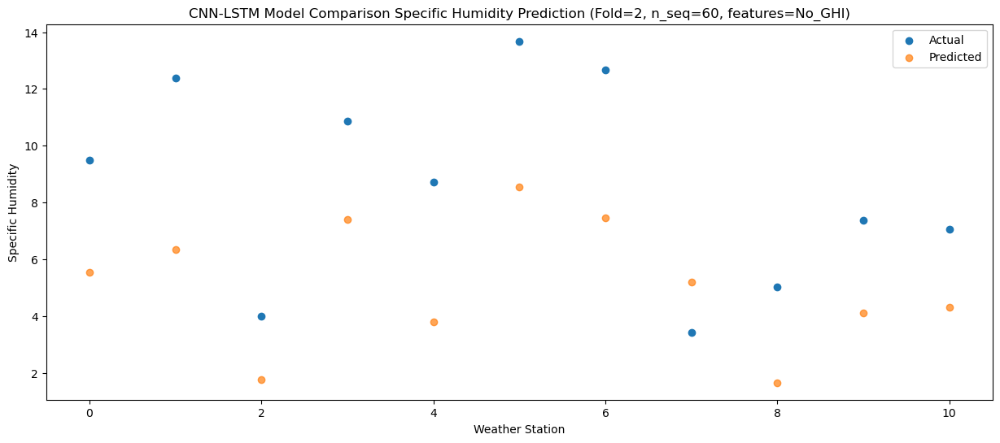

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68   6.830364
1                 1   14.44   6.712701
2                 2    4.97   3.385544
3                 3   15.13  10.280186
4                 4   10.06   4.939006
5                 5   13.39   9.015563
6                 6   11.95   7.807423
7                 7    6.77   5.688933
8                 8    6.36   2.158564
9                 9   11.20   6.446514
10               10   10.37   6.574151


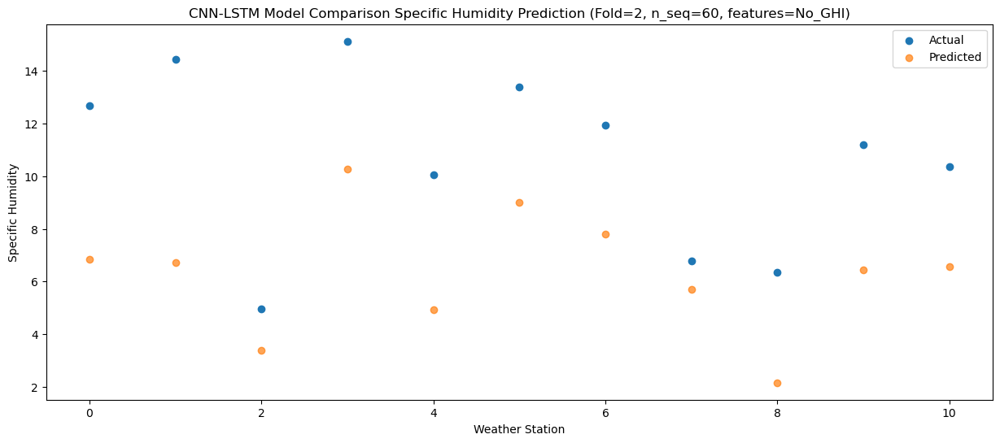

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03   5.656611
1                 1   12.55   6.093131
2                 2    5.69   2.353997
3                 3   12.79   8.943199
4                 4   10.09   3.820993
5                 5   11.96   8.143750
6                 6    9.90   6.952216
7                 7    8.96   5.329638
8                 8    6.97   2.084738
9                 9   10.71   5.073270
10               10   10.48   5.209287


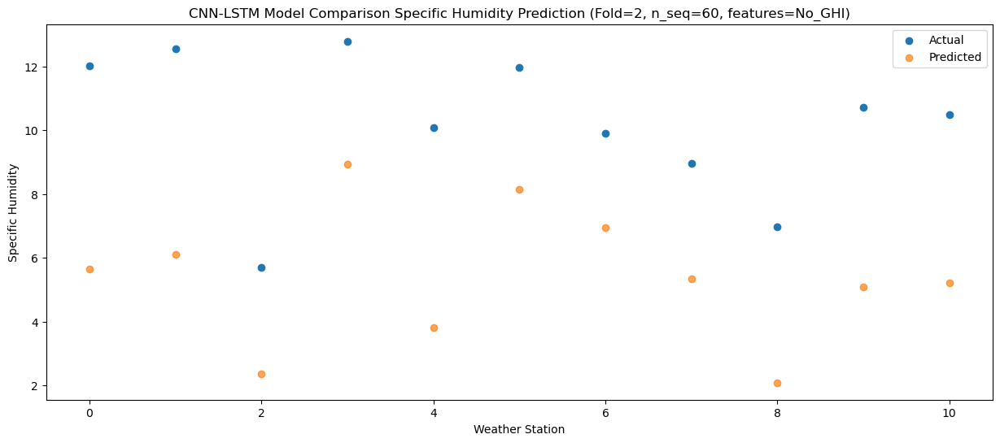

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00   3.570514
1                 1    9.96   4.521182
2                 2    3.30   0.604149
3                 3   11.78   8.063971
4                 4    7.74   1.567419
5                 5   11.41   5.973073
6                 6    9.27   4.807960
7                 7    7.15   4.136158
8                 8    6.72   1.266540
9                 9    7.57   3.440349
10               10    8.06   3.559199


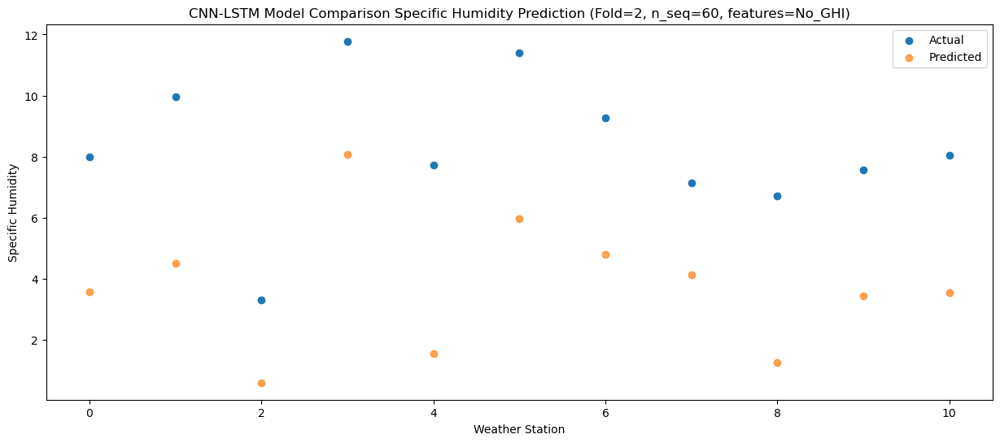

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   0.197834
1                 1    6.50   2.020368
2                 2    0.38  -2.478300
3                 3    8.42   5.450442
4                 4    2.51  -1.931154
5                 5    7.88   2.786185
6                 6    6.12   1.667809
7                 7    4.70   2.112662
8                 8    4.42  -0.239653
9                 9    3.38   0.204187
10               10    3.95   0.325330


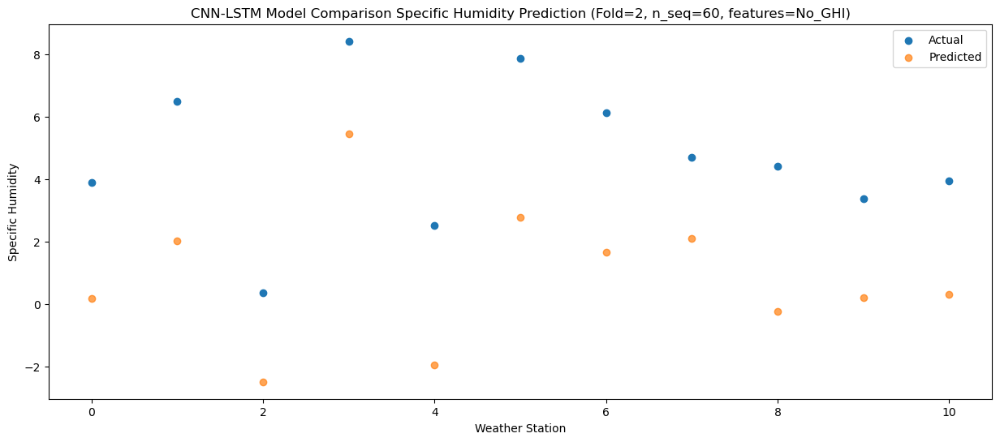

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26  -2.515861
1                 1    3.94  -0.214538
2                 2   -2.12  -4.949898
3                 3    4.59   2.322842
4                 4   -0.01  -4.430331
5                 5    4.71   0.474358
6                 6    3.50  -0.654592
7                 7    3.78   0.110919
8                 8    1.39  -2.027556
9                 9    0.27  -2.746817
10               10    1.00  -2.640925


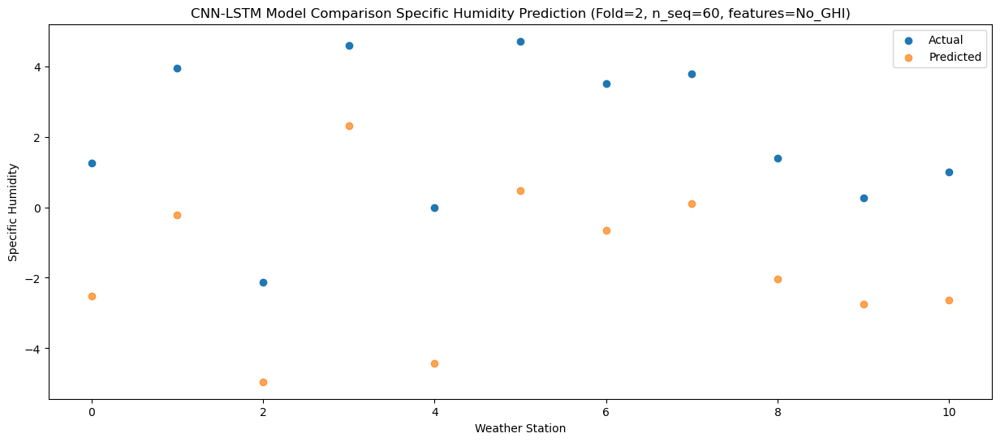

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34  -3.521984
1                 1    3.55  -0.774521
2                 2   -2.69  -5.990293
3                 3    4.88   2.653224
4                 4   -1.60  -5.855354
5                 5    2.78  -0.825293
6                 6    1.68  -1.881461
7                 7    2.26  -0.238313
8                 8    2.18  -2.103449
9                 9    0.18  -3.316194
10               10    0.79  -3.185712


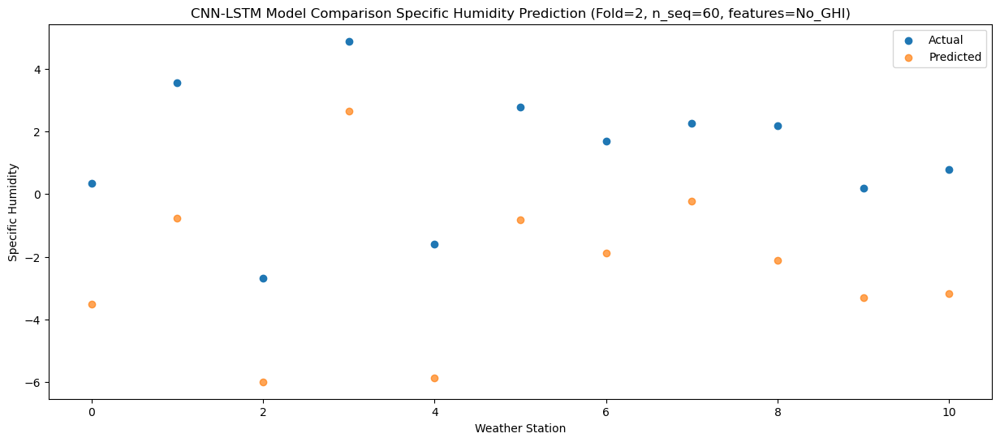

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55  -4.729973
1                 1    2.96  -1.795640
2                 2   -3.76  -6.727356
3                 3    3.55   1.614856
4                 4   -2.47  -6.844539
5                 5    1.77  -1.885372
6                 6    0.56  -3.001127
7                 7    2.68  -0.922441
8                 8    2.15  -2.518098
9                 9   -0.51  -4.359767
10               10    0.17  -4.279740


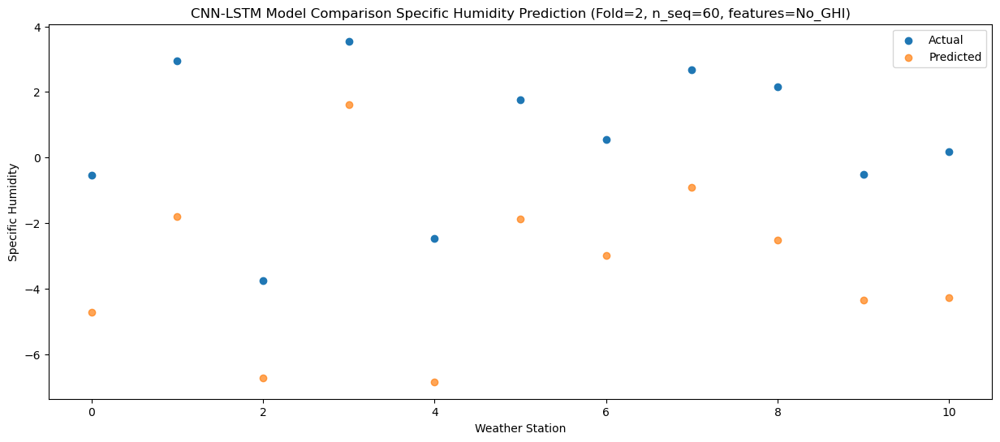

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32  -3.357276
1                 1    3.78  -0.505820
2                 2   -4.18  -6.036447
3                 3    3.50   1.756215
4                 4   -1.41  -5.546672
5                 5    4.17  -0.281528
6                 6    3.03  -1.314507
7                 7    2.70  -0.111615
8                 8    3.12  -2.097718
9                 9   -0.37  -3.729319
10               10    0.57  -3.575199


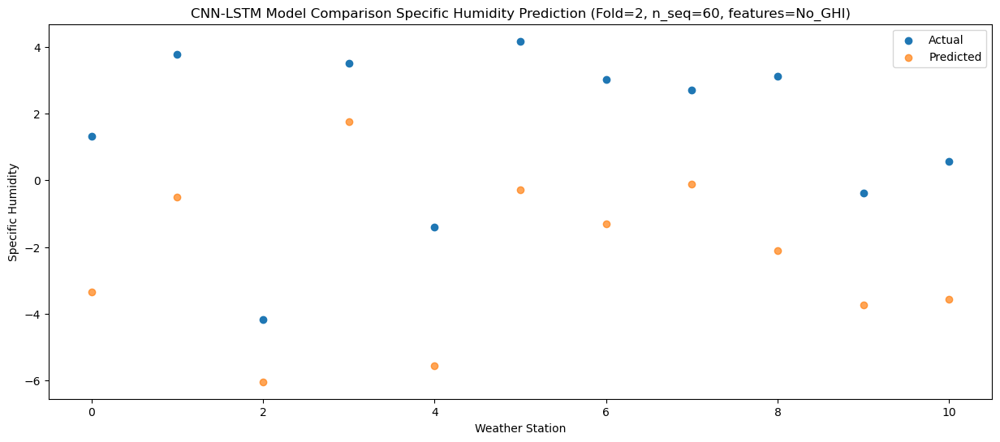

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14  -2.046839
1                 1    4.03  -0.108242
2                 2   -1.02  -4.304954
3                 3    4.55   2.374514
4                 4    0.19  -3.695379
5                 5    5.81   1.019530
6                 6    4.65  -0.183677
7                 7    2.92   0.234446
8                 8    1.56  -1.989448
9                 9    1.04  -2.300322
10               10    1.67  -2.231703


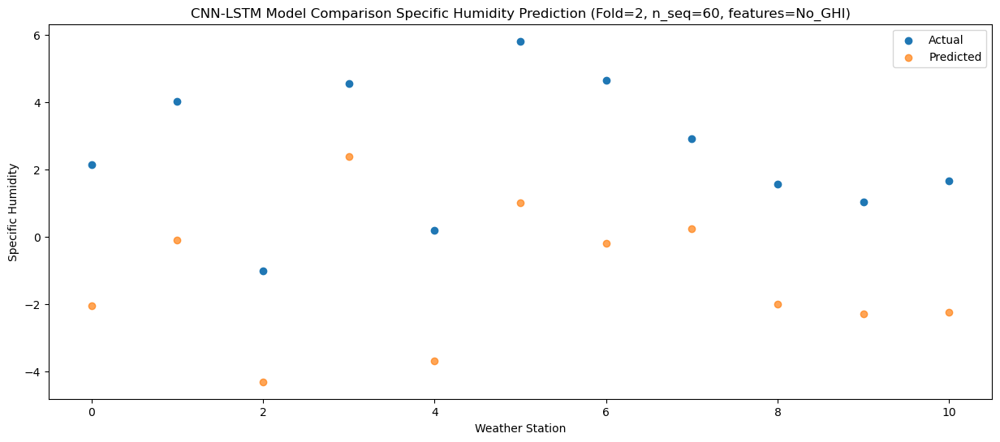

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35  -0.527030
1                 1    4.99   0.938446
2                 2   -2.23  -3.314773
3                 3    5.44   3.313926
4                 4    2.26  -2.285263
5                 5    8.09   2.415907
6                 6    6.85   1.240733
7                 7    2.25   0.851394
8                 8    0.66  -1.758976
9                 9    3.26  -1.059611
10               10    3.78  -0.945691


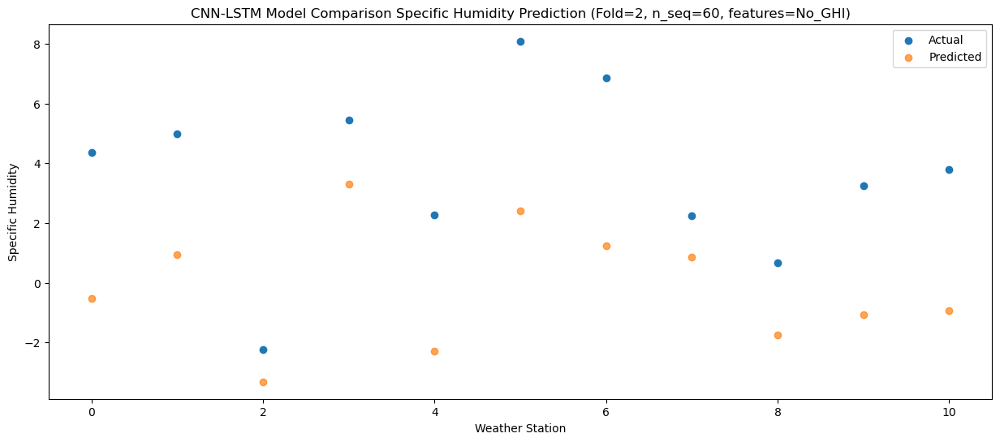

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61   3.227063
1                 1    8.02   3.245534
2                 2    2.63   0.074766
3                 3    8.62   5.933908
4                 4    6.69   1.697362
5                 5   12.19   5.894094
6                 6   10.63   4.623203
7                 7    1.94   2.527732
8                 8    4.76  -0.812050
9                 9    7.14   2.521243
10               10    7.64   2.624944


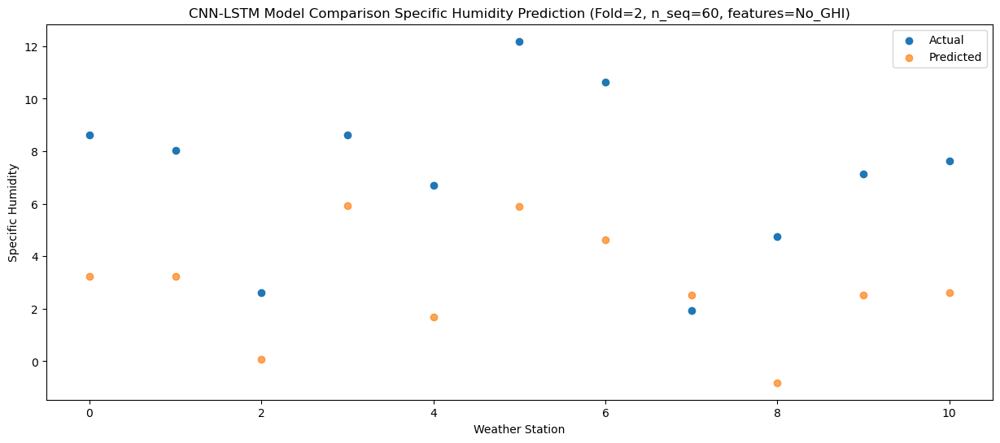

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58   4.870279
1                 1   14.03   5.389166
2                 2    4.69   0.828832
3                 3   11.54   7.583489
4                 4    8.66   2.771781
5                 5   13.85   7.491042
6                 6   12.22   6.416641
7                 7    5.99   4.180570
8                 8    6.36   0.556455
9                 9    9.01   3.744008
10               10    9.19   3.966685


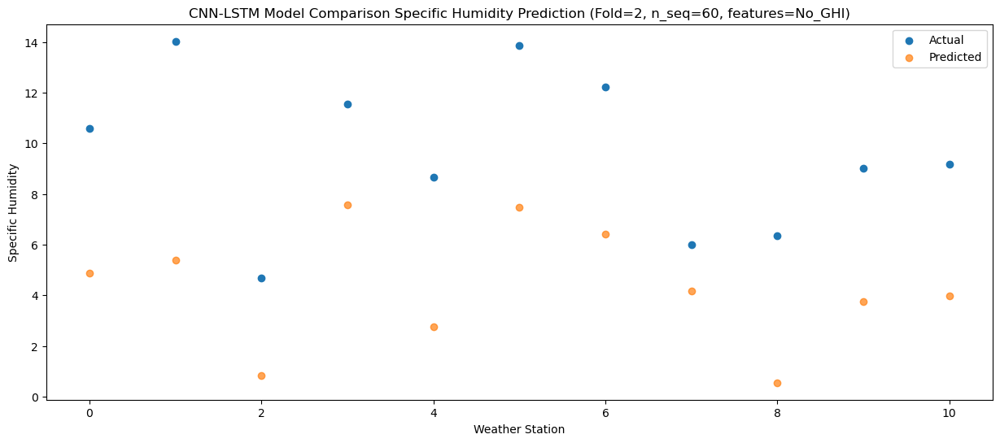

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05   6.094612
1                 1   12.58   5.867967
2                 2    5.74   2.950742
3                 3   14.71   9.672608
4                 4   10.30   4.388496
5                 5   14.15   8.355696
6                 6   12.45   7.073698
7                 7    9.59   5.067101
8                 8    7.59   1.628496
9                 9   11.62   5.842757
10               10   11.23   5.939715


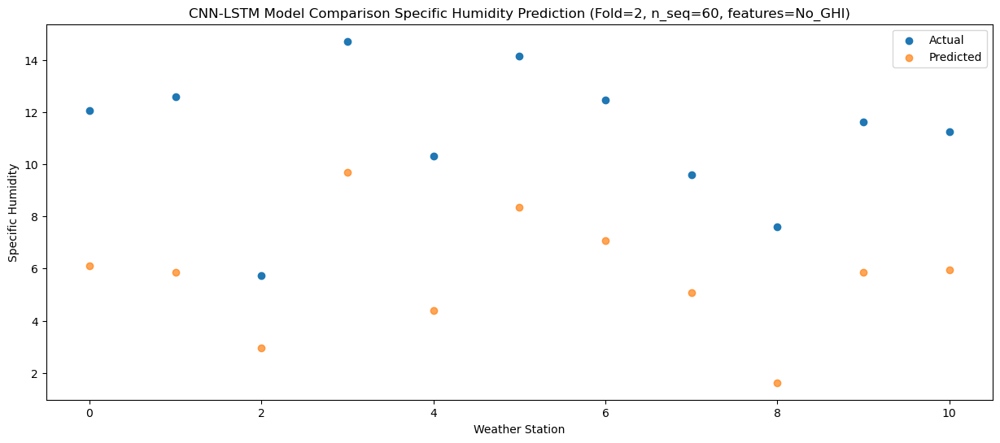

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05   5.147713
1                 1   13.56   5.735188
2                 2    6.34   1.908603
3                 3   13.21   9.089414
4                 4    9.13   3.201727
5                 5   14.19   7.574186
6                 6   12.27   6.396884
7                 7    9.27   5.044583
8                 8    6.77   1.798773
9                 9   10.36   4.787739
10               10   10.22   4.925155


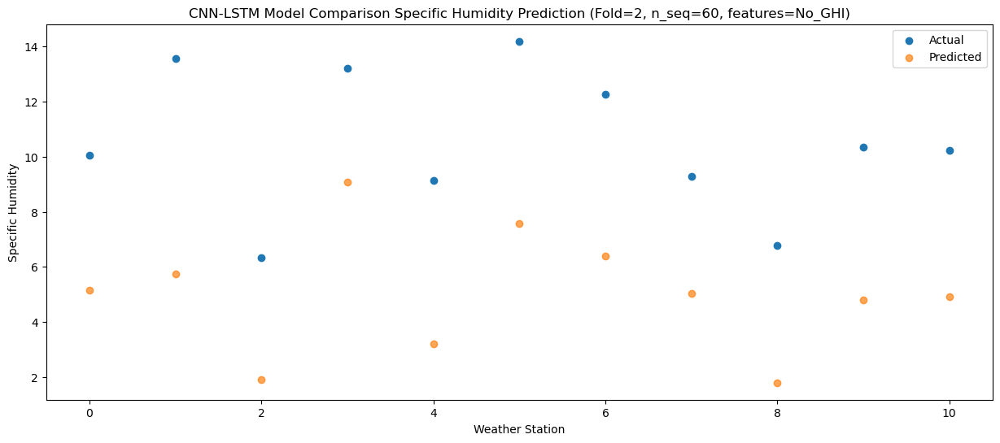

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   2.799800
1                 1    9.61   3.321715
2                 2    6.77   0.693764
3                 3   10.32   7.006222
4                 4    7.53   1.466054
5                 5   11.70   5.420151
6                 6    9.37   4.049368
7                 7    6.53   3.348252
8                 8    6.38   0.592245
9                 9    8.51   2.934008
10               10    8.12   2.935974


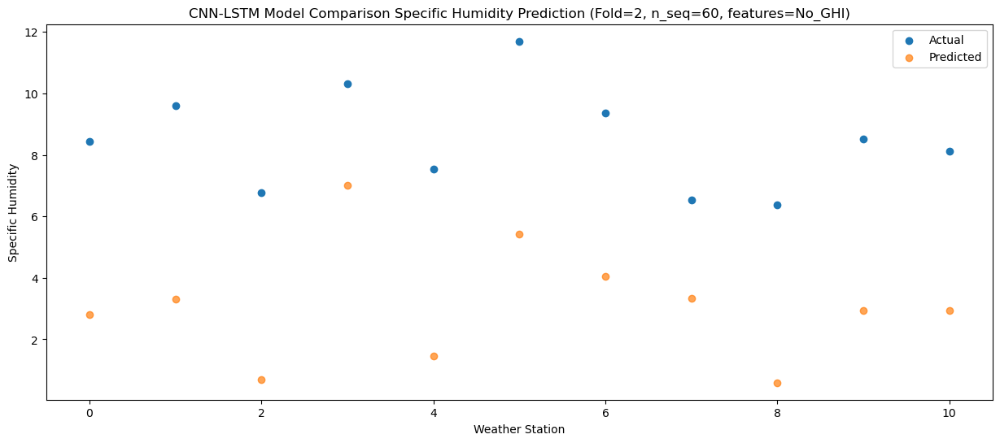

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05  -0.817439
1                 1    6.75   0.806599
2                 2    1.79  -2.733465
3                 3    7.08   4.165844
4                 4    2.67  -2.353826
5                 5    7.38   2.041950
6                 6    5.95   0.754183
7                 7    3.64   1.316240
8                 8    4.48  -0.881266
9                 9    3.89  -0.619896
10               10    4.05  -0.597890


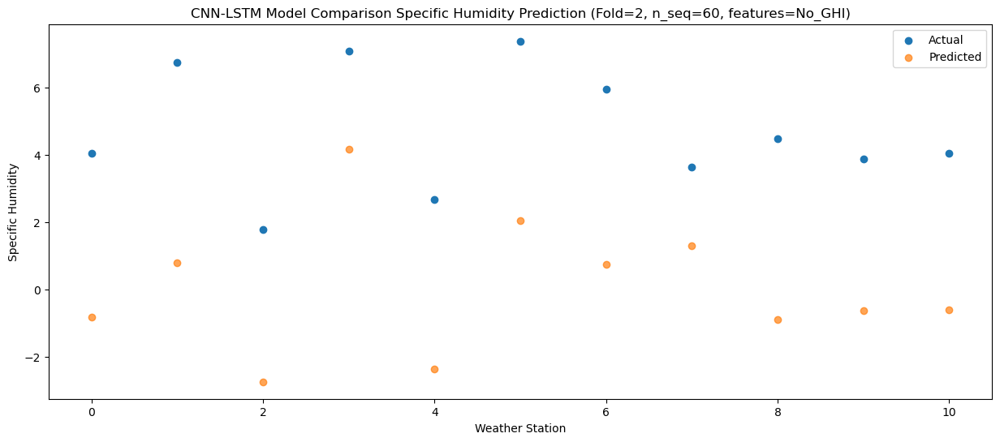

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

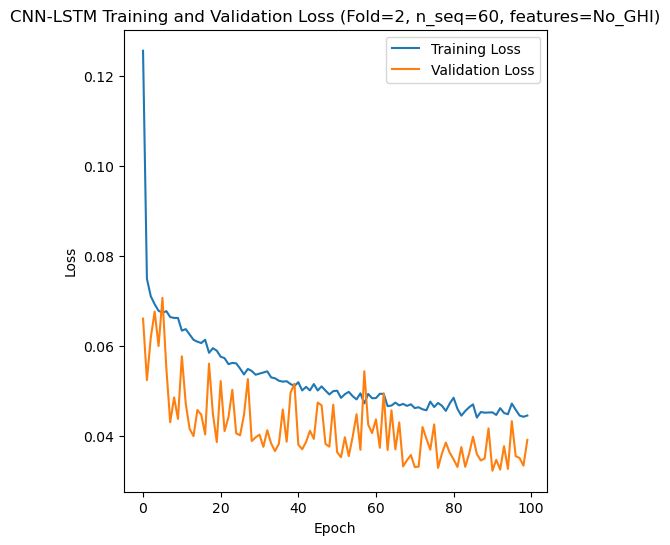

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 26s 112ms/step - loss: 0.1277 - accuracy: 0.1667 - mae: 0.1089 - rmse: 0.1277 - mape: 23.0702 - pearson: 0.6218 - val_loss: 0.0729 - val_accuracy: 0.0000e+00 - val_mae: 0.0574 - val_rmse: 0.0729 - val_mape: 12.3632 - val_pearson: 0.7142
Epoch 2/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0739 - accuracy: 0.3333 - mae: 0.0587 - rmse: 0.0739 - mape: 13.2799 - pearson: 0.7660 - val_loss: 0.0695 - val_accuracy: 0.6000 - val_mae: 0.0548 - val_rmse: 0.0695 - val_mape: 11.7478 - val_pearson: 0.7168
Epoch 3/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0698 - accuracy: 0.3452 - mae: 0.0554 - rmse: 0.0698 - mape: 12.5905 - pearson: 0.7806

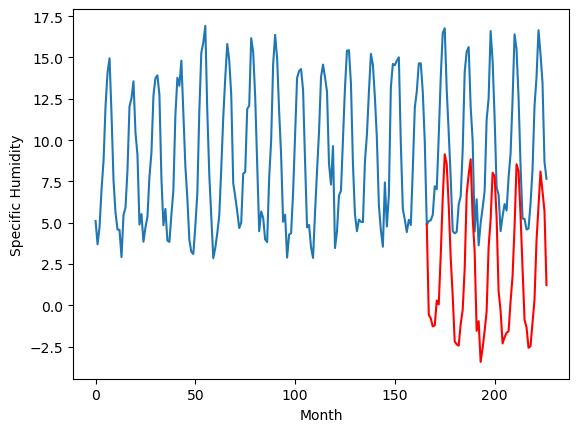

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		2.23		-0.01
1.83		1.49		-0.34
1.80		1.42		-0.38
1.44		1.14		-0.30
4.04		3.68		-0.36
4.19		3.21		-0.98
7.16		6.59		-0.57
10.69		9.57		-1.12
13.43		12.36		-1.07
10.76		10.45		-0.31
9.32		8.15		-1.17
4.75		3.93		-0.82
3.25		2.50		-0.75
1.21		0.24		-0.97
1.12		0.21		-0.91
0.56		-0.53		-1.09
3.07		1.76		-1.31
4.24		2.61		-1.63
7.76		6.36		-1.40
12.29		10.18		-2.11
13.17		11.21		-1.96
13.34		11.58		-1.76
9.37		7.57		-1.80
7.18		5.13		-2.05
2.75		1.18		-1.57
3.72		1.67		-2.05
0.53		-1.03		-1.56
0.90		-0.73		-1.63
2.37		0.55		-1.82
4.67		2.79		-1.88
9.12		6.82		-2.30
11.74		8.80		-2.94
11.95		10.53		-1.42
12.56		10.76		-1.80
8.71		7.70		-1.01
4.25		3.03		-1.22
3.22		1.60		-1.62
2.03		0.29		-1.74
1.95		0.27		-1.68
2.11		0.43		-1.68
3.05		1.28		-1.77
3.92		2.35		-1.57
8.33		6.10		-2.23
10.97		8.84		-2.13
13.24		11.18		-2.06
13.48		10.83		-2.65
9.41		8.22		-1.19
5.97		4.96		-1.01
3.09		2.02		-1.07

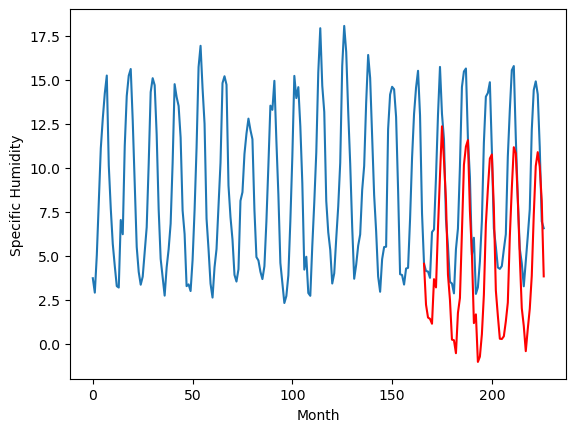

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		4.23		0.44
4.33		3.43		-0.90
3.95		3.36		-0.59
3.26		3.07		-0.19
4.34		3.09		-1.25
5.71		3.36		-2.35
5.52		4.77		-0.75
7.06		5.52		-1.54
7.28		5.96		-1.32
8.80		6.05		-2.75
8.32		5.40		-2.92
6.44		4.14		-2.30
3.75		3.31		-0.44
3.15		2.04		-1.11
3.59		2.33		-1.26
3.53		2.17		-1.36
3.61		1.88		-1.73
4.23		2.04		-2.19
4.63		4.17		-0.46
7.08		5.57		-1.51
7.78		6.30		-1.48
7.31		6.54		-0.77
6.02		5.36		-0.66
4.88		3.43		-1.45
5.46		3.76		-1.70
3.96		1.60		-2.36
3.68		2.21		-1.47
2.90		1.82		-1.08
4.24		2.76		-1.48
3.91		2.31		-1.60
4.09		2.92		-1.17
5.26		4.88		-0.38
6.43		6.30		-0.13
7.22		6.95		-0.27
6.93		6.08		-0.85
5.76		5.47		-0.29
3.04		2.15		-0.89
3.88		1.42		-2.46
4.03		1.47		-2.56
2.90		1.07		-1.83
4.42		1.52		-2.90
4.62		2.30		-2.32
5.56		4.76		-0.80
6.33		5.51		-0.82
7.43		5.90		-1.53
8.50		6.87		-1.63
6.96		5.94		-1.02
5.80		5.16		-0.64
3.69		3.30		-0.39
3.92		3.14		-0.78
4.46		

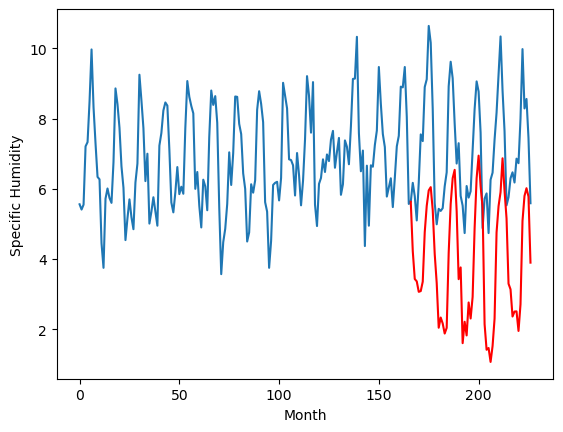

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		1.74		0.72
1.55		1.42		-0.13
1.15		1.06		-0.09
0.97		0.90		-0.07
2.83		2.40		-0.43
2.75		2.20		-0.55
6.18		5.53		-0.65
9.42		9.04		-0.38
12.52		12.03		-0.49
11.44		10.89		-0.55
8.87		8.06		-0.81
5.18		4.52		-0.66
2.29		2.66		0.37
0.68		0.35		-0.33
0.41		0.07		-0.34
0.34		-0.44		-0.78
1.64		1.14		-0.50
2.83		2.20		-0.63
5.36		4.76		-0.60
10.78		9.39		-1.39
11.41		10.68		-0.73
12.29		11.66		-0.63
8.82		7.69		-1.13
6.76		5.73		-1.03
1.07		0.91		-0.16
2.21		1.02		-1.19
-0.11		-1.07		-0.96
0.41		-0.44		-0.85
1.39		0.63		-0.76
2.66		1.92		-0.74
7.08		5.98		-1.10
9.34		7.64		-1.70
12.38		10.55		-1.83
11.25		10.51		-0.74
8.00		7.74		-0.26
2.85		3.17		0.32
2.04		1.82		-0.22
1.01		0.04		-0.97
1.55		0.49		-1.06
1.37		0.36		-1.01
1.24		0.57		-0.67
2.78		2.41		-0.37
5.69		4.15		-1.54
7.71		7.28		-0.43
11.36		11.27		-0.09
10.81		10.63		-0.18
8.34		8.07		-0.27
4.81		4.85		0.04
1.42		1.52		0.10
1.44		1

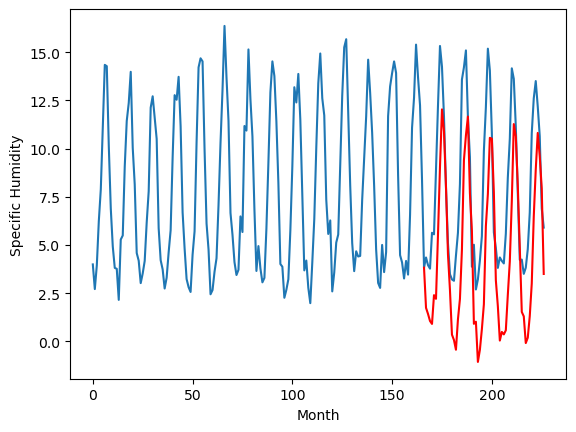

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		0.81		-1.68
0.99		0.30		-0.69
-1.30		0.06		1.36
-2.06		-0.23		1.83
0.01		1.60		1.59
0.33		1.34		1.01
4.03		4.87		0.84
7.12		8.24		1.12
11.07		11.31		0.24
8.69		9.60		0.91
5.73		6.75		1.02
1.01		2.78		1.77
-0.09		1.34		1.43
-2.02		-0.73		1.29
-2.22		-0.95		1.27
-3.05		-1.74		1.31
-0.57		0.21		0.78
0.49		1.26		0.77
2.91		4.31		1.40
7.37		8.68		1.31
9.32		9.91		0.59
9.41		10.65		1.24
5.64		6.49		0.85
3.69		4.39		0.70
-1.43		-0.06		1.37
-0.73		-0.09		0.64
-3.19		-2.15		1.04
-2.57		-1.75		0.82
-1.00		-0.58		0.42
0.56		1.06		0.50
4.65		5.17		0.52
6.75		7.02		0.27
9.34		9.53		0.19
8.84		9.63		0.79
5.74		6.65		0.91
0.74		2.00		1.26
-0.65		0.55		1.20
-1.77		-0.98		0.79
-1.39		-0.65		0.74
-0.51		-0.84		-0.33
-0.84		-0.34		0.50
0.39		1.20		0.81
3.57		3.85		0.28
5.70		6.87		1.17
9.47		10.29		0.82
9.86		9.76		-0.10
5.75		7.14		1.39
2.13		3.89		1.76
-1.04		0.64		1.68
-1.45		0.24		1.69
-2.32		-1.24		1

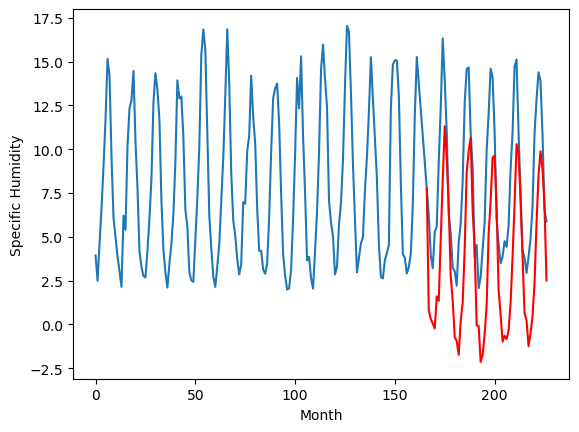

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		0.40		-0.04
0.73		-0.00		-0.73
0.23		-0.31		-0.54
-0.02		-0.55		-0.53
1.97		1.08		-0.89
2.09		0.87		-1.22
5.30		4.34		-0.96
8.03		7.83		-0.20
11.19		10.92		-0.27
9.97		9.46		-0.51
6.79		6.54		-0.25
3.37		2.75		-0.62
1.60		1.12		-0.48
-0.06		-1.04		-0.98
-0.37		-1.32		-0.95
-0.89		-2.00		-1.11
1.14		-0.23		-1.37
2.44		0.86		-1.58
4.68		3.64		-1.04
9.90		8.21		-1.69
11.15		9.49		-1.66
11.32		10.39		-0.93
8.02		6.27		-1.75
6.40		4.26		-2.14
0.53		-0.46		-0.99
1.58		-0.45		-2.03
-0.93		-2.48		-1.55
-0.40		-1.97		-1.57
0.91		-0.85		-1.76
2.44		0.60		-1.84
6.67		4.73		-1.94
8.74		6.48		-2.26
11.52		9.25		-2.27
10.32		9.28		-1.04
7.55		6.36		-1.19
2.25		1.71		-0.54
1.03		0.33		-0.70
0.27		-1.34		-1.61
0.85		-0.92		-1.77
0.52		-1.13		-1.65
0.95		-0.79		-1.74
2.26		0.95		-1.31
4.86		3.08		-1.78
7.02		6.21		-0.81
11.53		10.02		-1.51
10.65		9.39		-1.26
7.42		6.80		-0.62
4.04		3.54		-0.50
0.85		0.2

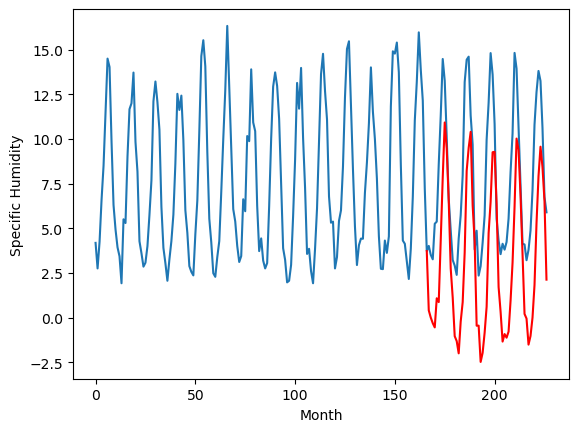

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		3.97		-0.81
4.41		3.20		-1.21
4.37		3.12		-1.25
4.33		2.81		-1.52
4.96		3.33		-1.63
5.31		3.48		-1.83
6.44		5.46		-0.98
7.50		6.82		-0.68
9.02		7.94		-1.08
7.81		7.48		-0.33
6.67		6.27		-0.40
5.02		4.27		-0.75
4.96		3.43		-1.53
4.15		2.06		-2.09
4.32		2.25		-2.07
4.38		1.86		-2.52
4.69		2.19		-2.50
5.16		2.58		-2.58
6.56		5.04		-1.52
7.89		7.09		-0.80
10.34		7.96		-2.38
8.91		8.26		-0.65
7.21		6.33		-0.88
6.12		4.34		-1.78
5.41		3.62		-1.79
4.70		1.93		-2.77
4.22		1.96		-2.26
4.01		1.72		-2.29
4.69		2.74		-1.95
5.19		2.85		-2.34
6.00		4.32		-1.68
7.94		6.33		-1.61
10.93		7.95		-2.98
10.77		8.50		-2.27
7.82		7.10		-0.72
6.21		5.52		-0.69
4.55		2.61		-1.94
4.58		1.76		-2.82
4.55		1.87		-2.68
4.17		1.51		-2.66
4.47		2.02		-2.45
5.10		2.93		-2.17
7.26		5.63		-1.63
7.49		6.91		-0.58
8.33		7.94		-0.39
9.98		8.58		-1.40
7.36		7.24		-0.12
6.11		5.86		-0.25
4.78		3.67		-1.11
4.65		3.45		-1.20
4.

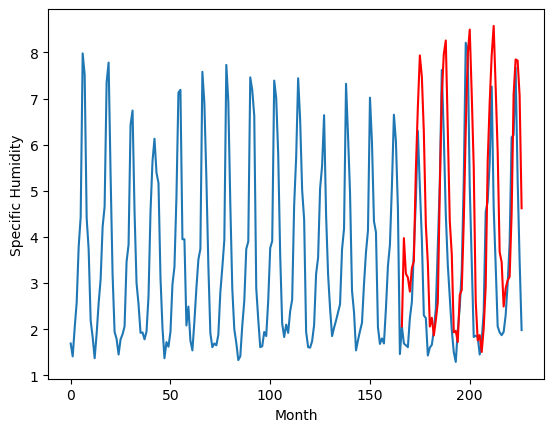

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		2.29		-0.40
3.68		1.45		-2.23
2.56		1.41		-1.15
2.14		1.07		-1.07
3.88		1.21		-2.67
3.69		1.47		-2.22
2.99		3.09		0.10
3.32		3.95		0.63
3.80		4.59		0.79
4.67		4.40		-0.27
3.41		3.55		0.14
2.40		2.03		-0.37
2.38		1.39		-0.99
1.55		0.21		-1.34
2.36		0.49		-1.87
1.88		0.17		-1.71
2.18		0.09		-2.09
1.87		0.30		-1.57
2.43		2.58		0.15
3.85		4.06		0.21
9.21		4.84		-4.37
6.78		5.02		-1.76
5.06		3.64		-1.42
3.96		1.68		-2.28
2.69		1.92		-0.77
2.83		-0.28		-3.11
1.84		0.35		-1.49
1.41		-0.09		-1.50
2.03		0.89		-1.14
2.03		0.58		-1.45
2.29		1.37		-0.92
4.05		3.41		-0.64
7.48		4.84		-2.64
10.55		5.49		-5.06
6.64		4.46		-2.18
3.91		3.67		-0.24
2.14		0.37		-1.77
2.89		-0.31		-3.20
3.28		-0.23		-3.51
2.03		-0.70		-2.73
3.07		-0.18		-3.25
2.22		0.58		-1.64
3.76		3.28		-0.48
4.26		4.10		-0.16
5.23		4.54		-0.69
7.81		5.48		-2.33
6.87		4.45		-2.42
3.81		3.55		-0.26
2.80		1.62		-1.18
2.72		1.47		-1.25
3.26

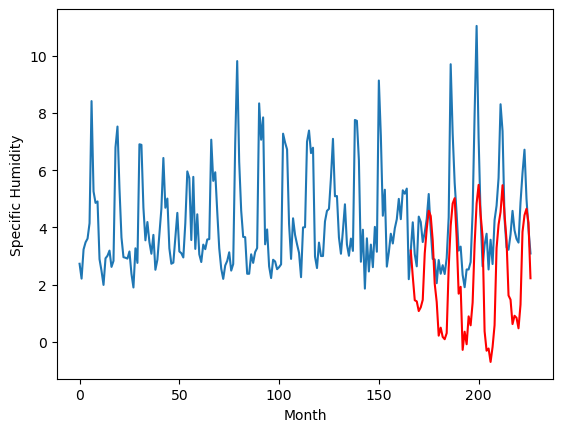

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		2.95		-0.38
4.56		2.20		-2.36
3.88		2.06		-1.82
2.99		1.86		-1.13
3.47		1.86		-1.61
4.53		2.11		-2.42
5.39		3.30		-2.09
5.61		4.01		-1.60
6.08		4.26		-1.82
6.88		4.65		-2.23
6.49		4.20		-2.29
4.29		3.16		-1.13
3.13		2.06		-1.07
2.79		0.57		-2.22
3.46		0.89		-2.57
3.11		0.96		-2.15
2.76		0.51		-2.25
3.69		0.57		-3.12
4.13		2.63		-1.50
5.56		3.97		-1.59
6.04		4.66		-1.38
6.43		4.92		-1.51
5.79		3.96		-1.83
4.76		1.99		-2.77
4.98		2.31		-2.67
3.73		0.39		-3.34
3.40		0.80		-2.60
2.56		0.53		-2.03
3.56		1.43		-2.13
3.66		0.91		-2.75
4.03		1.43		-2.60
5.52		3.34		-2.18
6.35		4.73		-1.62
6.81		5.30		-1.51
6.21		4.59		-1.62
4.90		4.06		-0.84
2.65		0.80		-1.85
3.44		-0.03		-3.47
3.27		-0.03		-3.30
2.41		-0.24		-2.65
3.21		0.14		-3.07
3.59		0.93		-2.66
5.18		3.21		-1.97
5.24		3.90		-1.34
6.08		4.23		-1.85
7.35		5.25		-2.10
6.80		4.31		-2.49
5.37		3.55		-1.82
4.28		1.78		-2.50
4.66		1.51		-3.15
4.

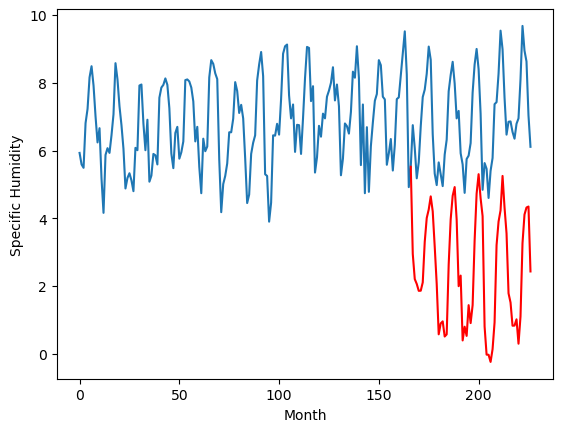

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.80		0.55
1.89		2.50		0.61
1.61		2.18		0.57
1.69		1.89		0.20
2.18		2.82		0.64
2.68		2.83		0.15
4.91		5.83		0.92
9.02		8.99		-0.03
13.00		11.70		-1.30
11.93		10.80		-1.13
8.56		8.15		-0.41
6.03		5.14		-0.89
3.87		3.47		-0.40
1.91		1.55		-0.36
0.82		1.21		0.39
0.97		0.67		-0.30
1.75		1.75		-0.00
3.13		2.91		-0.22
4.70		5.02		0.32
9.60		9.36		-0.24
11.81		10.63		-1.18
12.19		11.77		-0.42
9.59		8.17		-1.42
7.05		6.43		-0.62
2.52		2.32		-0.20
2.22		1.70		-0.52
0.74		0.40		-0.34
1.33		0.85		-0.48
2.17		1.87		-0.30
2.82		2.65		-0.17
6.21		6.07		-0.14
8.55		7.62		-0.93
11.71		10.57		-1.14
11.85		10.74		-1.11
8.18		8.32		0.14
5.55		4.51		-1.04
3.70		2.76		-0.94
1.73		1.11		-0.62
2.30		1.59		-0.71
1.59		1.14		-0.45
1.80		1.27		-0.53
4.04		3.17		-0.87
4.56		4.42		-0.14
8.26		7.37		-0.89
13.11		11.29		-1.82
10.54		10.66		0.12
9.57		8.60		-0.97
6.18		5.89		-0.29
2.38		2.58		0.20
2.71		2.72		0.01
1

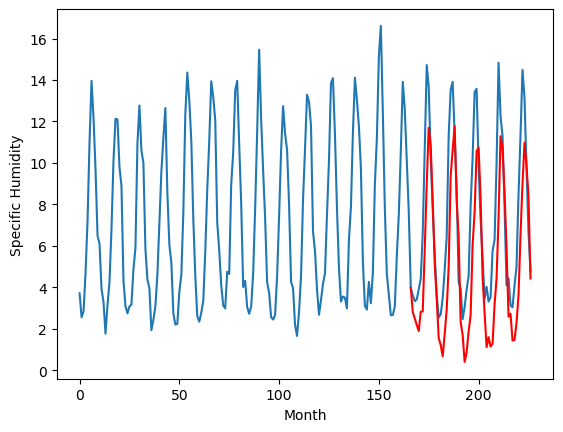

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.27		0.81
-0.66		-0.01		0.65
-0.74		-0.35		0.39
-0.75		-0.62		0.13
0.21		0.47		0.26
0.64		0.43		-0.21
3.17		3.59		0.42
6.74		6.94		0.20
10.09		9.83		-0.26
9.45		8.81		-0.64
6.16		6.00		-0.16
3.39		2.78		-0.61
1.06		1.05		-0.01
-0.79		-0.97		-0.18
-1.48		-1.33		0.15
-1.62		-1.90		-0.28
-0.34		-0.63		-0.29
1.07		0.56		-0.51
2.66		2.76		0.10
7.53		7.31		-0.22
9.22		8.61		-0.61
9.54		9.76		0.22
6.62		5.95		-0.67
4.72		4.17		-0.55
-0.20		-0.30		-0.10
-0.30		-0.71		-0.41
-1.81		-2.25		-0.44
-1.11		-1.73		-0.62
-0.17		-0.69		-0.52
0.47		0.25		-0.22
4.65		3.95		-0.70
6.05		5.51		-0.54
9.03		8.53		-0.50
8.66		8.64		-0.02
5.64		6.06		0.42
2.22		1.93		-0.29
1.00		0.34		-0.66
-0.92		-1.38		-0.46
-0.14		-0.87		-0.73
-0.89		-1.27		-0.38
-0.76		-1.13		-0.37
1.67		0.81		-0.86
2.14		2.12		-0.02
5.83		5.20		-0.63
9.81		9.31		-0.50
8.57		8.59		0.02
6.88		6.37		-0.51
3.61		3.46		-0.15
-0.07		0.07		0.14


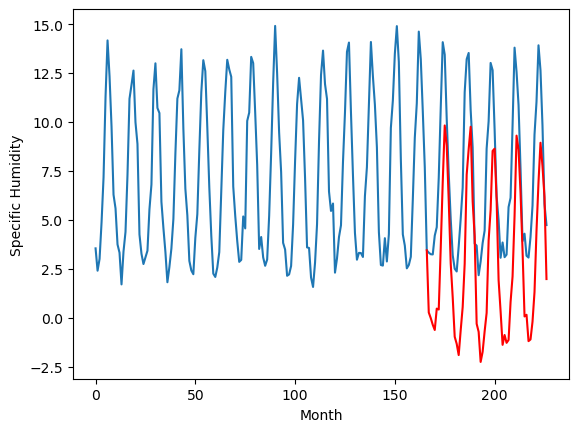

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -0.557958
1                 1    2.24   2.226289
2                 2    3.79   4.225520
3                 3    1.02   1.738439
4                 4    2.49   0.810574
5                 5    0.44   0.402987
6                 6    4.78   3.973930
7                 7    2.69   2.286410
8                 8    3.33   2.947195
9                 9    2.25   2.799123
10               10   -0.54   0.274489


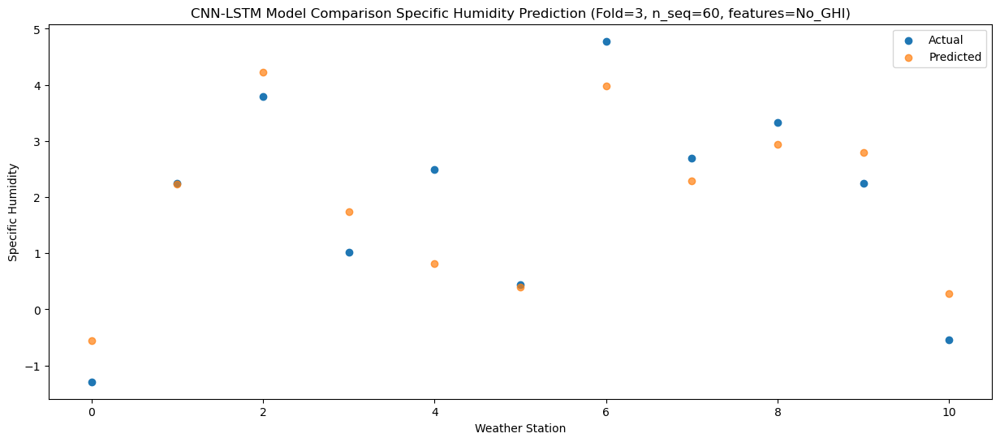

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08  -0.786456
1                 1    1.83   1.494792
2                 2    4.33   3.431950
3                 3    1.55   1.421767
4                 4    0.99   0.297763
5                 5    0.73  -0.001728
6                 6    4.41   3.202515
7                 7    3.68   1.454412
8                 8    4.56   2.204747
9                 9    1.89   2.498370
10               10   -0.66  -0.012132


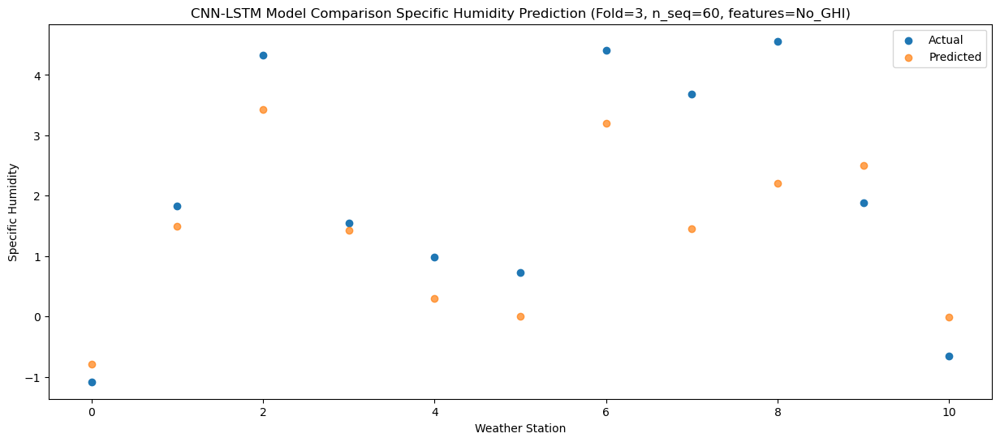

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03  -1.272649
1                 1    1.80   1.420715
2                 2    3.95   3.364155
3                 3    1.15   1.055155
4                 4   -1.30   0.055778
5                 5    0.23  -0.313927
6                 6    4.37   3.119434
7                 7    2.56   1.414169
8                 8    3.88   2.060310
9                 9    1.61   2.178958
10               10   -0.74  -0.352717


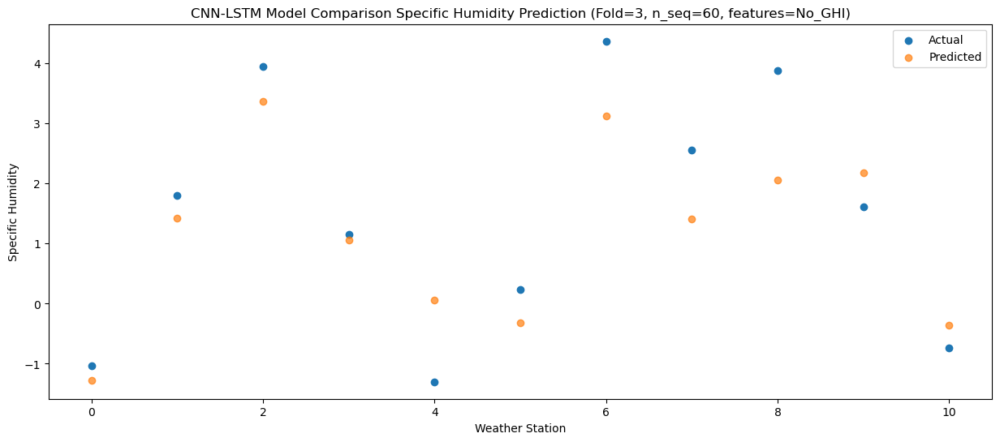

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -1.207834
1                 1    1.44   1.142065
2                 2    3.26   3.066303
3                 3    0.97   0.902722
4                 4   -2.06  -0.231062
5                 5   -0.02  -0.550533
6                 6    4.33   2.814708
7                 7    2.14   1.074781
8                 8    2.99   1.857619
9                 9    1.69   1.888303
10               10   -0.75  -0.618351


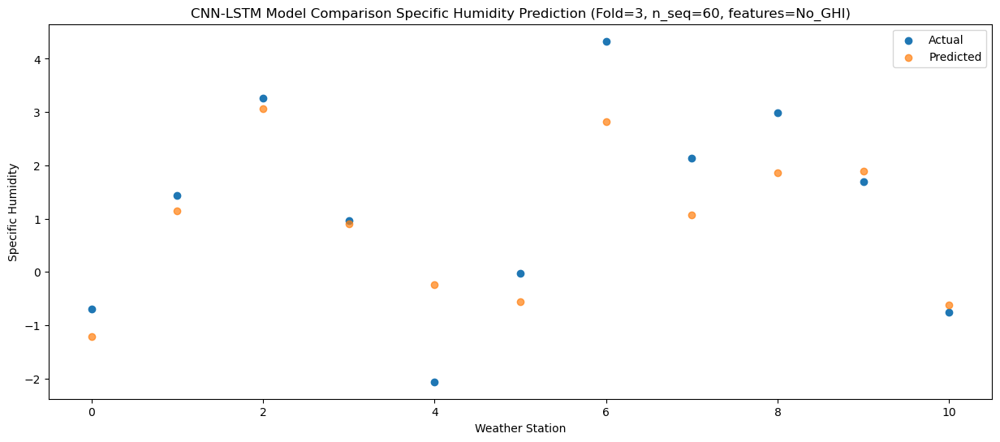

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   0.294117
1                 1    4.04   3.675873
2                 2    4.34   3.087854
3                 3    2.83   2.396049
4                 4    0.01   1.596862
5                 5    1.97   1.080989
6                 6    4.96   3.326271
7                 7    3.88   1.205506
8                 8    3.47   1.860954
9                 9    2.18   2.818555
10               10    0.21   0.472316


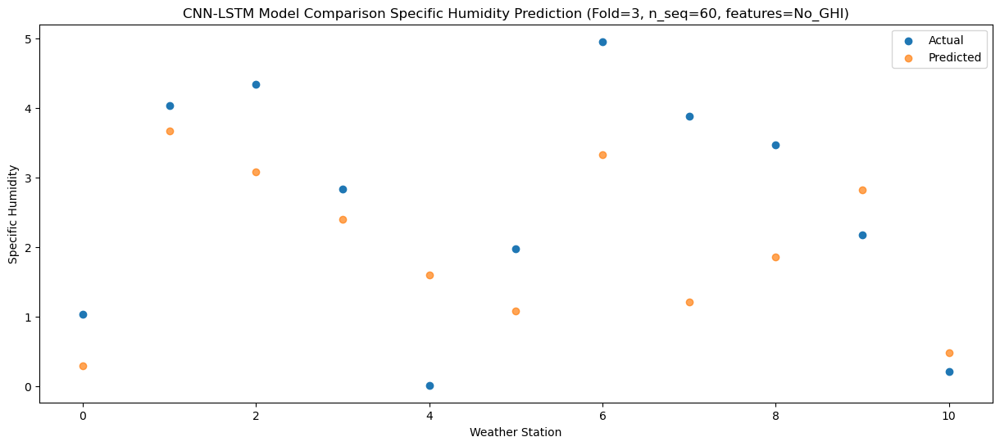

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   0.055422
1                 1    4.19   3.208568
2                 2    5.71   3.356165
3                 3    2.75   2.204053
4                 4    0.33   1.344745
5                 5    2.09   0.866136
6                 6    5.31   3.477136
7                 7    3.69   1.466914
8                 8    4.53   2.106338
9                 9    2.68   2.828947
10               10    0.64   0.427940


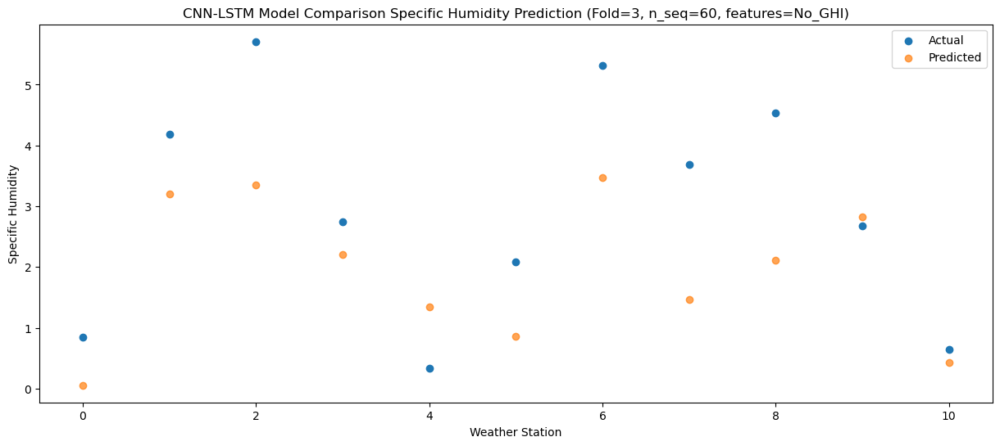

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   3.058178
1                 1    7.16   6.585985
2                 2    5.52   4.766287
3                 3    6.18   5.532222
4                 4    4.03   4.866444
5                 5    5.30   4.342593
6                 6    6.44   5.455903
7                 7    2.99   3.092438
8                 8    5.39   3.304665
9                 9    4.91   5.825055
10               10    3.17   3.587888


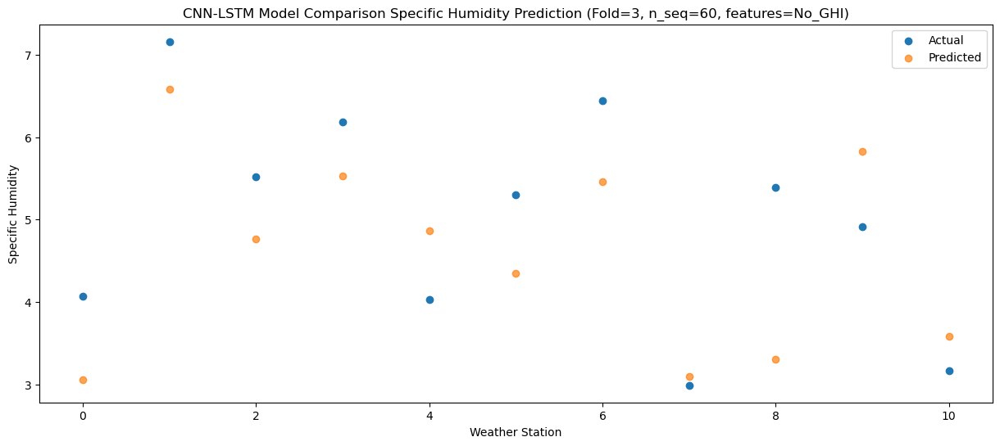

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   6.495719
1                 1   10.69   9.570036
2                 2    7.06   5.515528
3                 3    9.42   9.042217
4                 4    7.12   8.241761
5                 5    8.03   7.832533
6                 6    7.50   6.816438
7                 7    3.32   3.951502
8                 8    5.61   4.008088
9                 9    9.02   8.988595
10               10    6.74   6.938546


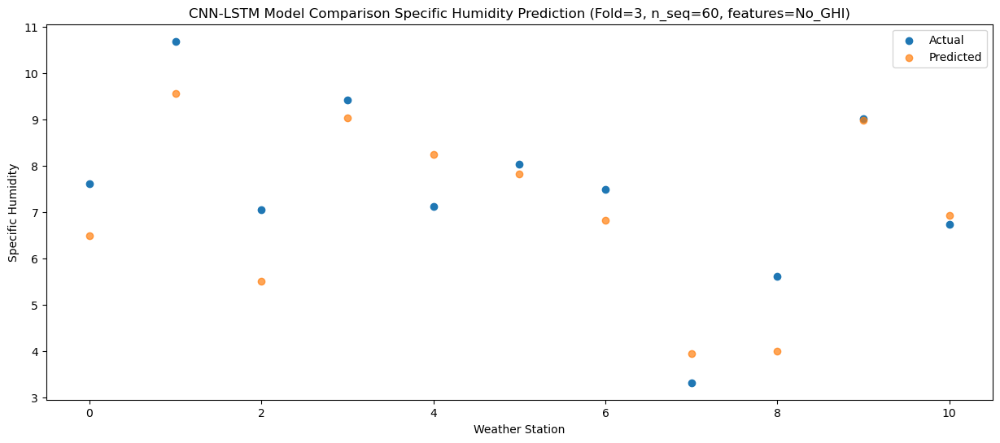

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30   9.143752
1                 1   13.43  12.362199
2                 2    7.28   5.955282
3                 3   12.52  12.031444
4                 4   11.07  11.308433
5                 5   11.19  10.917618
6                 6    9.02   7.936049
7                 7    3.80   4.585449
8                 8    6.08   4.259603
9                 9   13.00  11.697729
10               10   10.09   9.826540


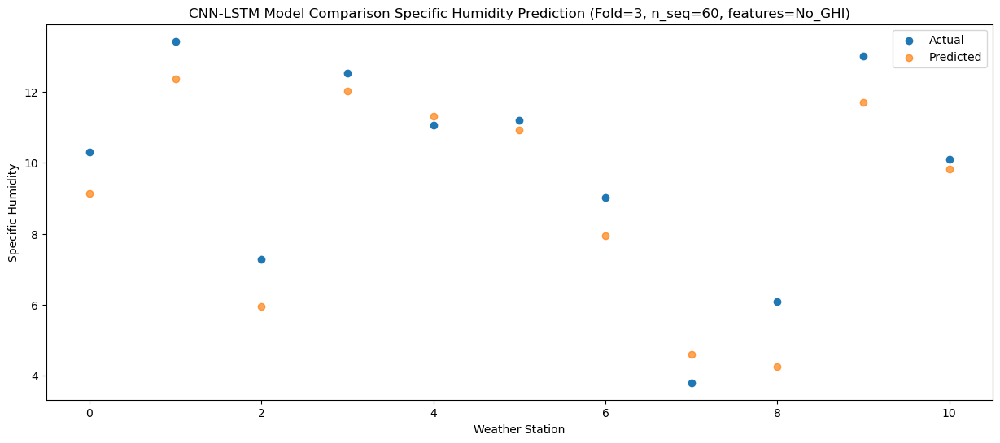

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59   8.544000
1                 1   10.76  10.448183
2                 2    8.80   6.048162
3                 3   11.44  10.893755
4                 4    8.69   9.602480
5                 5    9.97   9.456868
6                 6    7.81   7.475050
7                 7    4.67   4.399939
8                 8    6.88   4.646433
9                 9   11.93  10.800476
10               10    9.45   8.808322


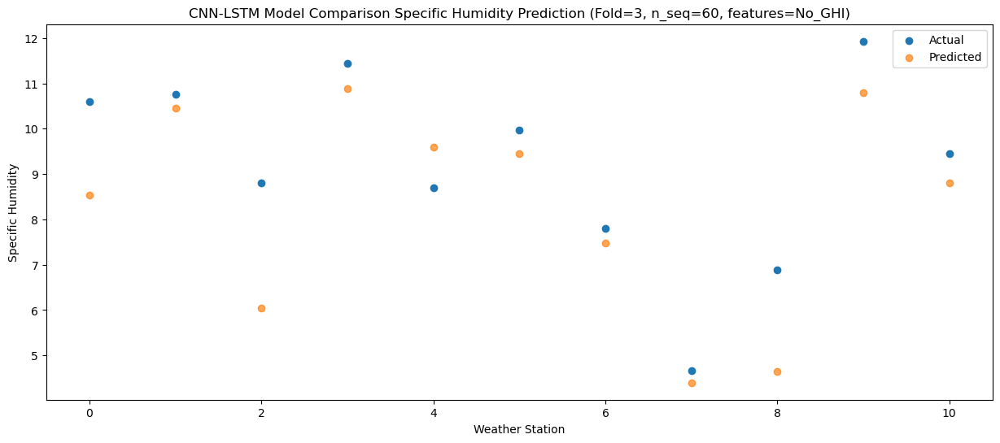

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   6.048531
1                 1    9.32   8.150726
2                 2    8.32   5.402077
3                 3    8.87   8.056963
4                 4    5.73   6.749667
5                 5    6.79   6.536267
6                 6    6.67   6.268060
7                 7    3.41   3.548013
8                 8    6.49   4.203886
9                 9    8.56   8.152819
10               10    6.16   6.003201


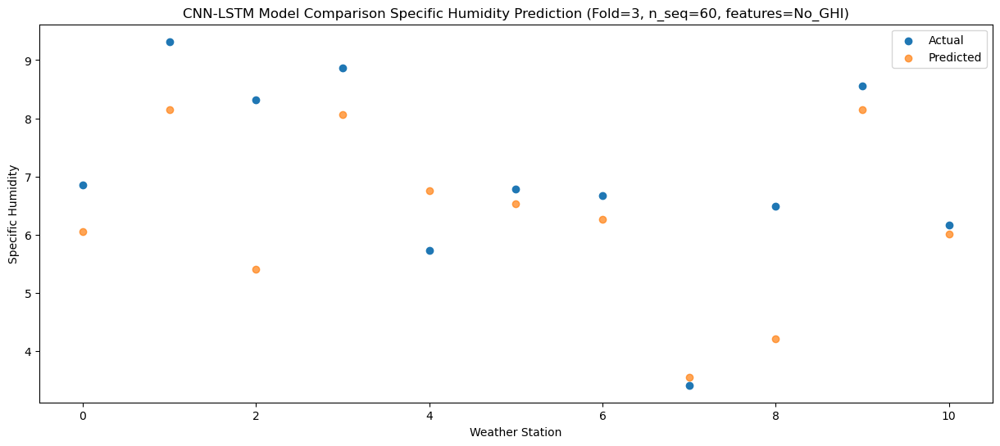

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   2.890795
1                 1    4.75   3.934926
2                 2    6.44   4.143769
3                 3    5.18   4.518002
4                 4    1.01   2.775719
5                 5    3.37   2.748171
6                 6    5.02   4.269624
7                 7    2.40   2.033176
8                 8    4.29   3.164665
9                 9    6.03   5.140852
10               10    3.39   2.781826


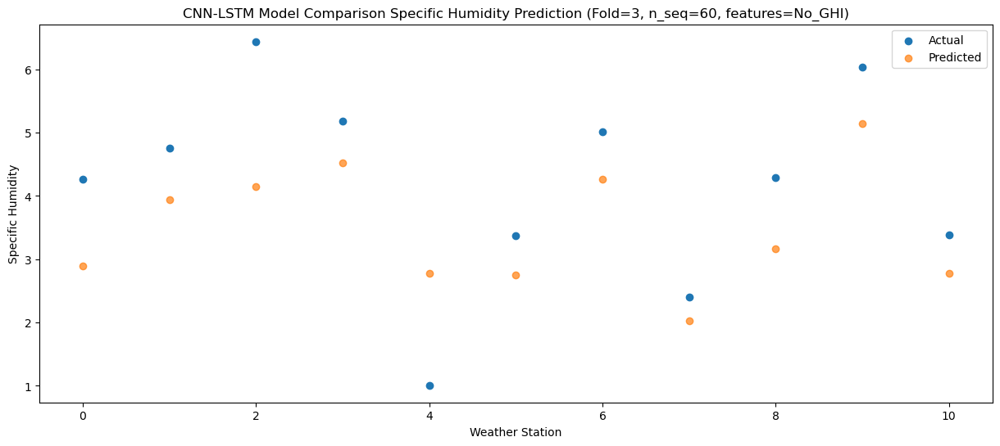

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53   0.573798
1                 1    3.25   2.499014
2                 2    3.75   3.314998
3                 3    2.29   2.659123
4                 4   -0.09   1.342853
5                 5    1.60   1.119722
6                 6    4.96   3.434603
7                 7    2.38   1.392284
8                 8    3.13   2.059686
9                 9    3.87   3.465042
10               10    1.06   1.047621


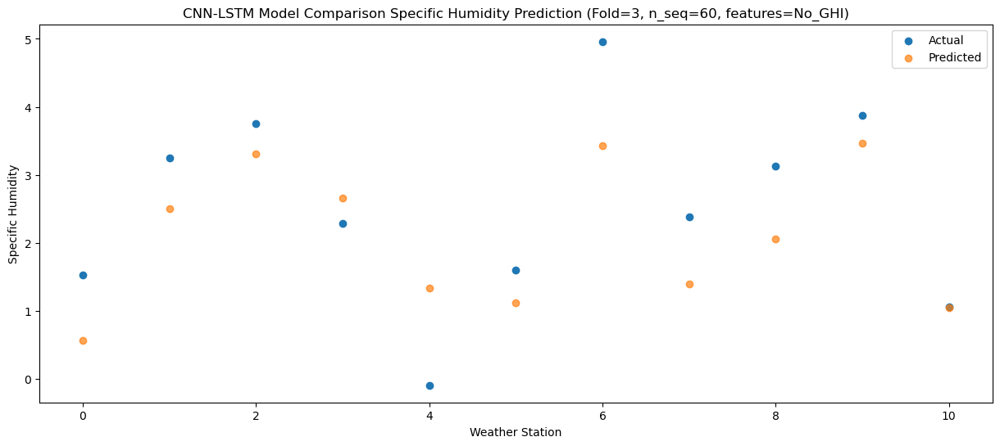

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -2.179048
1                 1    1.21   0.240358
2                 2    3.15   2.043942
3                 3    0.68   0.347205
4                 4   -2.02  -0.728301
5                 5   -0.06  -1.040185
6                 6    4.15   2.057560
7                 7    1.55   0.214783
8                 8    2.79   0.573541
9                 9    1.91   1.550851
10               10   -0.79  -0.965113


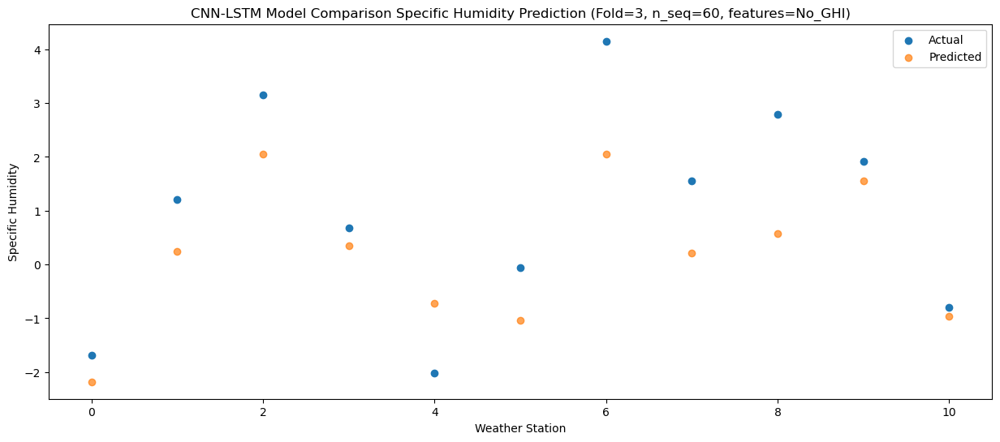

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -2.354384
1                 1    1.12   0.205503
2                 2    3.59   2.334828
3                 3    0.41   0.068413
4                 4   -2.22  -0.947844
5                 5   -0.37  -1.315156
6                 6    4.32   2.247181
7                 7    2.36   0.494592
8                 8    3.46   0.894165
9                 9    0.82   1.213896
10               10   -1.48  -1.325632


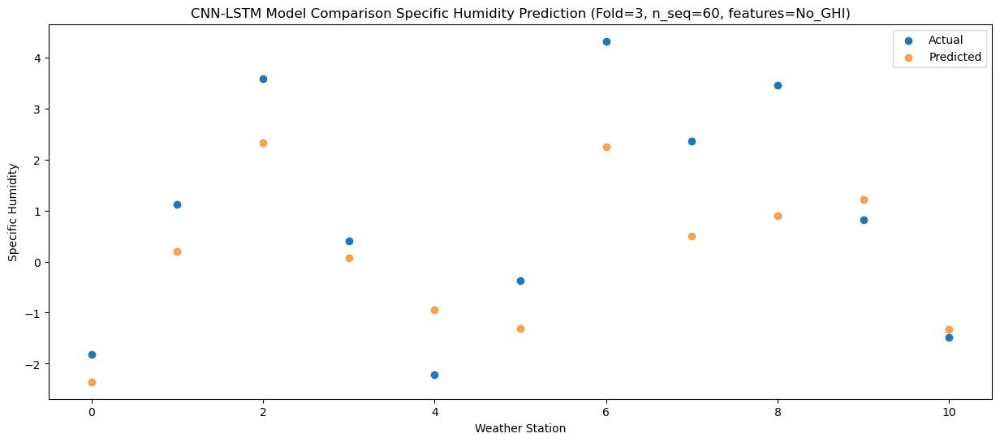

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73  -2.437414
1                 1    0.56  -0.532166
2                 2    3.53   2.165828
3                 3    0.34  -0.436002
4                 4   -3.05  -1.739326
5                 5   -0.89  -2.000881
6                 6    4.38   1.864152
7                 7    1.88   0.170940
8                 8    3.11   0.955969
9                 9    0.97   0.665973
10               10   -1.62  -1.898632


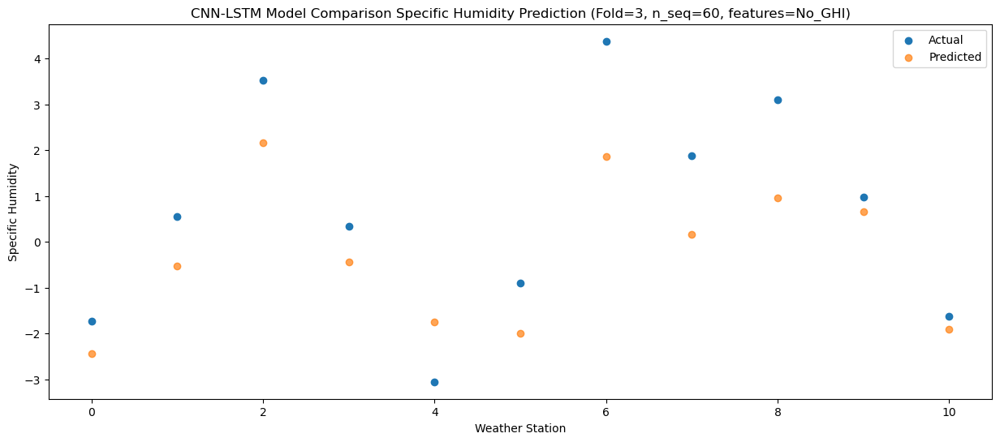

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08  -1.119457
1                 1    3.07   1.759881
2                 2    3.61   1.878469
3                 3    1.64   1.136352
4                 4   -0.57   0.207758
5                 5    1.14  -0.227753
6                 6    4.69   2.193165
7                 7    2.18   0.089614
8                 8    2.76   0.508393
9                 9    1.75   1.747499
10               10   -0.34  -0.634218


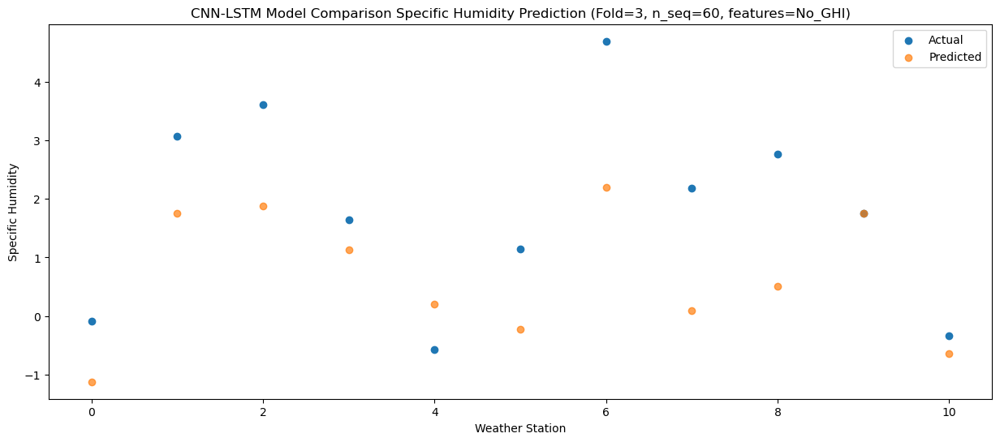

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44  -0.278807
1                 1    4.24   2.607566
2                 2    4.23   2.040558
3                 3    2.83   2.196461
4                 4    0.49   1.263447
5                 5    2.44   0.864752
6                 6    5.16   2.584902
7                 7    1.87   0.303423
8                 8    3.69   0.571950
9                 9    3.13   2.913883
10               10    1.07   0.556195


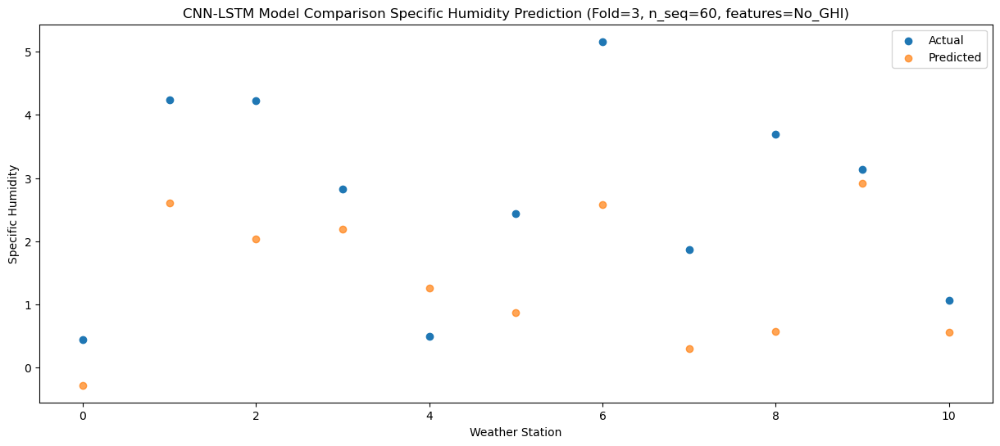

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   2.233963
1                 1    7.76   6.355061
2                 2    4.63   4.174841
3                 3    5.36   4.763085
4                 4    2.91   4.312661
5                 5    4.68   3.639310
6                 6    6.56   5.036810
7                 7    2.43   2.583078
8                 8    4.13   2.632024
9                 9    4.70   5.015556
10               10    2.66   2.760846


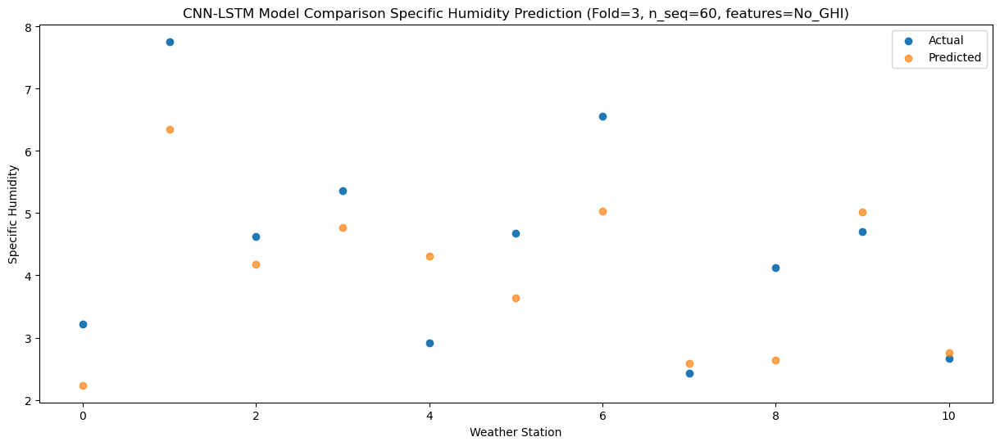

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94   6.720307
1                 1   12.29  10.178490
2                 2    7.08   5.568290
3                 3   10.78   9.393298
4                 4    7.37   8.678984
5                 5    9.90   8.210750
6                 6    7.89   7.091385
7                 7    3.85   4.058915
8                 8    5.56   3.969118
9                 9    9.60   9.364532
10               10    7.53   7.311798


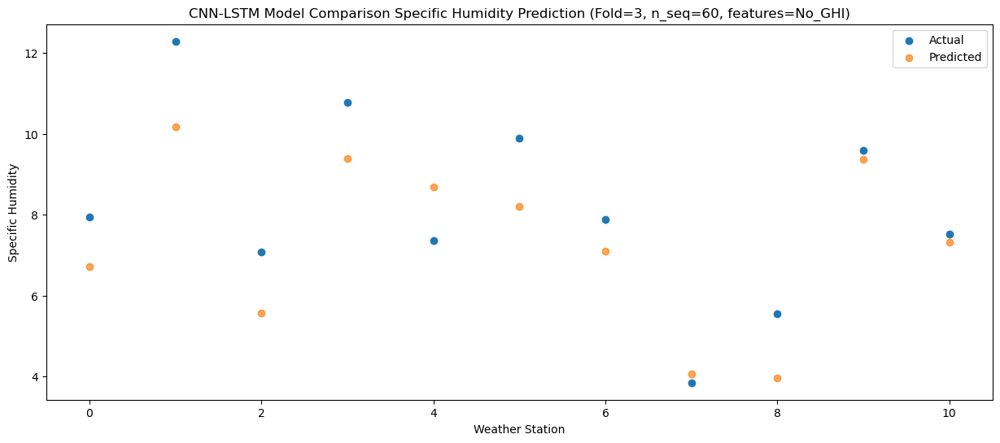

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18   7.918743
1                 1   13.17  11.213145
2                 2    7.78   6.302449
3                 3   11.41  10.678355
4                 4    9.32   9.906370
5                 5   11.15   9.492796
6                 6   10.34   7.964185
7                 7    9.21   4.839000
8                 8    6.04   4.664155
9                 9   11.81  10.625384
10               10    9.22   8.612058


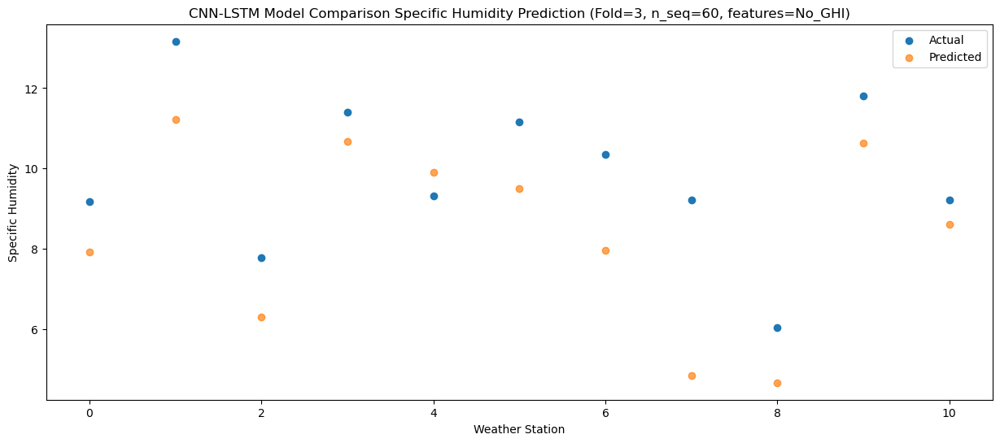

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45   8.842614
1                 1   13.34  11.579191
2                 2    7.31   6.540291
3                 3   12.29  11.657757
4                 4    9.41  10.648991
5                 5   11.32  10.392261
6                 6    8.91   8.259524
7                 7    6.78   5.024195
8                 8    6.43   4.921055
9                 9   12.19  11.773364
10               10    9.54   9.760933


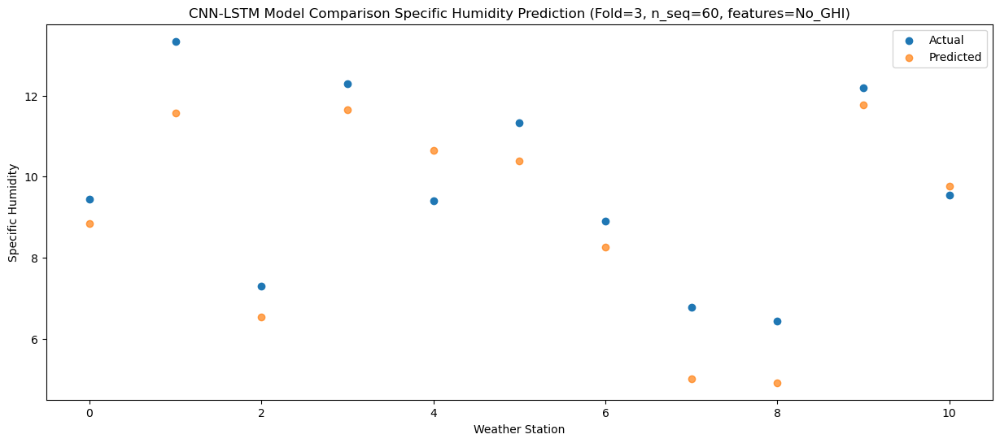

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   5.305936
1                 1    9.37   7.566734
2                 2    6.02   5.362734
3                 3    8.82   7.689571
4                 4    5.64   6.493515
5                 5    8.02   6.266099
6                 6    7.21   6.334524
7                 7    5.06   3.635556
8                 8    5.79   3.957409
9                 9    9.59   8.171583
10               10    6.62   5.950033


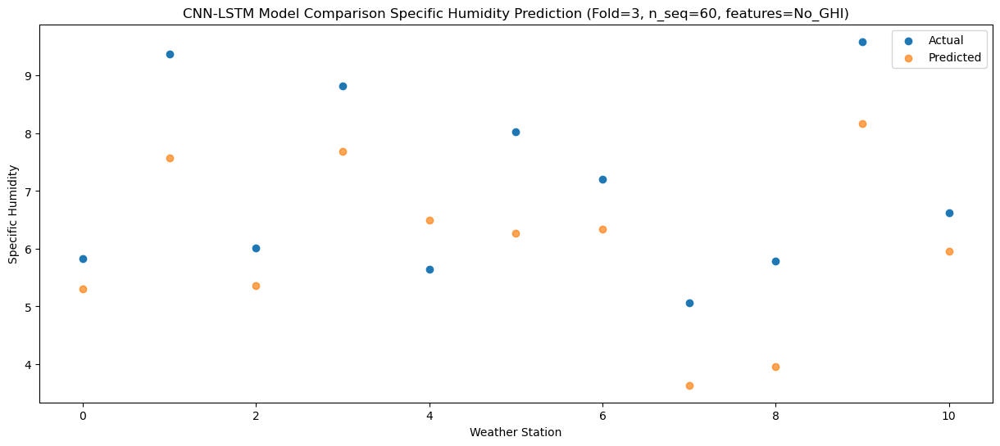

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   3.256233
1                 1    7.18   5.130400
2                 2    4.88   3.427257
3                 3    6.76   5.727546
4                 4    3.69   4.389399
5                 5    6.40   4.259406
6                 6    6.12   4.344148
7                 7    3.96   1.683754
8                 8    4.76   1.994972
9                 9    7.05   6.427045
10               10    4.72   4.167503


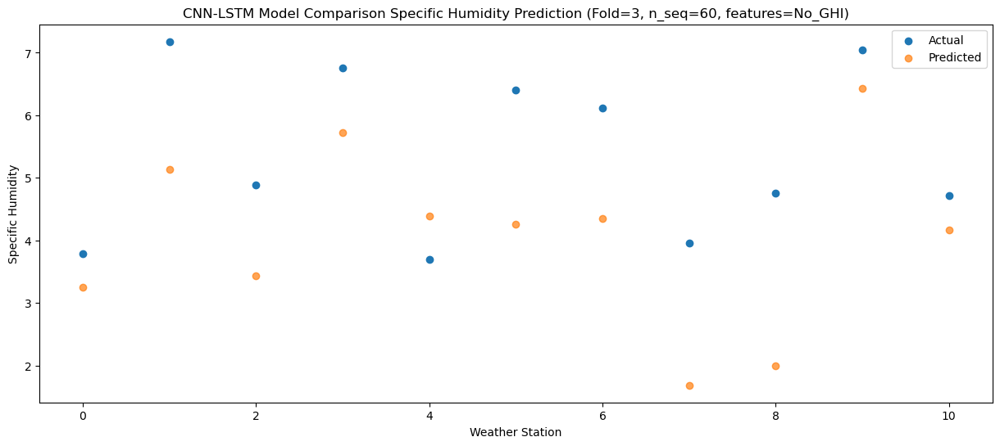

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71  -1.538291
1                 1    2.75   1.178999
2                 2    5.46   3.761342
3                 3    1.07   0.908213
4                 4   -1.43  -0.061651
5                 5    0.53  -0.455443
6                 6    5.41   3.624602
7                 7    2.69   1.923429
8                 8    4.98   2.307189
9                 9    2.52   2.315350
10               10   -0.20  -0.302355


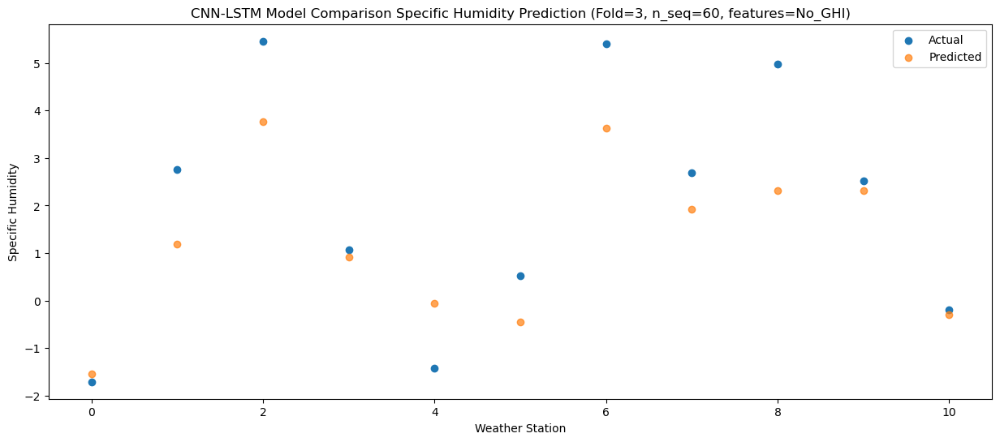

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24  -0.955218
1                 1    3.72   1.674693
2                 2    3.96   1.604070
3                 3    2.21   1.018328
4                 4   -0.73  -0.086436
5                 5    1.58  -0.451150
6                 6    4.70   1.930698
7                 7    2.83  -0.282537
8                 8    3.73   0.392585
9                 9    2.22   1.695674
10               10   -0.30  -0.713824


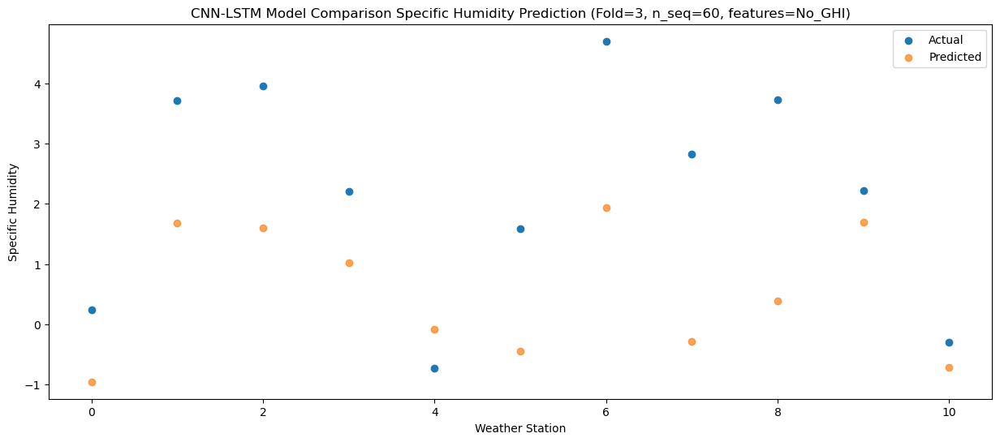

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -3.419926
1                 1    0.53  -1.027700
2                 2    3.68   2.213816
3                 3   -0.11  -1.068361
4                 4   -3.19  -2.145376
5                 5   -0.93  -2.481634
6                 6    4.22   1.963507
7                 7    1.84   0.352490
8                 8    3.40   0.798823
9                 9    0.74   0.395993
10               10   -1.81  -2.249194


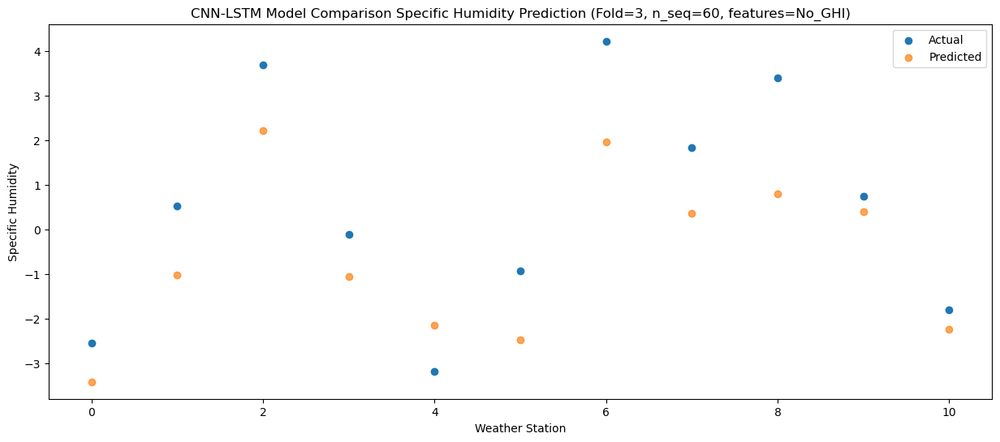

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19  -2.568572
1                 1    0.90  -0.727199
2                 2    2.90   1.824881
3                 3    0.41  -0.439553
4                 4   -2.57  -1.750479
5                 5   -0.40  -1.968833
6                 6    4.01   1.721508
7                 7    1.41  -0.085747
8                 8    2.56   0.527352
9                 9    1.33   0.851453
10               10   -1.11  -1.729370


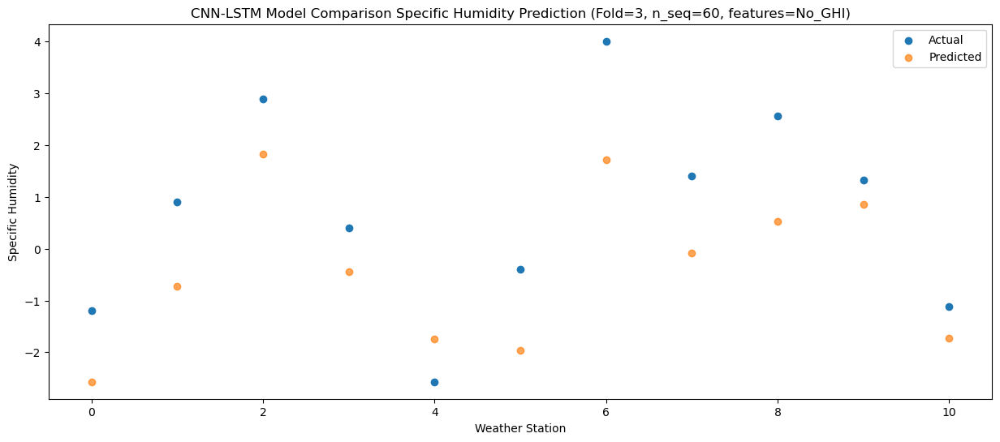

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29  -1.544191
1                 1    2.37   0.545683
2                 2    4.24   2.763488
3                 3    1.39   0.633243
4                 4   -1.00  -0.582785
5                 5    0.91  -0.846487
6                 6    4.69   2.740720
7                 7    2.03   0.888763
8                 8    3.56   1.434666
9                 9    2.17   1.871724
10               10   -0.17  -0.688722


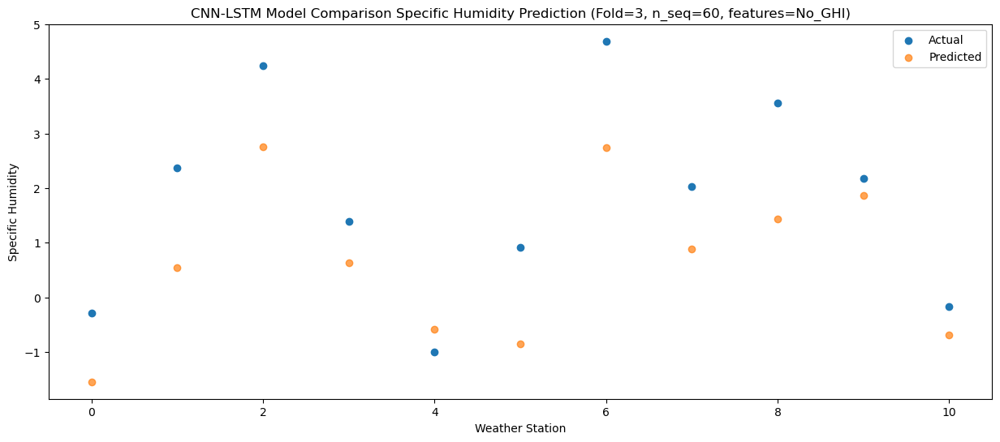

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74  -0.359834
1                 1    4.67   2.786049
2                 2    3.91   2.306904
3                 3    2.66   1.922233
4                 4    0.56   1.059637
5                 5    2.44   0.604666
6                 6    5.19   2.850752
7                 7    2.03   0.576807
8                 8    3.66   0.905105
9                 9    2.82   2.645313
10               10    0.47   0.252835


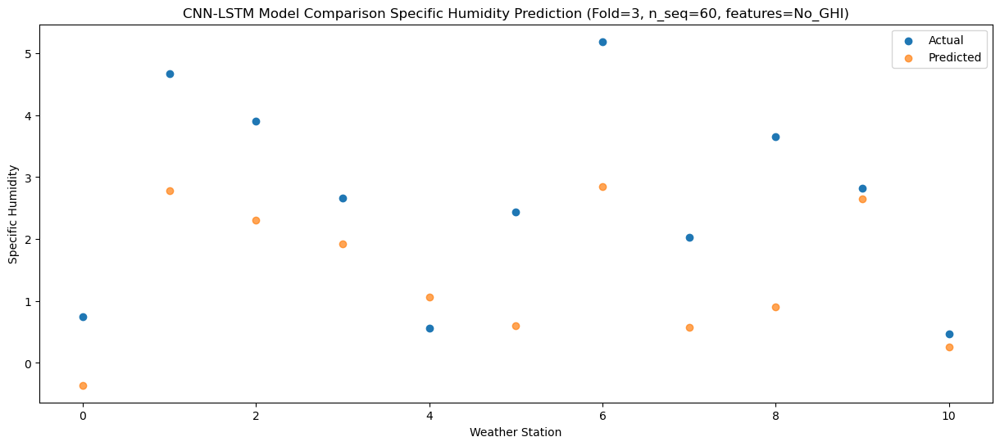

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   3.543668
1                 1    9.12   6.816193
2                 2    4.09   2.921374
3                 3    7.08   5.977695
4                 4    4.65   5.165667
5                 5    6.67   4.730881
6                 6    6.00   4.321434
7                 7    2.29   1.370256
8                 8    4.03   1.434838
9                 9    6.21   6.066552
10               10    4.65   3.950491


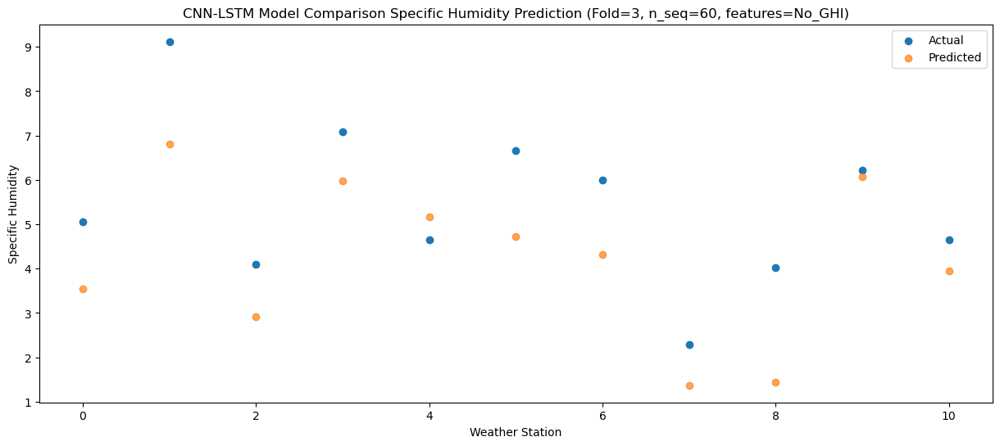

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   5.176727
1                 1   11.74   8.798783
2                 2    5.26   4.882895
3                 3    9.34   7.643679
4                 4    6.75   7.020125
5                 5    8.74   6.477582
6                 6    7.94   6.325343
7                 7    4.05   3.411724
8                 8    5.52   3.340508
9                 9    8.55   7.615118
10               10    6.05   5.509505


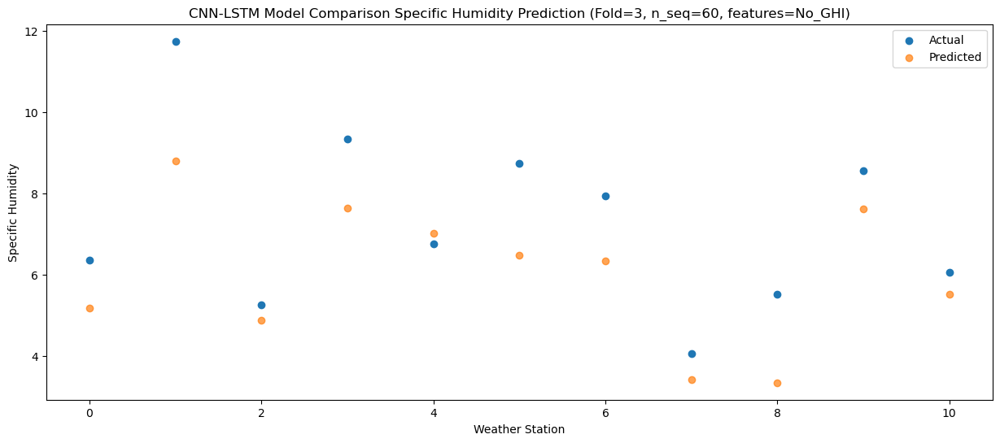

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42   8.026164
1                 1   11.95  10.530530
2                 2    6.43   6.300368
3                 3   12.38  10.553901
4                 4    9.34   9.531941
5                 5   11.52   9.253120
6                 6   10.93   7.945880
7                 7    7.48   4.837897
8                 8    6.35   4.725482
9                 9   11.71  10.565387
10               10    9.03   8.526287


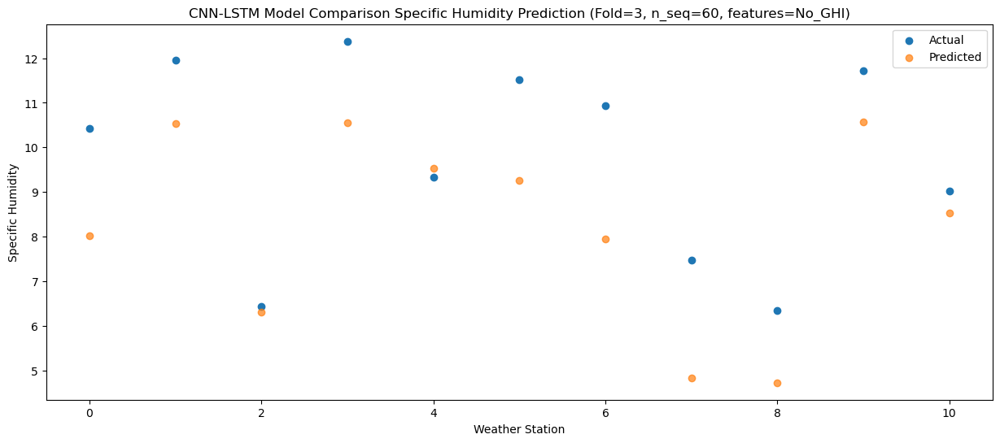

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61   7.812617
1                 1   12.56  10.762299
2                 2    7.22   6.945531
3                 3   11.25  10.510381
4                 4    8.84   9.626392
5                 5   10.32   9.275222
6                 6   10.77   8.495284
7                 7   10.55   5.489331
8                 8    6.81   5.301922
9                 9   11.85  10.743420
10               10    8.66   8.641007


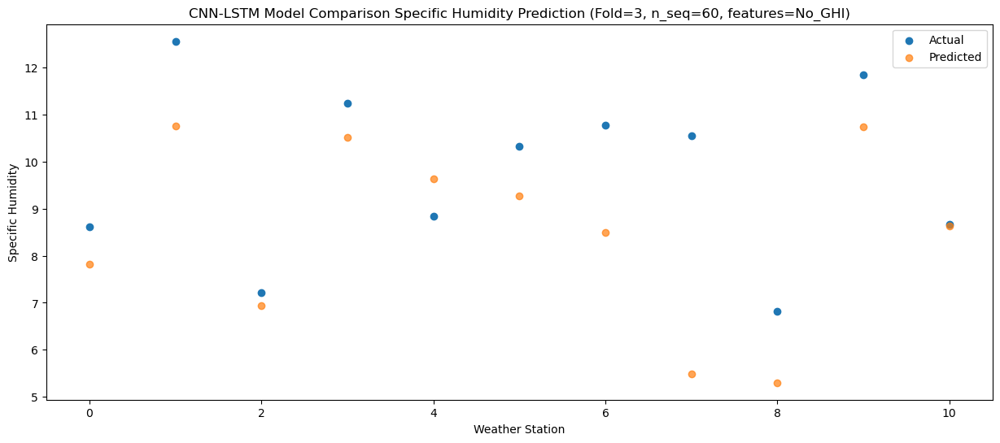

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   5.315382
1                 1    8.71   7.700389
2                 2    6.93   6.075177
3                 3    8.00   7.736318
4                 4    5.74   6.650151
5                 5    7.55   6.364389
6                 6    7.82   7.096114
7                 7    6.64   4.457953
8                 8    6.21   4.591128
9                 9    8.18   8.324735
10               10    5.64   6.059622


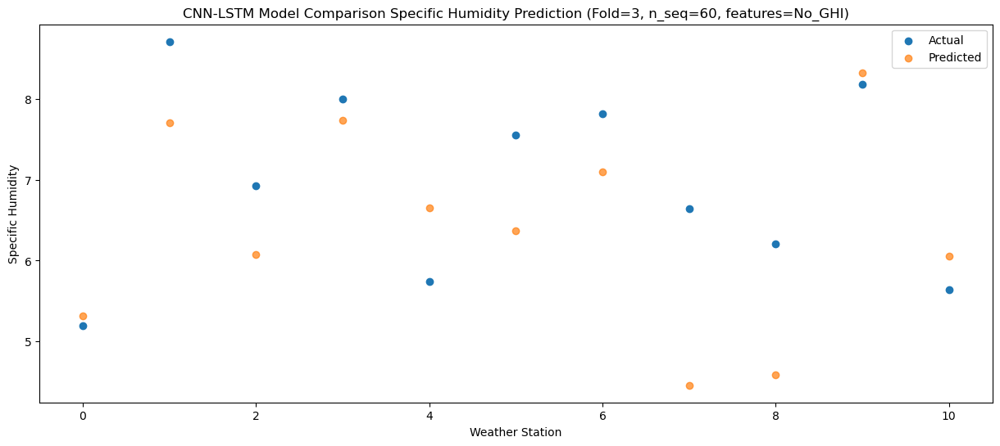

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96   0.871091
1                 1    4.25   3.033046
2                 2    5.76   5.473549
3                 3    2.85   3.167218
4                 4    0.74   2.004048
5                 5    2.25   1.711215
6                 6    6.21   5.519415
7                 7    3.91   3.669559
8                 8    4.90   4.063685
9                 9    5.55   4.511820
10               10    2.22   1.928237


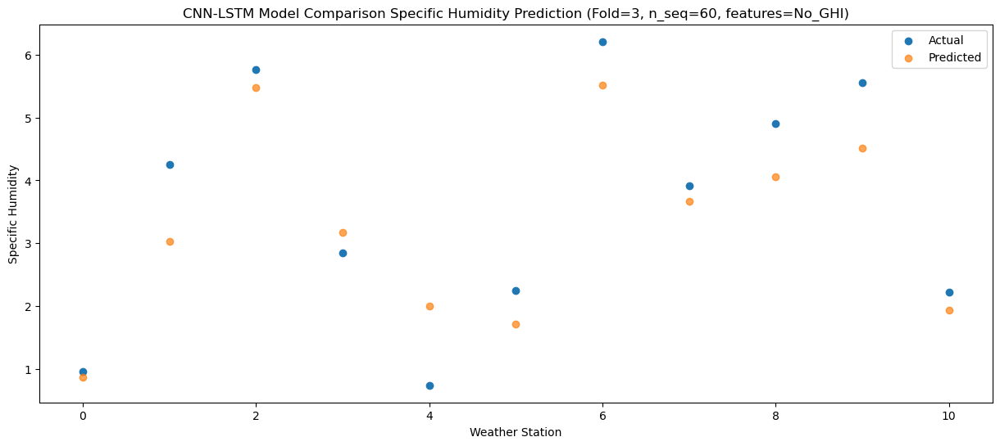

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51  -0.339209
1                 1    3.22   1.601668
2                 2    3.04   2.145787
3                 3    2.04   1.824414
4                 4   -0.65   0.549696
5                 5    1.03   0.325040
6                 6    4.55   2.610119
7                 7    2.14   0.367629
8                 8    2.65   0.802928
9                 9    3.70   2.755249
10               10    1.00   0.336015


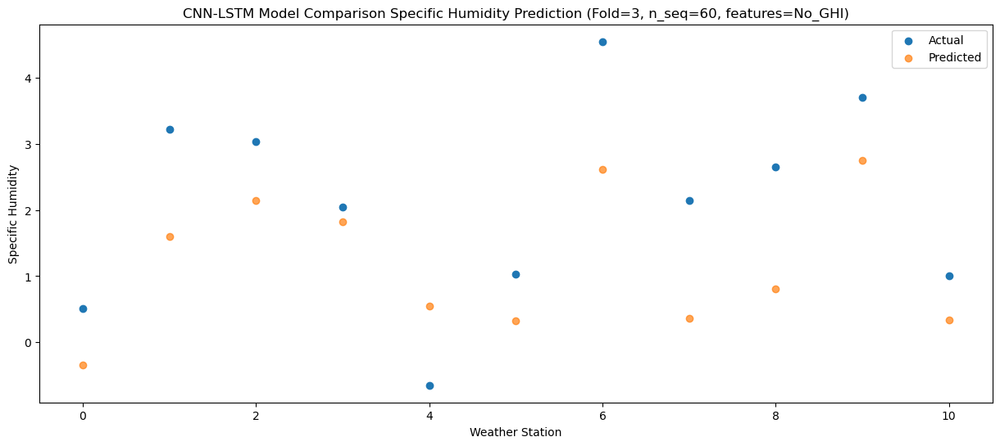

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -2.301544
1                 1    2.03   0.290438
2                 2    3.88   1.416303
3                 3    1.01   0.040230
4                 4   -1.77  -0.983229
5                 5    0.27  -1.342233
6                 6    4.58   1.759505
7                 7    2.89  -0.311725
8                 8    3.44  -0.026521
9                 9    1.73   1.107074
10               10   -0.92  -1.375986


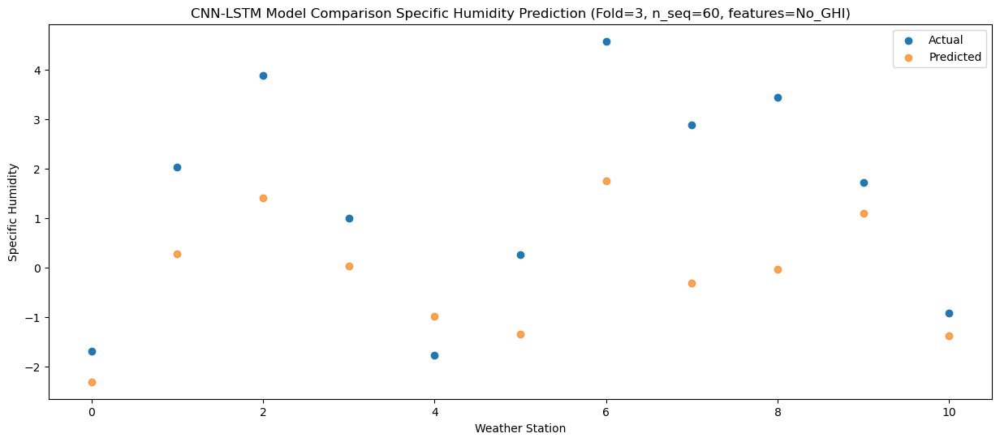

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -1.923935
1                 1    1.95   0.274111
2                 2    4.03   1.466408
3                 3    1.55   0.487880
4                 4   -1.39  -0.652975
5                 5    0.85  -0.922987
6                 6    4.55   1.872040
7                 7    3.28  -0.234716
8                 8    3.27  -0.030694
9                 9    2.30   1.590122
10               10   -0.14  -0.873380


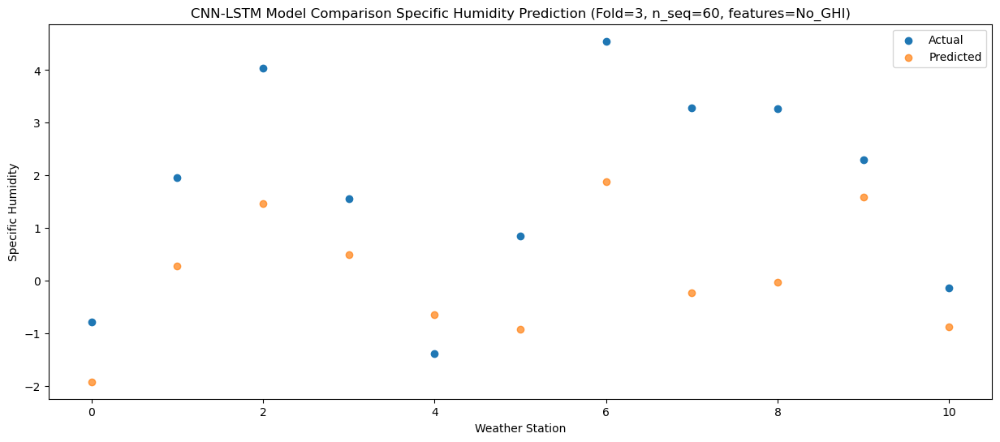

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05  -1.660430
1                 1    2.11   0.427832
2                 2    2.90   1.070035
3                 3    1.37   0.360203
4                 4   -0.51  -0.841522
5                 5    0.52  -1.125520
6                 6    4.17   1.505901
7                 7    2.03  -0.704184
8                 8    2.41  -0.241692
9                 9    1.59   1.137047
10               10   -0.89  -1.274499


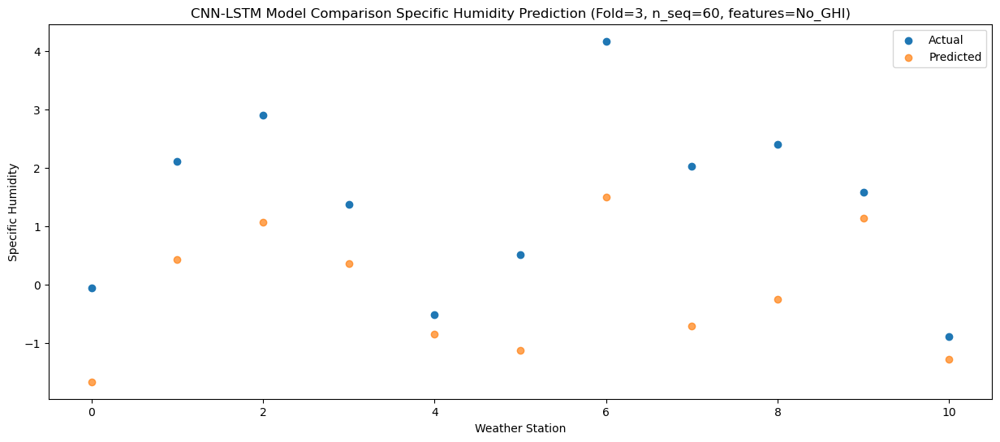

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44  -1.564330
1                 1    3.05   1.275002
2                 2    4.42   1.522801
3                 3    1.24   0.573110
4                 4   -0.84  -0.342652
5                 5    0.95  -0.785047
6                 6    4.47   2.020345
7                 7    3.07  -0.179952
8                 8    3.21   0.135933
9                 9    1.80   1.274522
10               10   -0.76  -1.127066


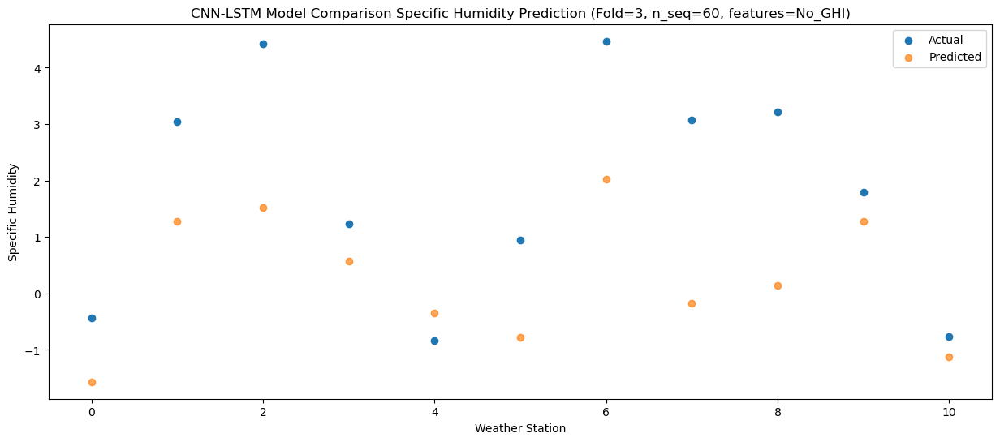

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55   0.239209
1                 1    3.92   2.346211
2                 2    4.62   2.302174
3                 3    2.78   2.413653
4                 4    0.39   1.200015
5                 5    2.26   0.947302
6                 6    5.10   2.928774
7                 7    2.22   0.579340
8                 8    3.59   0.925361
9                 9    4.04   3.172551
10               10    1.67   0.812493


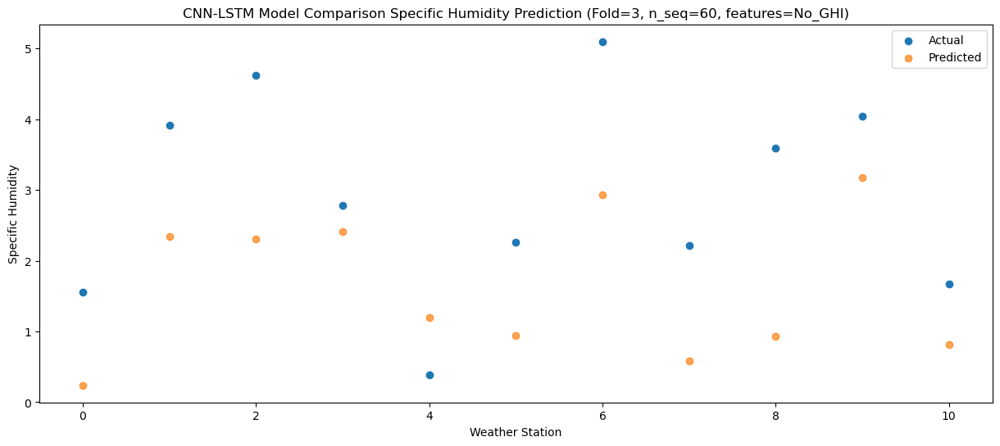

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00   1.765483
1                 1    8.33   6.097864
2                 2    5.56   4.760116
3                 3    5.69   4.146290
4                 4    3.57   3.852299
5                 5    4.86   3.082752
6                 6    7.26   5.633661
7                 7    3.76   3.275501
8                 8    5.18   3.206452
9                 9    4.56   4.420963
10               10    2.14   2.115539


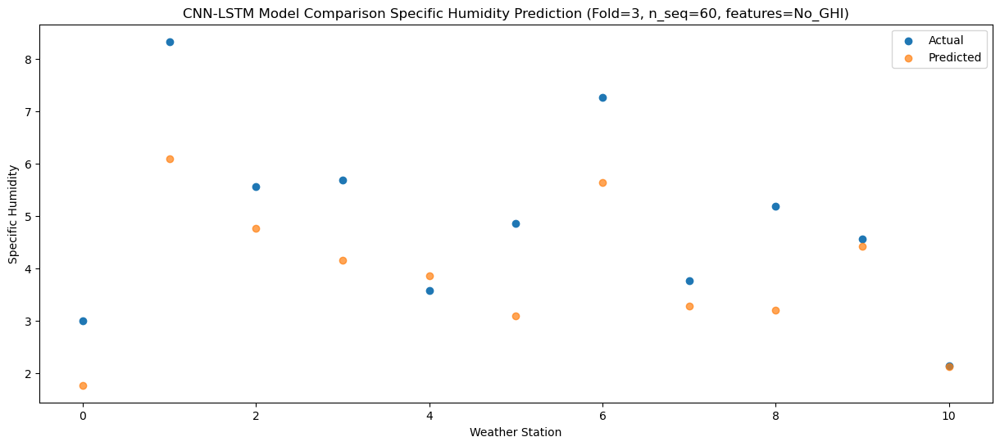

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27   4.765762
1                 1   10.97   8.842317
2                 2    6.33   5.508506
3                 3    7.71   7.281488
4                 4    5.70   6.872015
5                 5    7.02   6.207243
6                 6    7.49   6.913724
7                 7    4.26   4.099240
8                 8    5.24   3.903402
9                 9    8.26   7.368498
10               10    5.83   5.202348


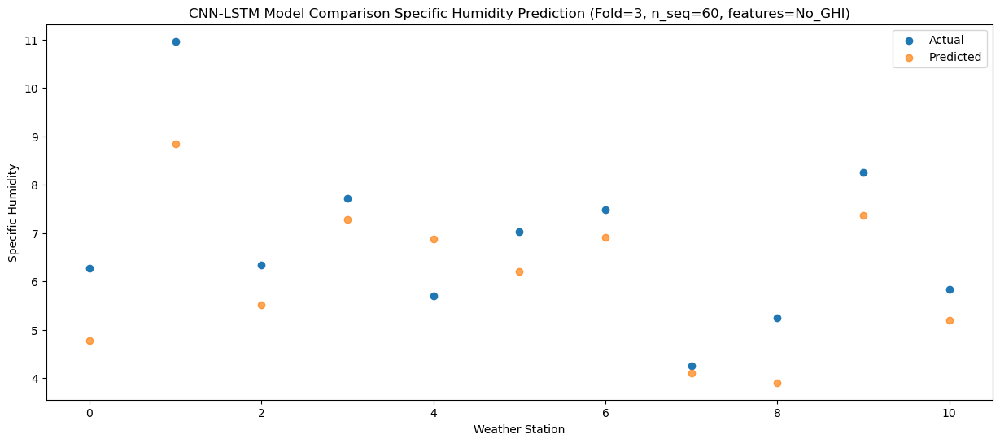

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22   8.541190
1                 1   13.24  11.177116
2                 2    7.43   5.904813
3                 3   11.36  11.268899
4                 4    9.47  10.289157
5                 5   11.53  10.016531
6                 6    8.33   7.936173
7                 7    5.23   4.541123
8                 8    6.08   4.234518
9                 9   13.11  11.288722
10               10    9.81   9.306779


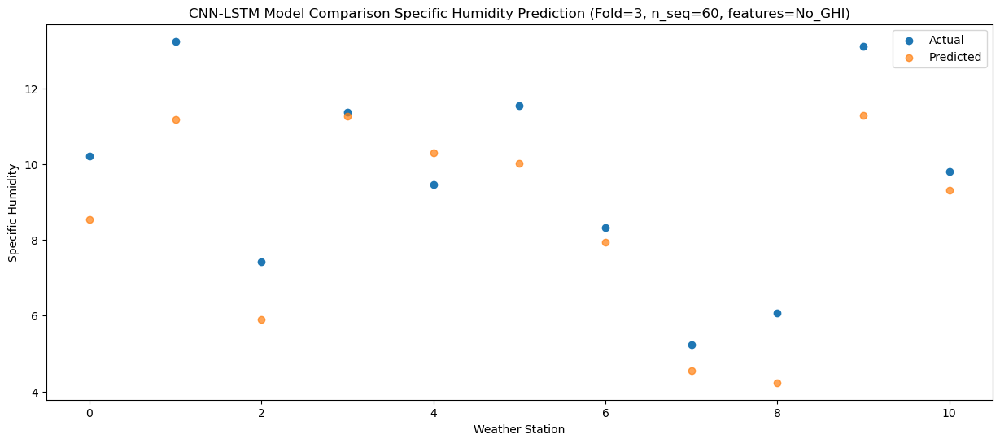

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32   8.124578
1                 1   13.48  10.833010
2                 2    8.50   6.870078
3                 3   10.81  10.634852
4                 4    9.86   9.755628
5                 5   10.65   9.389558
6                 6    9.98   8.575099
7                 7    7.81   5.477884
8                 8    7.35   5.250224
9                 9   10.54  10.655599
10               10    8.57   8.590243


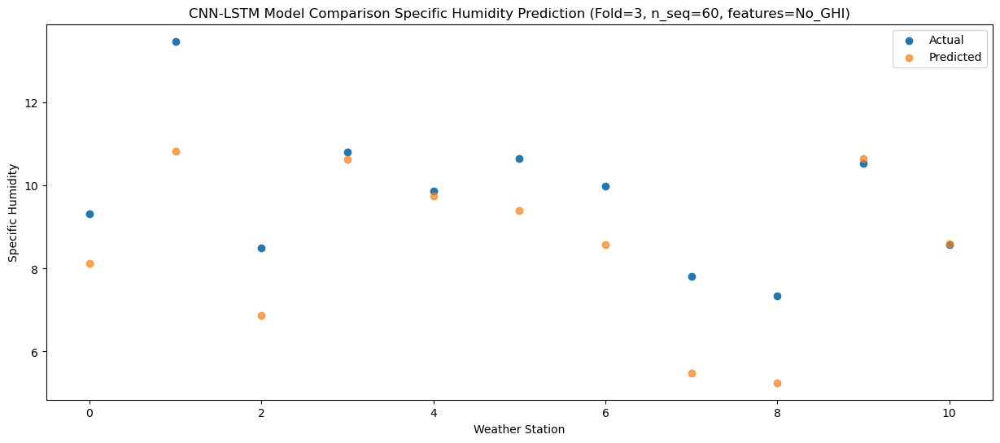

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   5.465876
1                 1    9.41   8.221421
2                 2    6.96   5.942200
3                 3    8.34   8.072951
4                 4    5.75   7.143051
5                 5    7.42   6.797626
6                 6    7.36   7.240101
7                 7    6.87   4.452173
8                 8    6.80   4.313651
9                 9    9.57   8.595058
10               10    6.88   6.373478


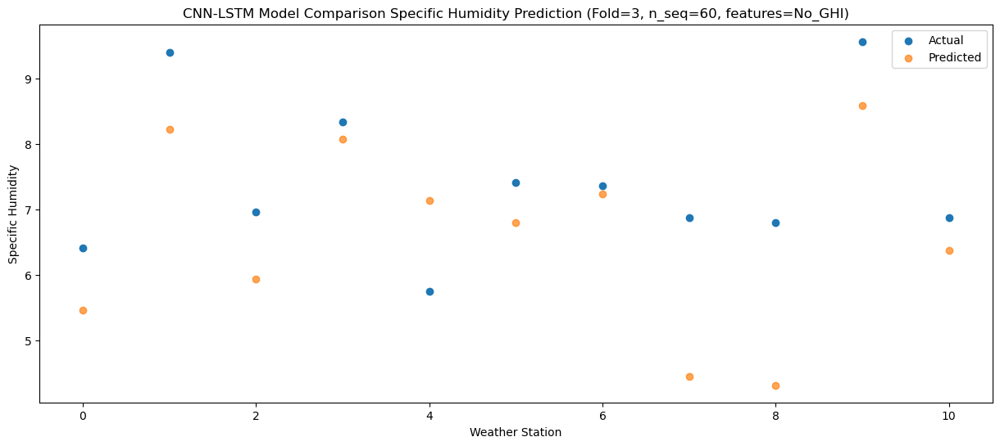

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30   2.239286
1                 1    5.97   4.957492
2                 2    5.80   5.156793
3                 3    4.81   4.852381
4                 4    2.13   3.894227
5                 5    4.04   3.544186
6                 6    6.11   5.855469
7                 7    3.81   3.548649
8                 8    5.37   3.551680
9                 9    6.18   5.887122
10               10    3.61   3.462290


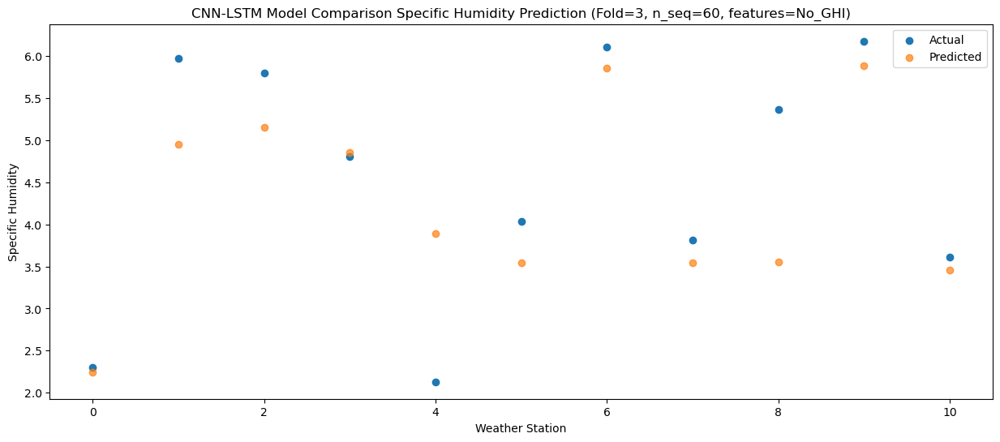

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -0.870757
1                 1    3.09   2.024671
2                 2    3.69   3.296816
3                 3    1.42   1.524782
4                 4   -1.04   0.637675
5                 5    0.85   0.203494
6                 6    4.78   3.673208
7                 7    2.80   1.620771
8                 8    4.28   1.784010
9                 9    2.38   2.577597
10               10   -0.07   0.072621


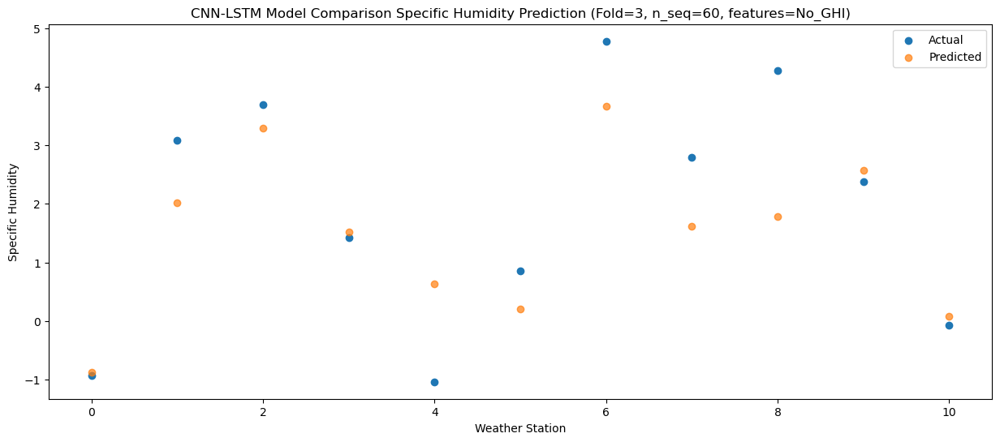

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94  -1.333926
1                 1    2.27   1.017539
2                 2    3.92   3.137495
3                 3    1.44   1.295288
4                 4   -1.45   0.243022
5                 5    0.81  -0.055743
6                 6    4.65   3.451133
7                 7    2.72   1.474048
8                 8    4.66   1.512836
9                 9    2.71   2.723648
10               10    0.31   0.158218


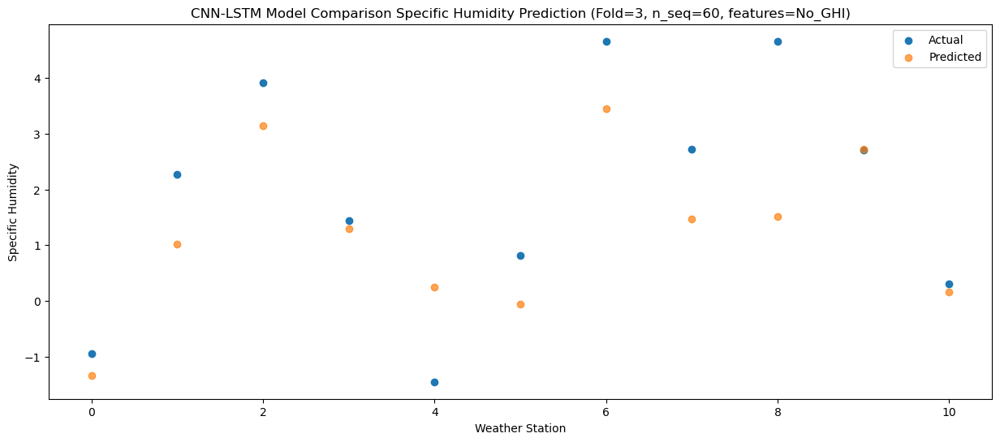

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59  -2.566715
1                 1    0.96  -0.416231
2                 2    4.46   2.363066
3                 3    0.70  -0.090697
4                 4   -2.32  -1.244774
5                 5   -0.07  -1.512606
6                 6    4.59   2.490653
7                 7    3.26   0.620567
8                 8    4.67   0.827466
9                 9    1.41   1.424383
10               10   -0.82  -1.187657


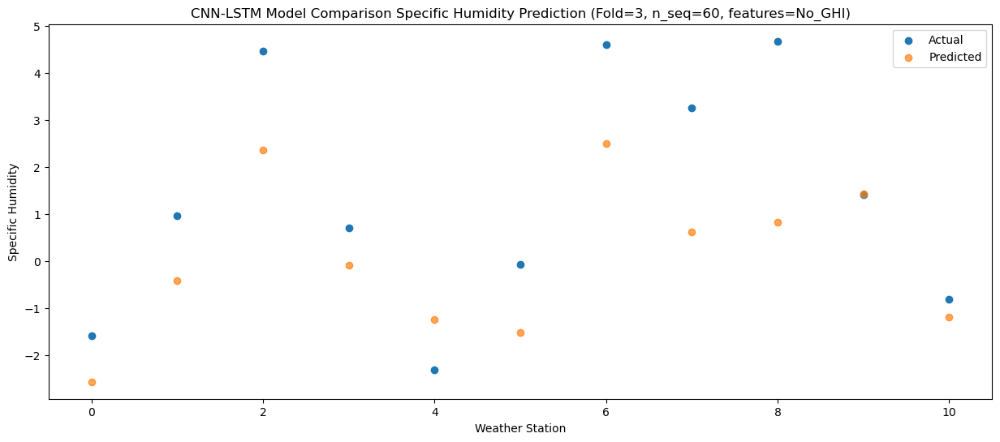

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53  -2.470149
1                 1    2.38   0.844345
2                 2    4.63   2.505191
3                 3    1.02   0.188727
4                 4   -1.41  -0.515919
5                 5    0.51  -1.028974
6                 6    4.66   2.885368
7                 7    4.08   0.911159
8                 8    4.36   0.831094
9                 9    1.31   1.460041
10               10   -0.91  -1.100163


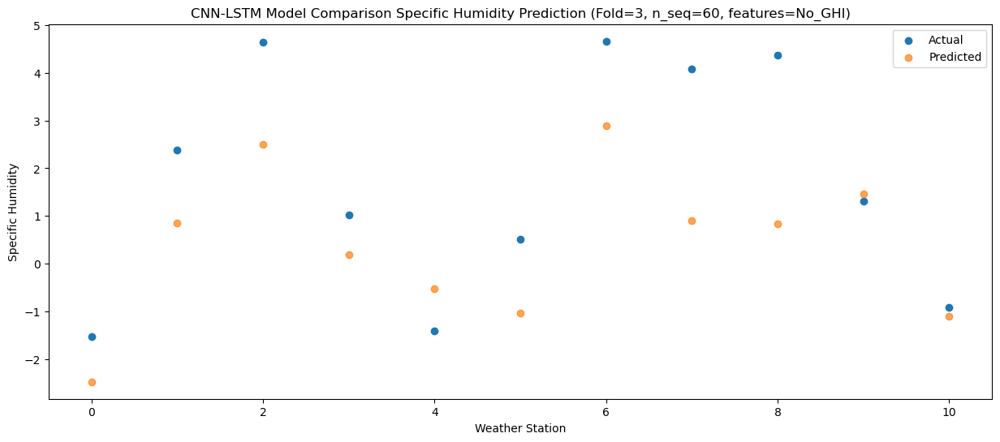

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03  -1.051149
1                 1    3.80   1.990247
2                 2    4.34   2.509990
3                 3    1.98   1.309908
4                 4   -0.37   0.449274
5                 5    1.59  -0.002136
6                 6    5.02   3.058026
7                 7    3.40   0.839528
8                 8    4.16   1.016817
9                 9    2.36   2.277056
10               10    0.14  -0.194054


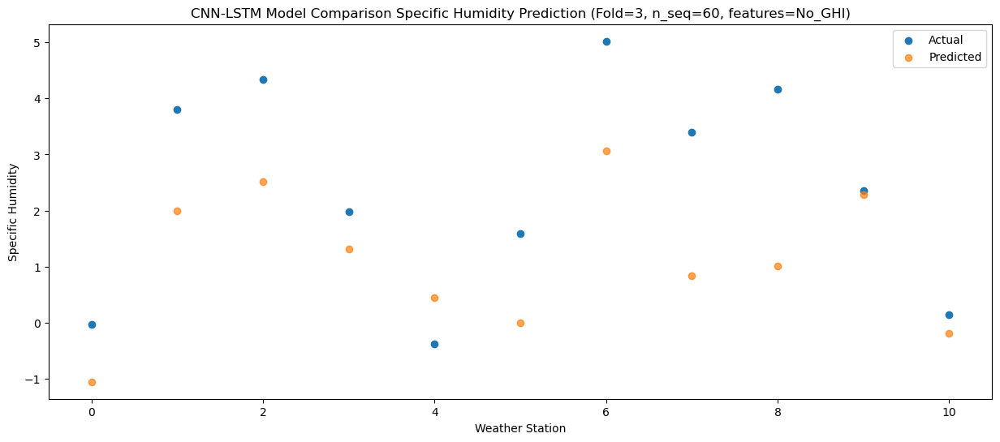

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01   0.354222
1                 1    5.34   3.864990
2                 2    5.02   1.952299
3                 3    3.89   3.001690
4                 4    1.45   2.319376
5                 5    3.84   1.818629
6                 6    5.70   3.137398
7                 7    3.10   0.471985
8                 8    4.60   0.296211
9                 9    3.27   3.614831
10               10    1.74   1.322414


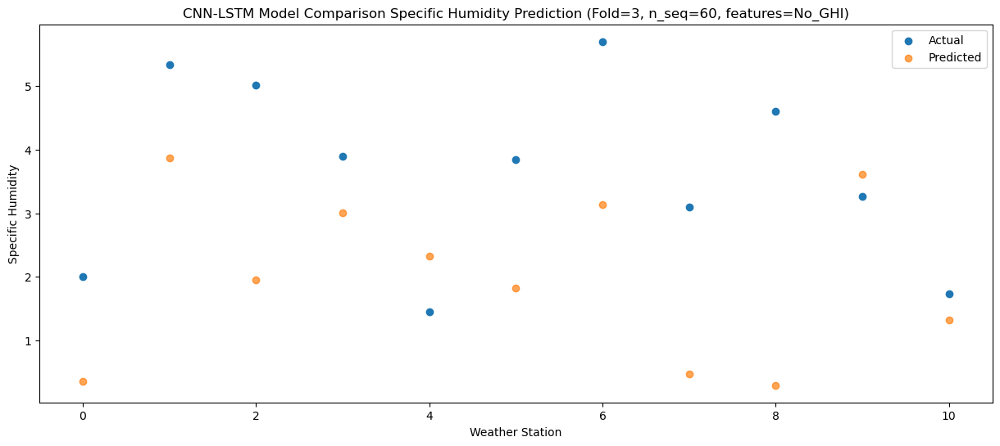

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88   3.894601
1                 1    9.84   7.321305
2                 2    4.89   2.711540
3                 3    8.00   6.464100
4                 4    5.59   5.738498
5                 5    7.51   5.274278
6                 6    6.59   4.512356
7                 7    2.97   1.298272
8                 8    4.76   1.099932
9                 9    6.73   6.533278
10               10    5.37   4.453482


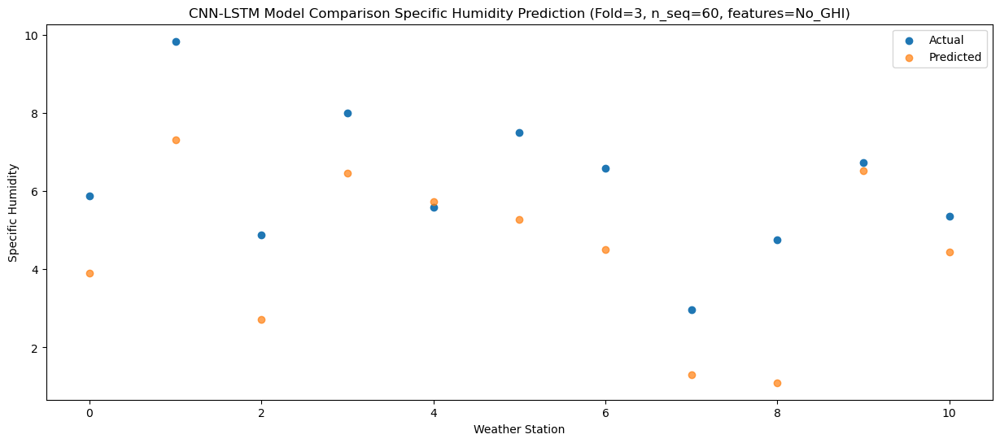

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61   5.999969
1                 1   12.12  10.102713
2                 2    6.16   5.085552
3                 3    9.80   8.912139
4                 4    7.56   8.512532
5                 5    9.33   7.904556
6                 6    8.88   7.093151
7                 7    4.37   3.844352
8                 8    5.91   3.264293
9                 9    9.60   9.000593
10               10    7.05   6.932908


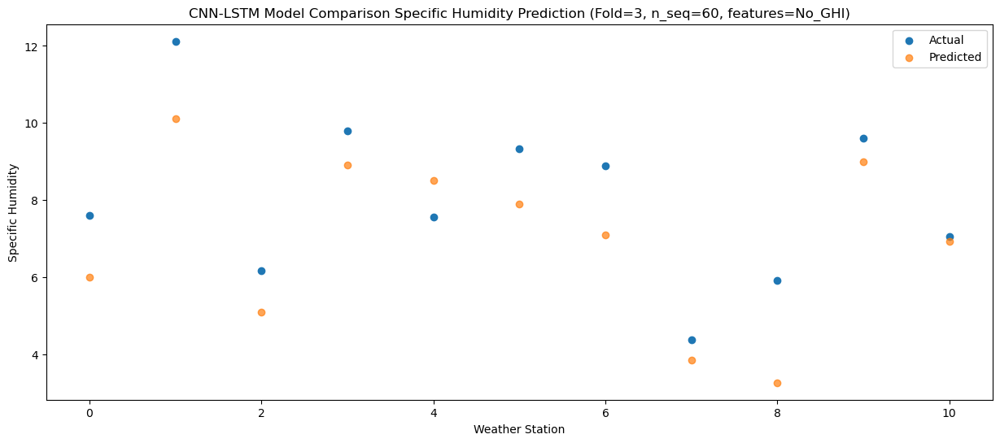

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47   8.101294
1                 1   12.61  10.894754
2                 2    8.14   5.797601
3                 3   10.70  10.809872
4                 4    9.13   9.880508
5                 5   10.52   9.562061
6                 6    8.93   7.848177
7                 7    5.40   4.428169
8                 8    7.49   4.109814
9                 9   12.77  10.980121
10               10    9.93   8.944778


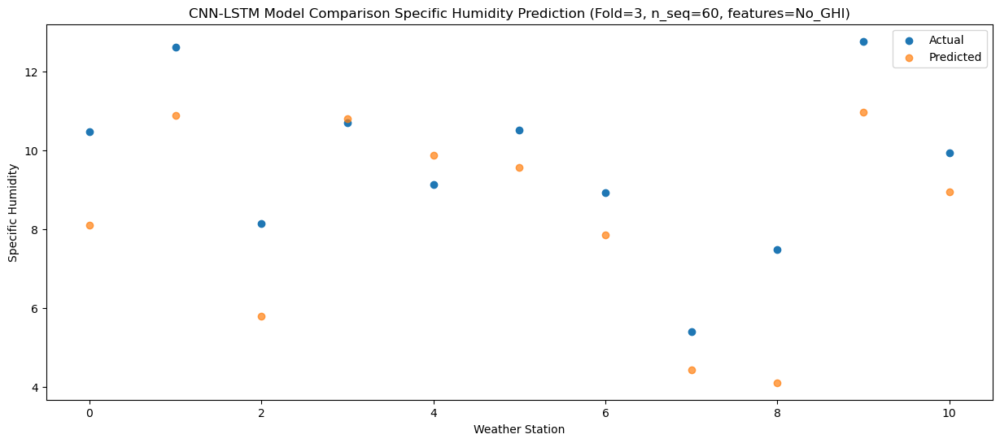

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03   6.910105
1                 1   11.87  10.069864
2                 2    6.45   6.017796
3                 3    9.38   9.596490
4                 4    8.65   8.860280
5                 5    9.96   8.417506
6                 6   10.39   7.823610
7                 7    6.22   4.654094
8                 8    6.76   4.318210
9                 9   11.42   9.875800
10               10    8.65   7.753087


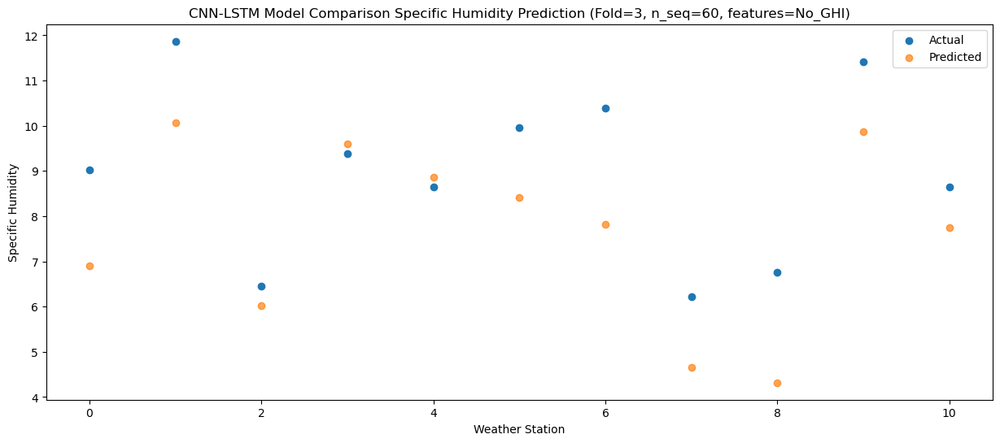

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32   5.705451
1                 1    8.88   8.126302
2                 2    6.72   5.780118
3                 3    7.84   7.935777
4                 4    5.64   6.843112
5                 5    7.34   6.534898
6                 6    7.97   7.065155
7                 7    4.50   4.165834
8                 8    6.44   4.346416
9                 9    8.06   8.415076
10               10    5.83   6.171658


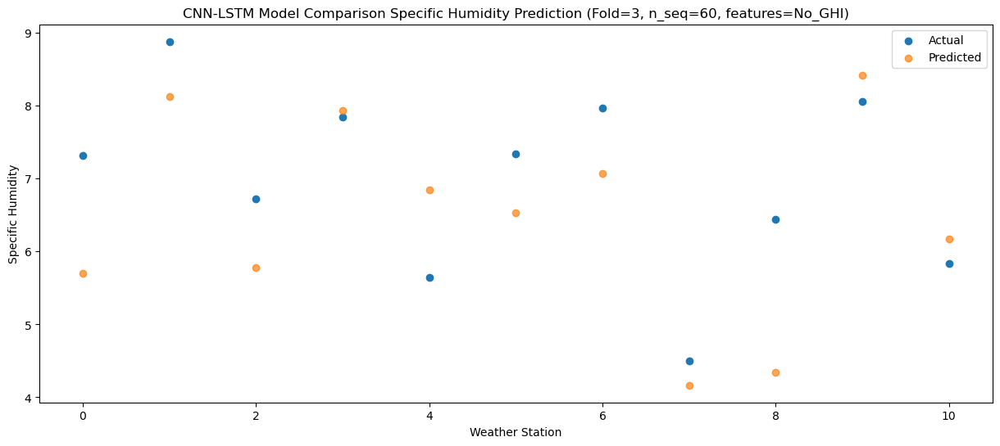

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50   1.224441
1                 1    4.65   3.834356
2                 2    5.61   3.897797
3                 3    4.09   3.494326
4                 4    1.28   2.505629
5                 5    3.47   2.122244
6                 6    6.21   4.622347
7                 7    3.45   2.223089
8                 8    4.85   2.429972
9                 9    4.96   4.421784
10               10    1.83   1.982652


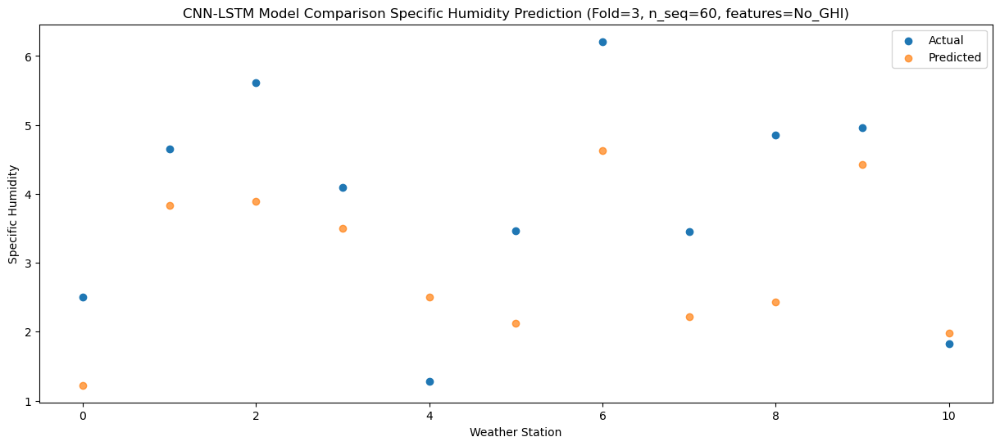

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

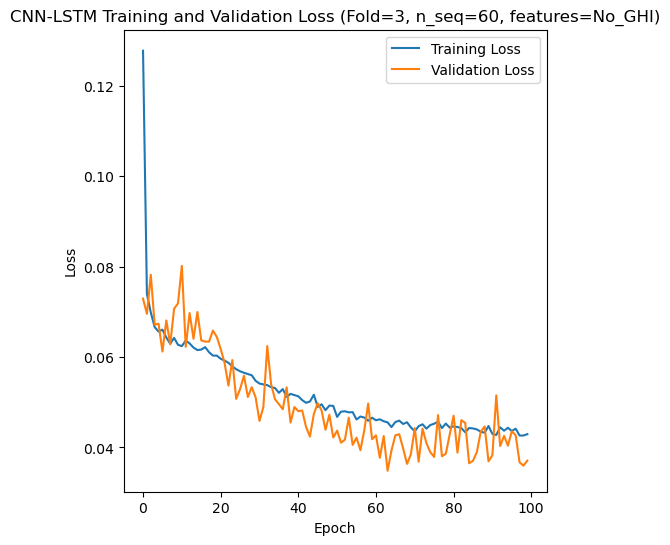

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 25s 109ms/step - loss: 0.1354 - accuracy: 0.2738 - mae: 0.1166 - rmse: 0.1354 - mape: 24.6108 - pearson: 0.5865 - val_loss: 0.0915 - val_accuracy: 0.7000 - val_mae: 0.0733 - val_rmse: 0.0915 - val_mape: 16.5734 - val_pearson: 0.6816
Epoch 2/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0754 - accuracy: 0.3571 - mae: 0.0594 - rmse: 0.0754 - mape: 13.3430 - pearson: 0.7374 - val_loss: 0.0722 - val_accuracy: 0.0000e+00 - val_mae: 0.0572 - val_rmse: 0.0722 - val_mape: 13.5426 - val_pearson: 0.7247
Epoch 3/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0729 - accuracy: 0.4048 - mae: 0.0578 - rmse: 0.0729 - mape: 12.9997 - pearson: 0.7546

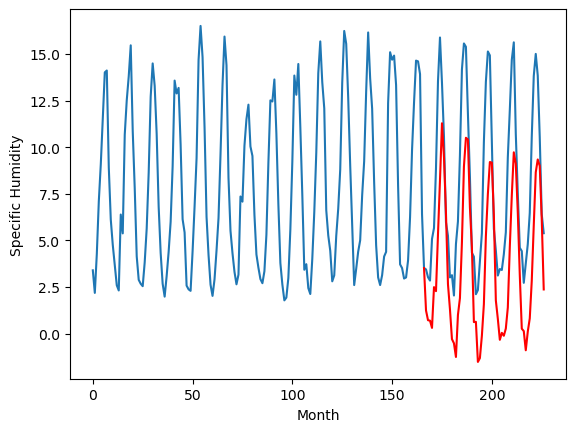

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		-0.94		0.94
-1.74		-0.92		0.82
-3.30		-1.08		2.22
-2.46		-1.13		1.33
-1.08		1.15		2.23
0.13		0.64		0.51
0.78		2.95		2.17
4.11		5.89		1.78
5.85		8.17		2.32
6.09		7.97		1.88
5.51		5.69		0.18
3.47		2.88		-0.59
0.41		-0.20		-0.61
-4.33		-2.81		1.52
-3.98		-2.98		1.00
-1.99		-2.80		-0.81
-2.02		-1.18		0.84
-1.27		-0.51		0.76
0.06		1.95		1.89
4.35		6.03		1.68
5.56		7.45		1.89
5.95		7.78		1.83
5.15		4.96		-0.19
2.23		2.78		0.55
-2.43		-1.82		0.61
-0.69		-0.29		0.40
-4.55		-3.58		0.97
-2.97		-2.80		0.17
-1.44		-1.72		-0.28
-0.15		-0.28		-0.13
2.24		3.25		1.01
5.14		5.03		-0.11
6.17		6.99		0.82
6.25		6.73		0.48
5.38		4.18		-1.20
0.60		-0.23		-0.83
0.77		-0.73		-1.50
-2.75		-2.14		0.61
-3.26		-1.73		1.53
-1.32		-1.25		0.07
-0.94		-1.25		-0.31
0.55		0.19		-0.36
1.35		2.13		0.78
4.86		4.74		-0.12
6.77		7.39		0.62
7.07		6.96		-0.11
4.62		4.29		-0.33
1.00		0.82		-0.18
-1.30		-1.98		-0.68
-2.39		-2.3

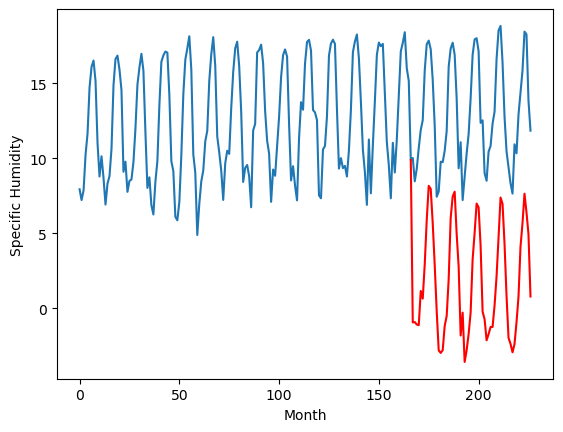

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		3.97		1.07
3.74		3.70		-0.04
3.60		3.71		0.11
3.41		3.56		0.15
6.96		6.52		-0.44
5.84		5.81		-0.03
8.08		8.54		0.46
11.38		11.46		0.08
14.31		14.09		-0.22
12.80		13.09		0.29
10.75		10.72		-0.03
7.40		7.20		-0.20
4.73		4.61		-0.12
2.35		2.01		-0.34
2.24		1.93		-0.31
2.12		1.77		-0.35
5.18		4.10		-1.08
5.43		4.73		-0.70
8.87		8.03		-0.84
13.11		12.00		-1.11
14.76		13.38		-1.38
14.77		13.36		-1.41
11.83		10.09		-1.74
9.05		7.67		-1.38
3.61		3.06		-0.55
6.56		4.82		-1.74
1.83		1.13		-0.70
2.68		1.79		-0.89
3.73		2.99		-0.74
6.18		5.11		-1.07
10.78		9.00		-1.78
13.16		11.07		-2.09
15.00		12.60		-2.40
14.82		12.37		-2.45
10.58		9.46		-1.12
5.62		4.59		-1.03
4.87		4.18		-0.69
4.33		2.92		-1.41
4.23		3.12		-1.11
4.90		3.80		-1.10
5.23		4.07		-1.16
6.07		5.14		-0.93
9.45		8.37		-1.08
13.02		11.09		-1.93
14.61		13.12		-1.49
13.03		12.74		-0.29
10.01		9.73		-0.28
6.08		6.02		-0.06
4.10		3.33		-0.7

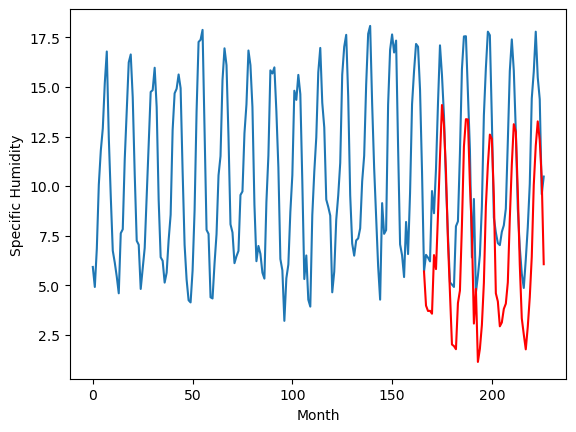

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		3.18		-0.02
2.20		2.64		0.44
2.84		2.74		-0.10
2.22		2.39		0.17
6.17		5.39		-0.78
5.77		4.85		-0.92
8.93		7.77		-1.16
11.09		10.41		-0.68
14.32		13.20		-1.12
11.73		11.48		-0.25
10.52		8.98		-1.54
5.95		4.99		-0.96
4.31		3.33		-0.98
1.71		1.30		-0.41
1.60		1.30		-0.30
1.28		0.72		-0.56
3.94		3.37		-0.57
5.23		4.04		-1.19
9.23		7.68		-1.55
12.92		11.34		-1.58
13.49		12.70		-0.79
13.88		12.36		-1.52
9.87		8.89		-0.98
7.02		6.45		-0.57
3.40		2.65		-0.75
5.26		3.61		-1.65
0.60		0.50		-0.10
1.13		0.76		-0.37
2.72		2.06		-0.66
6.23		4.36		-1.87
10.22		8.01		-2.21
11.99		10.37		-1.62
11.41		11.57		0.16
12.42		11.53		-0.89
9.14		8.62		-0.52
4.68		3.93		-0.75
4.50		3.15		-1.35
2.92		2.26		-0.66
2.23		2.35		0.12
2.59		2.75		0.16
4.65		3.35		-1.30
5.33		4.09		-1.24
9.59		8.26		-1.33
13.53		10.80		-2.73
13.38		12.26		-1.12
11.28		11.97		0.69
10.38		9.09		-1.29
6.66		5.62		-1.04
4.13		3.08		-1.05
2.

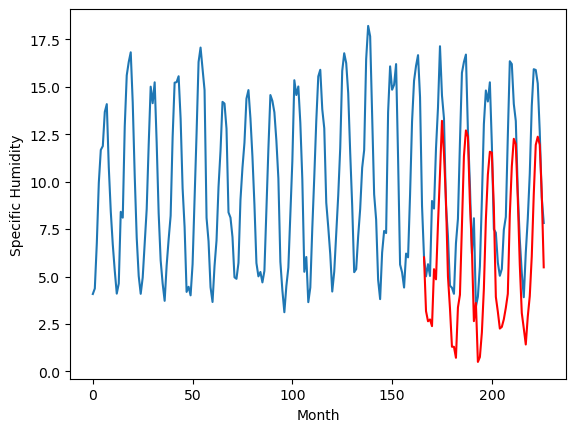

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		1.49		0.20
0.32		0.95		0.63
1.01		1.05		0.04
0.35		0.68		0.33
4.25		3.62		-0.63
3.74		3.13		-0.61
6.98		6.04		-0.94
8.96		8.63		-0.33
12.11		11.41		-0.70
9.46		9.66		0.20
8.57		7.15		-1.42
3.80		3.18		-0.62
2.44		1.61		-0.83
-0.13		-0.34		-0.21
-0.17		-0.33		-0.16
-0.62		-0.94		-0.32
1.96		1.68		-0.28
3.32		2.35		-0.97
7.61		5.96		-1.65
11.49		9.58		-1.91
11.87		10.94		-0.93
11.98		10.58		-1.40
8.08		7.14		-0.94
5.35		4.72		-0.63
1.74		1.05		-0.69
3.15		1.87		-1.28
-1.18		-1.11		0.07
-0.74		-0.89		-0.15
0.78		0.41		-0.37
4.46		2.66		-1.80
8.34		6.24		-2.10
10.02		8.61		-1.41
9.52		9.81		0.29
10.69		9.78		-0.91
7.54		6.92		-0.62
3.08		2.30		-0.78
2.66		1.45		-1.21
1.07		0.61		-0.46
0.32		0.70		0.38
0.72		1.05		0.33
2.69		1.68		-1.01
3.54		2.40		-1.14
7.81		6.58		-1.23
11.29		9.08		-2.21
10.39		10.50		0.11
9.01		10.24		1.23
8.68		7.41		-1.27
5.02		3.99		-1.03
2.60		1.47		-1.13
0.84		0.70	

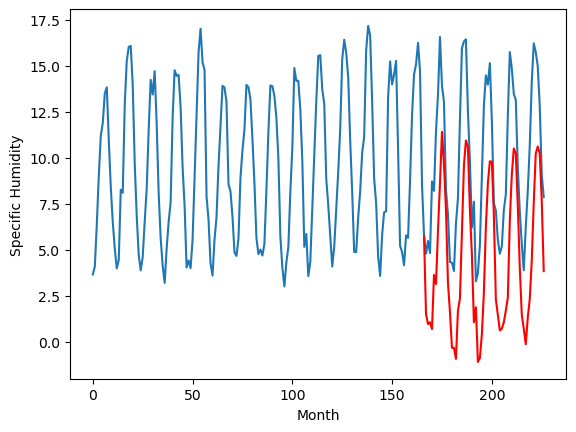

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		1.70		-0.93
1.39		1.30		-0.09
1.27		1.32		0.05
1.15		0.94		-0.21
3.95		3.31		-0.64
3.20		3.10		-0.10
5.47		5.58		0.11
7.18		7.78		0.60
8.41		10.14		1.73
7.10		8.83		1.73
6.91		6.62		-0.29
3.26		3.15		-0.11
2.80		1.68		-1.12
0.24		0.13		-0.11
0.94		0.17		-0.77
0.30		-0.33		-0.63
1.79		1.71		-0.08
2.75		2.37		-0.38
7.30		5.36		-1.94
9.60		8.63		-0.97
10.63		9.98		-0.65
10.35		9.63		-0.72
7.10		6.72		-0.38
4.05		4.50		0.45
2.33		1.71		-0.62
1.48		1.86		0.38
0.02		-0.38		-0.40
0.01		-0.32		-0.33
0.60		0.93		0.33
2.63		2.62		-0.01
4.89		5.49		0.60
7.74		7.78		0.04
8.43		9.06		0.63
10.42		9.13		-1.29
9.17		6.74		-2.43
5.66		2.90		-2.76
2.96		1.67		-1.29
2.32		1.10		-1.22
0.77		1.26		0.49
0.89		1.30		0.41
2.18		1.95		-0.23
2.15		2.65		0.50
6.99		6.27		-0.72
10.85		8.37		-2.48
8.52		9.71		1.19
7.66		9.62		1.96
8.17		7.20		-0.97
6.04		4.31		-1.73
3.74		1.91		-1.83
2.16		1.46		-0.70
0.89		0.84		-

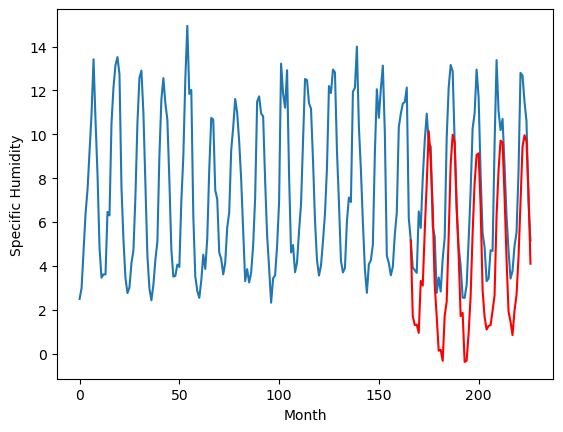

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-1.78		1.19
-2.90		-1.88		1.02
-3.06		-2.06		1.00
-2.48		-2.17		0.31
-0.29		-0.18		0.11
-0.96		-0.61		0.35
2.16		2.04		-0.12
5.99		5.27		-0.72
8.58		7.99		-0.59
8.79		7.34		-1.45
4.95		4.57		-0.38
2.30		1.56		-0.74
-0.53		-1.15		-0.62
-3.87		-3.51		0.36
-3.99		-3.85		0.14
-3.74		-3.92		-0.18
-2.03		-2.26		-0.23
-1.62		-1.38		0.24
1.36		0.97		-0.39
6.05		5.40		-0.65
7.65		6.97		-0.68
8.03		7.39		-0.64
4.45		4.14		-0.31
2.24		2.08		-0.16
-3.48		-2.89		0.59
-1.62		-1.88		-0.26
-4.60		-4.69		-0.09
-3.28		-3.96		-0.68
-2.44		-2.92		-0.48
-1.38		-1.61		-0.23
2.63		2.18		-0.45
4.91		4.00		-0.91
8.07		6.23		-1.84
6.88		5.99		-0.89
3.33		3.28		-0.05
-1.35		-1.33		0.02
-1.53		-1.88		-0.35
-3.52		-3.49		0.03
-2.89		-2.94		-0.05
-1.85		-2.79		-0.94
-2.36		-2.90		-0.54
-0.76		-1.25		-0.49
1.46		0.50		-0.96
4.51		3.41		-1.10
7.90		6.57		-1.33
7.44		5.80		-1.64
3.99		3.18		-0.81
0.08		-0.38		-0.46
-2

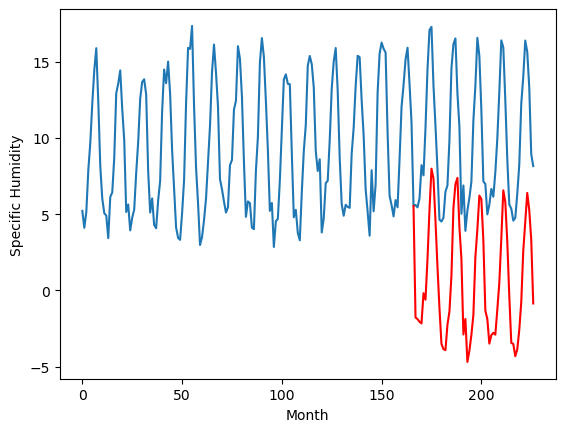

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		2.10		0.29
1.54		1.64		0.10
1.30		1.63		0.33
1.07		1.31		0.24
3.62		3.77		0.15
3.94		3.36		-0.58
7.32		6.34		-0.98
10.93		9.29		-1.64
12.98		12.27		-0.71
10.33		10.68		0.35
8.73		7.84		-0.89
4.18		4.09		-0.09
2.51		2.32		-0.19
0.58		0.37		-0.21
0.43		0.17		-0.26
-0.20		-0.39		-0.19
2.17		1.93		-0.24
3.09		2.78		-0.31
6.25		5.90		-0.35
10.85		9.98		-0.87
11.80		11.48		-0.32
11.54		11.43		-0.11
8.28		7.85		-0.43
6.19		5.61		-0.58
1.50		1.30		-0.20
2.97		1.93		-1.04
-0.23		-0.77		-0.54
0.28		-0.42		-0.70
1.79		0.78		-1.01
3.58		2.66		-0.92
8.29		6.44		-1.85
10.65		8.65		-2.00
11.45		10.32		-1.13
11.92		10.24		-1.68
8.11		7.36		-0.75
3.45		2.62		-0.83
2.09		1.85		-0.24
1.22		0.65		-0.57
1.50		0.97		-0.53
1.31		1.09		-0.22
2.07		1.41		-0.66
2.97		2.55		-0.42
7.36		5.81		-1.55
9.92		8.59		-1.33
12.71		10.85		-1.86
12.99		10.27		-2.72
8.79		7.52		-1.27
5.18		4.01		-1.17
2.15		1.17		-0.98
1.34	

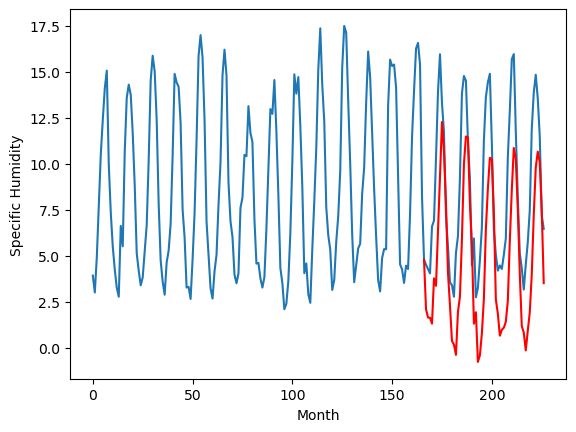

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		0.51		0.11
0.57		0.25		-0.32
0.20		0.04		-0.16
-0.20		-0.24		-0.04
1.72		1.16		-0.56
2.00		1.07		-0.93
5.15		3.90		-1.25
7.89		7.10		-0.79
11.11		10.14		-0.97
9.44		8.99		-0.45
6.52		5.79		-0.73
3.14		2.64		-0.50
1.46		0.72		-0.74
-0.14		-0.94		-0.80
-0.49		-1.43		-0.94
-1.06		-1.89		-0.83
0.88		-0.33		-1.21
2.21		0.78		-1.43
4.50		2.84		-1.66
9.56		7.37		-2.19
10.82		9.05		-1.77
10.96		9.47		-1.49
7.48		5.99		-1.49
6.33		4.12		-2.21
0.56		-0.48		-1.04
1.27		-0.65		-1.92
-1.11		-2.43		-1.32
-0.53		-2.01		-1.48
0.78		-0.98		-1.76
2.27		-0.02		-2.29
6.29		3.60		-2.69
7.73		5.52		-2.21
10.47		7.93		-2.54
10.11		7.86		-2.25
7.45		5.24		-2.21
2.12		0.85		-1.27
1.08		-0.07		-1.15
0.12		-1.61		-1.73
0.74		-0.93		-1.67
0.34		-1.38		-1.72
0.69		-1.45		-2.14
2.14		0.28		-1.86
4.39		1.91		-2.48
6.35		4.86		-1.49
10.65		8.28		-2.37
10.11		7.30		-2.81
7.31		5.00		-2.31
3.98		1.70		-2.28
0.91		-1.53	

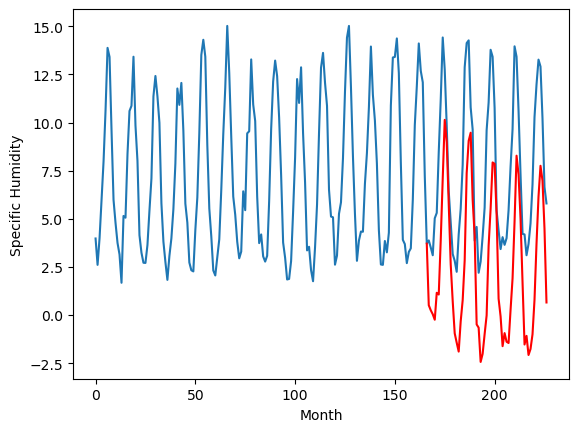

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		0.85		-0.10
1.12		0.47		-0.65
0.64		0.34		-0.30
0.37		0.01		-0.36
2.42		1.72		-0.70
3.01		1.58		-1.43
6.73		4.53		-2.20
9.21		7.66		-1.55
12.77		10.75		-2.02
10.58		9.31		-1.27
7.80		6.14		-1.66
3.64		2.71		-0.93
2.55		1.02		-1.53
0.64		-0.63		-1.27
0.32		-1.02		-1.34
-0.32		-1.61		-1.29
2.05		0.24		-1.81
3.36		1.28		-2.08
5.98		3.72		-2.26
10.73		8.12		-2.61
12.13		9.76		-2.37
12.38		9.99		-2.39
8.35		6.39		-1.96
6.48		4.42		-2.06
1.19		-0.04		-1.23
1.73		-0.13		-1.86
-0.51		-2.07		-1.56
0.19		-1.71		-1.90
1.71		-0.62		-2.33
3.01		0.64		-2.37
7.08		4.33		-2.75
9.32		6.39		-2.93
11.96		8.54		-3.42
11.19		8.48		-2.71
7.82		5.75		-2.07
3.06		1.22		-1.84
1.69		0.29		-1.40
0.58		-1.12		-1.70
1.10		-0.55		-1.65
0.87		-0.89		-1.76
1.48		-0.79		-2.27
2.99		0.72		-2.27
5.77		2.99		-2.78
7.41		5.89		-1.52
12.11		8.93		-3.18
11.98		8.07		-3.91
8.20		5.62		-2.58
4.76		2.25		-2.51
1.37		-0.86		-2.

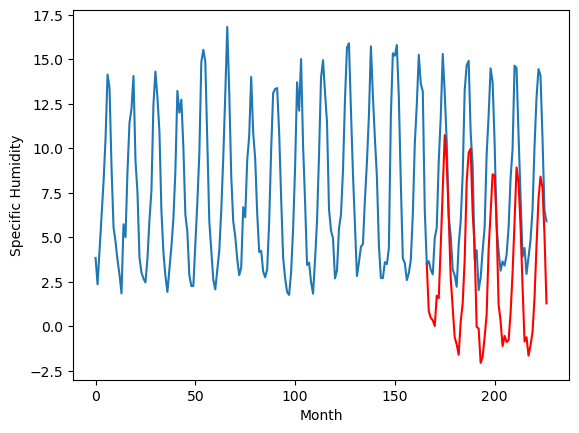

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		0.36		0.21
0.30		0.17		-0.13
-0.04		-0.09		-0.05
-0.39		-0.37		0.02
1.18		0.74		-0.44
1.02		0.72		-0.30
3.64		3.45		-0.19
6.83		6.68		-0.15
9.75		9.71		-0.04
8.33		8.70		0.37
6.19		5.47		-0.72
3.15		2.52		-0.63
1.22		0.53		-0.69
-0.11		-1.06		-0.95
-0.49		-1.62		-1.13
-1.06		-2.03		-0.97
0.23		-0.69		-0.92
1.90		0.48		-1.42
3.50		2.23		-1.27
8.51		6.84		-1.67
9.78		8.56		-1.22
10.65		9.12		-1.53
6.89		5.73		-1.16
5.88		3.95		-1.93
0.64		-0.64		-1.28
0.60		-1.02		-1.62
-1.14		-2.55		-1.41
-0.69		-2.14		-1.45
0.46		-1.17		-1.63
1.45		-0.48		-1.93
4.91		3.03		-1.88
6.82		4.85		-1.97
8.55		7.46		-1.09
9.01		7.42		-1.59
7.02		4.91		-2.11
2.20		0.72		-1.48
1.48		-0.26		-1.74
0.03		-1.88		-1.91
0.65		-1.11		-1.76
-0.10		-1.73		-1.63
0.11		-1.90		-2.01
1.81		0.00		-1.81
2.71		1.15		-1.56
5.95		4.14		-1.81
9.57		7.85		-1.72
8.77		6.75		-2.02
7.06		4.66		-2.40
4.00		1.46		-2.54
0.56		-1.86		-2.4

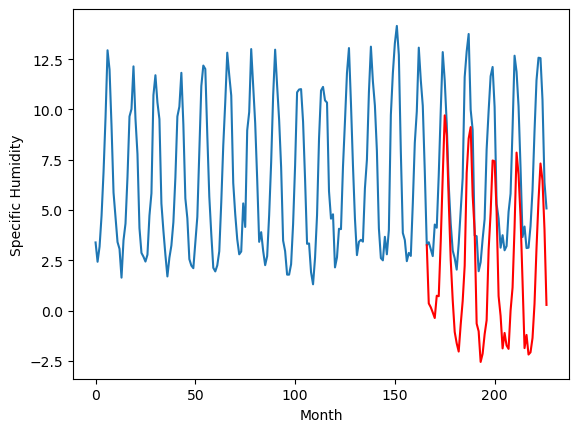

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95   1.249108
1                 1   -1.88  -0.942619
2                 2    2.90   3.969574
3                 3    3.20   3.178212
4                 4    1.29   1.494341
5                 5    2.63   1.701291
6                 6   -2.97  -1.776002
7                 7    1.81   2.095828
8                 8    0.40   0.513336
9                 9    0.95   0.847317
10               10    0.15   0.359167


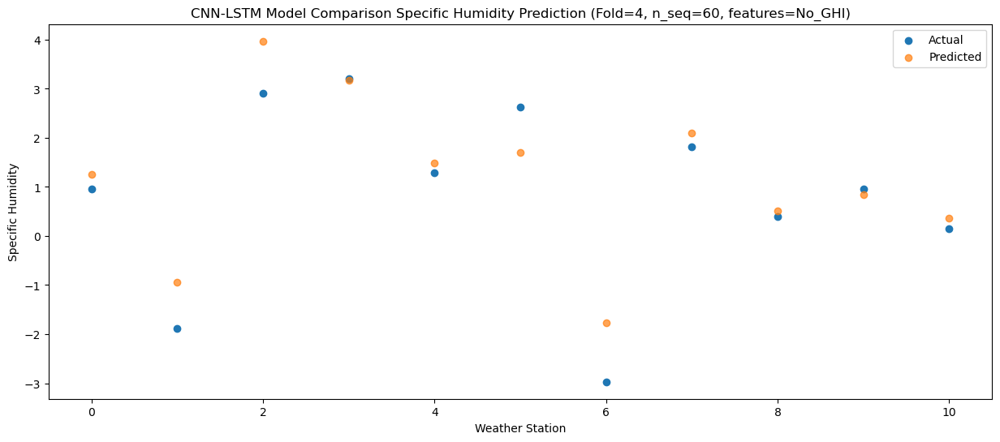

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.726049
1                 1   -1.74  -0.921207
2                 2    3.74   3.698391
3                 3    2.20   2.644035
4                 4    0.32   0.952188
5                 5    1.39   1.300282
6                 6   -2.90  -1.882234
7                 7    1.54   1.642344
8                 8    0.57   0.251189
9                 9    1.12   0.472491
10               10    0.30   0.169694


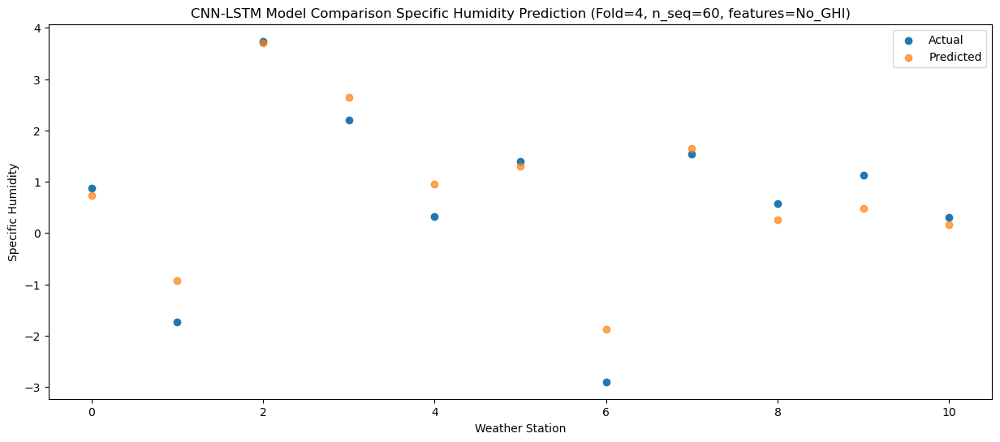

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46   0.702570
1                 1   -3.30  -1.083018
2                 2    3.60   3.707912
3                 3    2.84   2.739755
4                 4    1.01   1.049111
5                 5    1.27   1.322419
6                 6   -3.06  -2.055997
7                 7    1.30   1.628394
8                 8    0.20   0.044769
9                 9    0.64   0.335848
10               10   -0.04  -0.089145


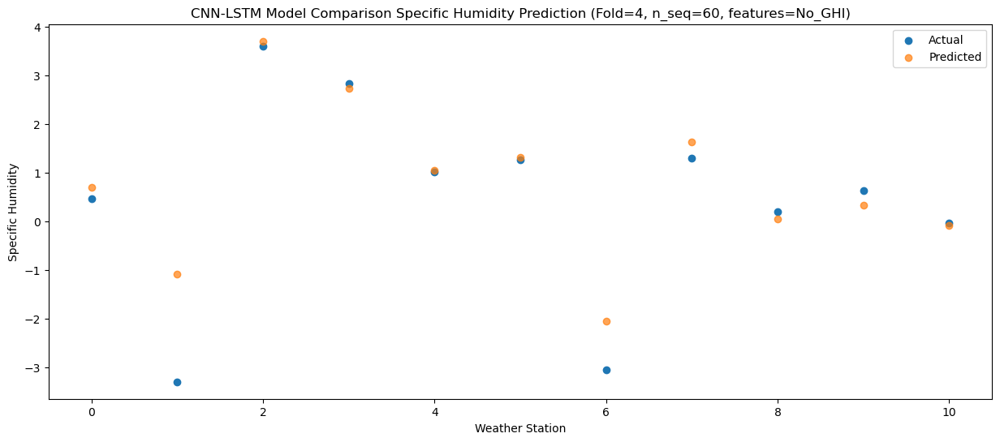

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28   0.315873
1                 1   -2.46  -1.128966
2                 2    3.41   3.560531
3                 3    2.22   2.388048
4                 4    0.35   0.681903
5                 5    1.15   0.944814
6                 6   -2.48  -2.167147
7                 7    1.07   1.306682
8                 8   -0.20  -0.239982
9                 9    0.37   0.010386
10               10   -0.39  -0.365518


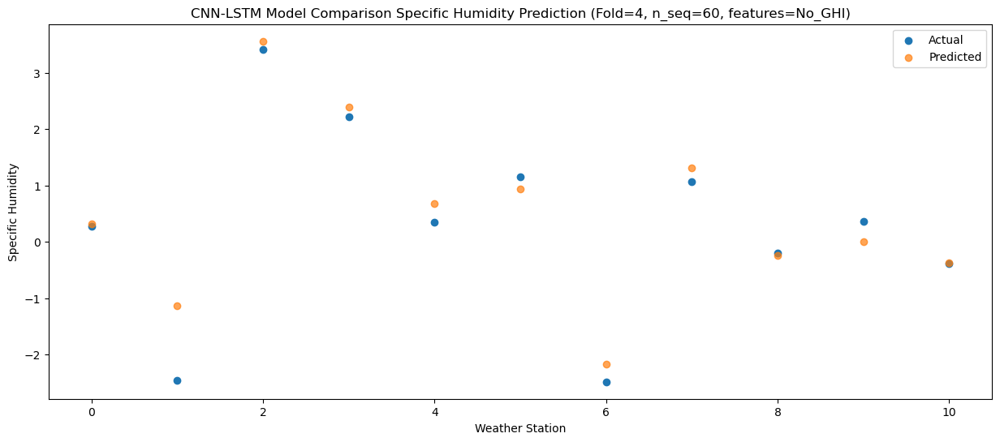

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   2.500682
1                 1   -1.08   1.153614
2                 2    6.96   6.518001
3                 3    6.17   5.387331
4                 4    4.25   3.621394
5                 5    3.95   3.313234
6                 6   -0.29  -0.181688
7                 7    3.62   3.769379
8                 8    1.72   1.160181
9                 9    2.42   1.715109
10               10    1.18   0.741101


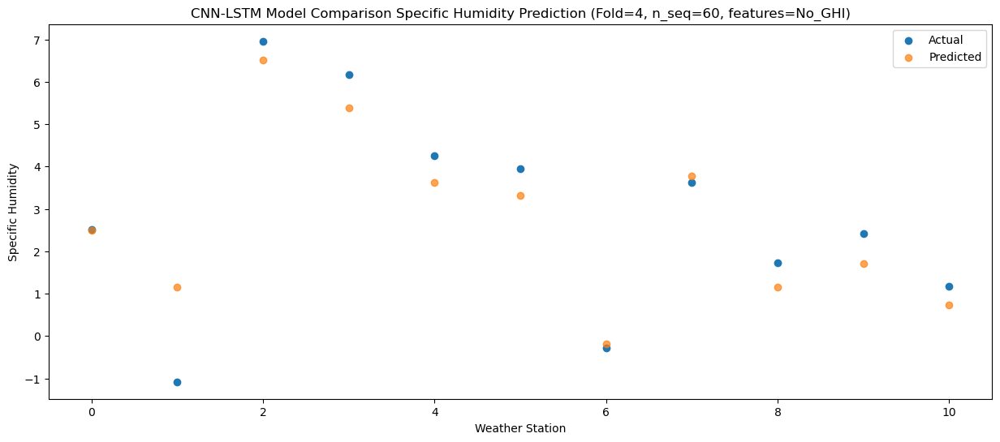

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   2.282362
1                 1    0.13   0.642961
2                 2    5.84   5.811807
3                 3    5.77   4.853989
4                 4    3.74   3.132426
5                 5    3.20   3.098579
6                 6   -0.96  -0.609821
7                 7    3.94   3.364347
8                 8    2.00   1.069434
9                 9    3.01   1.577264
10               10    1.02   0.718173


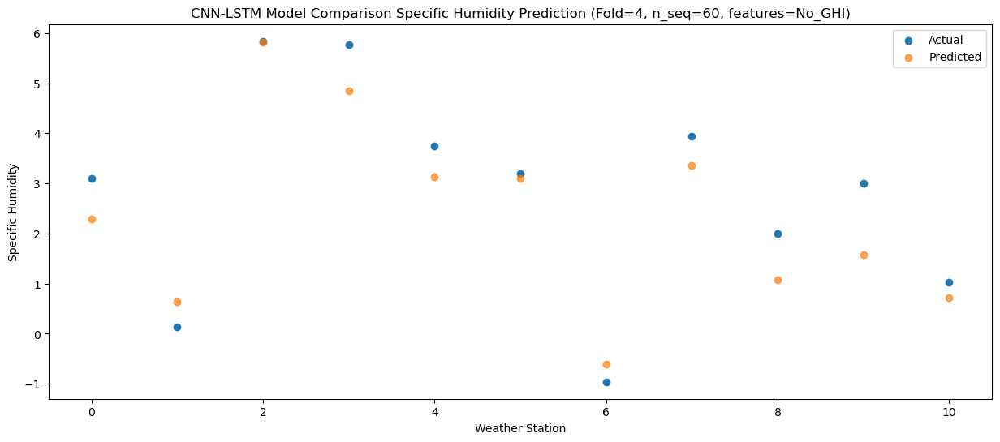

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   5.328902
1                 1    0.78   2.946056
2                 2    8.08   8.535346
3                 3    8.93   7.772436
4                 4    6.98   6.038472
5                 5    5.47   5.580345
6                 6    2.16   2.043682
7                 7    7.32   6.341284
8                 8    5.15   3.896441
9                 9    6.73   4.530135
10               10    3.64   3.454083


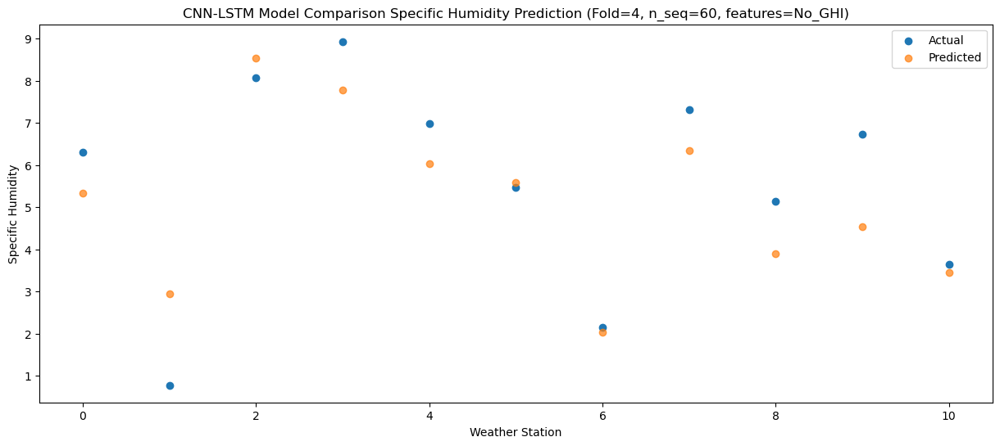

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   8.220646
1                 1    4.11   5.887941
2                 2   11.38  11.462965
3                 3   11.09  10.406941
4                 4    8.96   8.626449
5                 5    7.18   7.779295
6                 6    5.99   5.265505
7                 7   10.93   9.288156
8                 8    7.89   7.101845
9                 9    9.21   7.659306
10               10    6.83   6.678091


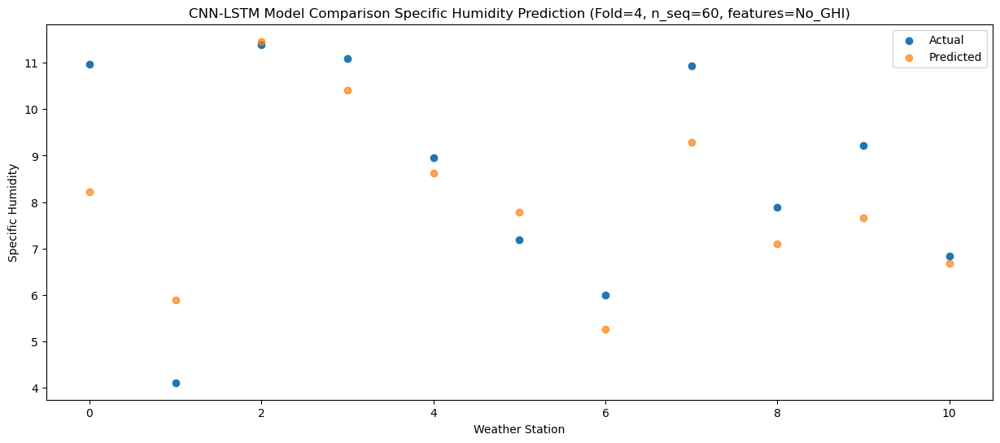

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31  11.282515
1                 1    5.85   8.170746
2                 2   14.31  14.089602
3                 3   14.32  13.201224
4                 4   12.11  11.405697
5                 5    8.41  10.140267
6                 6    8.58   7.990859
7                 7   12.98  12.267805
8                 8   11.11  10.140797
9                 9   12.77  10.746846
10               10    9.75   9.705047


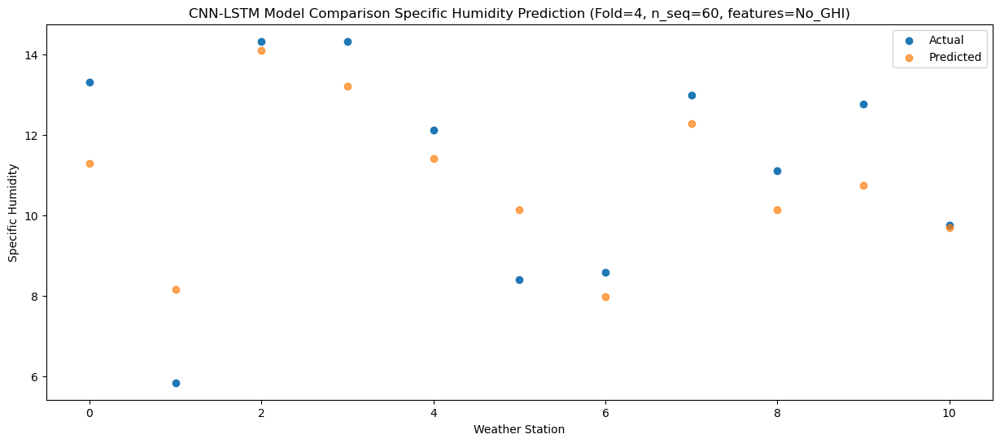

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88   9.469227
1                 1    6.09   7.965527
2                 2   12.80  13.092768
3                 3   11.73  11.479316
4                 4    9.46   9.656441
5                 5    7.10   8.828449
6                 6    8.79   7.342392
7                 7   10.33  10.682143
8                 8    9.44   8.985249
9                 9   10.58   9.306884
10               10    8.33   8.704138


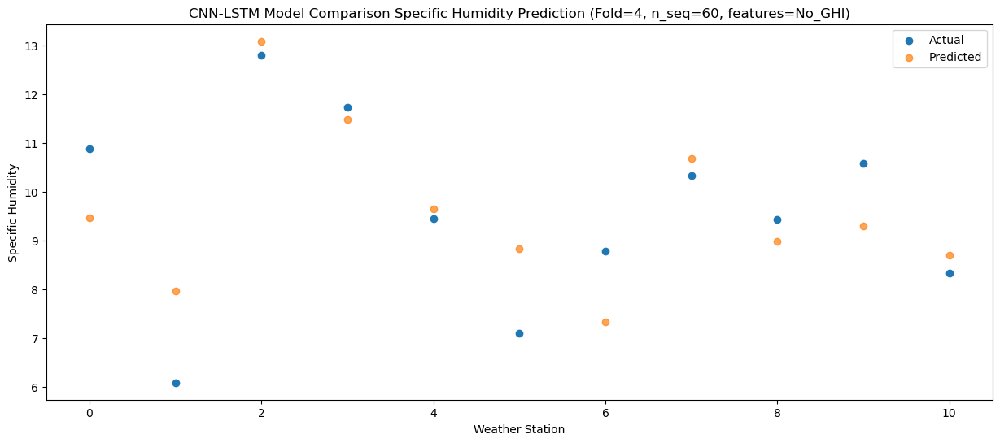

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   6.455853
1                 1    5.51   5.690331
2                 2   10.75  10.719000
3                 3   10.52   8.978368
4                 4    8.57   7.151023
5                 5    6.91   6.615868
6                 6    4.95   4.570582
7                 7    8.73   7.839167
8                 8    6.52   5.788241
9                 9    7.80   6.135726
10               10    6.19   5.472139


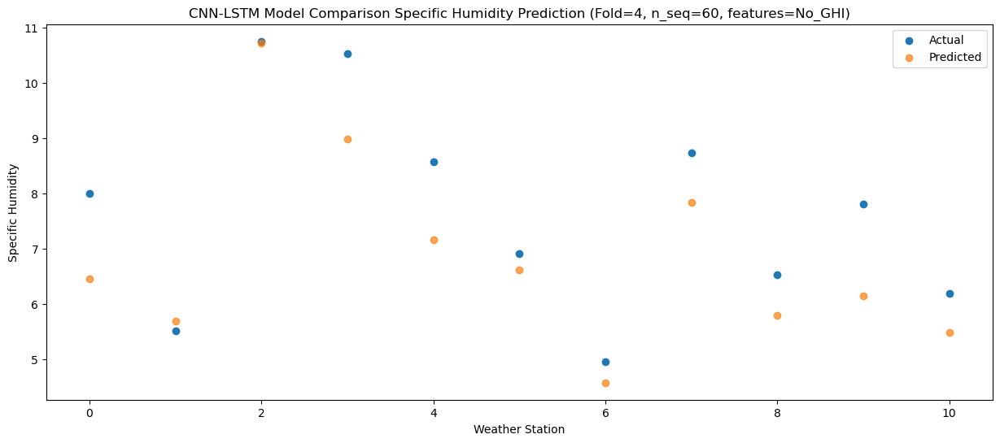

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   2.660673
1                 1    3.47   2.879075
2                 2    7.40   7.198409
3                 3    5.95   4.994982
4                 4    3.80   3.177072
5                 5    3.26   3.148307
6                 6    2.30   1.561607
7                 7    4.18   4.088185
8                 8    3.14   2.637344
9                 9    3.64   2.708880
10               10    3.15   2.521356


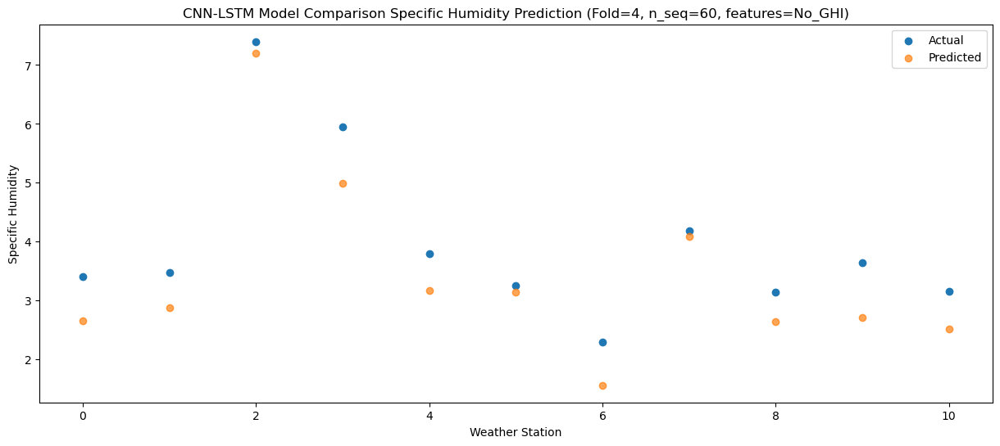

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   1.308438
1                 1    0.41  -0.198937
2                 2    4.73   4.613585
3                 3    4.31   3.333165
4                 4    2.44   1.606057
5                 5    2.80   1.682772
6                 6   -0.53  -1.152014
7                 7    2.51   2.318982
8                 8    1.46   0.721417
9                 9    2.55   1.020862
10               10    1.22   0.525109


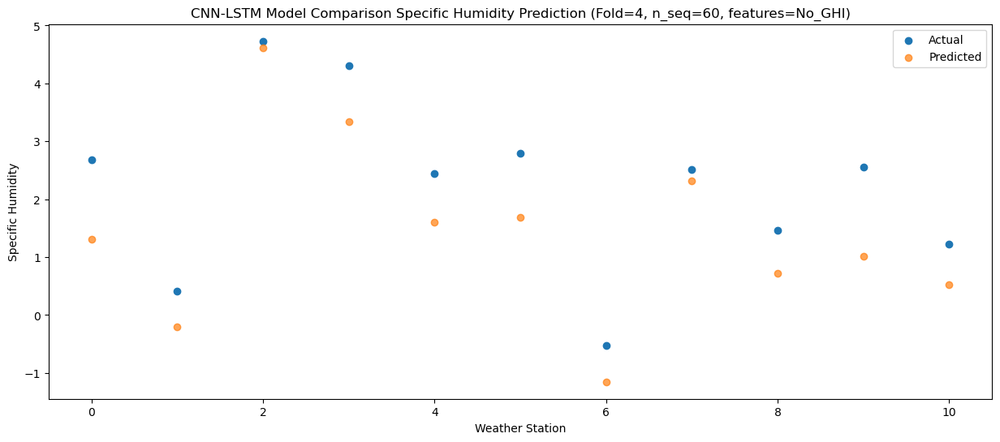

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45  -0.287457
1                 1   -4.33  -2.811560
2                 2    2.35   2.007379
3                 3    1.71   1.301657
4                 4   -0.13  -0.338620
5                 5    0.24   0.127795
6                 6   -3.87  -3.506432
7                 7    0.58   0.370095
8                 8   -0.14  -0.944964
9                 9    0.64  -0.627905
10               10   -0.11  -1.058331


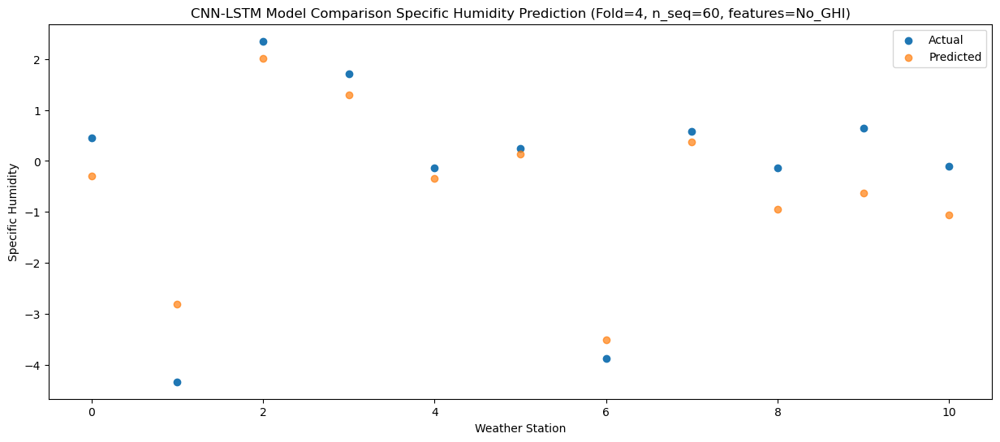

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57  -0.511134
1                 1   -3.98  -2.982038
2                 2    2.24   1.927712
3                 3    1.60   1.299143
4                 4   -0.17  -0.334932
5                 5    0.94   0.174038
6                 6   -3.99  -3.852628
7                 7    0.43   0.169143
8                 8   -0.49  -1.432150
9                 9    0.32  -1.024972
10               10   -0.49  -1.622410


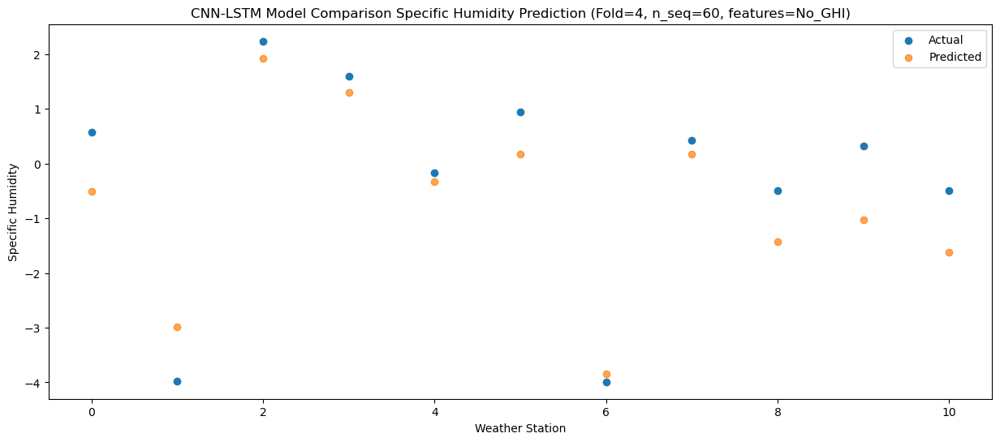

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52  -1.243675
1                 1   -1.99  -2.798031
2                 2    2.12   1.769618
3                 3    1.28   0.720411
4                 4   -0.62  -0.941284
5                 5    0.30  -0.329719
6                 6   -3.74  -3.921718
7                 7   -0.20  -0.388289
8                 8   -1.06  -1.893647
9                 9   -0.32  -1.609954
10               10   -1.06  -2.031437


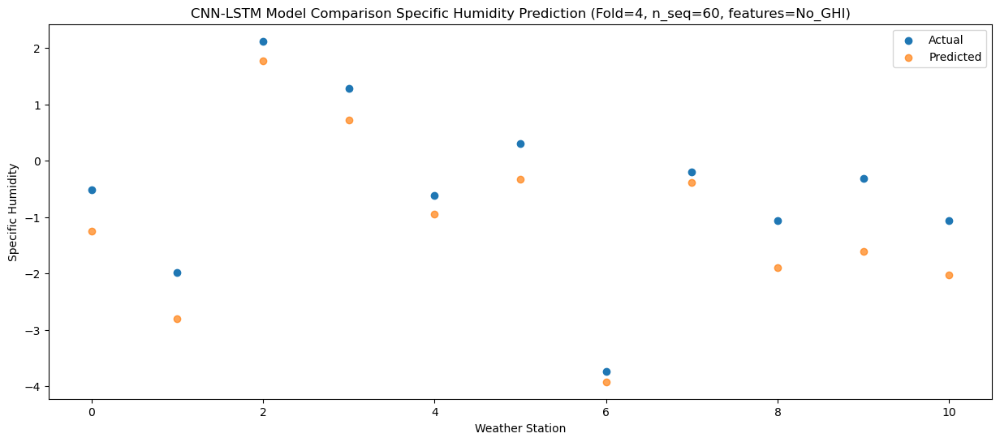

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24   1.010646
1                 1   -2.02  -1.180505
2                 2    5.18   4.099900
3                 3    3.94   3.371117
4                 4    1.96   1.679815
5                 5    1.79   1.714783
6                 6   -2.03  -2.255857
7                 7    2.17   1.934995
8                 8    0.88  -0.326505
9                 9    2.05   0.244949
10               10    0.23  -0.693547


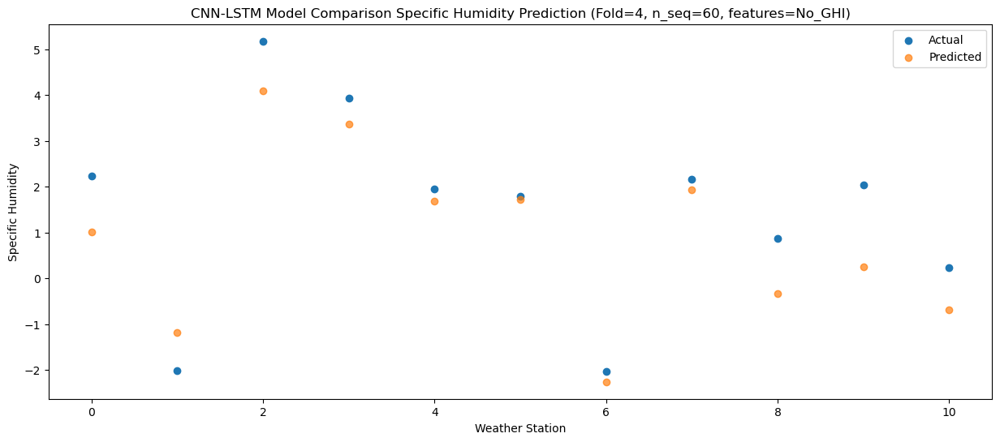

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45   1.910063
1                 1   -1.27  -0.511464
2                 2    5.43   4.728180
3                 3    5.23   4.036150
4                 4    3.32   2.350330
5                 5    2.75   2.366860
6                 6   -1.62  -1.383699
7                 7    3.09   2.776356
8                 8    2.21   0.777025
9                 9    3.36   1.280292
10               10    1.90   0.482059


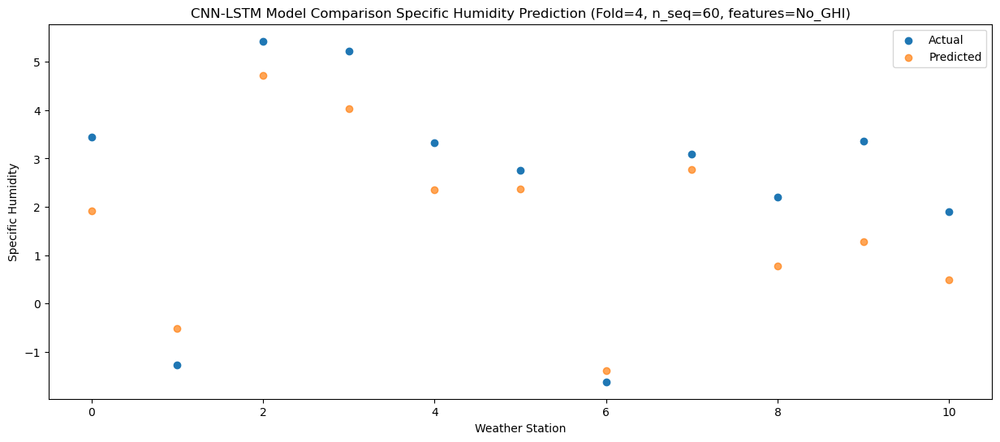

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01   4.906771
1                 1    0.06   1.945380
2                 2    8.87   8.031755
3                 3    9.23   7.676857
4                 4    7.61   5.957414
5                 5    7.30   5.361947
6                 6    1.36   0.969074
7                 7    6.25   5.902526
8                 8    4.50   2.844654
9                 9    5.98   3.723086
10               10    3.50   2.230135


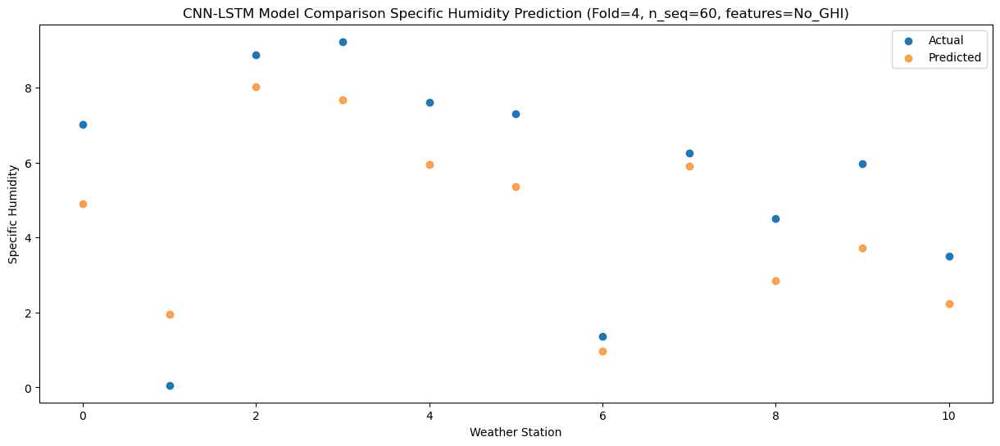

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60   8.960842
1                 1    4.35   6.027529
2                 2   13.11  11.997550
3                 3   12.92  11.339825
4                 4   11.49   9.579415
5                 5    9.60   8.630452
6                 6    6.05   5.399096
7                 7   10.85   9.983602
8                 8    9.56   7.371923
9                 9   10.73   8.116970
10               10    8.51   6.839933


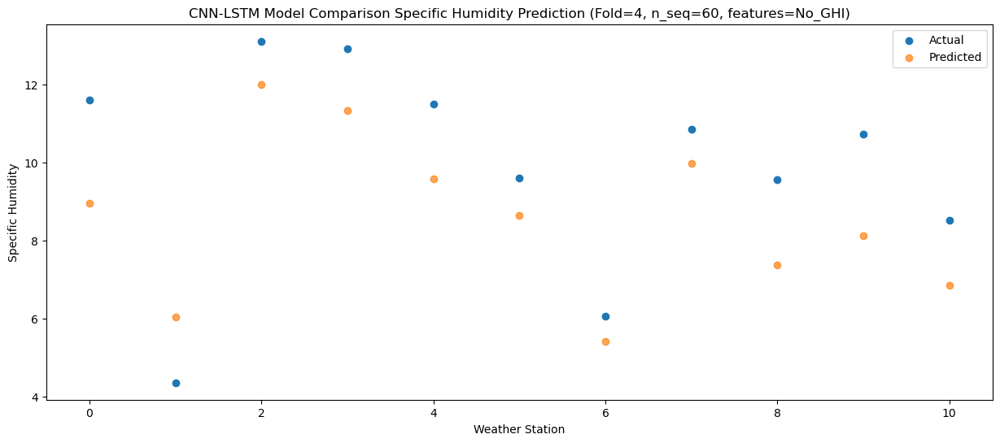

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99  10.504603
1                 1    5.56   7.451298
2                 2   14.76  13.375993
3                 3   13.49  12.698545
4                 4   11.87  10.941661
5                 5   10.63   9.977391
6                 6    7.65   6.968740
7                 7   11.80  11.479214
8                 8   10.82   9.053266
9                 9   12.13   9.755285
10               10    9.78   8.556178


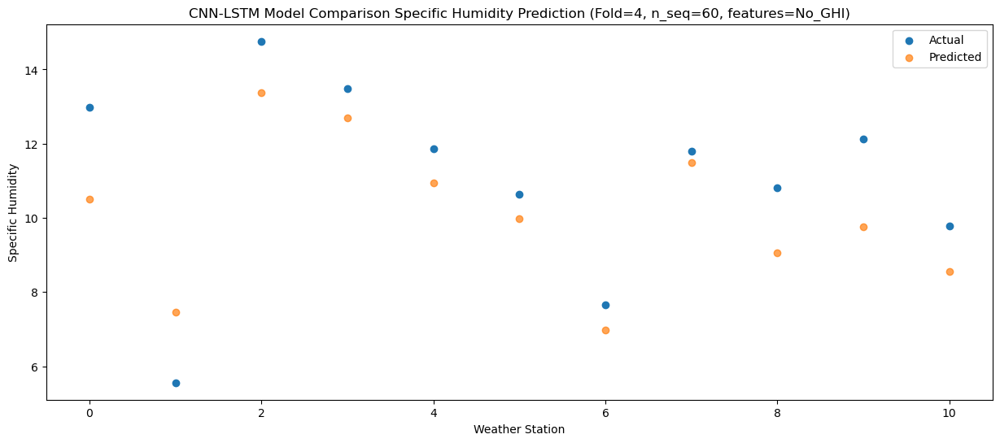

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81  10.416294
1                 1    5.95   7.780761
2                 2   14.77  13.360120
3                 3   13.88  12.357879
4                 4   11.98  10.580593
5                 5   10.35   9.631819
6                 6    8.03   7.386773
7                 7   11.54  11.433273
8                 8   10.96   9.472546
9                 9   12.38   9.989600
10               10   10.65   9.121373


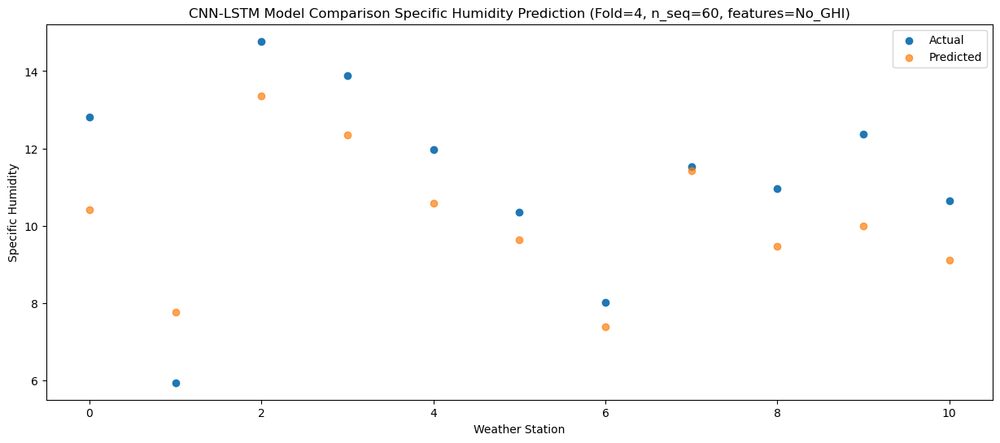

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23   6.779814
1                 1    5.15   4.964767
2                 2   11.83  10.088451
3                 3    9.87   8.892262
4                 4    8.08   7.140732
5                 5    7.10   6.721224
6                 6    4.45   4.144883
7                 7    8.28   7.850035
8                 8    7.48   5.989145
9                 9    8.35   6.393493
10               10    6.89   5.727458


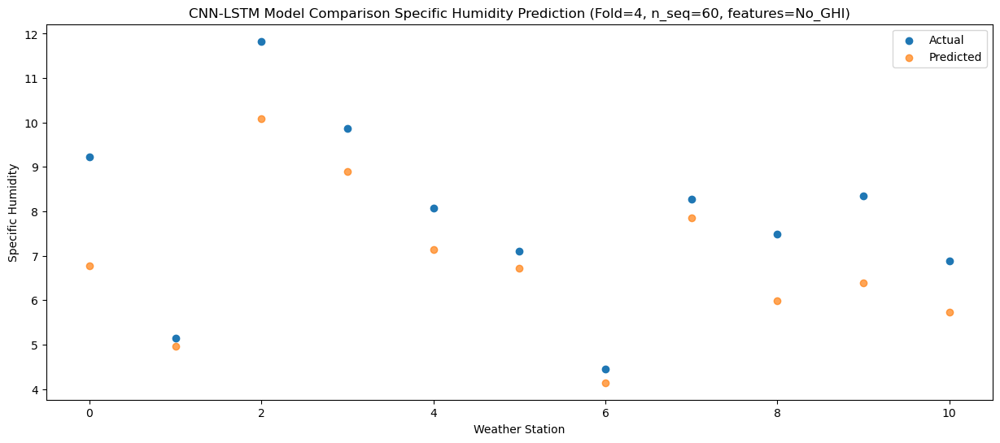

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86   4.635598
1                 1    2.23   2.775045
2                 2    9.05   7.666138
3                 3    7.02   6.452646
4                 4    5.35   4.723787
5                 5    4.05   4.501129
6                 6    2.24   2.075117
7                 7    6.19   5.606952
8                 8    6.33   4.124226
9                 9    6.48   4.421061
10               10    5.88   3.953969


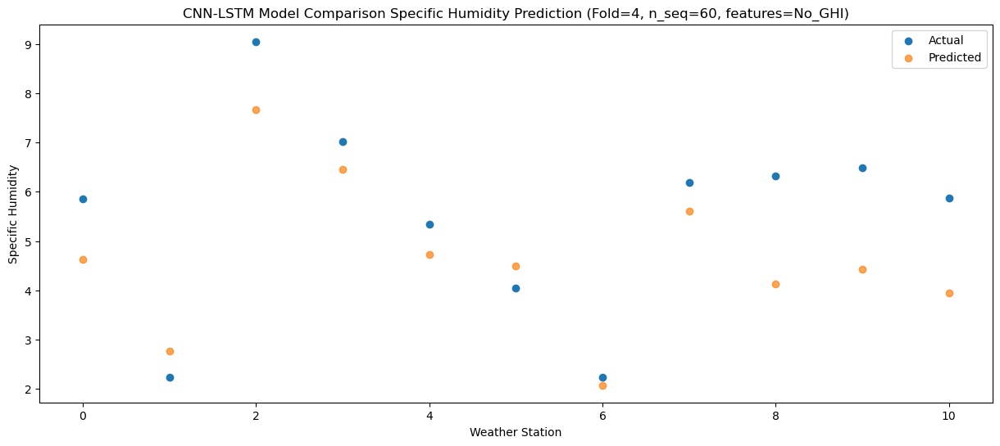

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77   0.624848
1                 1   -2.43  -1.817748
2                 2    3.61   3.063260
3                 3    3.40   2.649570
4                 4    1.74   1.048812
5                 5    2.33   1.710394
6                 6   -3.48  -2.888773
7                 7    1.50   1.302581
8                 8    0.56  -0.484434
9                 9    1.19  -0.041857
10               10    0.64  -0.644192


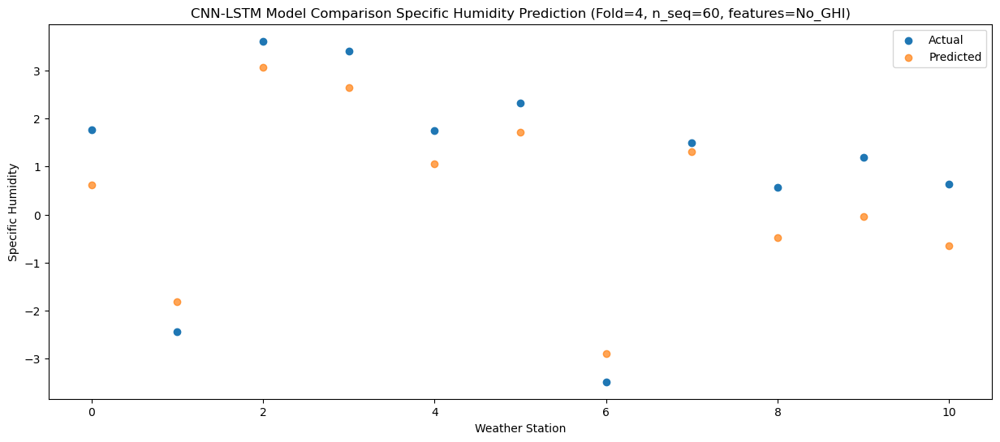

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56   0.641365
1                 1   -0.69  -0.289743
2                 2    6.56   4.816781
3                 3    5.26   3.608127
4                 4    3.15   1.866706
5                 5    1.48   1.855896
6                 6   -1.62  -1.875400
7                 7    2.97   1.926058
8                 8    1.27  -0.652120
9                 9    1.73  -0.128967
10               10    0.60  -1.024257


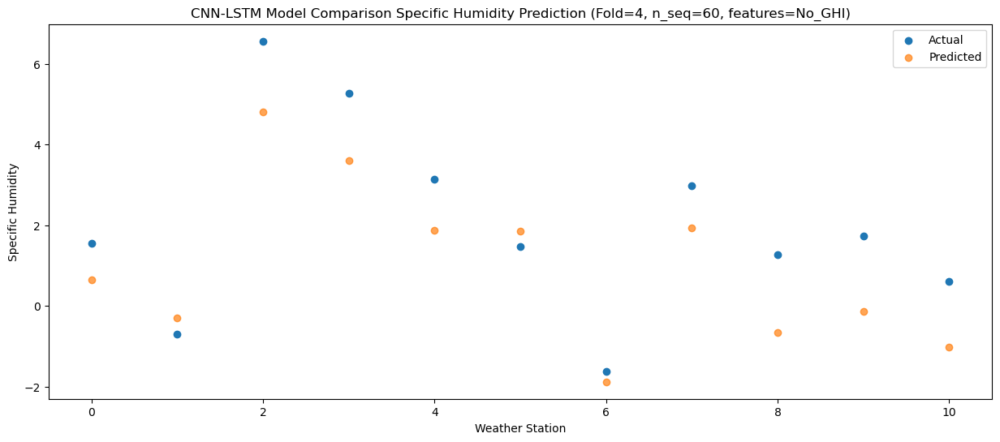

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -1.509355
1                 1   -4.55  -3.580093
2                 2    1.83   1.128307
3                 3    0.60   0.502636
4                 4   -1.18  -1.107391
5                 5    0.02  -0.380308
6                 6   -4.60  -4.693628
7                 7   -0.23  -0.773218
8                 8   -1.11  -2.430968
9                 9   -0.51  -2.065362
10               10   -1.14  -2.547540


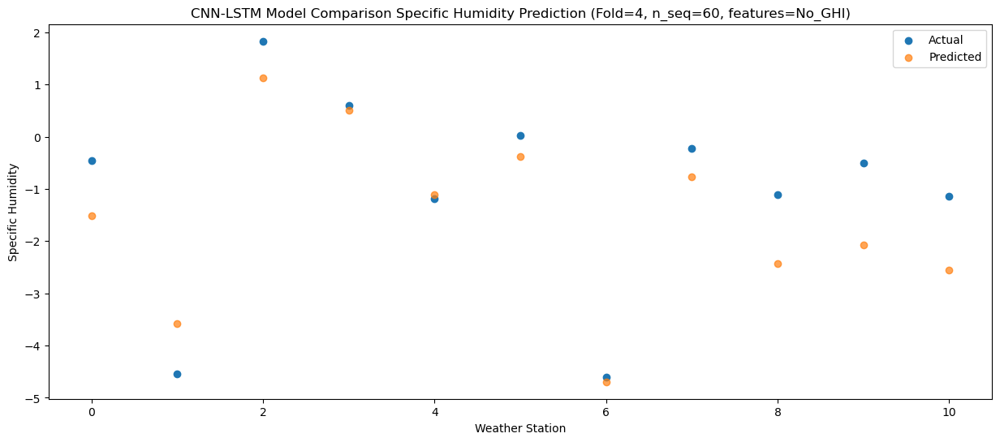

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23  -1.304753
1                 1   -2.97  -2.800381
2                 2    2.68   1.788965
3                 3    1.13   0.760151
4                 4   -0.74  -0.893133
5                 5    0.01  -0.321963
6                 6   -3.28  -3.961341
7                 7    0.28  -0.417464
8                 8   -0.53  -2.009536
9                 9    0.19  -1.714626
10               10   -0.69  -2.137615


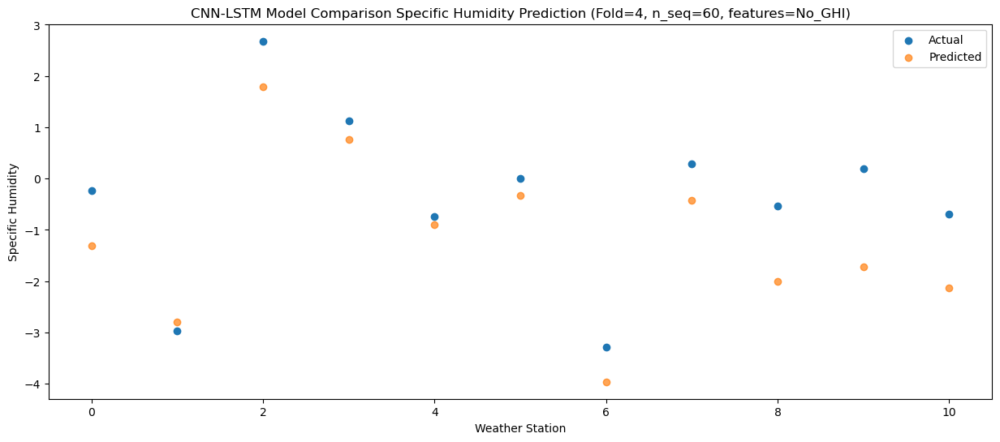

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33  -0.106087
1                 1   -1.44  -1.717073
2                 2    3.73   2.988267
3                 3    2.72   2.060697
4                 4    0.78   0.408104
5                 5    0.60   0.934179
6                 6   -2.44  -2.922142
7                 7    1.79   0.784328
8                 8    0.78  -0.982542
9                 9    1.71  -0.620210
10               10    0.46  -1.172915


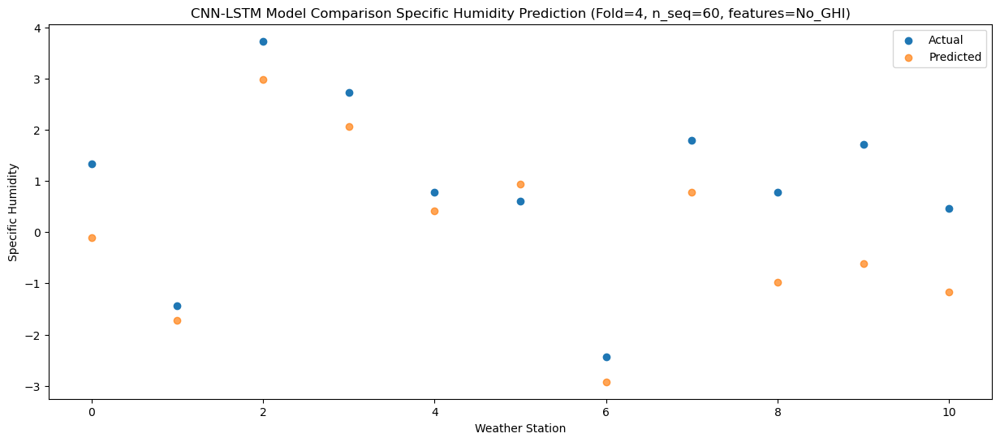

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82   1.585170
1                 1   -0.15  -0.279927
2                 2    6.18   5.112989
3                 3    6.23   4.356134
4                 4    4.46   2.658279
5                 5    2.63   2.616286
6                 6   -1.38  -1.612955
7                 7    3.58   2.655222
8                 8    2.27  -0.016883
9                 9    3.01   0.642411
10               10    1.45  -0.478306


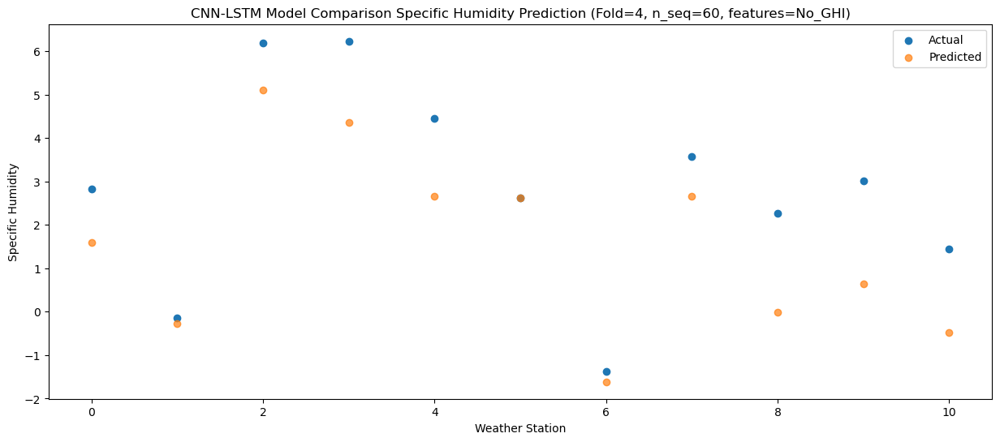

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70   5.219663
1                 1    2.24   3.251791
2                 2   10.78   8.995890
3                 3   10.22   8.006692
4                 4    8.34   6.235094
5                 5    4.89   5.488757
6                 6    2.63   2.182239
7                 7    8.29   6.441060
8                 8    6.29   3.604785
9                 9    7.08   4.328828
10               10    4.91   3.027377


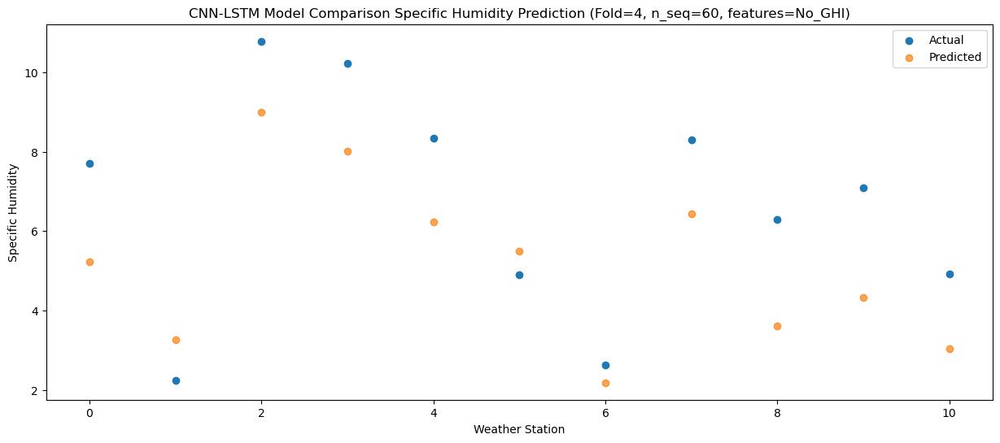

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93   7.490023
1                 1    5.14   5.025868
2                 2   13.16  11.066397
3                 3   11.99  10.366739
4                 4   10.02   8.611335
5                 5    7.74   7.783619
6                 6    4.91   3.995050
7                 7   10.65   8.645830
8                 8    7.73   5.524355
9                 9    9.32   6.387880
10               10    6.82   4.851322


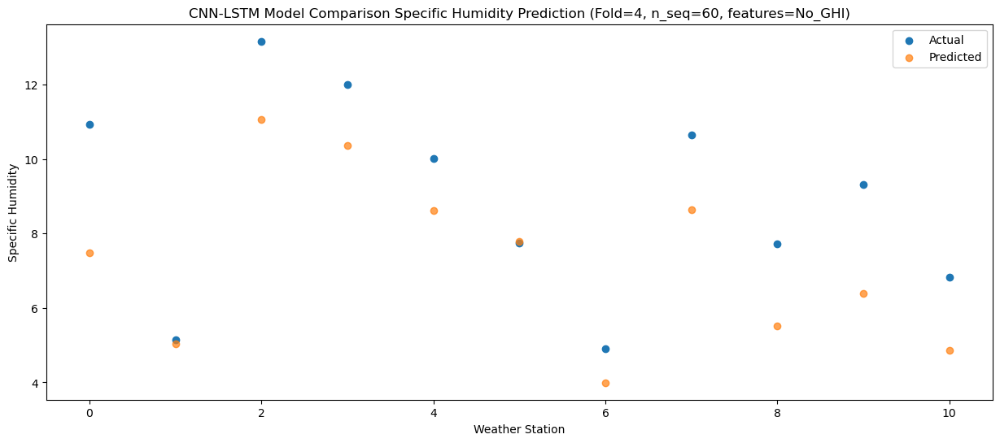

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56   9.205397
1                 1    6.17   6.986972
2                 2   15.00  12.598882
3                 3   11.41  11.572054
4                 4    9.52   9.808732
5                 5    8.43   9.058022
6                 6    8.07   6.225207
7                 7   11.45  10.321507
8                 8   10.47   7.929845
9                 9   11.96   8.542764
10               10    8.55   7.462542


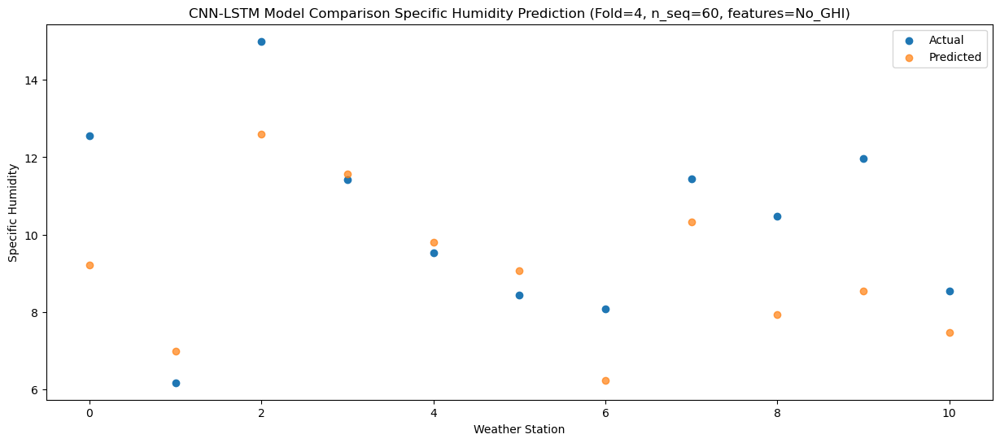

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35   9.173904
1                 1    6.25   6.730453
2                 2   14.82  12.371177
3                 3   12.42  11.525806
4                 4   10.69   9.780149
5                 5   10.42   9.130592
6                 6    6.88   5.992877
7                 7   11.92  10.239041
8                 8   10.11   7.860247
9                 9   11.19   8.476746
10               10    9.01   7.423192


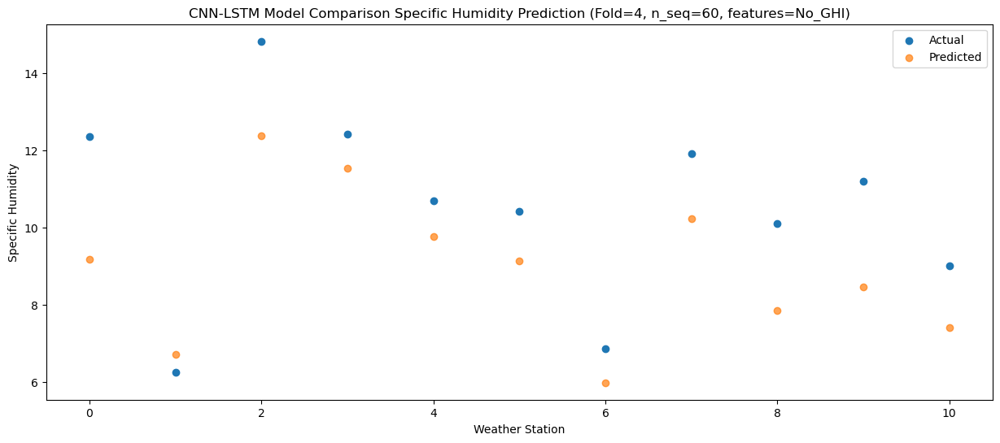

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65   6.364813
1                 1    5.38   4.183354
2                 2   10.58   9.464441
3                 3    9.14   8.624462
4                 4    7.54   6.916758
5                 5    9.17   6.740581
6                 6    3.33   3.280958
7                 7    8.11   7.359157
8                 8    7.45   5.237732
9                 9    7.82   5.750388
10               10    7.02   4.907996


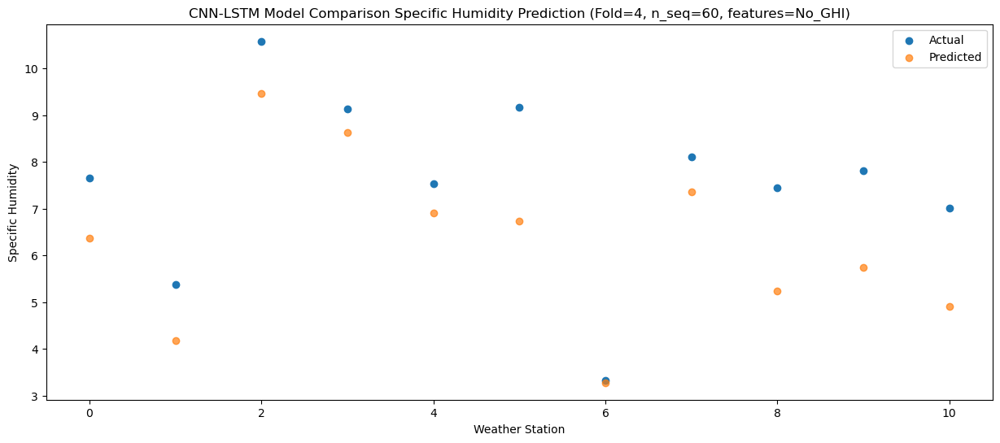

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   1.785191
1                 1    0.60  -0.230887
2                 2    5.62   4.590153
3                 3    4.68   3.927373
4                 4    3.08   2.296867
5                 5    5.66   2.898807
6                 6   -1.35  -1.333132
7                 7    3.45   2.622218
8                 8    2.12   0.853272
9                 9    3.06   1.221249
10               10    2.20   0.723208


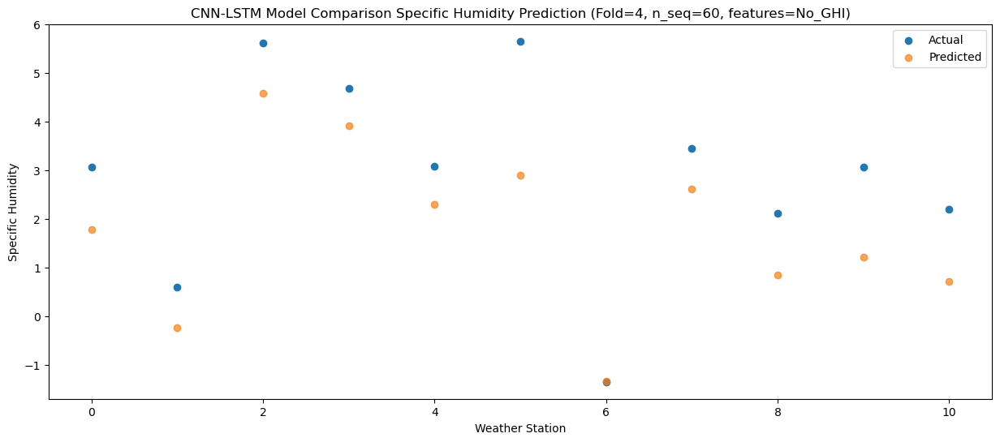

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   0.793283
1                 1    0.77  -0.732817
2                 2    4.87   4.178600
3                 3    4.50   3.145988
4                 4    2.66   1.450603
5                 5    2.96   1.673096
6                 6   -1.53  -1.880309
7                 7    2.09   1.853793
8                 8    1.08  -0.069887
9                 9    1.69   0.290382
10               10    1.48  -0.256572


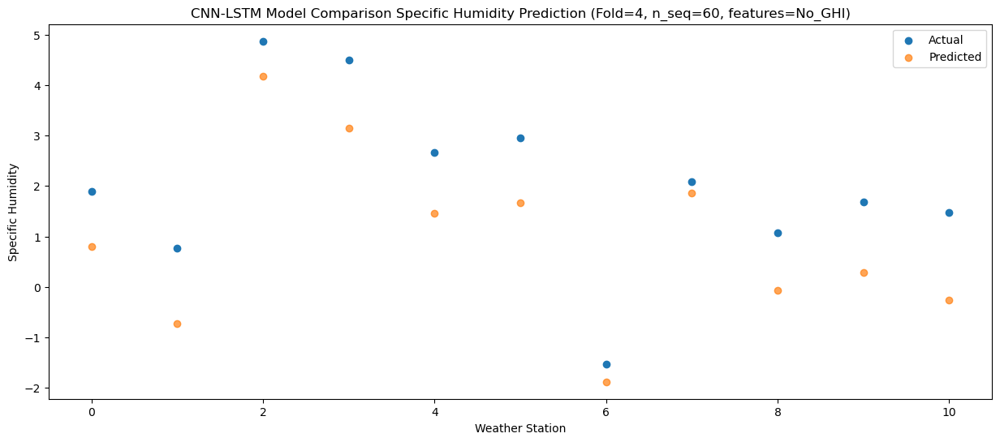

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55  -0.325122
1                 1   -2.75  -2.136938
2                 2    4.33   2.924798
3                 3    2.92   2.259616
4                 4    1.07   0.607555
5                 5    2.32   1.095884
6                 6   -3.52  -3.489754
7                 7    1.22   0.653654
8                 8    0.12  -1.612290
9                 9    0.58  -1.117289
10               10    0.03  -1.875204


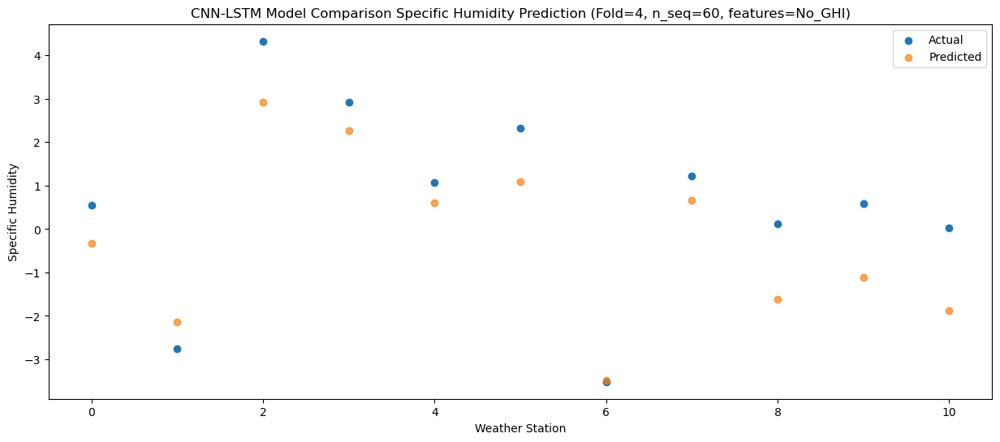

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90   0.048856
1                 1   -3.26  -1.727648
2                 2    4.23   3.117734
3                 3    2.23   2.348439
4                 4    0.32   0.700321
5                 5    0.77   1.259466
6                 6   -2.89  -2.938641
7                 7    1.50   0.972665
8                 8    0.74  -0.933428
9                 9    1.10  -0.545790
10               10    0.65  -1.107516


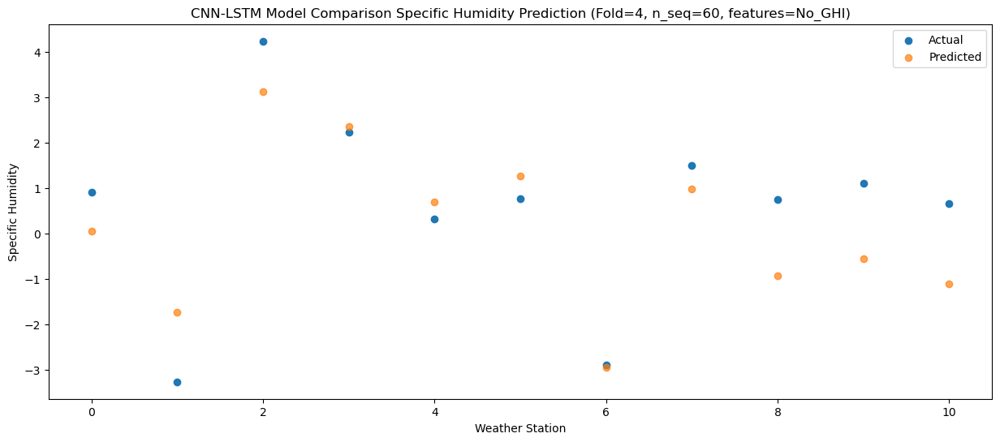

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85  -0.107465
1                 1   -1.32  -1.250064
2                 2    4.90   3.804197
3                 3    2.59   2.749253
4                 4    0.72   1.047608
5                 5    0.89   1.299532
6                 6   -1.85  -2.785055
7                 7    1.31   1.086892
8                 8    0.34  -1.383864
9                 9    0.87  -0.885309
10               10   -0.10  -1.729850


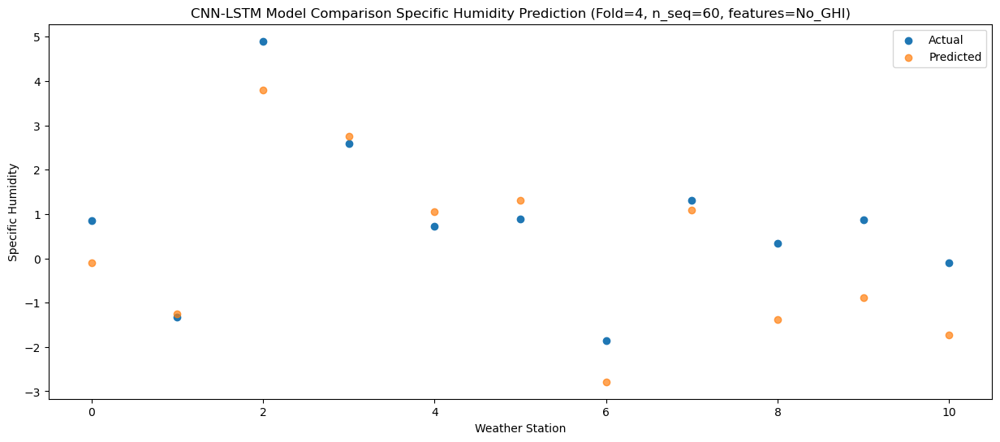

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69   0.279213
1                 1   -0.94  -1.247633
2                 2    5.23   4.067027
3                 3    4.65   3.354686
4                 4    2.69   1.681076
5                 5    2.18   1.949162
6                 6   -2.36  -2.903729
7                 7    2.07   1.408436
8                 8    0.69  -1.448364
9                 9    1.48  -0.790011
10               10    0.11  -1.899502


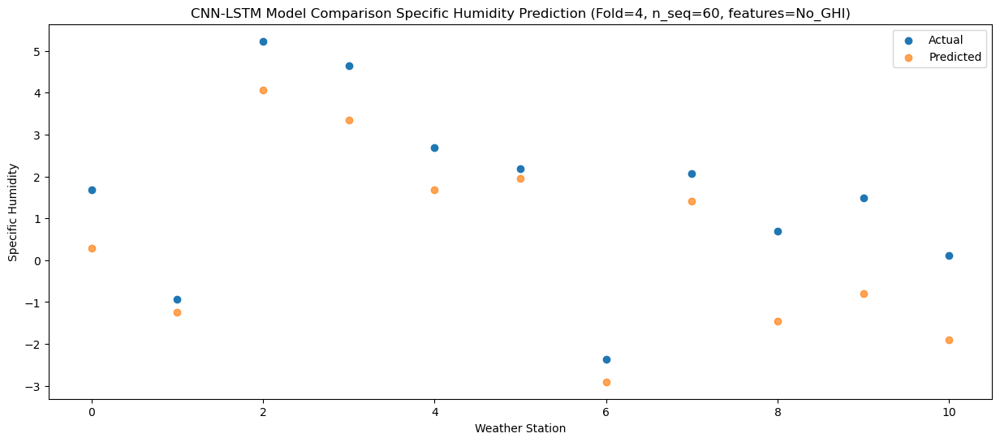

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   1.408543
1                 1    0.55   0.189620
2                 2    6.07   5.140756
3                 3    5.33   4.090999
4                 4    3.54   2.398406
5                 5    2.15   2.650179
6                 6   -0.76  -1.252118
7                 7    2.97   2.545518
8                 8    2.14   0.279585
9                 9    2.99   0.722394
10               10    1.81   0.001410


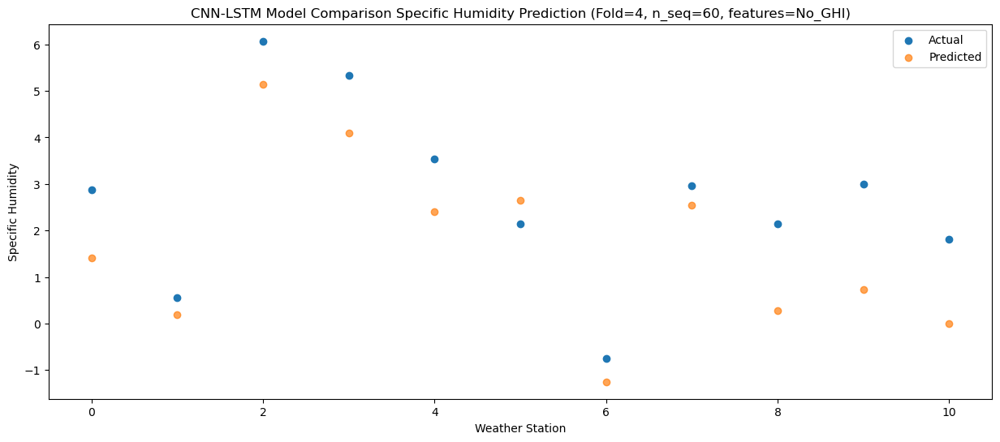

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   4.673825
1                 1    1.35   2.128635
2                 2    9.45   8.374270
3                 3    9.59   8.258142
4                 4    7.81   6.576089
5                 5    6.99   6.270778
6                 6    1.46   0.496247
7                 7    7.36   5.806175
8                 8    4.39   1.910698
9                 9    5.77   2.986804
10               10    2.71   1.148971


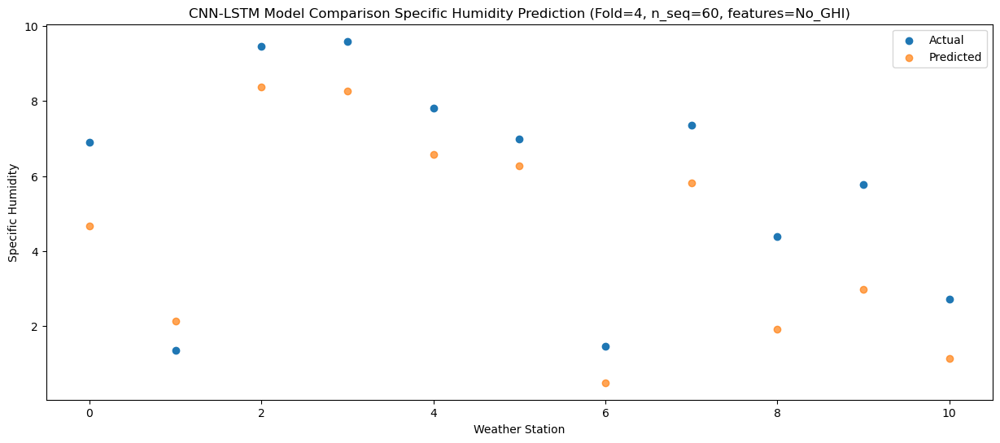

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43   7.421550
1                 1    4.86   4.737961
2                 2   13.02  11.087352
3                 3   13.53  10.799874
4                 4   11.29   9.080853
5                 5   10.85   8.365034
6                 6    4.51   3.406704
7                 7    9.92   8.589535
8                 8    6.35   4.862148
9                 9    7.41   5.893535
10               10    5.95   4.143319


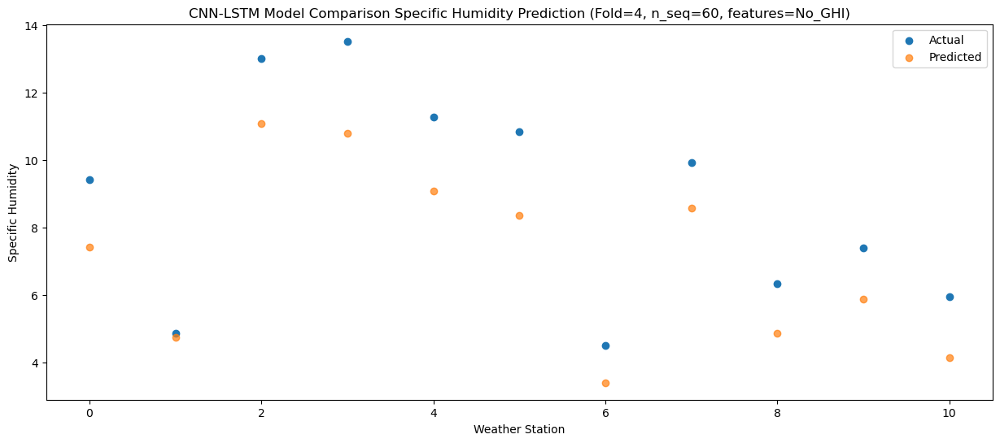

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12   9.725842
1                 1    6.77   7.391323
2                 2   14.61  13.121281
3                 3   13.38  12.255047
4                 4   10.39  10.504646
5                 5    8.52   9.709168
6                 6    7.90   6.567148
7                 7   12.71  10.854955
8                 8   10.65   8.280377
9                 9   12.11   8.926176
10               10    9.57   7.854769


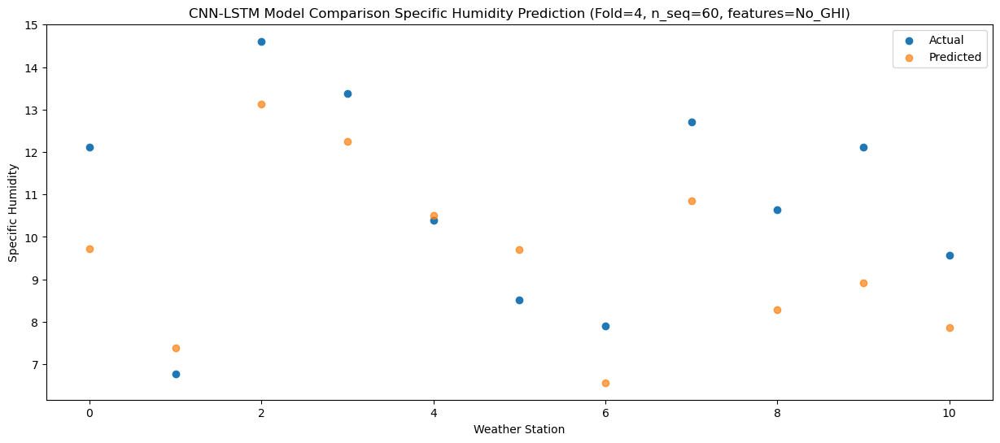

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05   9.111912
1                 1    7.07   6.962001
2                 2   13.03  12.737911
3                 3   11.28  11.971096
4                 4    9.01  10.235958
5                 5    7.66   9.620921
6                 6    7.44   5.797239
7                 7   12.99  10.265718
8                 8   10.11   7.303516
9                 9   11.98   8.072829
10               10    8.77   6.754749


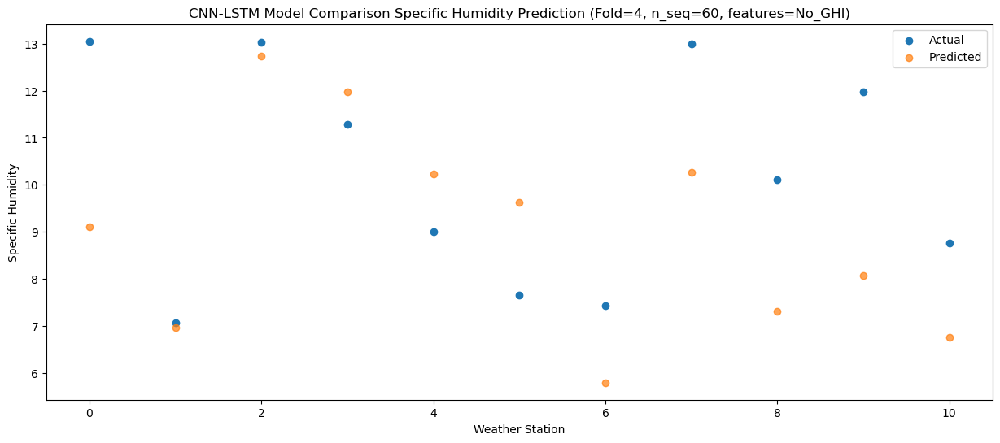

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13   6.500209
1                 1    4.62   4.287613
2                 2   10.01   9.733298
3                 3   10.38   9.094478
4                 4    8.68   7.405602
5                 5    8.17   7.196792
6                 6    3.99   3.175202
7                 7    8.79   7.523030
8                 8    7.31   5.003238
9                 9    8.20   5.619955
10               10    7.06   4.661167


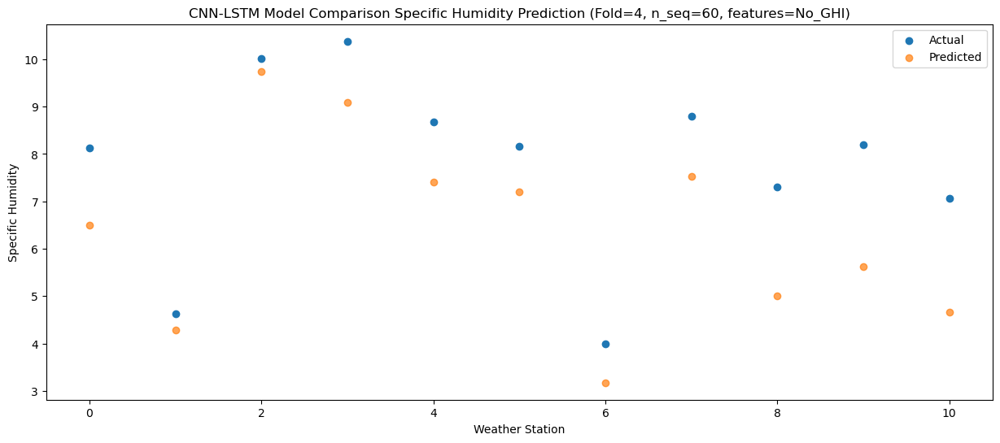

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   3.143435
1                 1    1.00   0.819668
2                 2    6.08   6.016921
3                 3    6.66   5.616532
4                 4    5.02   3.993088
5                 5    6.04   4.305280
6                 6    0.08  -0.376798
7                 7    5.18   4.006828
8                 8    3.98   1.697089
9                 9    4.76   2.253399
10               10    4.00   1.455963


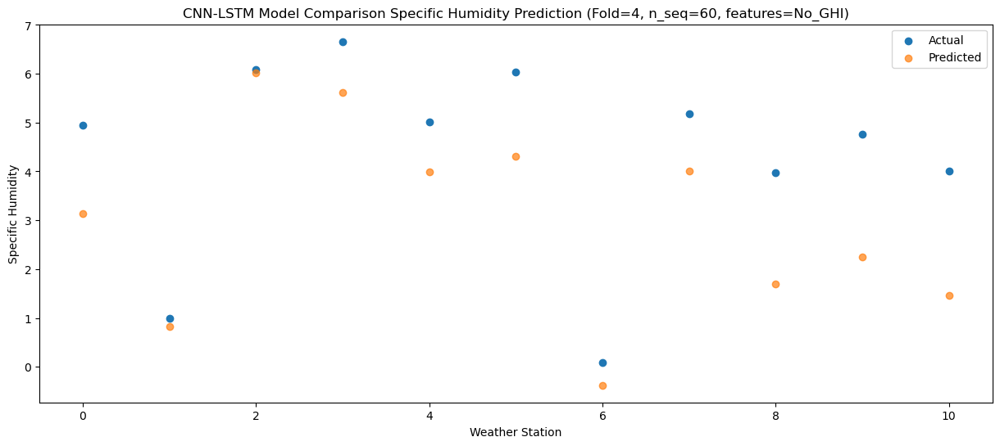

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04   0.272680
1                 1   -1.30  -1.978333
2                 2    4.10   3.326169
3                 3    4.13   3.078799
4                 4    2.60   1.468336
5                 5    3.74   1.914924
6                 6   -2.87  -3.443277
7                 7    2.15   1.169605
8                 8    0.91  -1.526242
9                 9    1.37  -0.856624
10               10    0.56  -1.861190


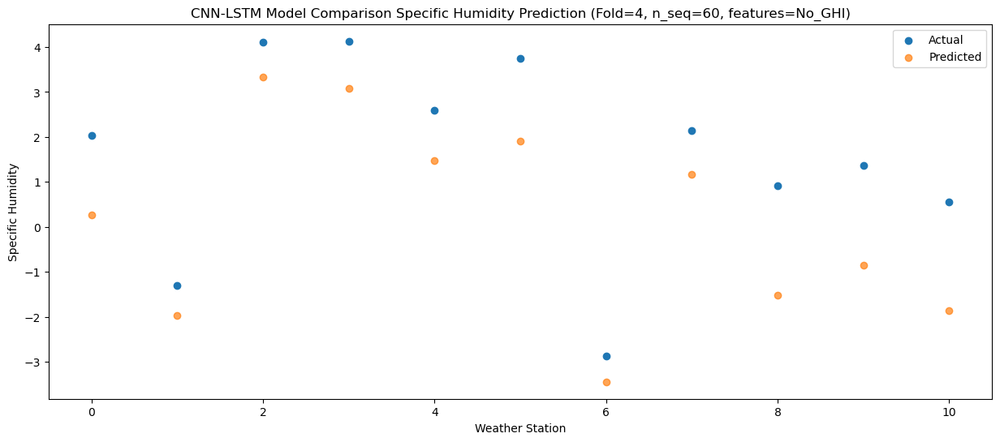

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86   0.141163
1                 1   -2.39  -2.375897
2                 2    2.79   2.515763
3                 3    2.38   2.269686
4                 4    0.84   0.695751
5                 5    2.16   1.458773
6                 6   -3.15  -3.511538
7                 7    1.34   0.817676
8                 8    0.88  -1.077897
9                 9    1.86  -0.620336
10               10    1.08  -1.206526


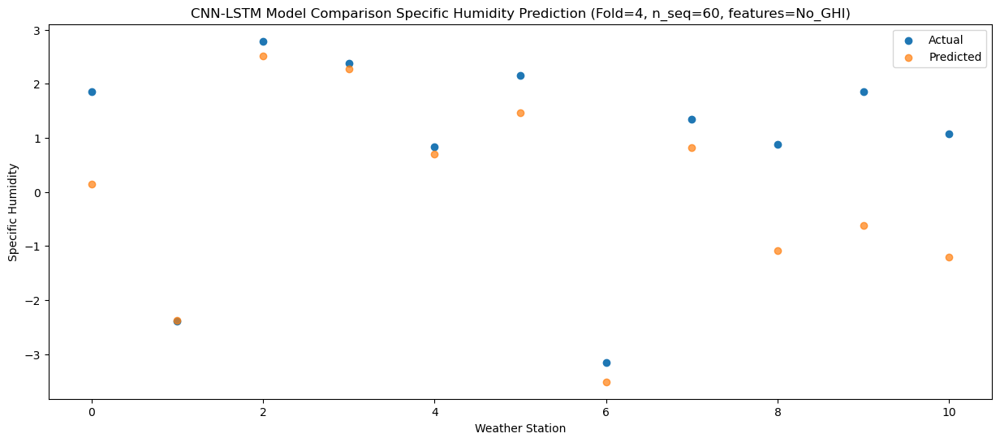

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16  -0.885040
1                 1   -3.43  -2.938761
2                 2    2.07   1.762720
3                 3    1.10   1.420644
4                 4   -0.58  -0.144986
5                 5    0.89   0.841808
6                 6   -3.93  -4.319148
7                 7    0.19  -0.145364
8                 8   -0.20  -2.071512
9                 9    0.40  -1.655228
10               10    0.01  -2.180881


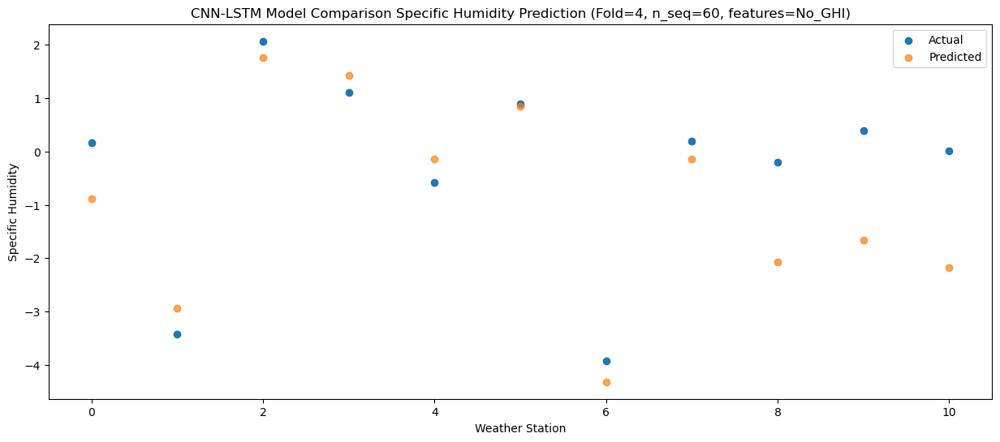

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17   0.113832
1                 1   -4.12  -2.387252
2                 2    3.50   2.902477
3                 3    3.44   2.889598
4                 4    1.77   1.313178
5                 5    1.24   1.962437
6                 6   -3.75  -3.866136
7                 7    1.55   0.916057
8                 8    0.38  -1.758815
9                 9    1.32  -1.080940
10               10    0.03  -2.068710


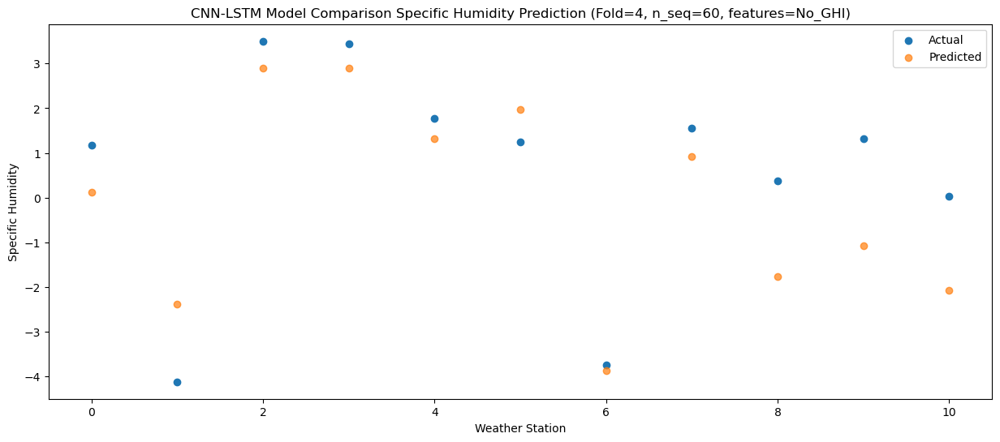

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23   0.824481
1                 1   -0.83  -0.926069
2                 2    5.13   4.384524
3                 3    5.23   3.964938
4                 4    3.72   2.321092
5                 5    2.38   2.664924
6                 6   -2.18  -2.598331
7                 7    2.76   1.916270
8                 8    1.45  -0.996125
9                 9    2.29  -0.332071
10               10    1.10  -1.358064


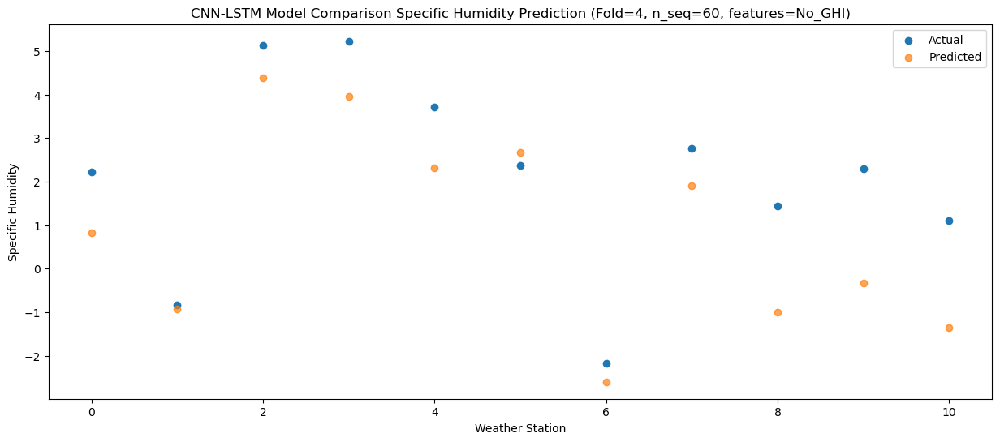

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   2.836150
1                 1   -1.43   0.781590
2                 2    7.31   6.433495
3                 3    7.60   6.067833
4                 4    6.22   4.398466
5                 5    2.98   4.382867
6                 6   -0.26  -0.756177
7                 7    4.49   3.973175
8                 8    3.48   0.797035
9                 9    4.01   1.567863
10               10    2.88   0.335505


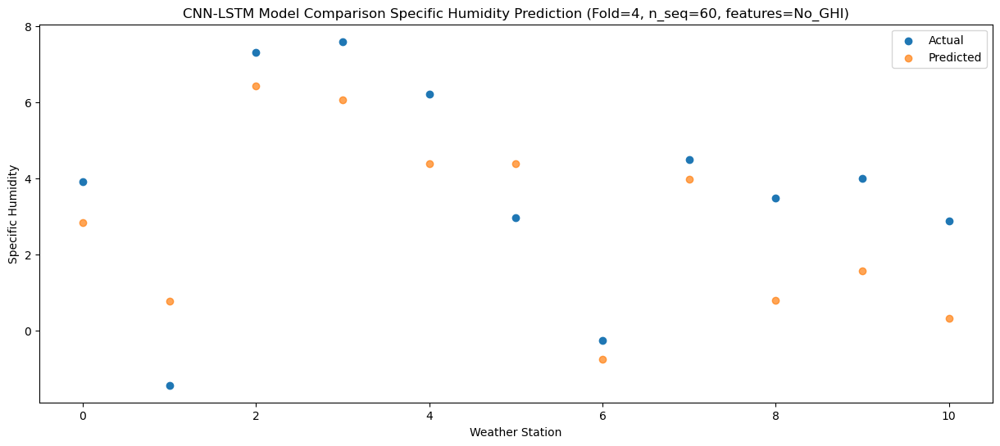

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   5.800330
1                 1    1.16   4.099017
2                 2   11.63  10.046116
3                 3   11.17   9.321989
4                 4    9.65   7.563747
5                 5    5.74   6.869017
6                 6    3.74   2.583040
7                 7    8.91   7.213044
8                 8    6.97   3.693514
9                 9    7.55   4.531915
10               10    5.80   3.100243


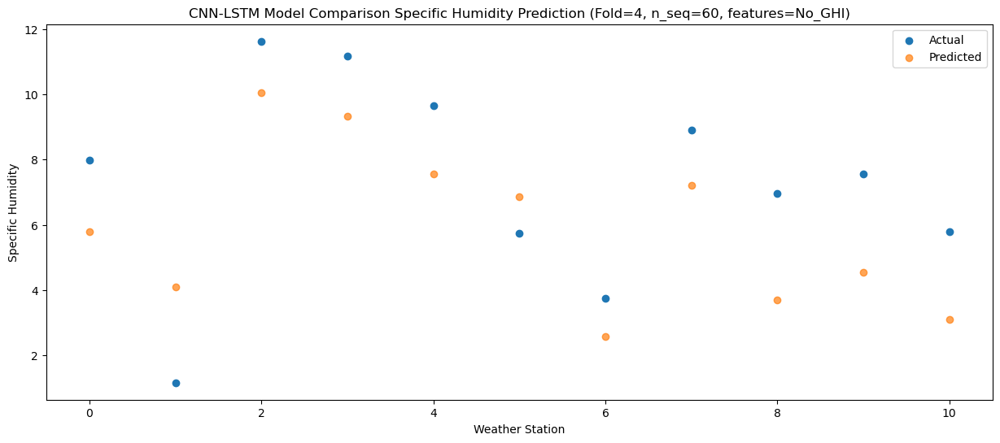

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24   8.653622
1                 1    2.62   5.679032
2                 2   12.97  12.033852
3                 3   13.11  11.931366
4                 4   11.76  10.226021
5                 5   10.27   9.422759
6                 6    5.50   4.490912
7                 7   10.89   9.784627
8                 8    8.66   6.149884
9                 9   10.31   7.158764
10               10    8.35   5.477197


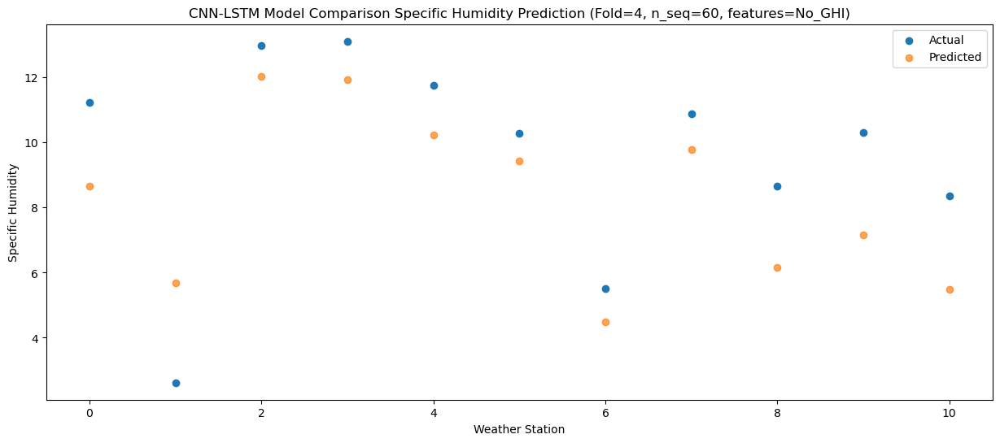

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43   9.342914
1                 1    4.08   7.645813
2                 2   15.00  13.264702
3                 3   13.07  12.365400
4                 4   11.29  10.612239
5                 5   10.15   9.955581
6                 6    7.89   6.398097
7                 7   11.87  10.657095
8                 8    9.96   7.756131
9                 9   11.92   8.412570
10               10    9.47   7.313059


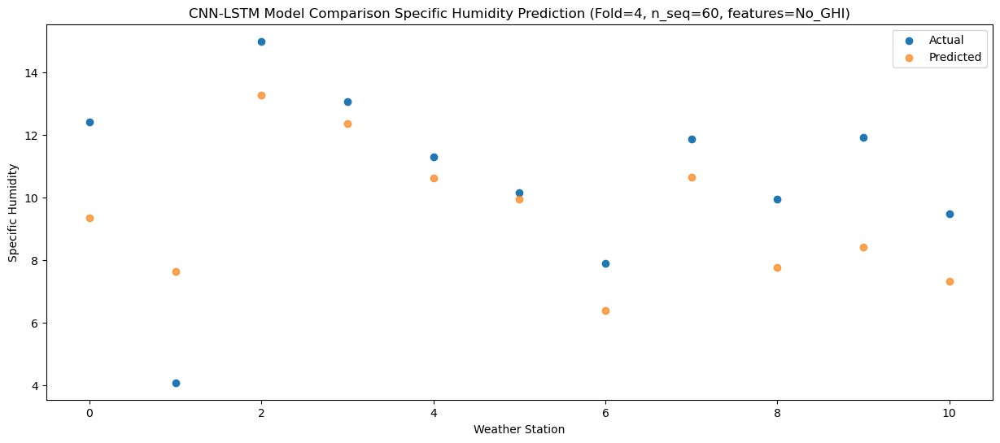

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27   8.994037
1                 1    6.69   6.400835
2                 2   12.69  12.311397
3                 3   12.36  11.939101
4                 4   10.52  10.242460
5                 5    8.95   9.667491
6                 6    7.15   5.277022
7                 7   10.58  10.081787
8                 8    9.60   6.990047
9                 9   11.56   7.798777
10               10    9.45   6.471495


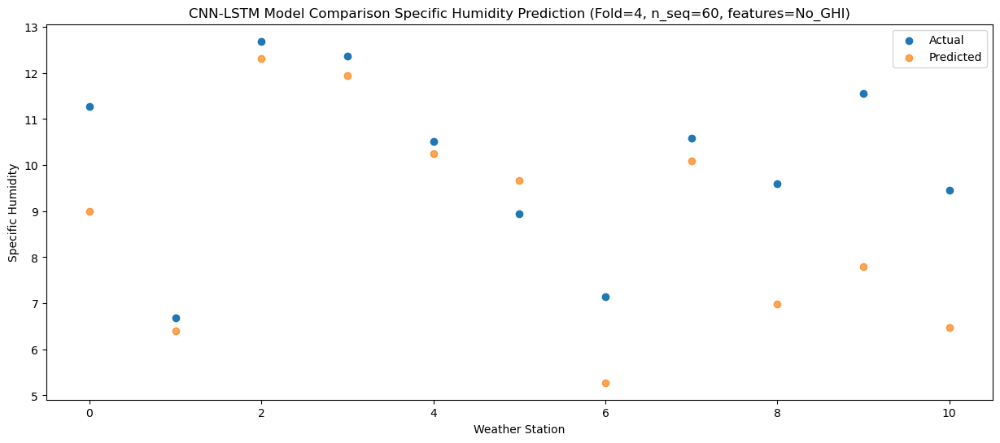

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97   6.146546
1                 1    6.50   4.935378
2                 2   11.59  10.350059
3                 3    9.83   9.402988
4                 4    8.36   7.673259
5                 5    8.07   7.370534
6                 6    4.83   3.338549
7                 7    8.54   7.499009
8                 8    6.92   4.496321
9                 9    8.06   5.132384
10               10    7.38   4.040269


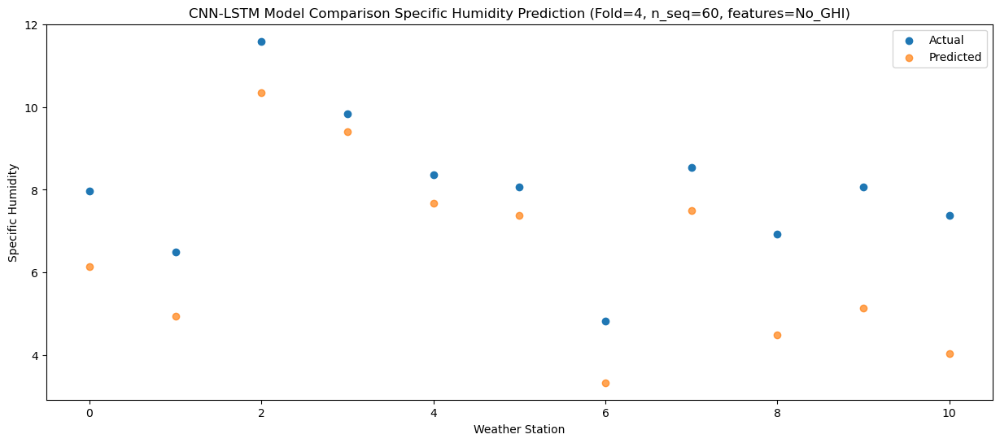

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   2.375129
1                 1    2.08   0.784953
2                 2    6.80   6.057979
3                 3    6.37   5.484658
4                 4    4.62   3.832461
5                 5    4.38   4.097621
6                 6    0.43  -0.856180
7                 7    4.22   3.507786
8                 8    3.34   0.656591
9                 9    3.96   1.282250
10               10    3.27   0.285364


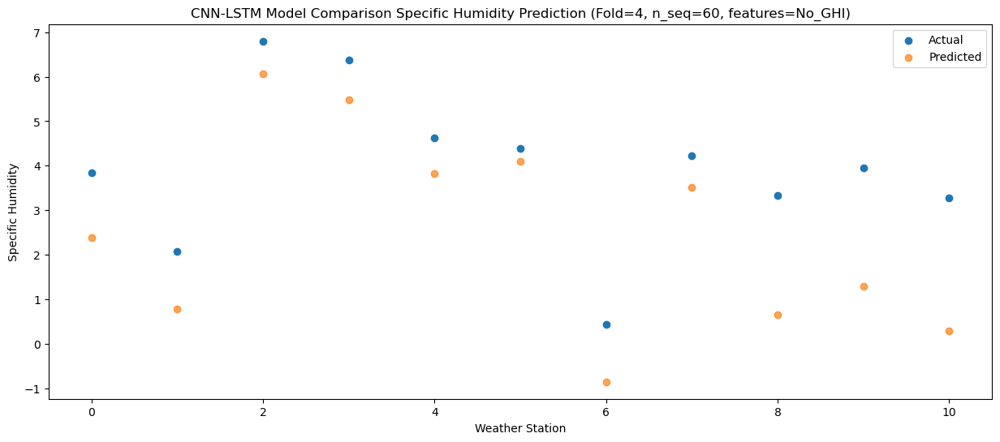

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

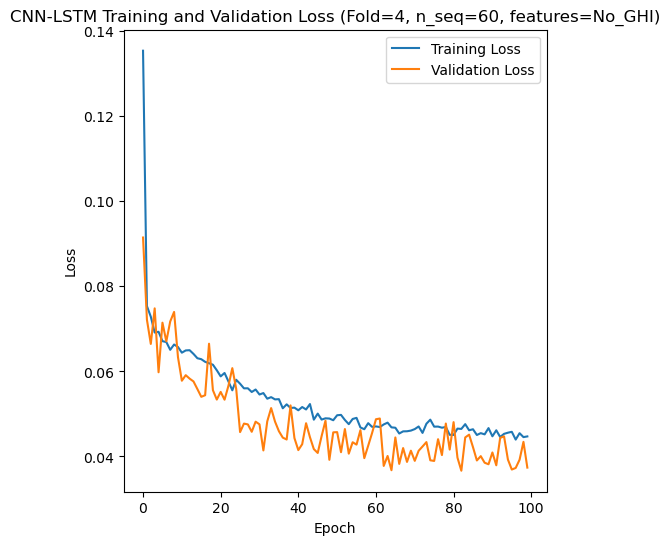

[[4.627796631053797], [0.9730007000256133], [3.0574809152775013], [1.4518236180939144], [1.4194475463505138]]
[[array(4.62779663)], [array(0.9730007)], [array(3.05748092)], [array(1.45182362)], [array(1.41944755)]]
[[4.0075230841125284], [0.7425429794411609], [2.516213138664706], [1.1894077727620231], [1.15094963721454]]
[[3.838004155793752], [0.7014355293440971], [1.9063720253685257], [0.9391401346661413], [1.2718044089057738]]
[[-0.10972148577158758], [0.9521576772393501], [0.49560393472429276], [0.837327093067022], [0.8999253171930583]]
[[array(0.15547701)], [array(0.27050212)], [array(0.11646011)], [array(0.24464309)], [array(0.97297888)]]
[[array(0.74243714)], [array(0.9564546)], [array(0.78516631)], [array(0.91099822)], [array(0.94183963)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[-0.65483318 -0.82497916 -1.21358183 ...  6.47149533  4.04026884
  0.28536409]
Accuracy Results:
RMSE for each fold:
[[4.627796631053797], [0.9730007000256133], [3.0574809152775013], [1.4518236180939144], [1

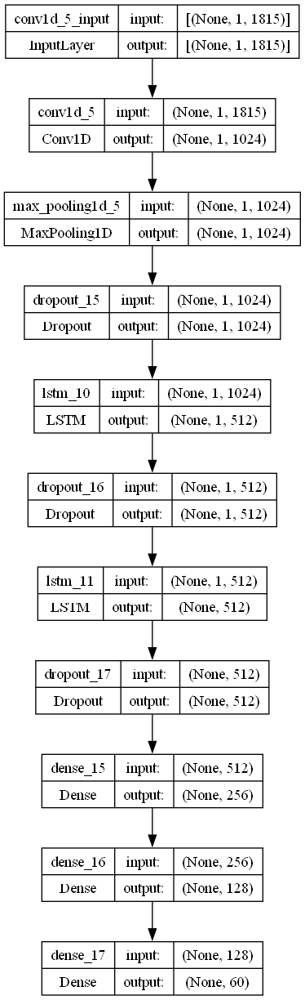

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.28287453942324176
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.28163213752842214

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_SH_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)